### Nadam Optimizer Effect

In [1]:
%matplotlib inline

In [2]:
# pip install tensorflow-gpu

### Imports

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')

In [4]:
# !cd /content/drive/My\ Drive/BTP/RandomInit/2D_FINAL/
# DRIVE_PATH = '/content/drive/My\ Drive/BTP/RandomInit/2D_FINAL/'

In [5]:
from __future__ import print_function, division
import numpy as np 
import sklearn
import json
from sklearn import datasets
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Nadam
import tensorflow.keras.backend as K
import os
from functools import partial
from scipy import stats
import matplotlib.pyplot as plt
import sys
import numpy as np
import pickle

In [6]:
tf.random.set_seed(53)

In [7]:
os.environ["CUDA_VISIBLE_DEVICES"]="0"

### Synthetic 2D Datsasets

In [8]:
def gaussian_8_modes(BATCH_SIZE=64):
    scale = 2.
    centers = [
        (1, 0),
        (-1, 0),
        (0, 1),
        (0, -1),
        (1. / np.sqrt(2), 1. / np.sqrt(2)),
        (1. / np.sqrt(2), -1. / np.sqrt(2)),
        (-1. / np.sqrt(2), 1. / np.sqrt(2)),
        (-1. / np.sqrt(2), -1. / np.sqrt(2))
    ]
    centers = [(scale * x, scale * y) for x, y in centers]
    while True:
        dataset = []
        for i in range(BATCH_SIZE):
            point = np.random.randn(2) * .02
            center = centers[np.random.choice(len(centers))]
            point[0] += center[0]
            point[1] += center[1]
            dataset.append(point)
        dataset = np.array(dataset, dtype='float32')
        dataset /= 1.414  
        return dataset
      
def gaussian_9_modes(BATCH_SIZE):
    dataset = []
    for i in range(int((90000 / 9))):
        for x in range(-3, 3,2):
            for y in range(-3, 3,2):
                point = np.random.randn(2) * 0.05
                point[0] += 2 * x
                point[1] += 2 * y
                dataset.append(point)
    dataset = np.array(dataset, dtype='float32')
    np.random.shuffle(dataset)
    dataset /= 2.828  

    return dataset
    
def swiss_roll(BATCH_SIZE):
    batch_data = sklearn.datasets.make_swiss_roll(n_samples=BATCH_SIZE, noise=0.25)[0]
    batch_data = batch_data.astype(np.float32)[:, [0, 2]]
    batch_data /= 7.5
    return batch_data
    
def load_data(dataset,DATASET_SIZE):
    if(dataset == '8_modes'):
        return gaussian_8_modes(DATASET_SIZE)
    elif(dataset == '9_modes'):
        return gaussian_9_modes(DATASET_SIZE)
    elif(dataset=='swiss_roll'):
        return swiss_roll(DATASET_SIZE)
    else:
        print('Invalid Dataset')
        exit(0)

### Loss Functions

In [9]:
bce = tf.keras.losses.BinaryCrossentropy()

def ns_loss(y_true,y_pred):
  return -tf.math.log(y_pred+1e-8)


### Utility

In [10]:

def kde(values, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', show=False, save=None):
    
    fig, ax = plt.subplots(figsize=fig_size)
    
    kernel = stats.gaussian_kde(values)

    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(kernel(positions).T, xx.shape)
    cfset = ax.contourf(xx, yy, f, cmap=cmap)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')

    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    
def dim_vis(D, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', 
            color_range=False, show=False, save=None, device='cpu'):

    fig, ax = plt.subplots(figsize=fig_size)
    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(D(positions.T).numpy().T, xx.shape)
    if color_range:
        cfset = ax.contourf(xx, yy, f, levels=np.linspace(0.35, 0.65, 100), cmap=cmap)
    else:
        cfset = ax.contourf(xx, yy, f, 100, cmap=cmap)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')
    cbar = fig.colorbar(cfset,fraction=0.046, pad=0.04)
    if color_range: 
        seq = [0.35, f.min(), f.mean(), f.max(), 0.65]
        cbar.set_ticks(seq)
        cbar.set_ticklabels(['%.2f' % val for val in np.round(seq, 2)])
        cbar.ax.tick_params(labelsize=22)
        #cbar.set_ticks(np.linspace(0., 1., 11))
    else:
        cbar.set_ticks(np.linspace(f.min(), f.max(), 5))
        cbar.set_ticklabels(['%.2f' % val for val in np.round(np.linspace(f.min(), f.max(), 5), 2)])
    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    

### Log Data

In [11]:
duality_gaps = {}
M1 = {}
M2 = {}
bbox=[-3, 3, -3,3]  

### Model Definitions

#### Parent GAN Class

In [12]:
class GAN():
    def __init__(self):
        self.latent_dim = 100
        self.img_shape = (2,)
        
        optimizer = Adam(1e-4, 0.5)
        dg_optimizer = Nadam(1e-3,0.5)
        
        self.d_updates = 1
        self.g_updates = 1
        self.name      = 'GAN'
        self.setting   = 'convergence'
        self.discriminator = self.build_discriminator()
        
        self.discriminator.compile(loss=bce,
            optimizer=optimizer,
            metrics=['accuracy'])
        
        optimizer = Adam(5e-2, 0.5)
        self.generator = self.build_generator()
        z              = Input(shape=(self.latent_dim,))
        img            = self.generator(z)
        self.discriminator.trainable = False
        valid          = self.discriminator(img)
        self.combined  = Model(z, valid)
        self.combined.compile(loss=bce, optimizer=optimizer)

        
        self.D_norm = []
        self.G_norm = []
        self.D_var = []
        self.G_var = []
        
        init_var_d = [0.1 for i in range(len(self.discriminator.get_weights()))]
        init_var_g = [0.1 for i in range(len(self.generator.get_weights()))]
        
        self.D_var.append(init_var_d)
        self.G_var.append(init_var_g)
        #--------------------------------------------------------------------
        #                      DUALITY GAP
        #--------------------------------------------------------------------
        optimizer = Adam(5e-4, 0.5)
        self.dg_discriminator = self.build_discriminator()
        self.dg_discriminator.compile(loss=bce,
            optimizer=dg_optimizer,
            metrics=['accuracy'])
        
        dg_optimizer = Nadam(1e-3,0.5)
        
        optimizer = Adam(5e-4, 0.5)
        self.dg_generator = self.build_generator()
        z                 = Input(shape=(self.latent_dim,))
        img               = self.dg_generator(z)
        self.dg_discriminator.trainable = False
        valid             = self.dg_discriminator(img)
        self.dg_combined  = Model(z, valid)
        self.dg_combined.compile(loss=bce, optimizer=dg_optimizer)

    def configure_setting(self,setting):
          
        if(setting=='convergence'):
          self.setting = 'convergence'
          self.d_updates = 1
          self.g_updates = 1

        elif(setting=='mode_collapse'):
          self.setting = 'mode_collapse'
          self.d_updates = 15
          self.g_updates = 1
        
        elif(setting=='divergence'):
          self.setting = 'divergence'
          self.d_updates = 1
          self.g_updates = 1
        else:
          return "Invalid Setting"
          
    def build_generator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=self.latent_dim))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(2 , activation=None))
#         model.summary()
        noise = Input(shape=(self.latent_dim,))
        img   = model(noise)

        return Model(noise, img)

    def build_discriminator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=2))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(1, activation='sigmoid'))
#         model.summary()
        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)


    def duality_gap(self):
        
        DG = {}
        M1 = {}
        M2 = {}
        
        M_u_v_worst = 0
        M_u_worst_v = 0

        self.dg_train_d(random=False)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=False)
        M_u_worst_v =  self.score()
        
        DG['vanilla'] = M_u_v_worst - M_u_worst_v
        M1['vanilla'] = M_u_v_worst
        M2['vanilla'] = M_u_worst_v
        
        self.dg_train_d(random=True)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=True)
        M_u_worst_v =  self.score()
        
        DG['local_random'] = M_u_v_worst - M_u_worst_v
        M1['local_random'] = M_u_v_worst
        M2['local_random'] = M_u_worst_v
        
        return DG,M1,M2

    def score(self):
        nsamples = 128
        ntrials  = 100

        scores = []
        for i in range(ntrials):
          idx = np.random.randint(0, self.X.shape[0], nsamples)
          X = tf.convert_to_tensor(self.X[idx])
          noise = tf.convert_to_tensor(np.random.normal(0, 1, (nsamples, self.latent_dim)),dtype=tf.float32)
          score = tf.reduce_mean( tf.math.log(self.dg_discriminator(X)+1e-4)) + tf.reduce_mean(tf.math.log(abs(1 - self.dg_combined(noise)+1e-4)))
          scores.append(score)
        return np.average(scores)

    def dg_train_g(self, epochs=250, batch_size=64, save_interval=50,random=False):
        
        
        if(self.setting=='convergence'):
           std = 0.15
        if(self.setting=='divergence'):
           std = 1.0
        if(self.setting=='mode_collapse'):
           std = 0.10
        
        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=std).reshape(w.shape) for i,w in enumerate(self.generator.get_weights())]
#             random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.G_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.generator.get_weights())]
            self.dg_generator.set_weights(random_weight_init)
        else:
            self.dg_generator.set_weights(self.generator.get_weights())
        
        self.dg_discriminator.set_weights(self.discriminator.get_weights())
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M2 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            g_loss = self.dg_combined.train_on_batch(noise, valid)
            progbar.update(epoch)

    def dg_train_d(self, epochs=250, batch_size=64, save_interval=50,random=False):
        
        
        if(self.setting=='convergence'):
           std = 0.15
        if(self.setting=='divergence'):
           std = 1.0
        if(self.setting=='mode_collapse'):
           std = 0.10
        
        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=std).reshape(w.shape) for i,w in enumerate(self.discriminator.get_weights())]
#             random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.D_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.discriminator.get_weights())]
            self.dg_discriminator.set_weights(random_weight_init)
        else:    
            self.dg_discriminator.set_weights(self.discriminator.get_weights())
            
        self.dg_generator.set_weights(self.generator.get_weights())
        
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M1 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            X_train = self.X
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.dg_generator.predict(noise)
            d_loss_real = self.dg_discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.dg_discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            progbar.update(epoch)

    def get_valid_label(self,batch_size):
        return np.ones((batch_size, 1))
    
    def get_fake_label(self,batch_size):
        return np.zeros((batch_size, 1))

    def dataset_tune(self,dataset):
        print(dataset,self.setting)
        if(self.setting=='convergence'):
          
          if(dataset=='swiss_roll'):
            self.d_updates = 3
            self.g_updates = 2

          elif(dataset=='8_modes'):
            self.d_updates = 1
            self.g_updates = 1
          
          elif(dataset=='9_modes'):
            self.d_updates = 3
            self.g_updates = 3
          
          else:
            print("Invalid Dataset")
        print(self.d_updates,self.g_updates)
        
        
    def train(self, epochs, batch_size=128, save_interval=50,d_updates=1,g_updates=1,dataset='8_modes',save_path='./'):
        
        d_updates = self.d_updates
        g_updates = self.g_updates
        X_train = load_data(dataset,10000*batch_size)
        self.X = X_train
        self.dataset_tune(dataset)

        idx = np.random.randint(0, X_train.shape[0], 8000)
        gt = X_train[idx]      
#         kde(gt.T, show=True, save=os.path.join(save_path, 'ground_truth'), bbox=bbox)

        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        global M1
        global M2
        global duality_gaps

        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(epochs):

            if epoch % save_interval == 0:
                weight_save_path  = '{}/weights'.format(save_path)
                generator_weights = '{}/weights/G/step_{}/'.format(save_path,epoch)
                discriminator_weights = '{}/weights/D/step_{}/'.format(save_path,epoch)
                self.generator.load_weights(generator_weights)
                self.discriminator.load_weights(discriminator_weights)
                
                d_weights = self.discriminator.get_weights()
                g_weights = self.generator.get_weights()

                d_norm = [ np.linalg.norm(x) for x in d_weights ]
                g_norm = [ np.linalg.norm(x) for x in g_weights ]

                d_var  = [np.var(x) for x in d_weights]
                g_var  = [np.var(x) for x in g_weights]

                self.D_norm.append(d_norm)
                self.G_norm.append(g_norm)
                self.D_var.append(d_var)
                self.G_var.append(g_var)

                DG,M1_,M2_ = self.duality_gap()
#                 print ("Iteration : %d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))
                print('Vanilla   Duality GAP : ',DG['vanilla'])
                print('L Random  Duality Gap : ',DG['local_random'])
                duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)].append(DG['vanilla'])
                M1['{}-vanilla-{}'.format(self.name,self.setting)].append(M1_['vanilla'])
                M2['{}-vanilla-{}'.format(self.name,self.setting)].append(M2_['vanilla'])
                
                duality_gaps['{}-local_random-{}'.format(self.name,self.setting)].append(DG['local_random'])
                M1['{}-local_random-{}'.format(self.name,self.setting)].append(M1_['local_random'])
                M2['{}-local_random-{}'.format(self.name,self.setting)].append(M2_['local_random'])
                
                
                save_data = {
                    'DG':{
                        'vanilla': duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M1':{
                        'vanilla': M1['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M1['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M2':{
                        'vanilla': M2['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M2['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'D_norm':np.asarray(self.D_norm),
                    'G_norm':np.asarray(self.G_norm),
                    'D_var':np.asarray(self.D_var),
                    'G_var':np.asarray(self.G_var)
                }

                # with open(os.path.join(save_path,'data.json'), 'w') as save_file:
                #   json.dump(save_data, save_file)

                with open( os.path.join(save_path,'tuned_nadam_data.pkl'), 'wb') as fp:
                    pickle.dump(save_data, fp)

                self.save_imgs(epoch,d_updates,g_updates,save_path=save_path)
            progbar.update(epoch)

    def save_imgs(self, epoch,d_updates=1,g_updates=1,save_path='./'):
        r, c = 1, 1
        visualize_count = 5000
        noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
        gen_imgs = gen_imgs + np.random.normal(size=gen_imgs.shape,scale=0.1)
        fig_dir = '{}/iterations'.format(save_path)
        if not os.path.exists(fig_dir):
            os.makedirs(fig_dir)
        
        if(epoch%500==0):
            generator_save_name = os.path.join(fig_dir, 'generator_step_' + str(epoch))
            discriminator_save_name = os.path.join(fig_dir, 'discriminator_step_' + str(epoch))
#             kde(gen_imgs.T, show=True, save=generator_save_name, bbox=bbox)
#             dim_vis(self.discriminator, show=True, save=discriminator_save_name, bbox=bbox)
        
        else:
            r, c = 3, 2
            visualize_count = 5000
            noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
            gen_imgs = self.generator.predict(noise)
            
            global duality_gaps
            
            fig, axs = plt.subplots(r, c,figsize=(16,16))
            cnt = 0
            axs[0,0].set_title('Learning Visualization D{} G{}'.format(d_updates,g_updates))
            axs[0,0].scatter(self.X[:visualize_count,0],self.X[:visualize_count,1],color='r',alpha=0.11,label='Real Data')
            axs[0,0].scatter(gen_imgs[:,0],gen_imgs[:,1], color='b',alpha=0.1,label='Fake Data')
            
            axs[0,1].set_title('Duality Gap')
            xaxis = [i*100 for i in range(len(duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]))]
            axs[0,1].plot(xaxis,duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],label='Vanilla')
            axs[0,1].plot(xaxis,duality_gaps['{}-local_random-{}'.format(self.name,self.setting)],label='Random')
            
            norm_axis = [i*100 for i in range(len(self.D_norm))]
            var_axis = [i*100 for i in range(len(self.D_var))]
            
            axs[1,0].set_title('Discriminator Weight Norm')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,0].plot(norm_axis,np.asarray(self.D_norm)[:,i],label='Layer {}'.format(i+1))

            axs[1,1].set_title('Discriminator Weight Variance')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,1].plot(var_axis,np.asarray(self.D_var)[:,i],label='Layer {}'.format(i+1))
 
            
            axs[2,0].set_title('Generator Weight Norm')
            for i in range(len(self.generator.get_weights())):
                axs[2,0].plot(norm_axis,np.asarray(self.G_norm)[:,i],label='Layer {}'.format(i+1))

            axs[2,1].set_title('Generator Weight Variance')
            for i in range(len(self.generator.get_weights())):
                axs[2,1].plot(var_axis,np.asarray(self.G_var)[:,i],label='Layer {}'.format(i+1))
 
 
            plt.legend()
            
            fig_dir = '{}/dg_plots'.format(save_path)
            
#             if not os.path.exists(fig_dir):
#                 os.makedirs(fig_dir,exist_ok=True)
#             plt.savefig(fig_dir+'/{}.png'.format(epoch))
        
            plt.show()
            plt.close()

        
        

#### DCGAN

In [13]:
class DCGAN(GAN):
    def __init__(self):
        super().__init__()
        self.name      = 'DCGAN'


class NSGAN(GAN):
    def __init__(self):
        super().__init__()
        optimizer = Adam(5e-4, 0.5)
        self.name      = 'NSGAN'
        self.combined.compile(loss=ns_loss, optimizer=optimizer)
        self.dg_combined.compile(loss=ns_loss, optimizer=optimizer)


### Experimentation

----------------------------------------------------------------------------------------------------
		8_modes DCGAN convergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/DCGAN/convergence
8_modes convergence
1 1
 M1 - Random : False
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  7.7566295
L Random  Duality Gap :  8.820199
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.848839
L Random  Duality Gap :  9.348522


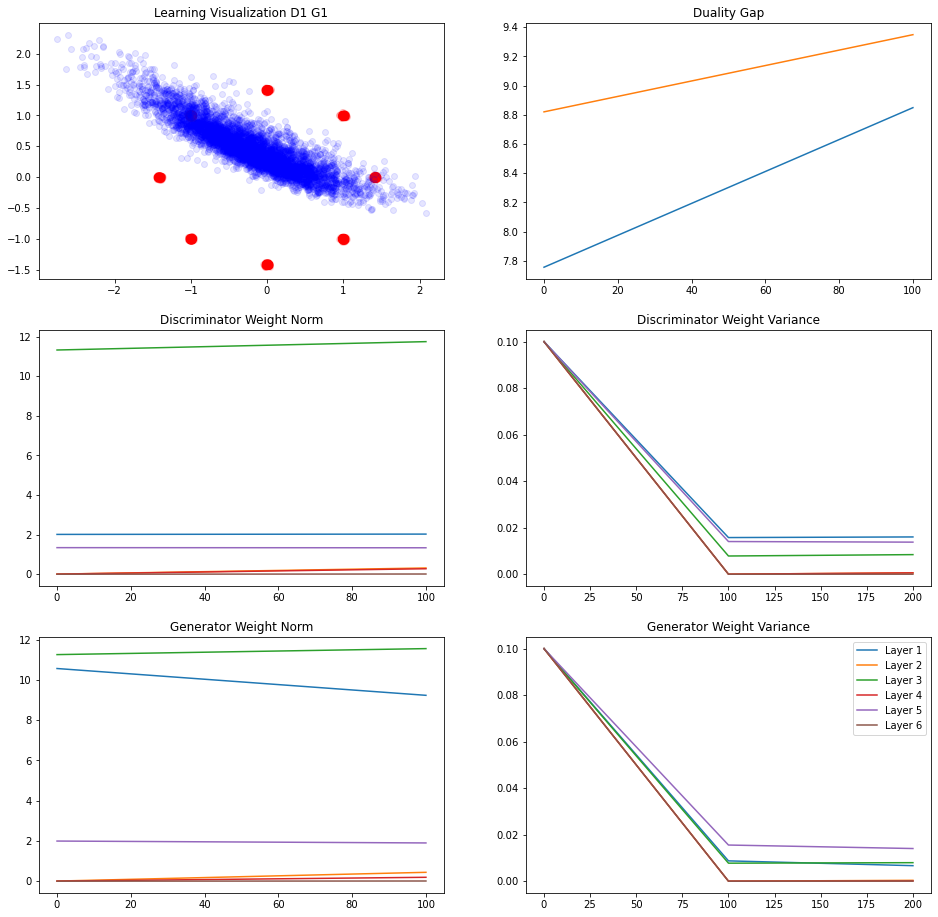

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.166765
L Random  Duality Gap :  9.214876


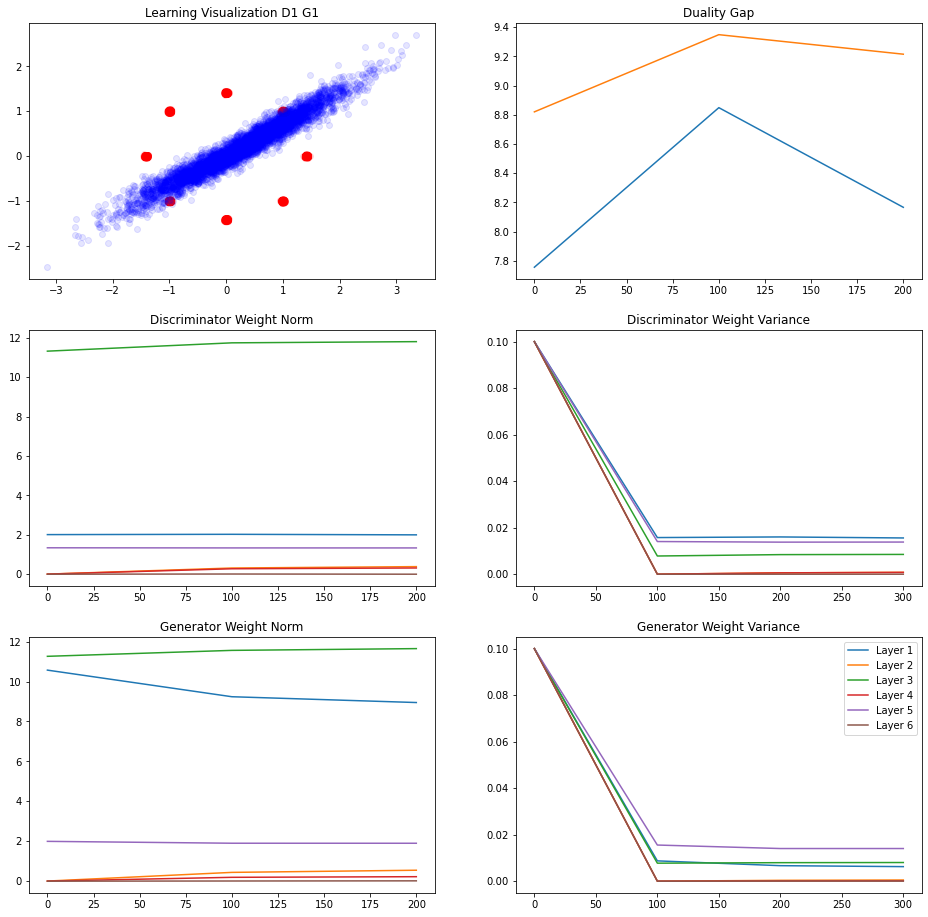

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.7963705
L Random  Duality Gap :  9.371302


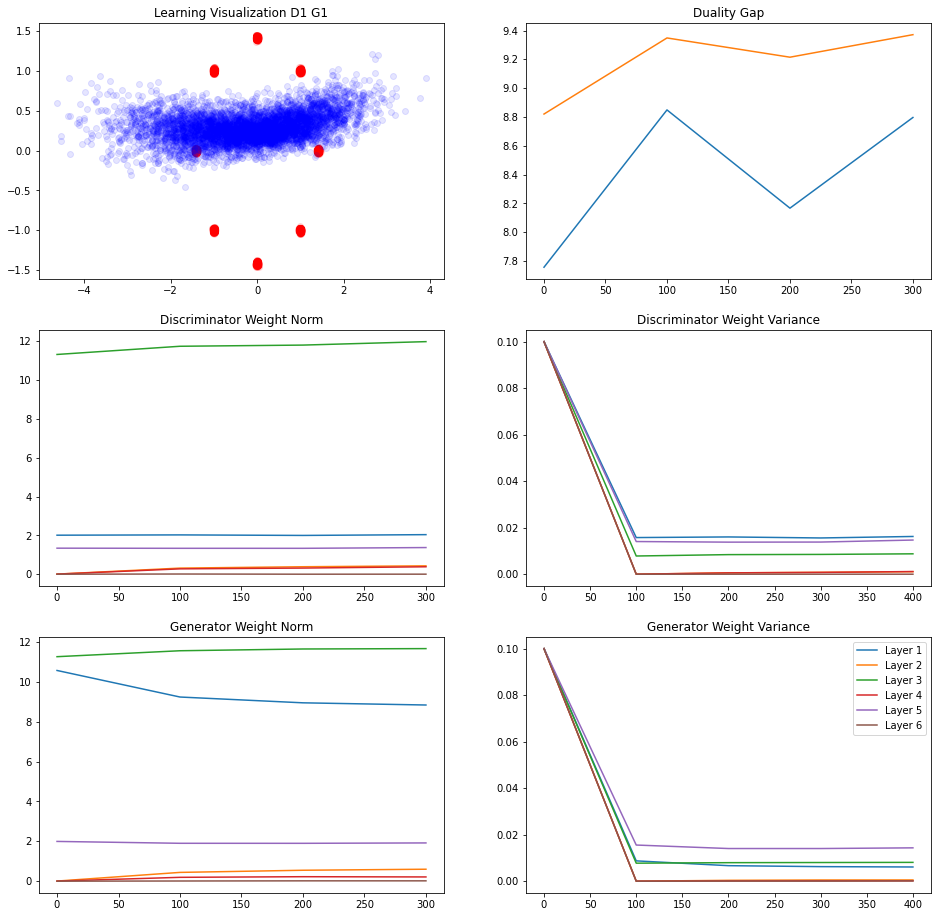

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.742404
L Random  Duality Gap :  9.3751


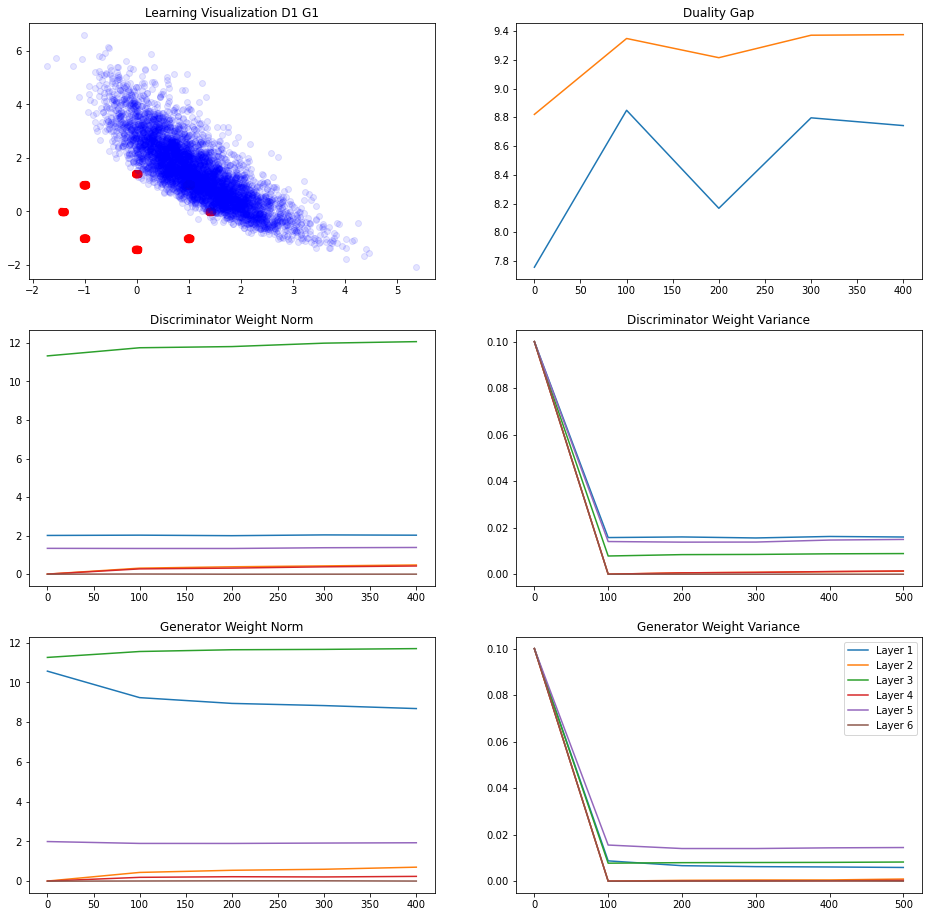

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.41783
L Random  Duality Gap :  9.044303
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.1008
L Random  Duality Gap :  8.813612


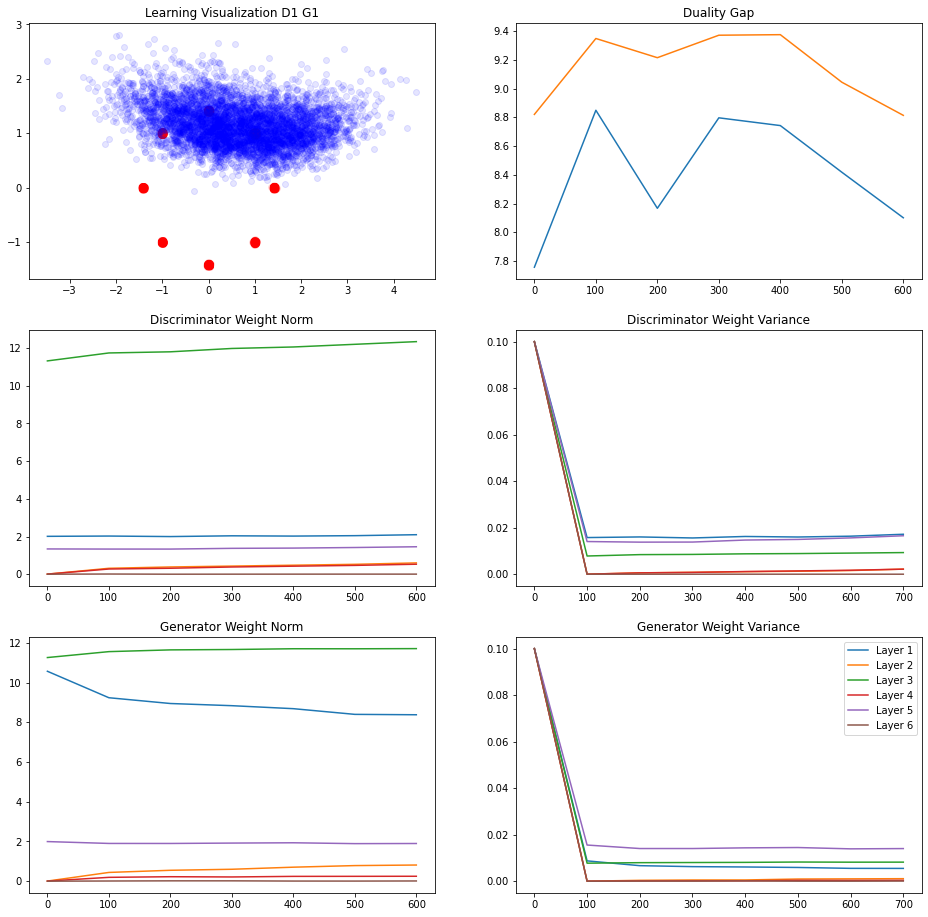

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.392037
L Random  Duality Gap :  9.087306


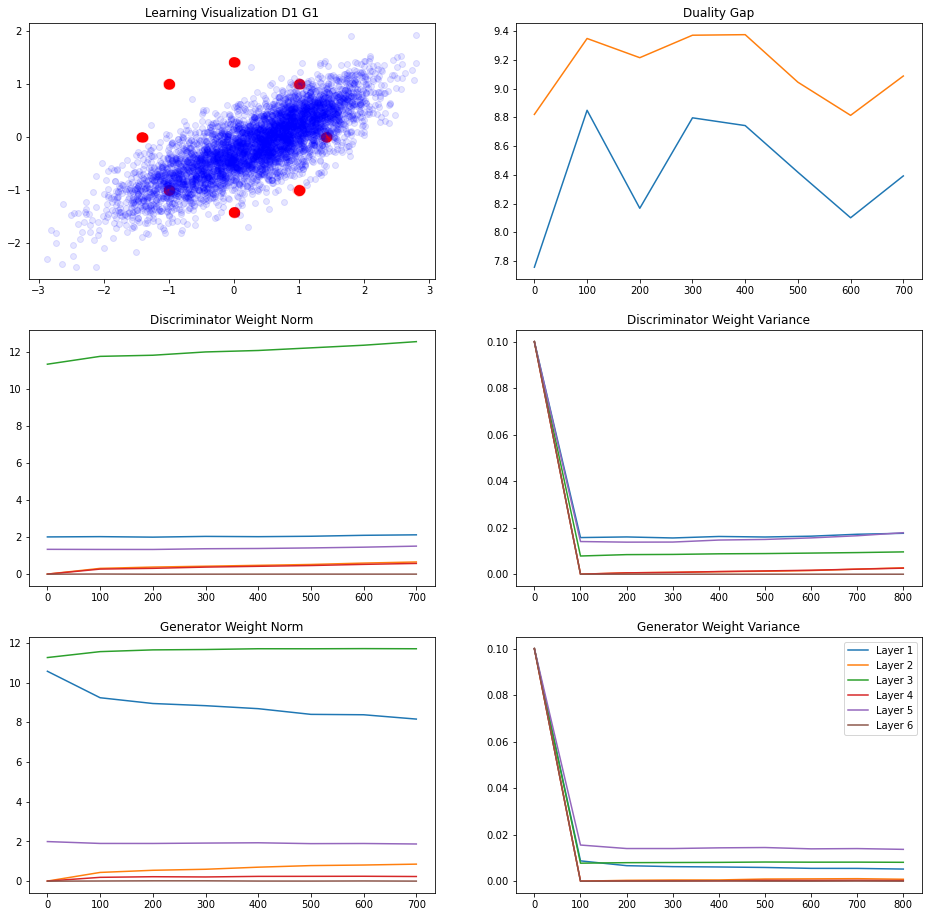

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  6.6207237
L Random  Duality Gap :  7.7045994


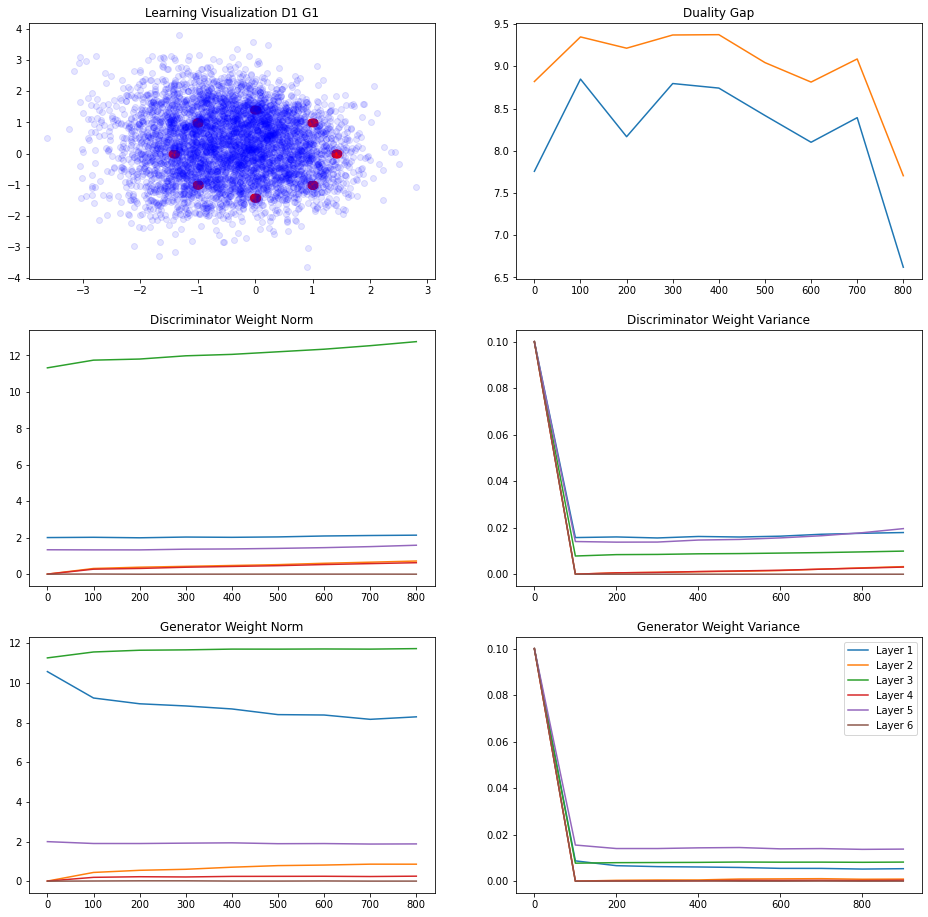

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.4811675
L Random  Duality Gap :  0.5033265


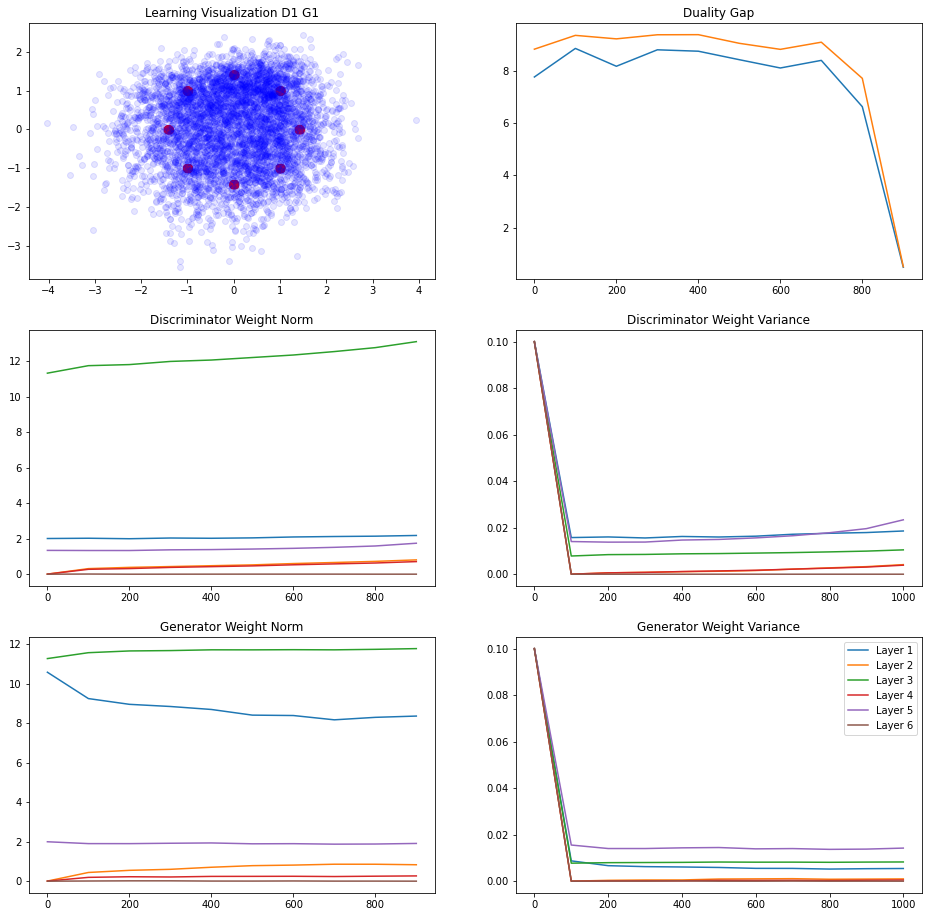

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.45329493
L Random  Duality Gap :  0.42530823
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.32612127
L Random  Duality Gap :  0.31449813


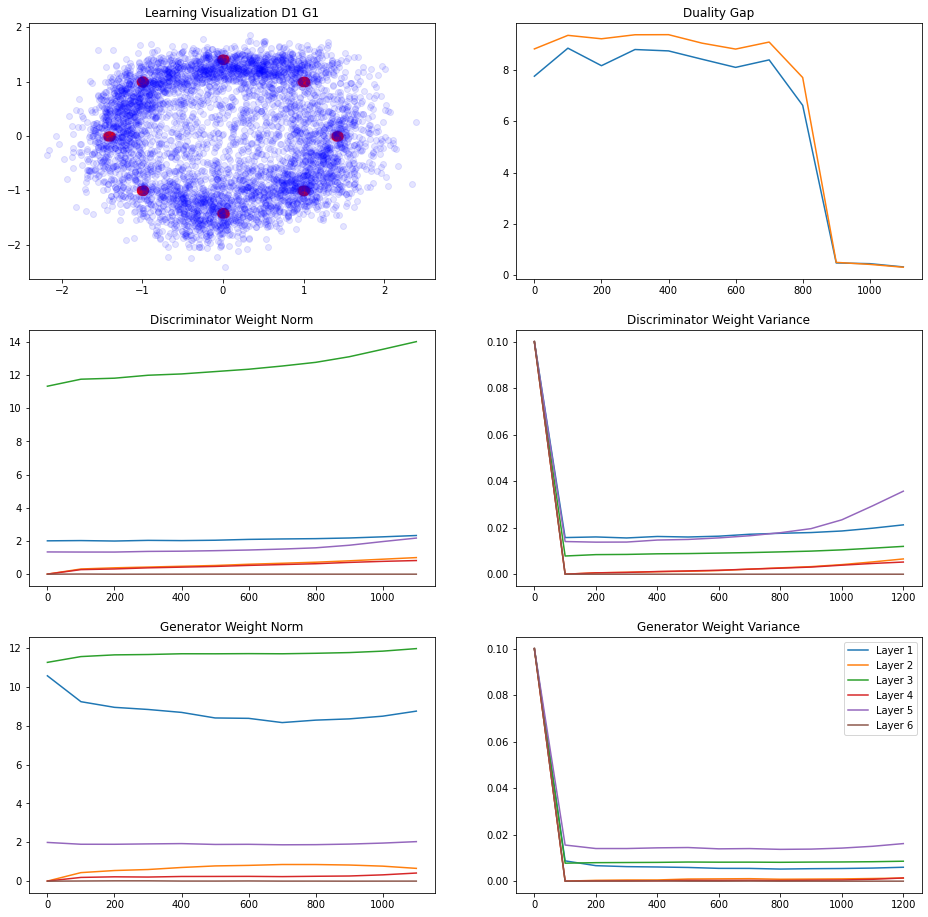

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.13616669
L Random  Duality Gap :  0.025789857


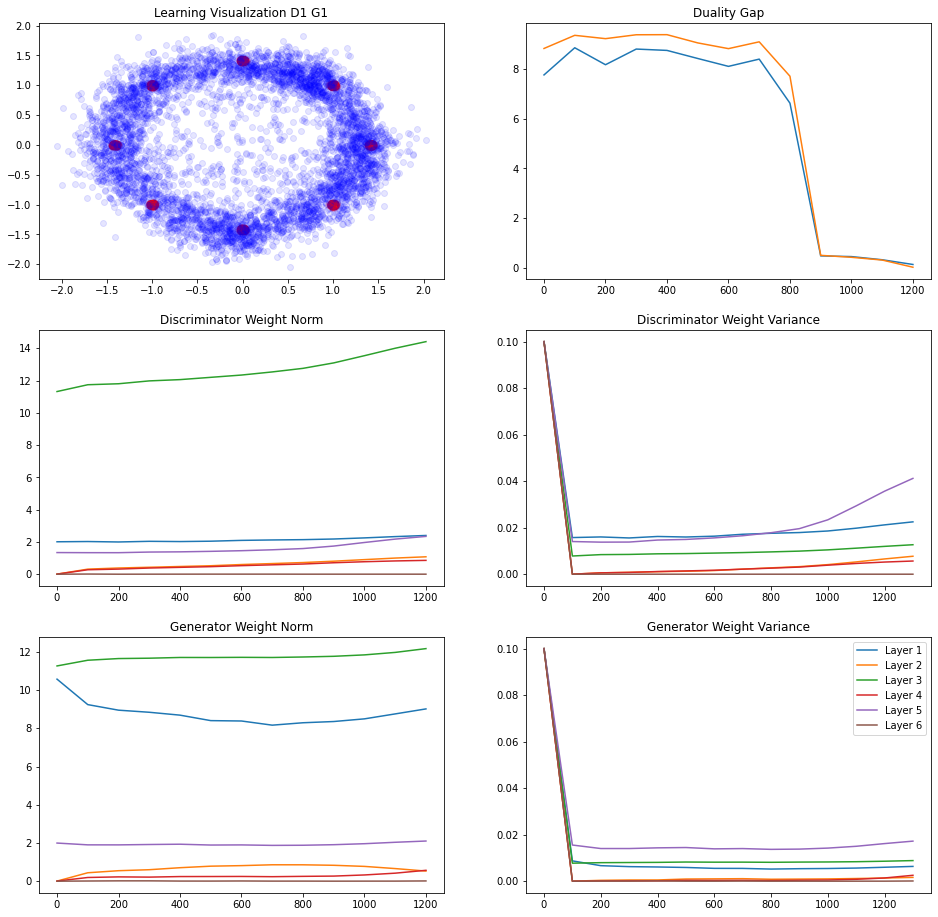

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.1279093
L Random  Duality Gap :  -0.12587297


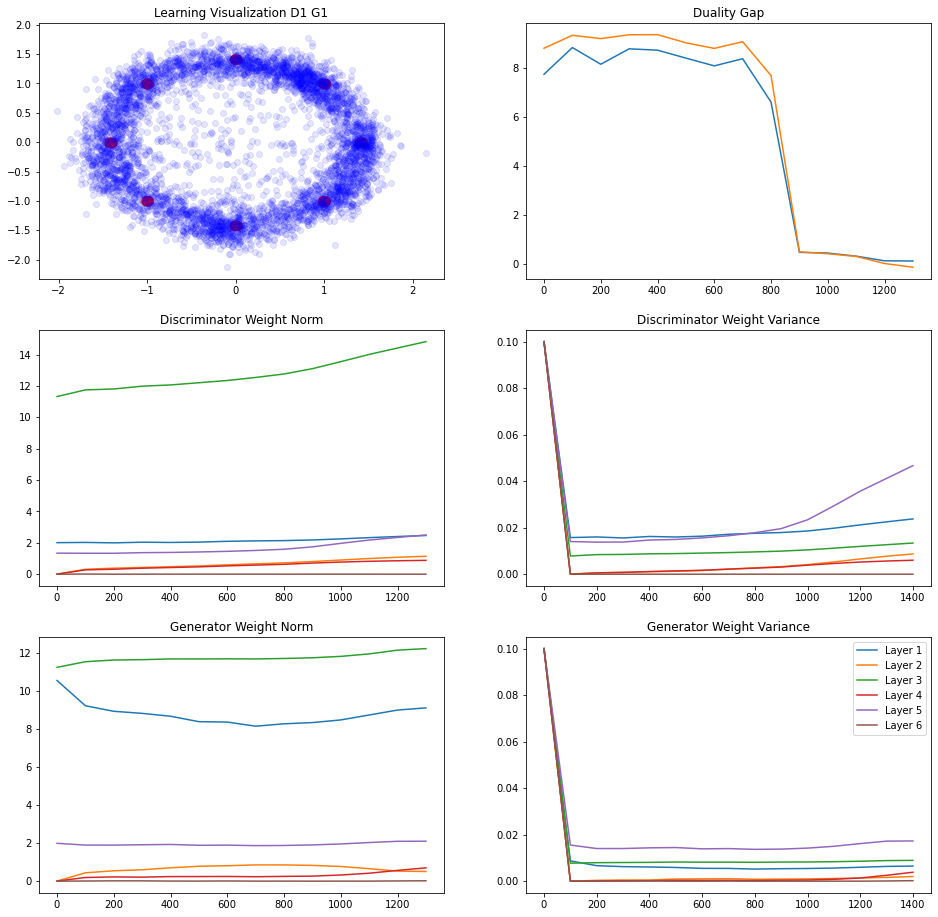

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.101329446
L Random  Duality Gap :  -0.10018623


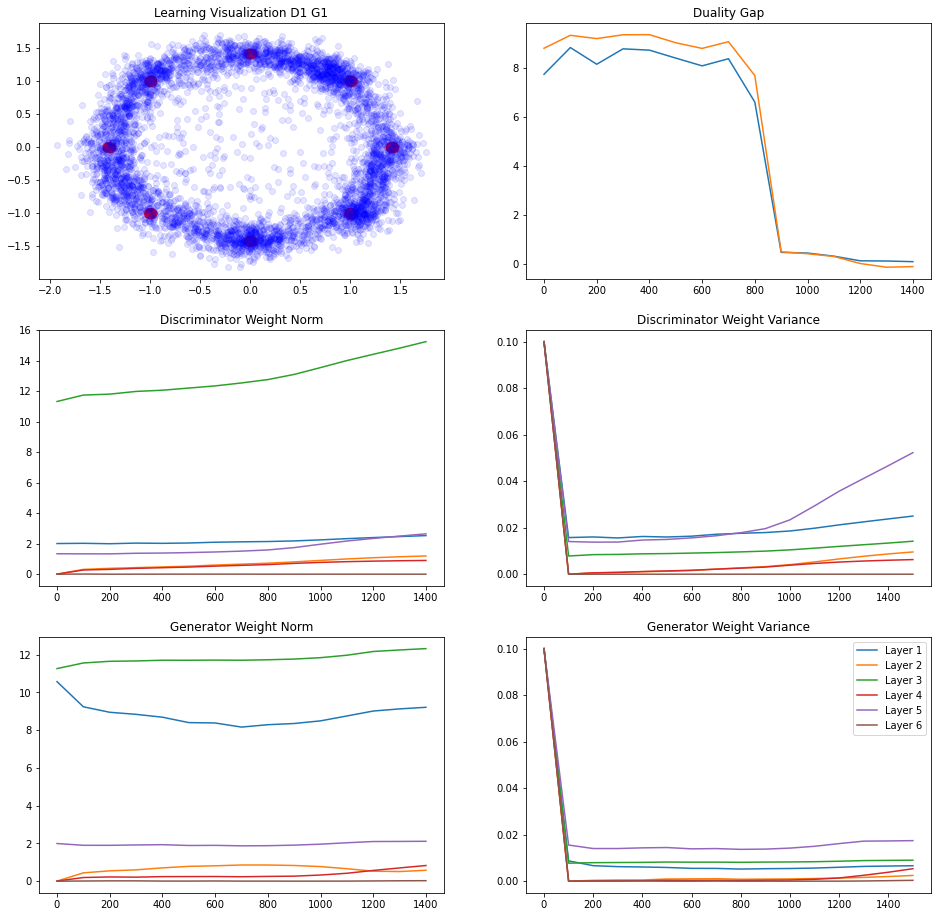

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.09028244
L Random  Duality Gap :  -0.21267956
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.10168707
L Random  Duality Gap :  -0.18286407


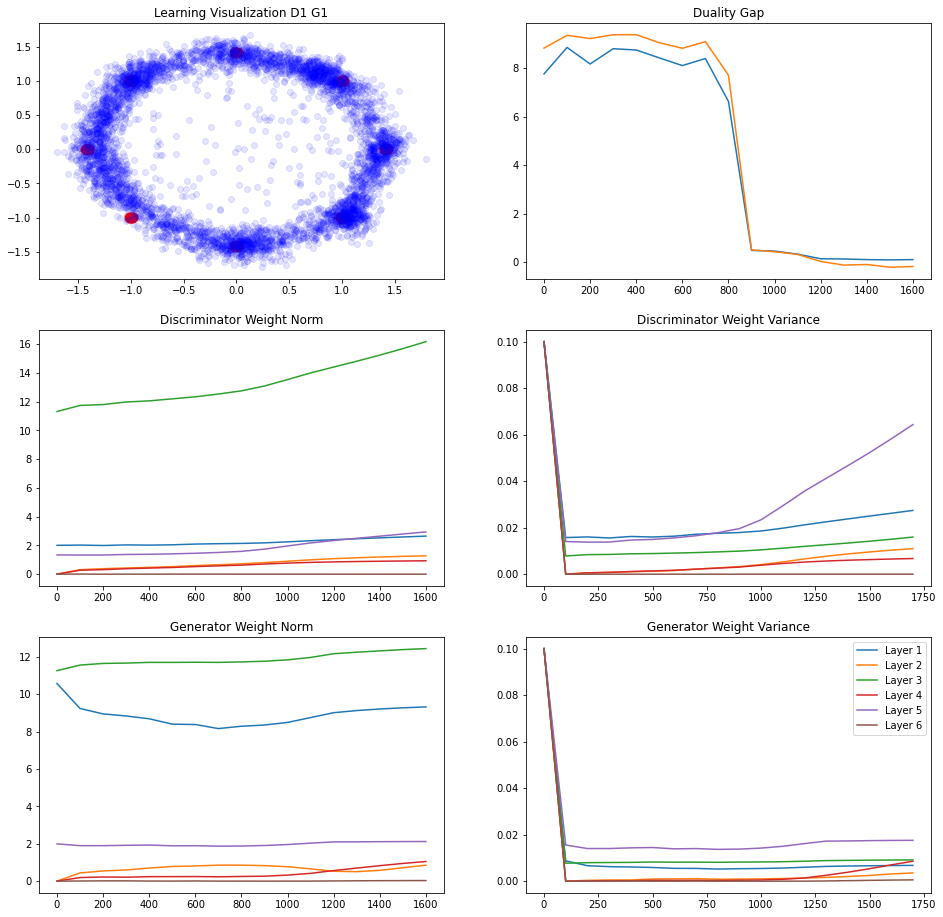

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.06943834
L Random  Duality Gap :  -0.41557497


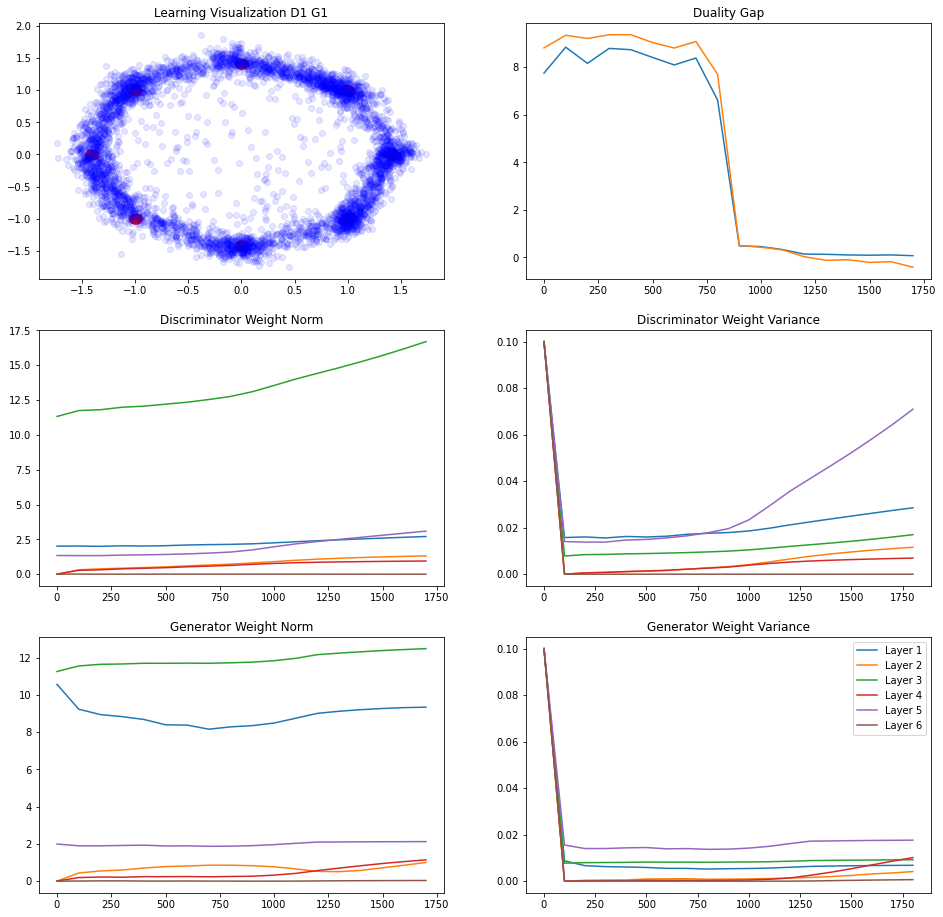

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.024853826
L Random  Duality Gap :  -0.27398843


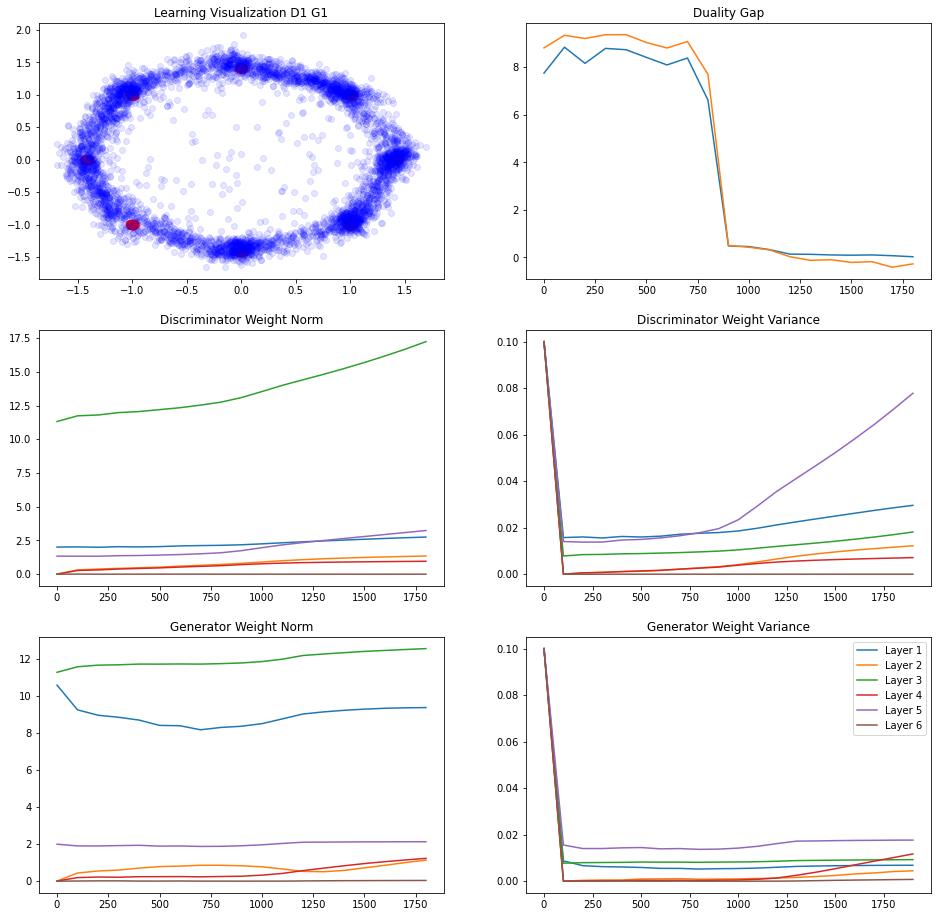

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.11548394
L Random  Duality Gap :  -0.40267003


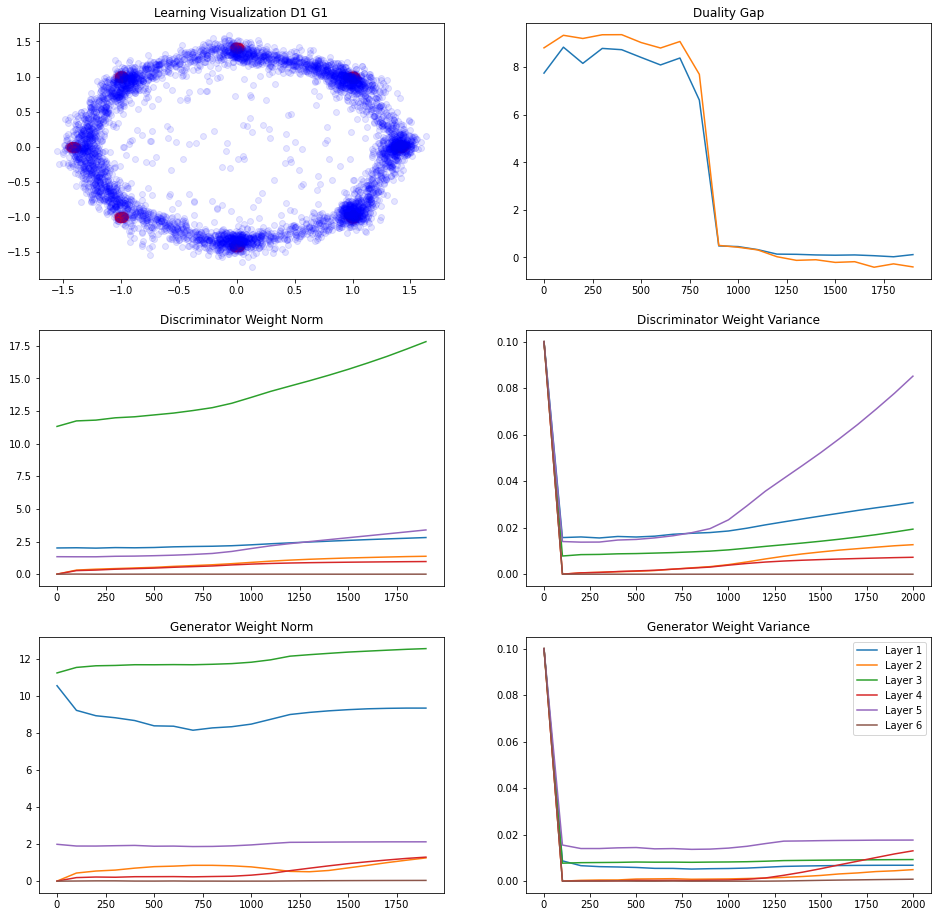

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.05511093
L Random  Duality Gap :  -0.38919067
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.06748748
L Random  Duality Gap :  -0.47848344


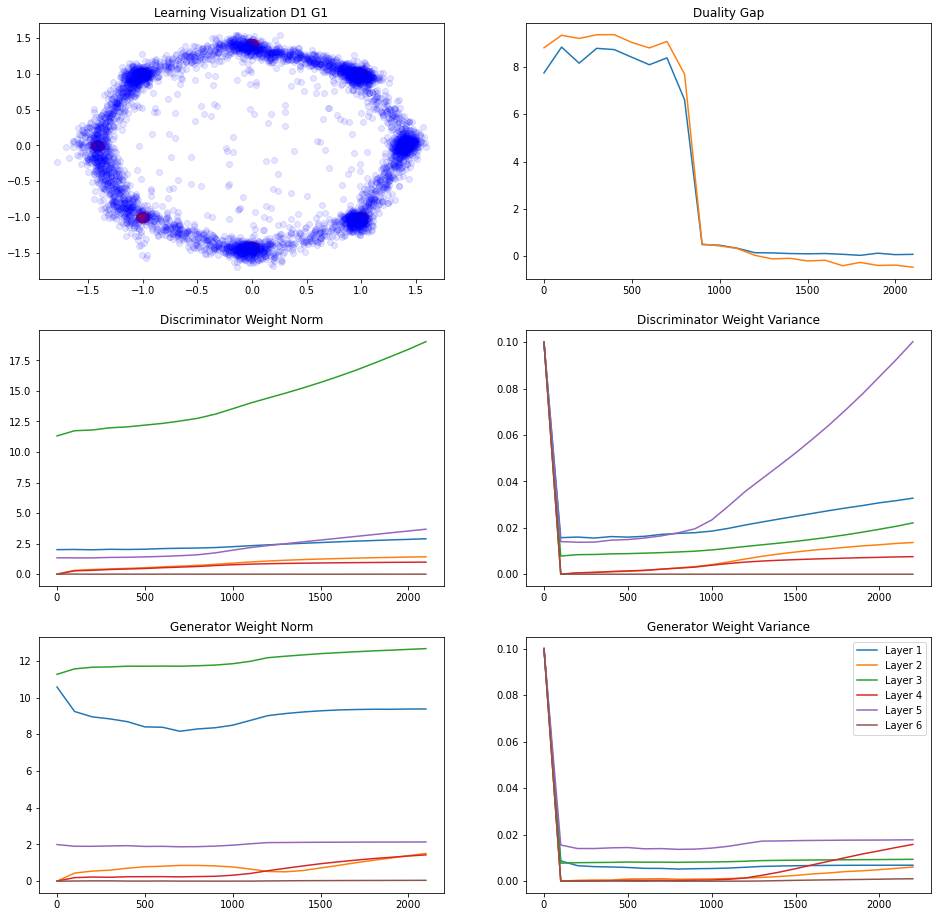

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.07268131
L Random  Duality Gap :  -0.45125175


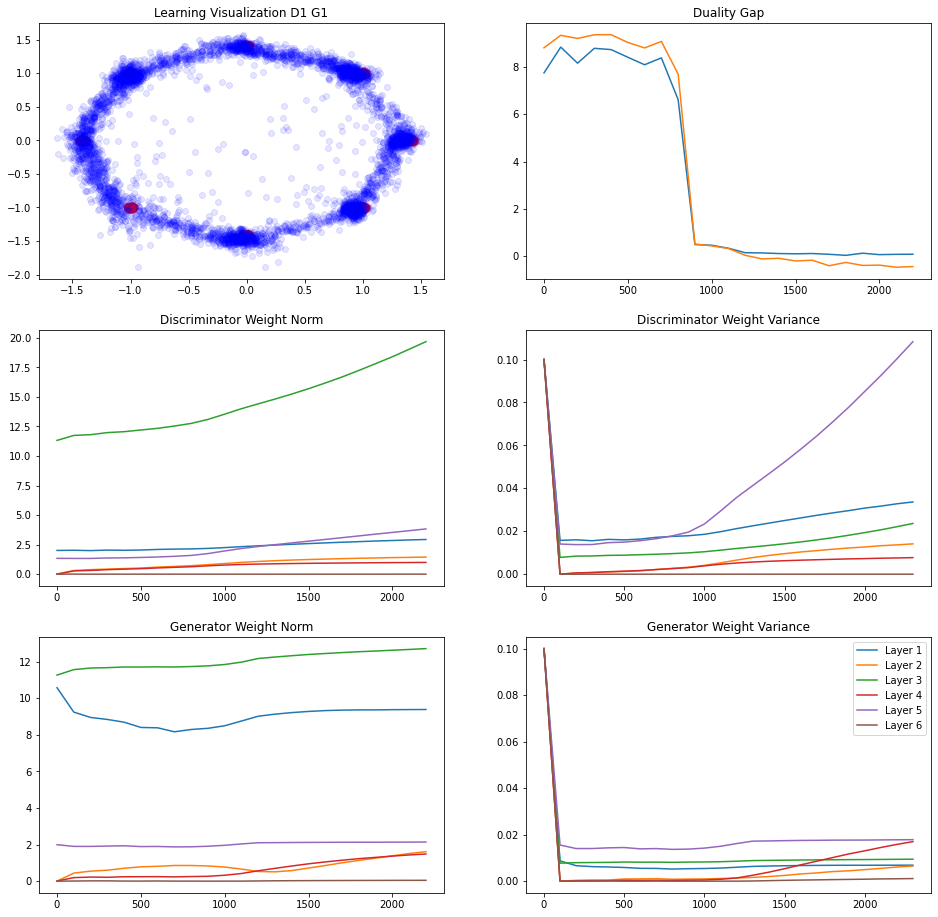

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.046924114
L Random  Duality Gap :  -0.51045185


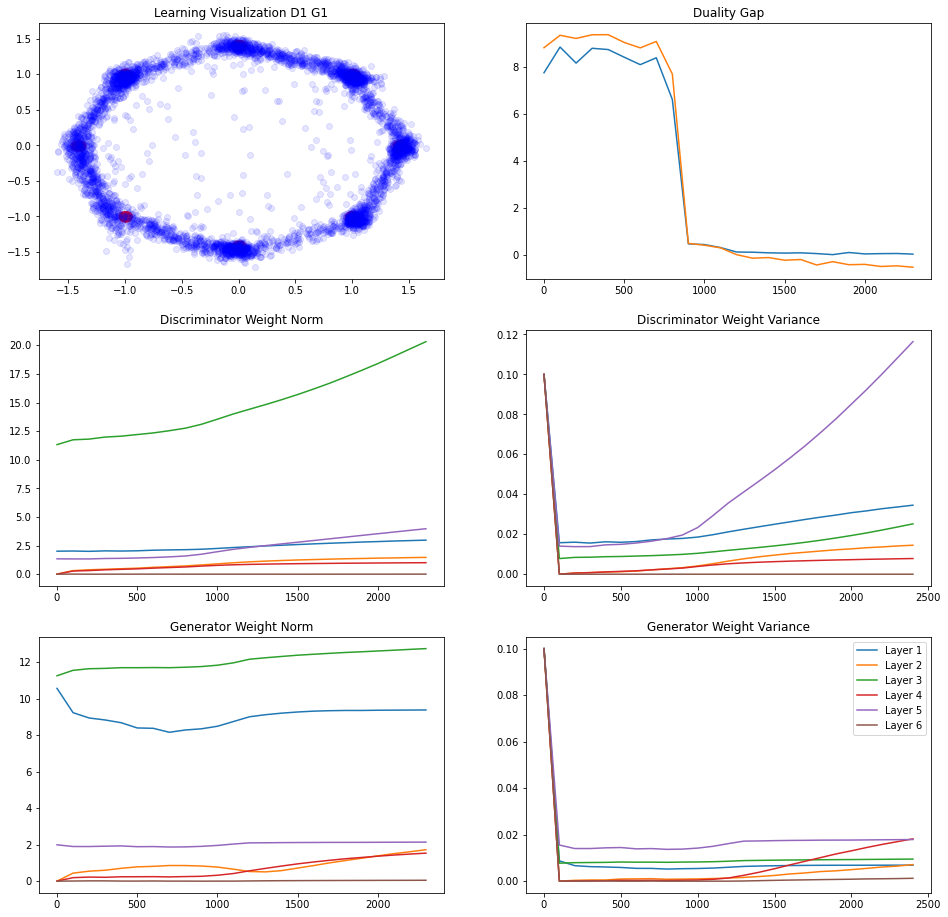

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.017071247
L Random  Duality Gap :  -0.53097683


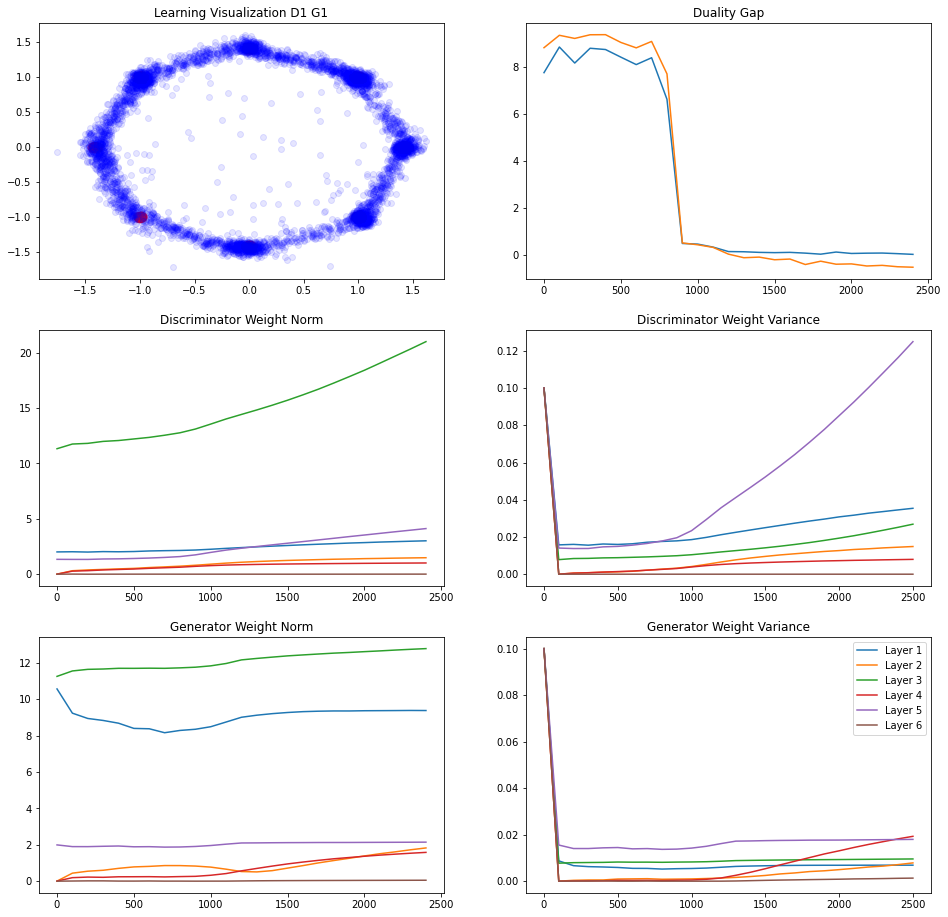

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.017394781
L Random  Duality Gap :  -0.56661165
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.030278325
L Random  Duality Gap :  -0.57514596


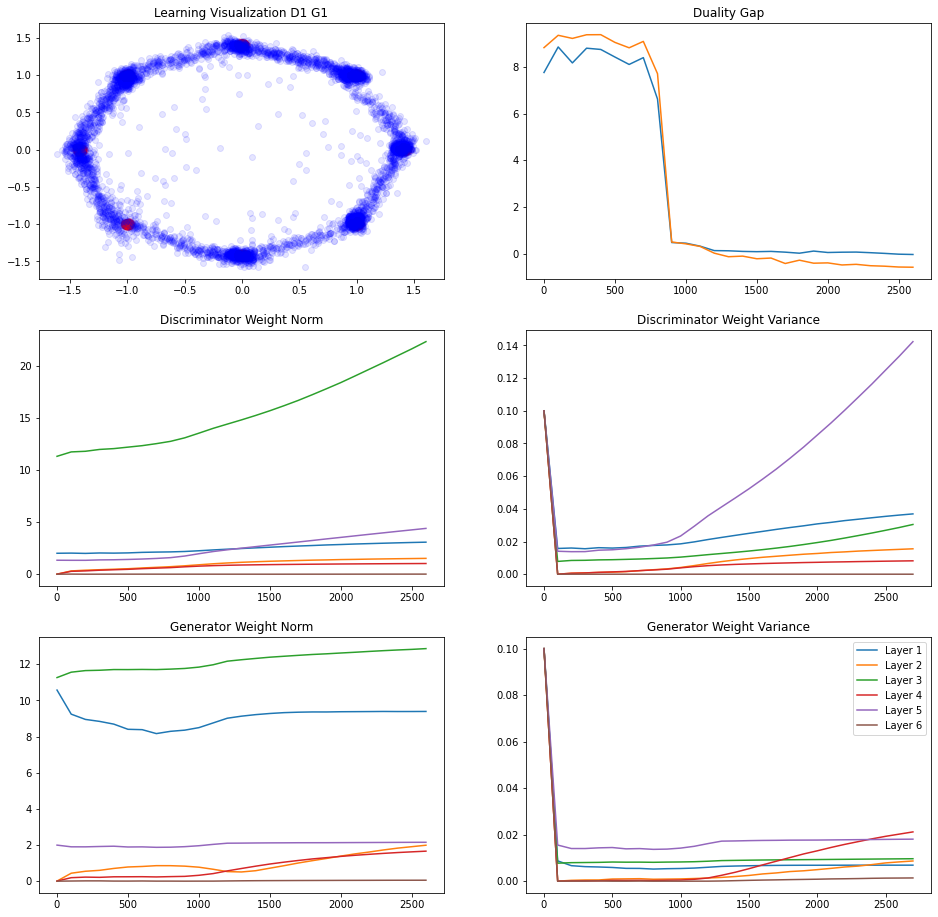

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.0052981973
L Random  Duality Gap :  -0.54787856


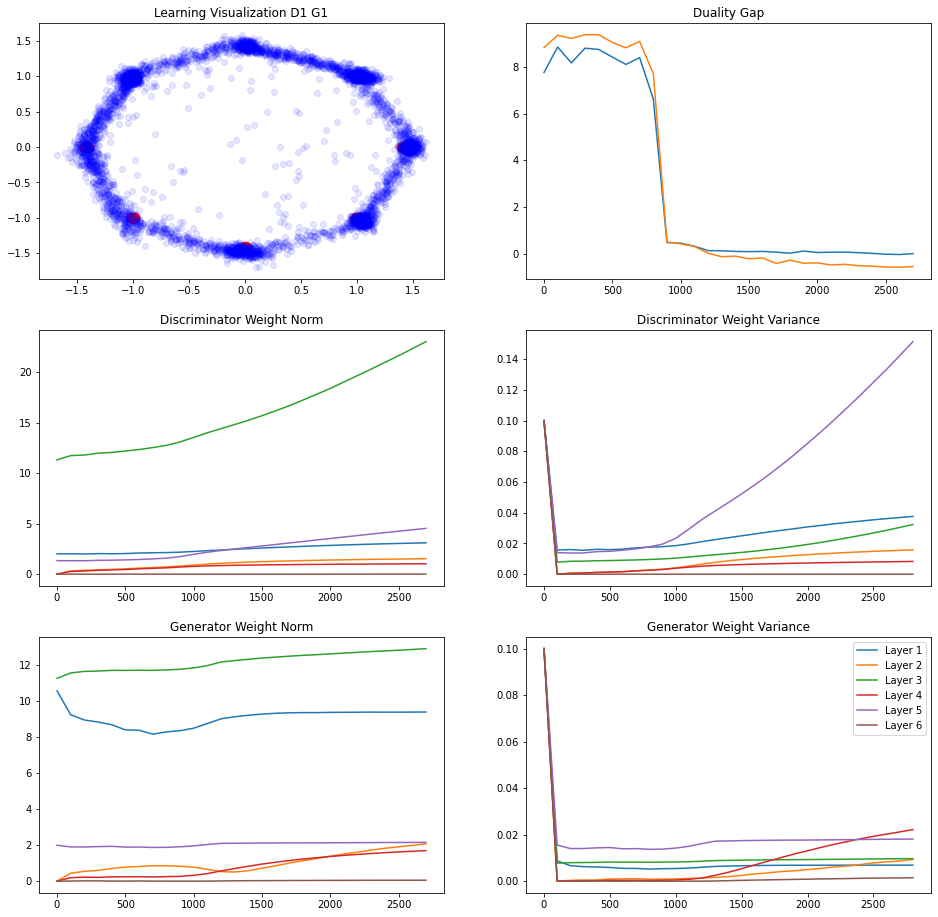

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.032759428
L Random  Duality Gap :  -0.5468804


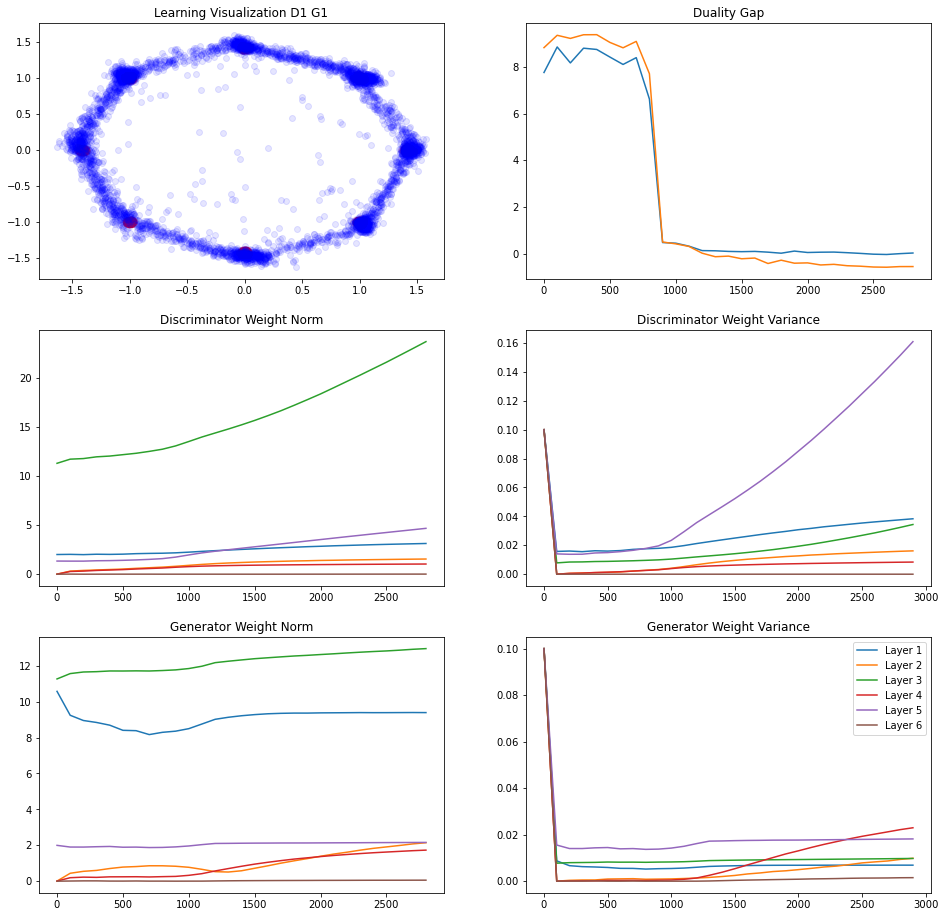

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.0667811
L Random  Duality Gap :  -0.56984586


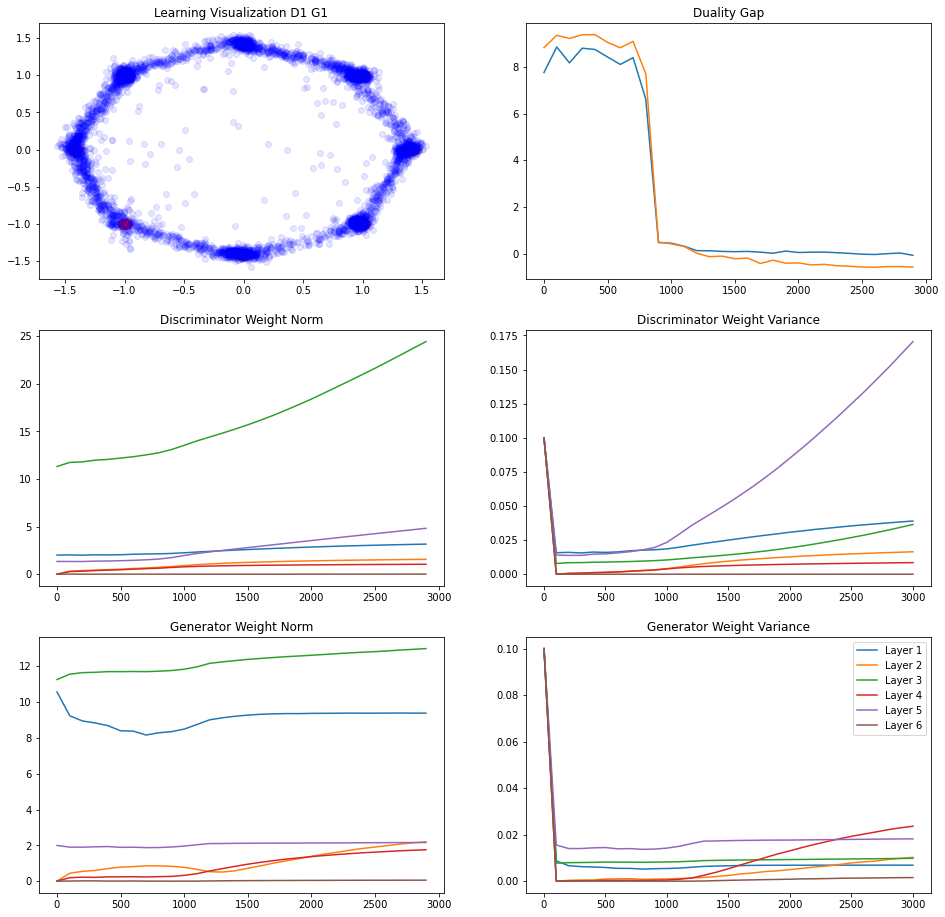

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.03850478
L Random  Duality Gap :  -0.53342116
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.16870451
L Random  Duality Gap :  -0.63524854


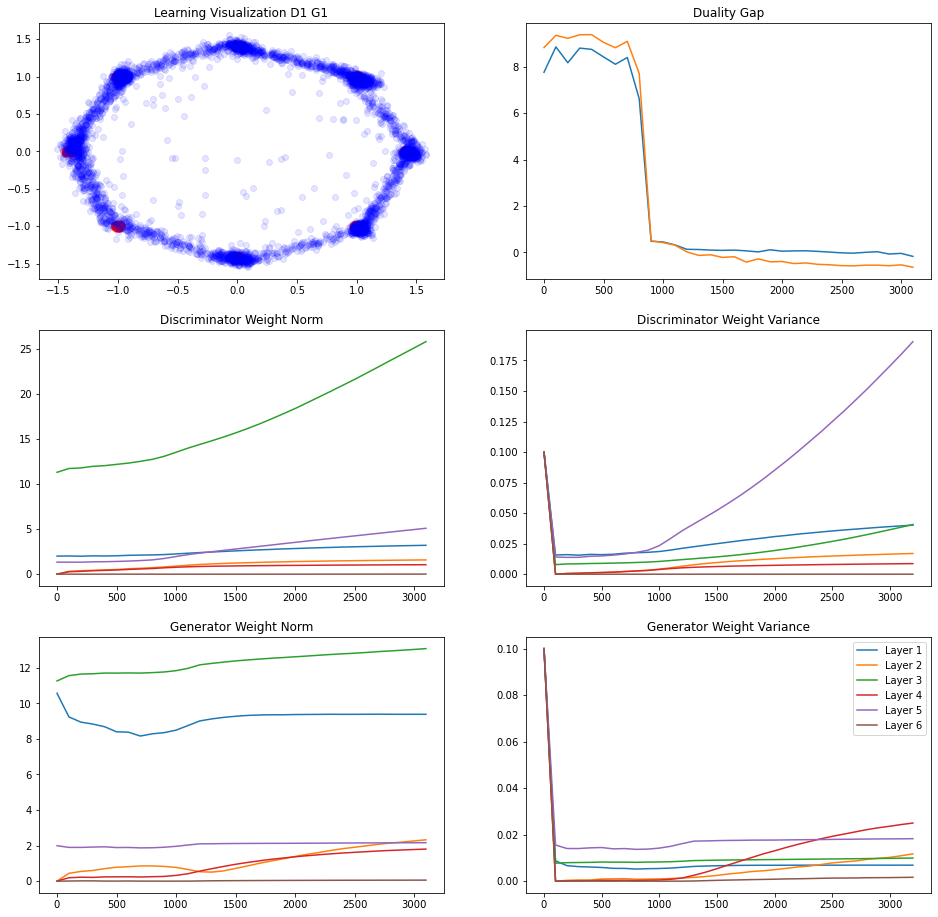

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.15405917
L Random  Duality Gap :  -0.64731944


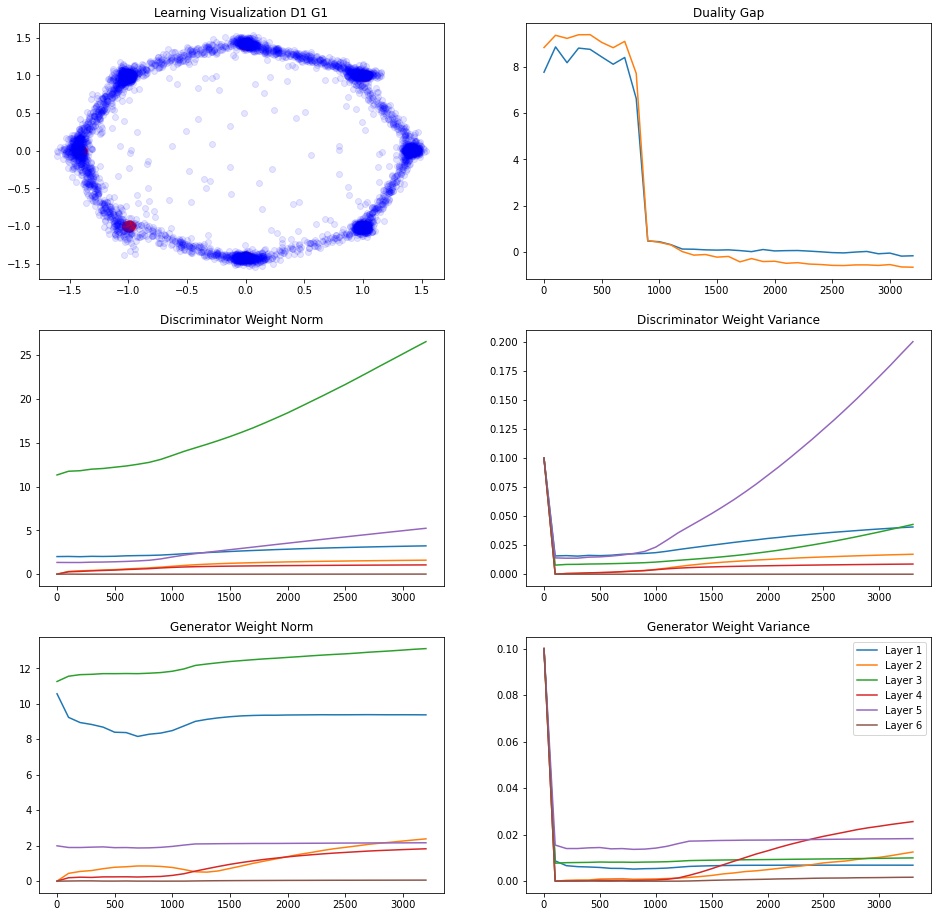

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.015912533
L Random  Duality Gap :  -0.56672996


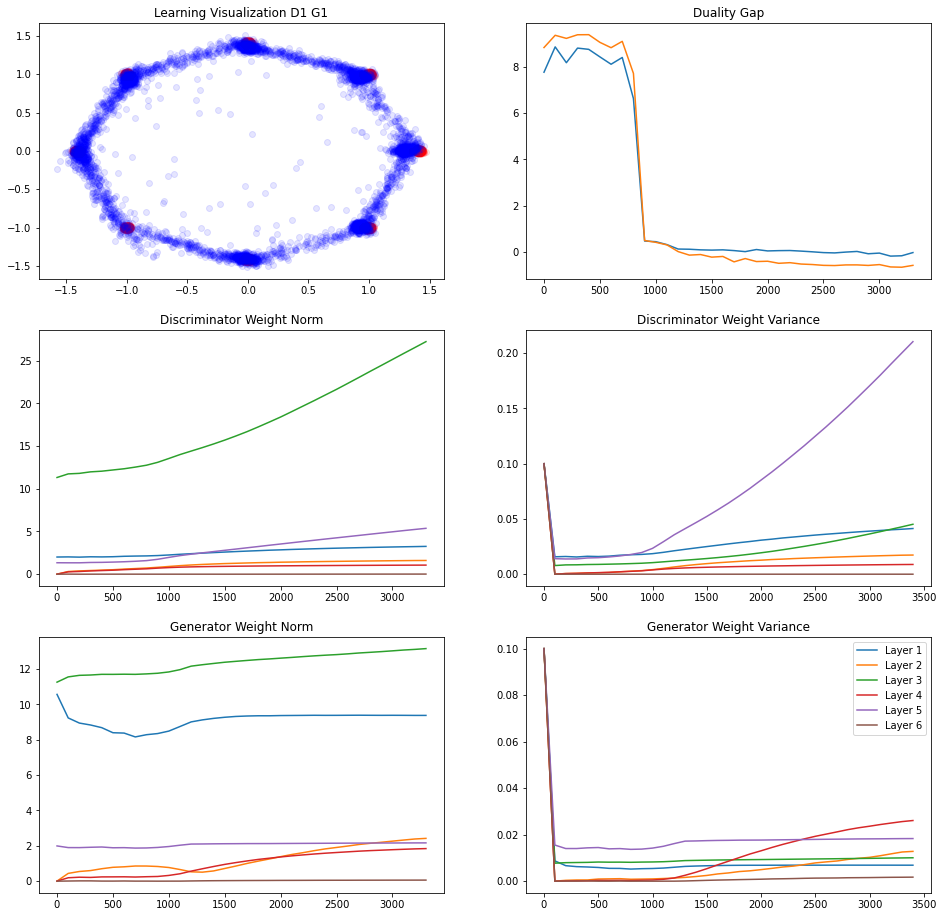

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.11385143
L Random  Duality Gap :  -0.6348085


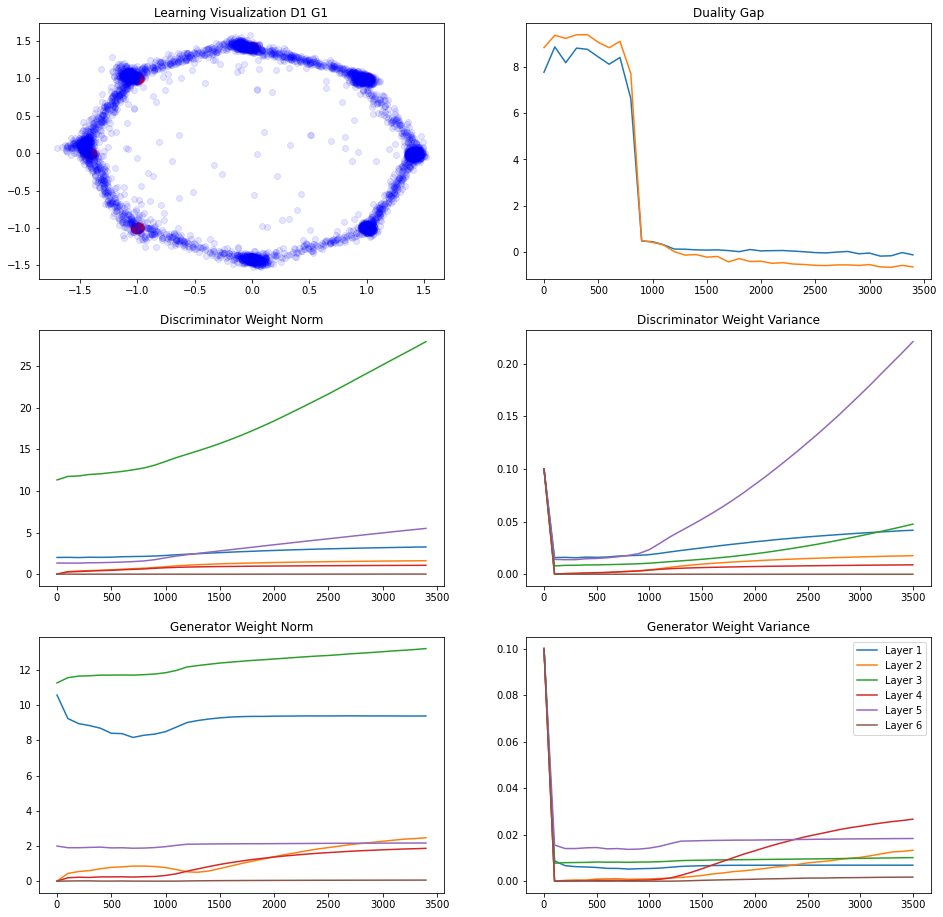

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.12779993
L Random  Duality Gap :  -0.69226474
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.16039008
L Random  Duality Gap :  -0.60637206


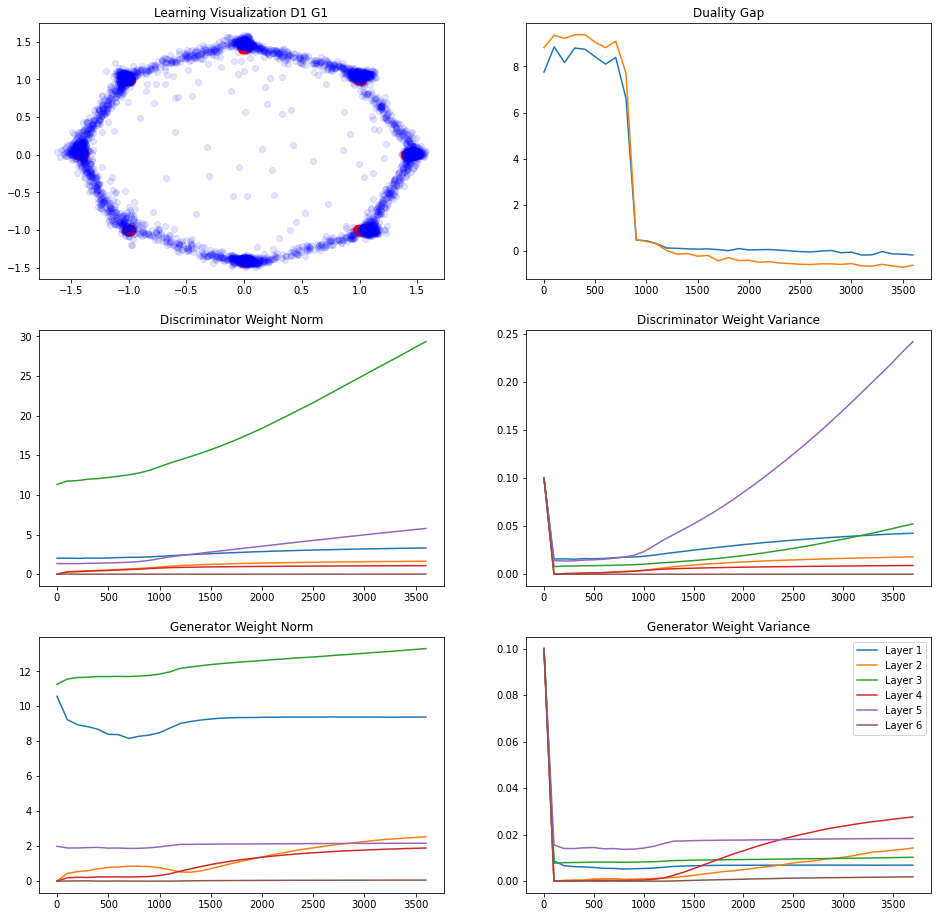

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.036242127
L Random  Duality Gap :  -0.6549118


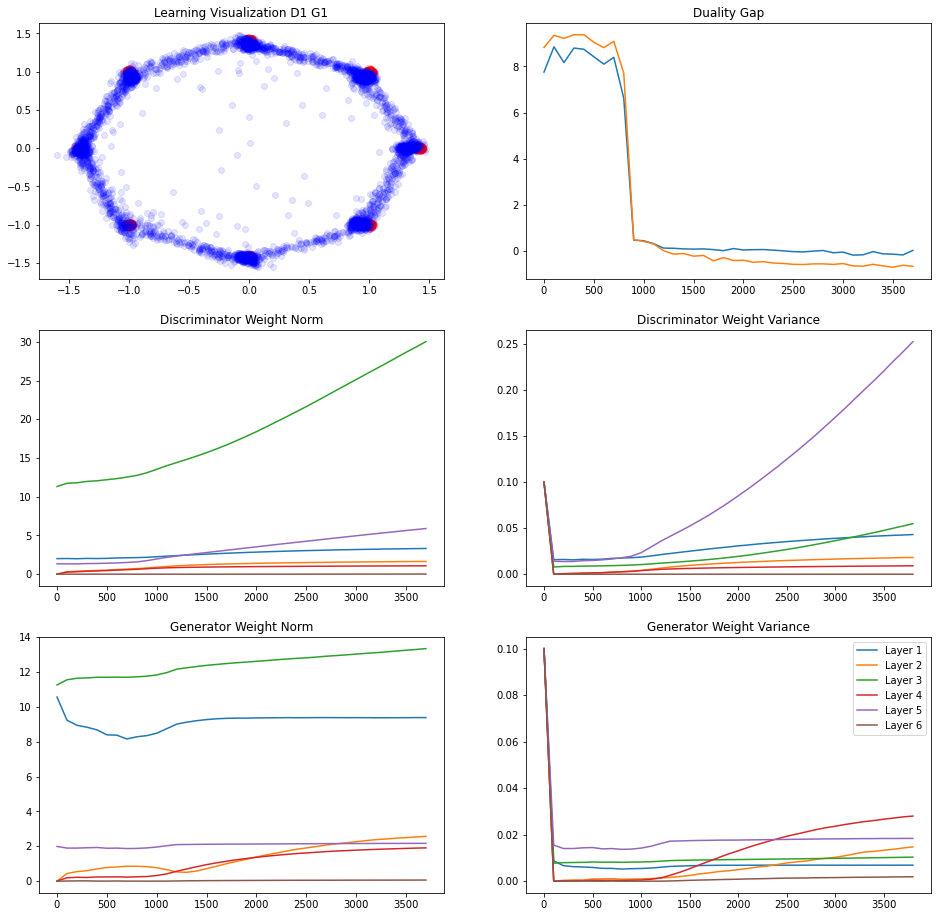

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.09677398
L Random  Duality Gap :  -0.6446303


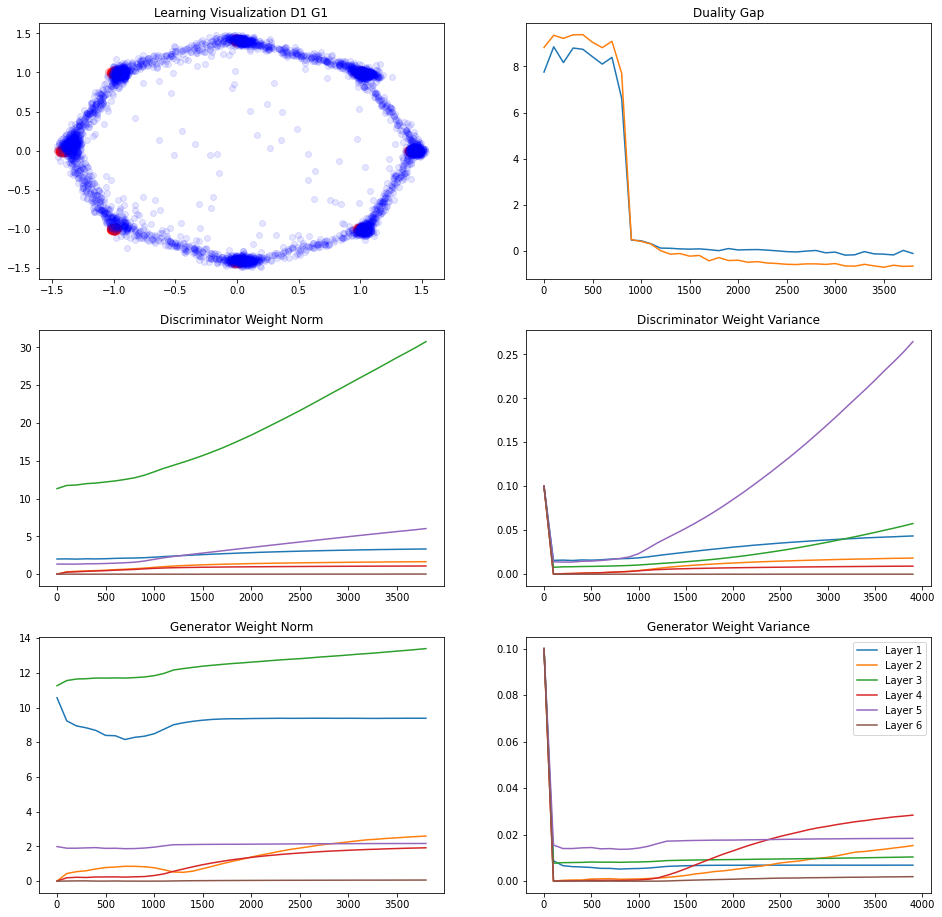

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.013929546
L Random  Duality Gap :  -0.63735104


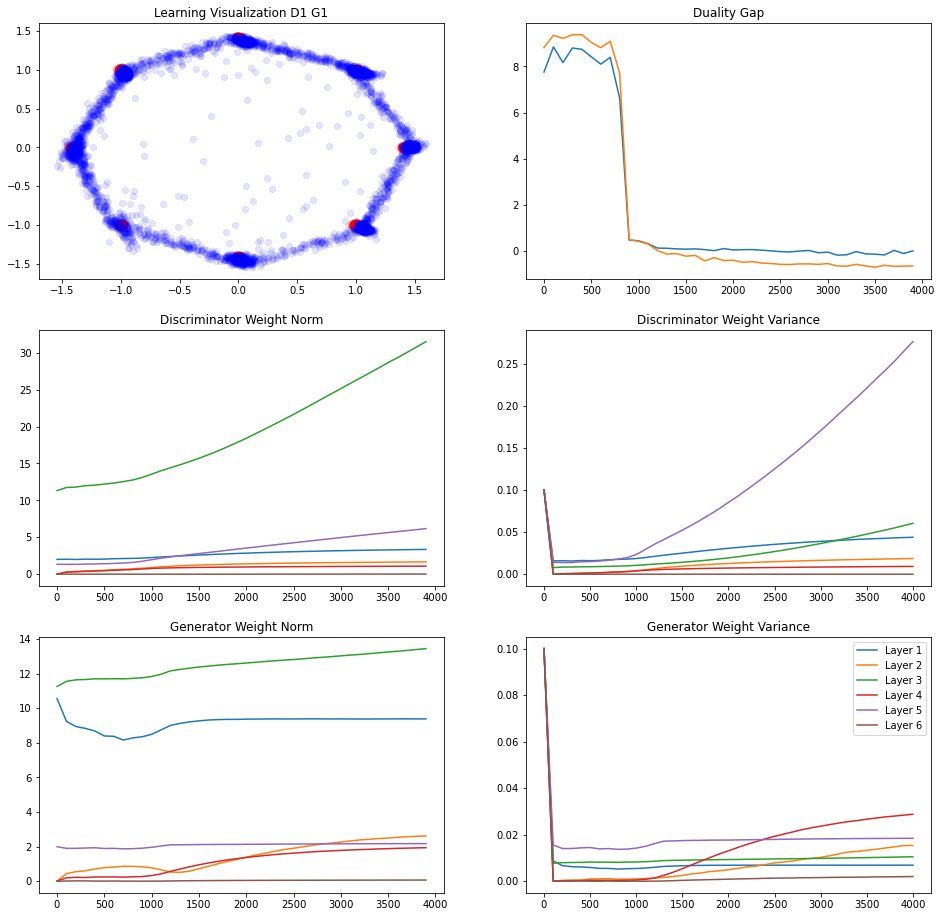

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.025325656
L Random  Duality Gap :  -0.5911752
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.15254772
L Random  Duality Gap :  -0.60903883


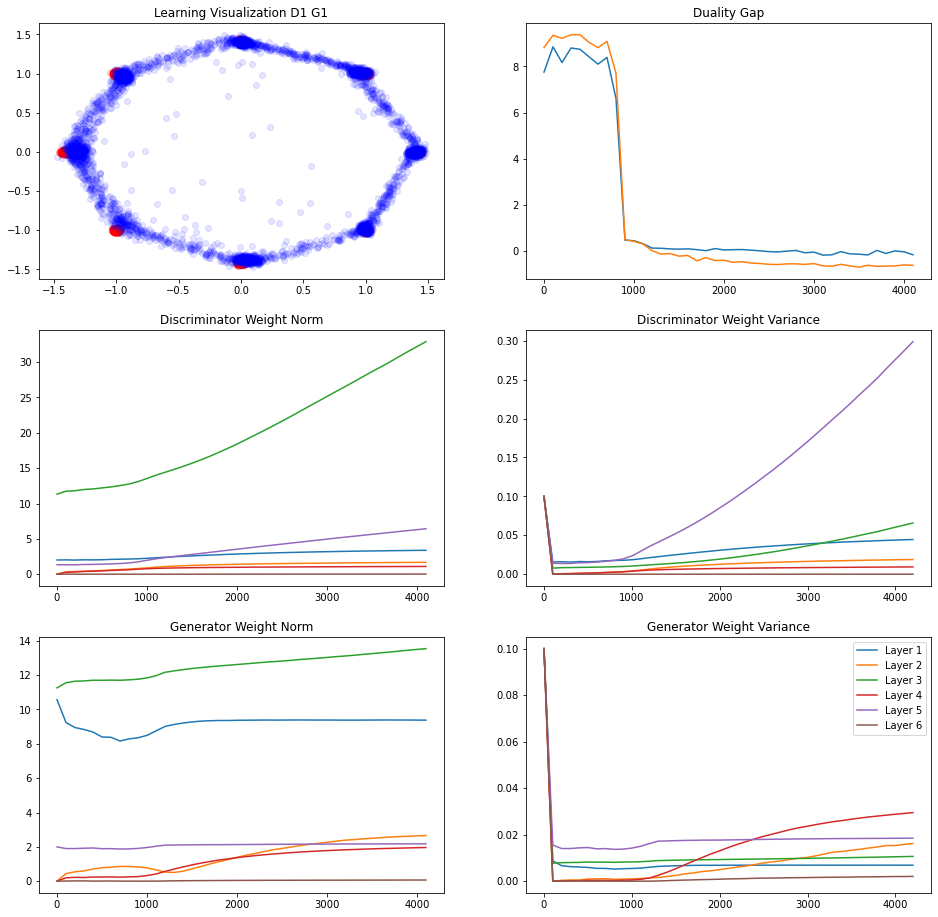

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.002442181
L Random  Duality Gap :  -0.5978836


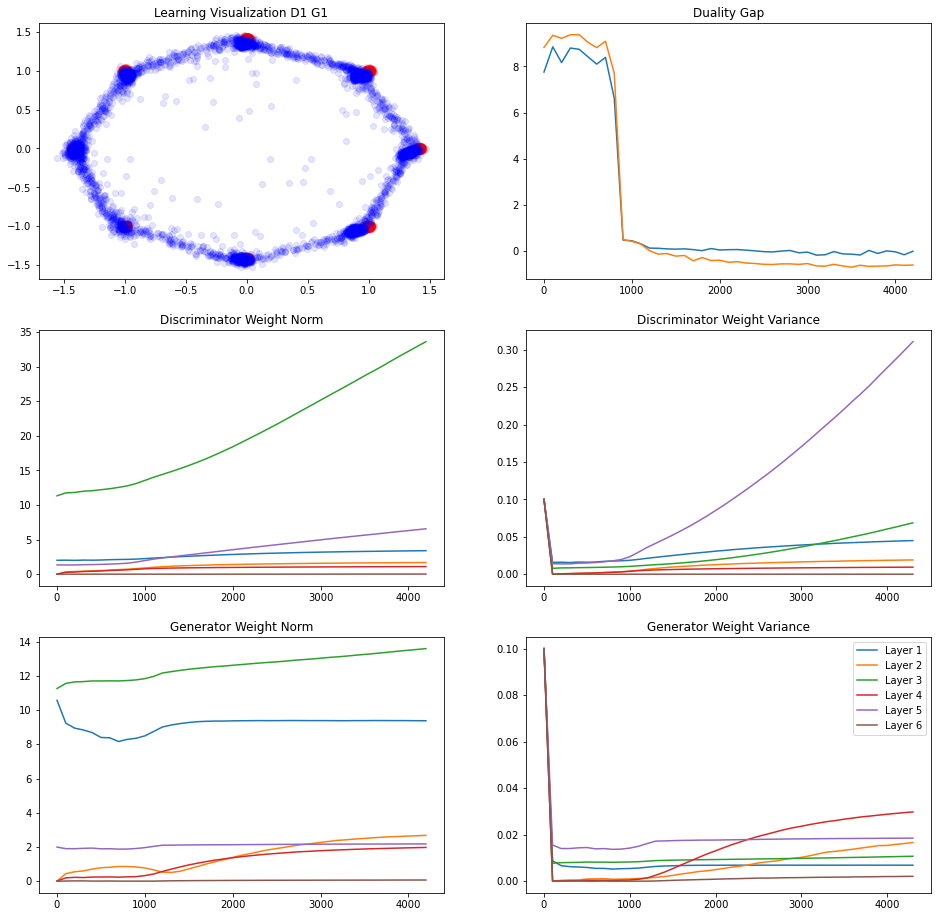

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.22556323
L Random  Duality Gap :  -0.69438183


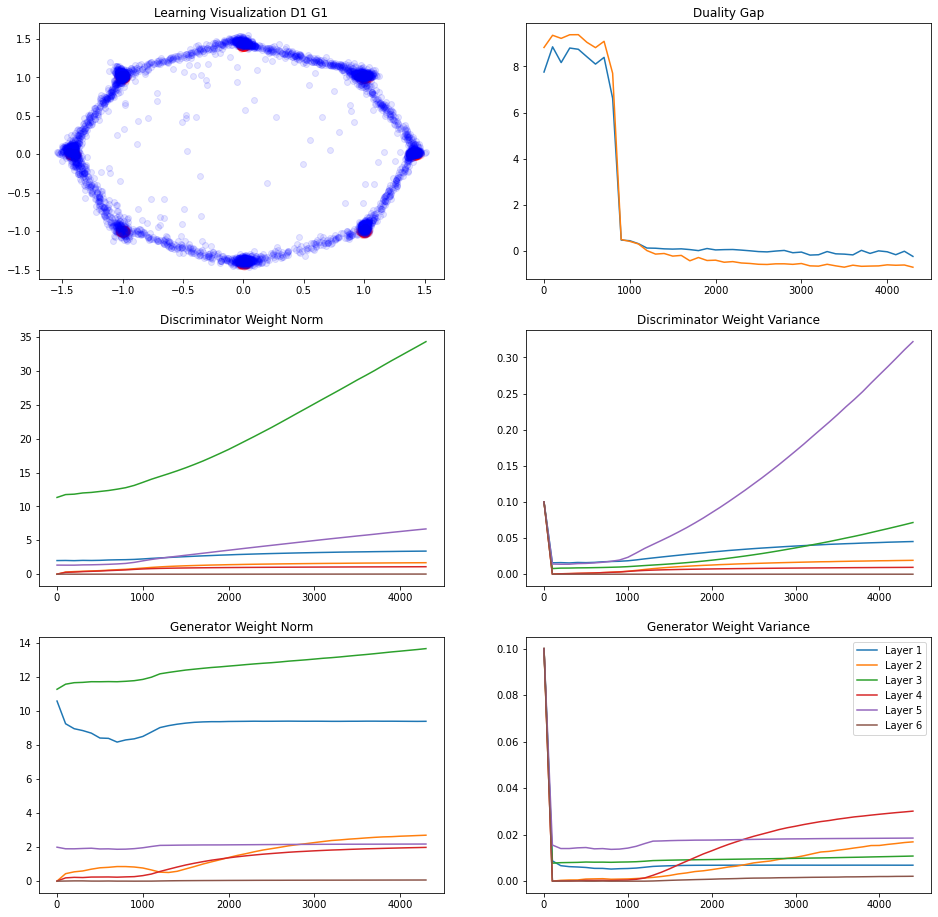

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.20079261
L Random  Duality Gap :  -0.67446876


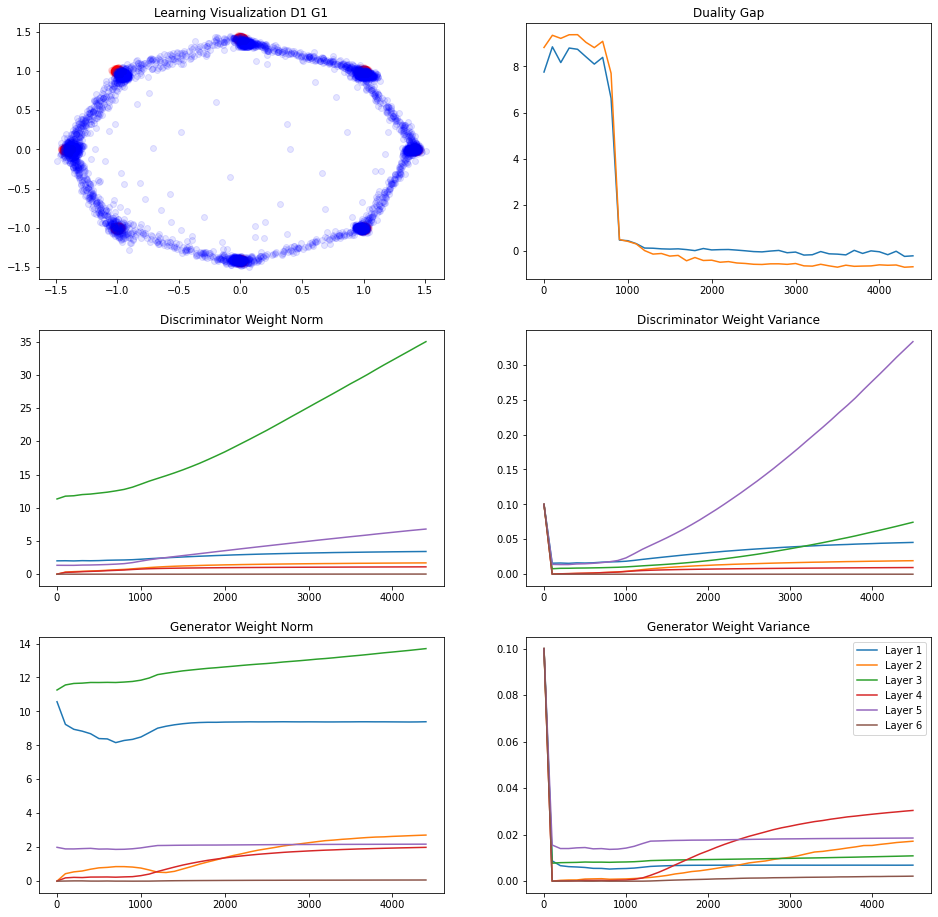

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.07913923
L Random  Duality Gap :  -0.6698663
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.19673353
L Random  Duality Gap :  -0.71727586


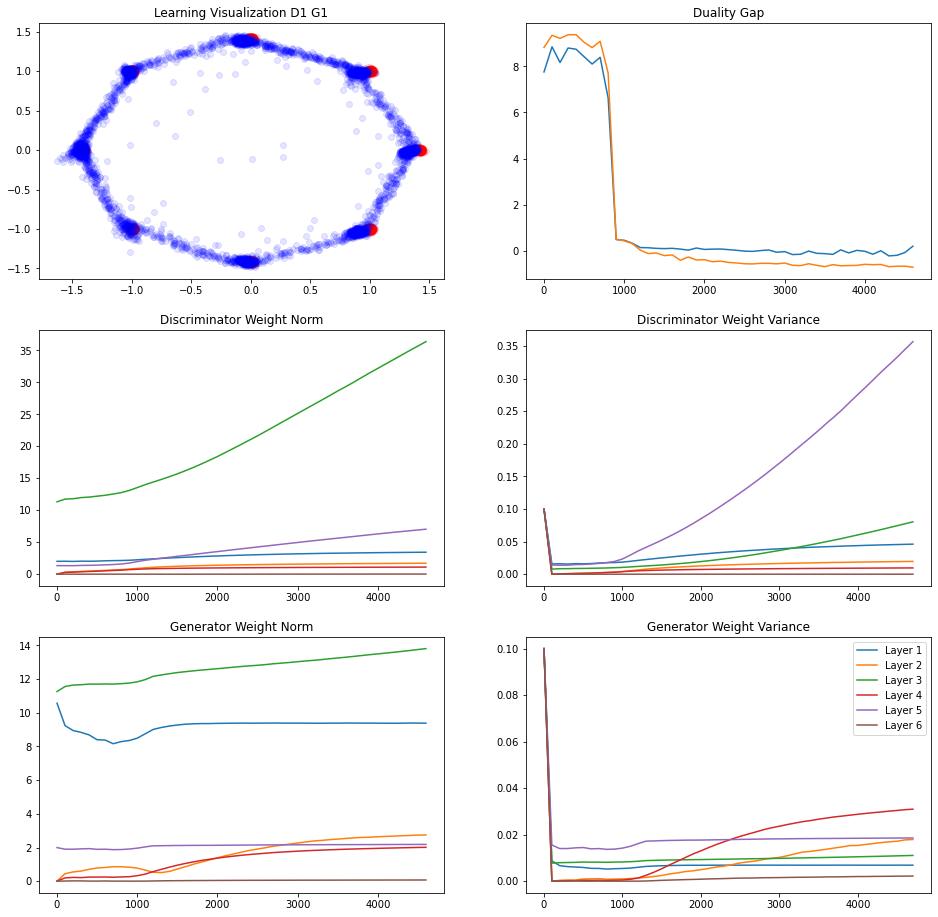

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.16994667
L Random  Duality Gap :  -0.7650984


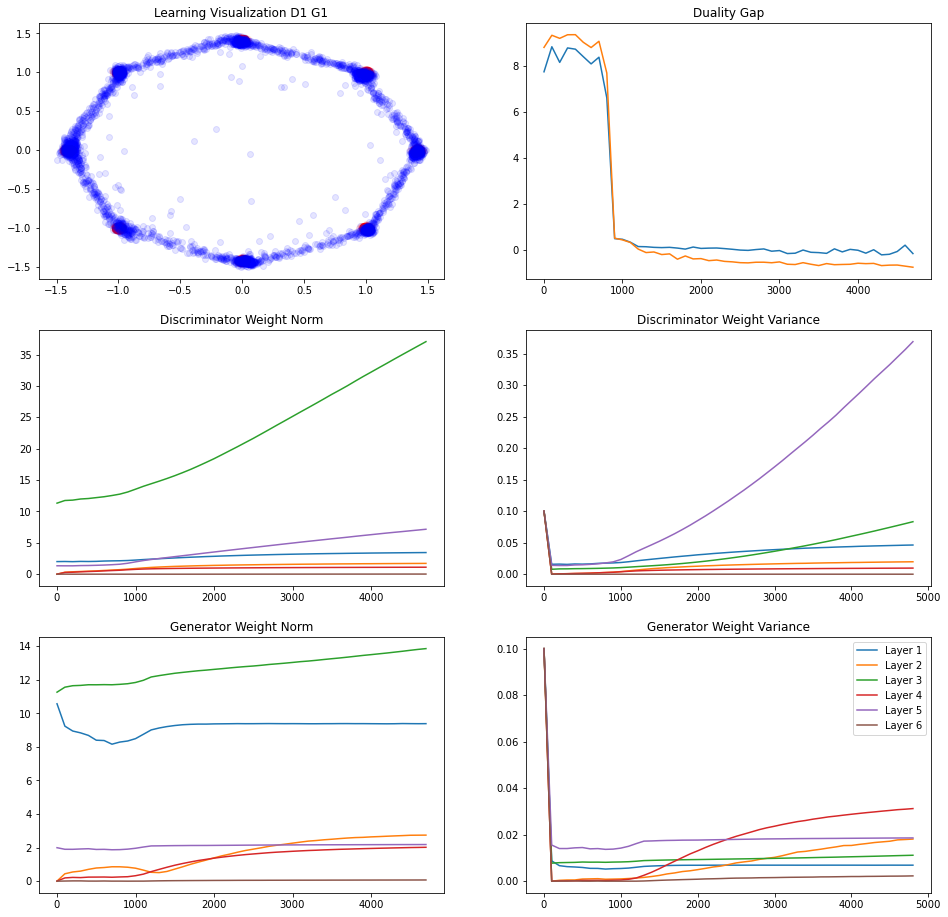

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.25731343
L Random  Duality Gap :  -0.67815155


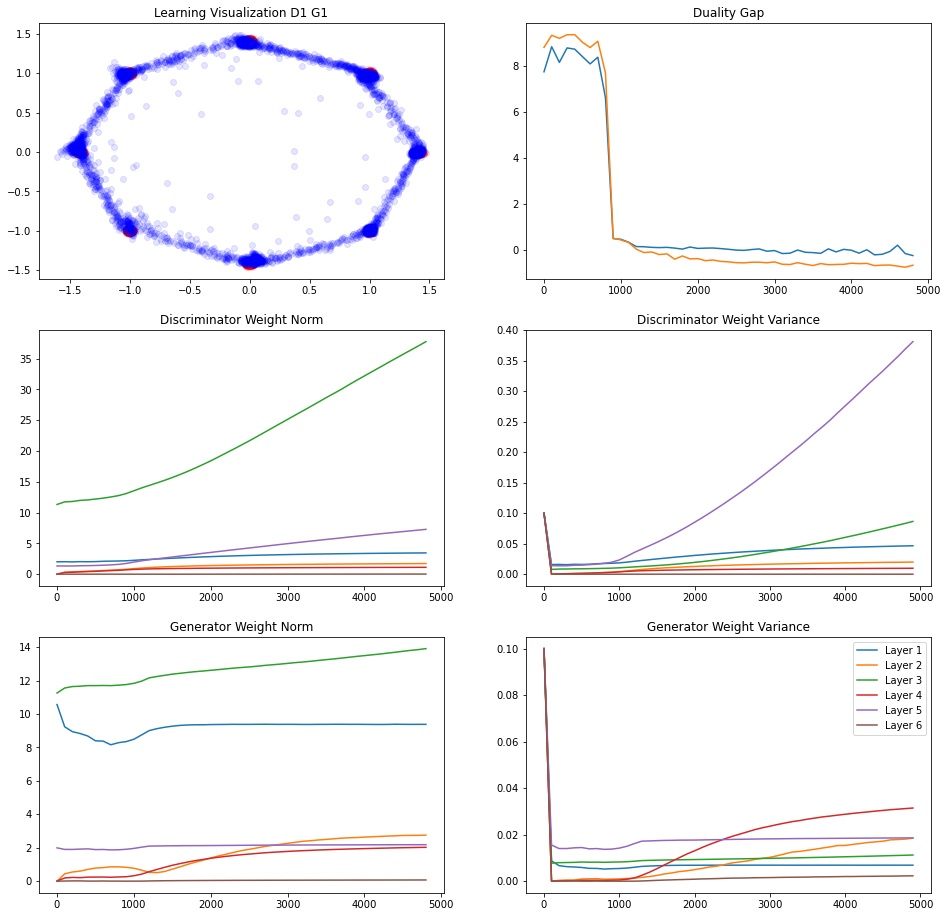

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.027516544
L Random  Duality Gap :  -0.7134526


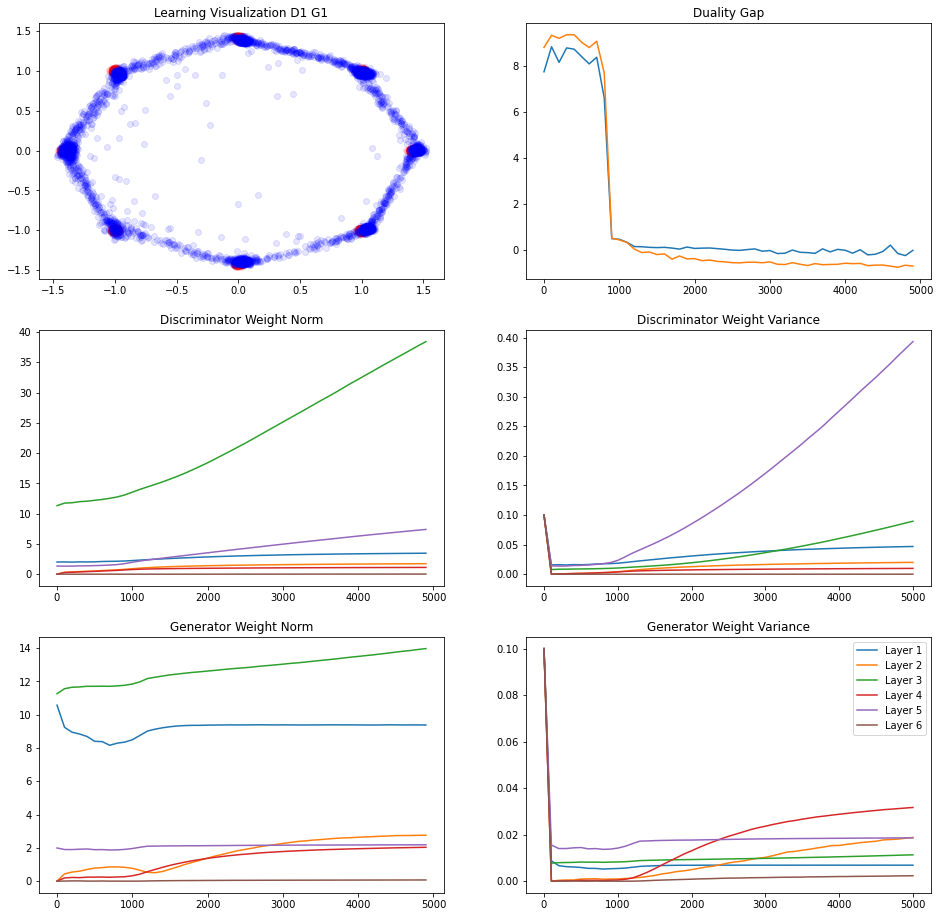

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.23101711
L Random  Duality Gap :  -0.7080121
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.18092096
L Random  Duality Gap :  -0.68697035


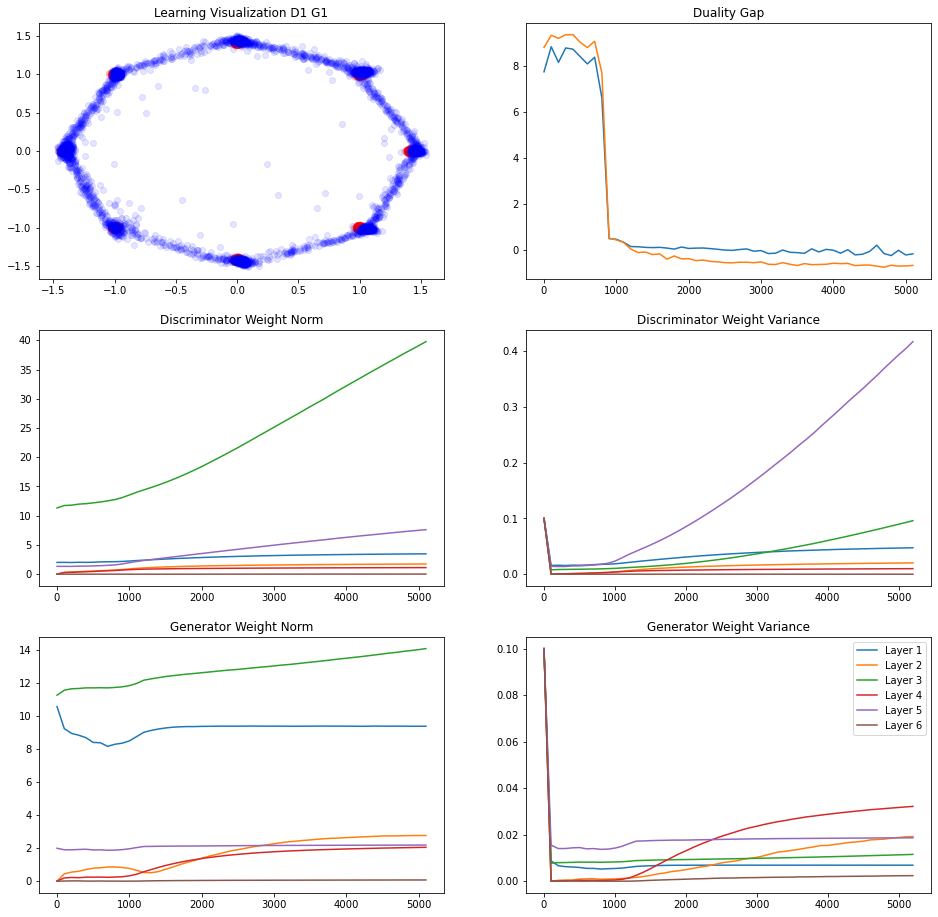

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.17568016
L Random  Duality Gap :  -0.6378473


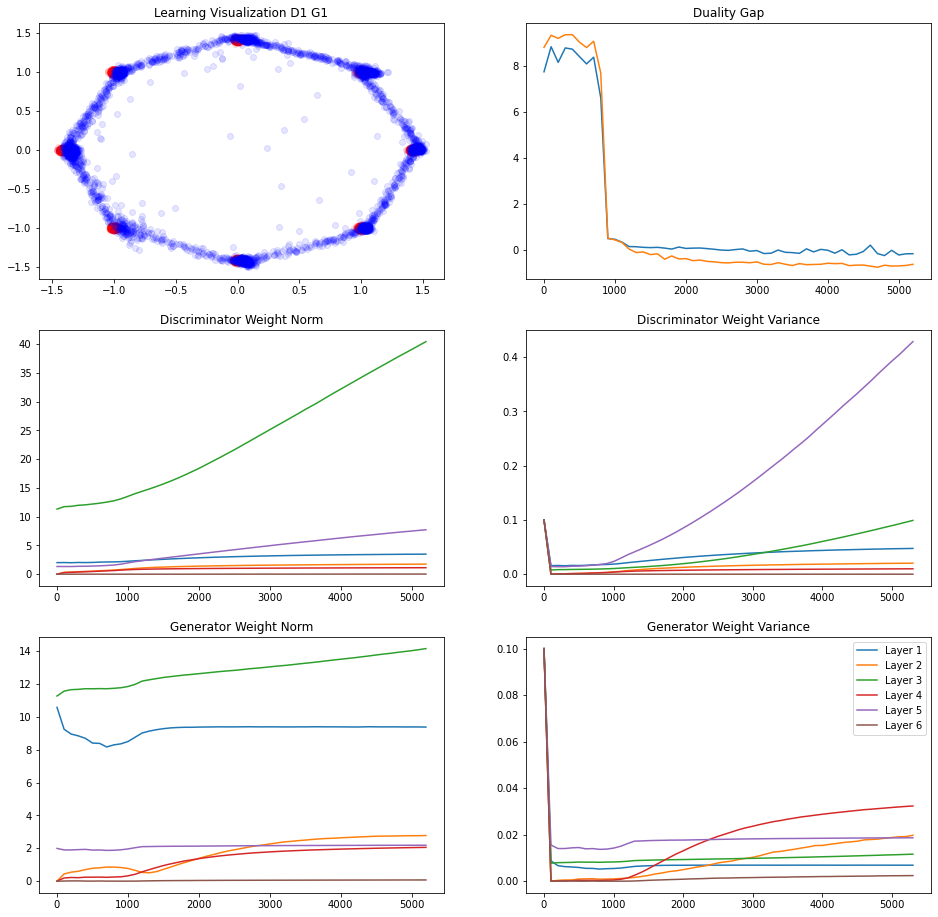

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.20160776
L Random  Duality Gap :  -0.7314355


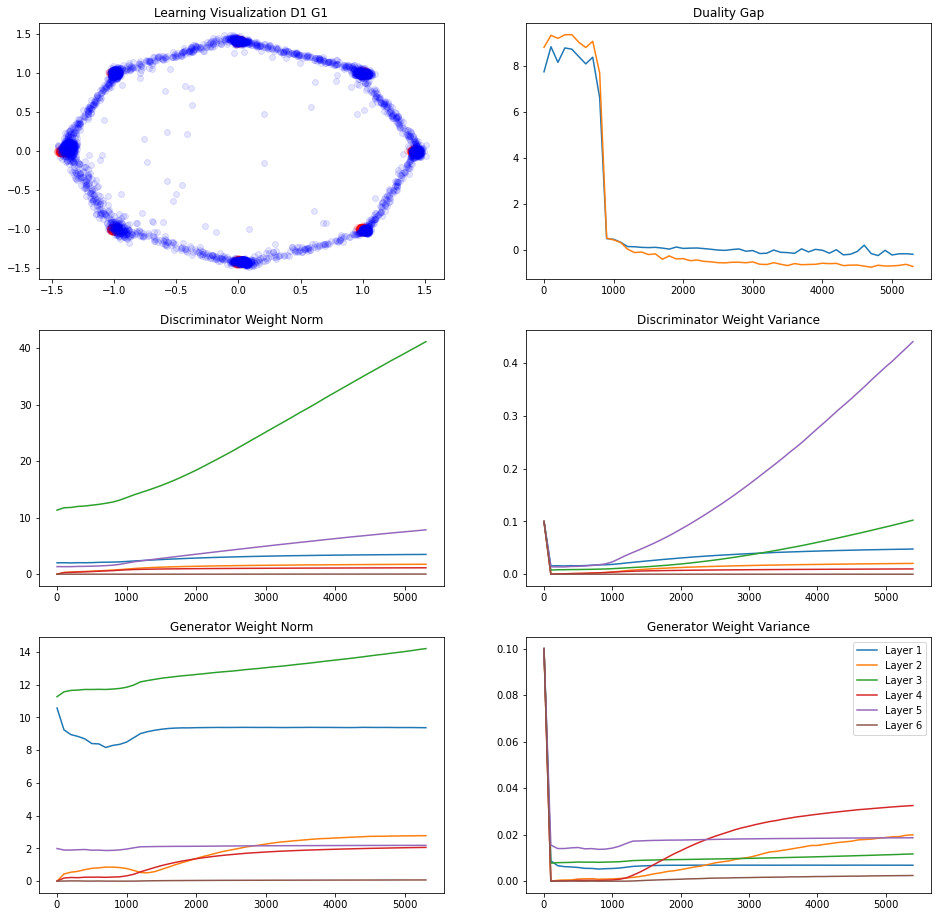

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.263857
L Random  Duality Gap :  -0.6207047


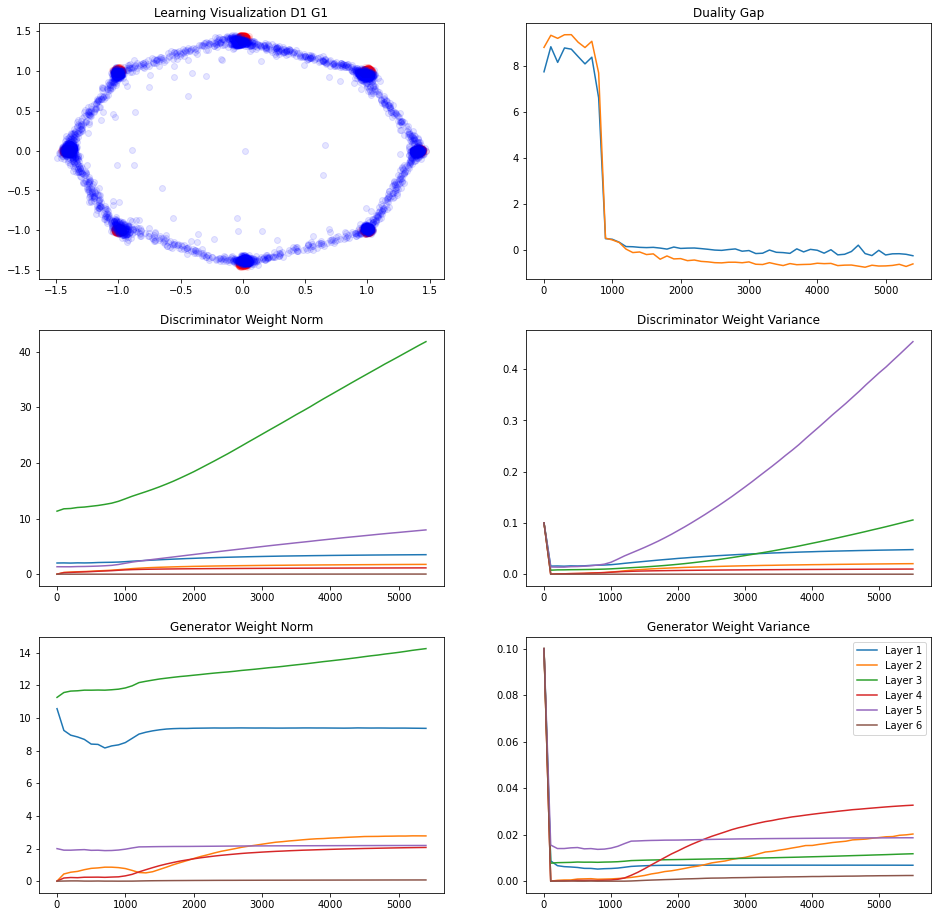

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.28012562
L Random  Duality Gap :  -0.7486918
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.005135596
L Random  Duality Gap :  -0.5727117


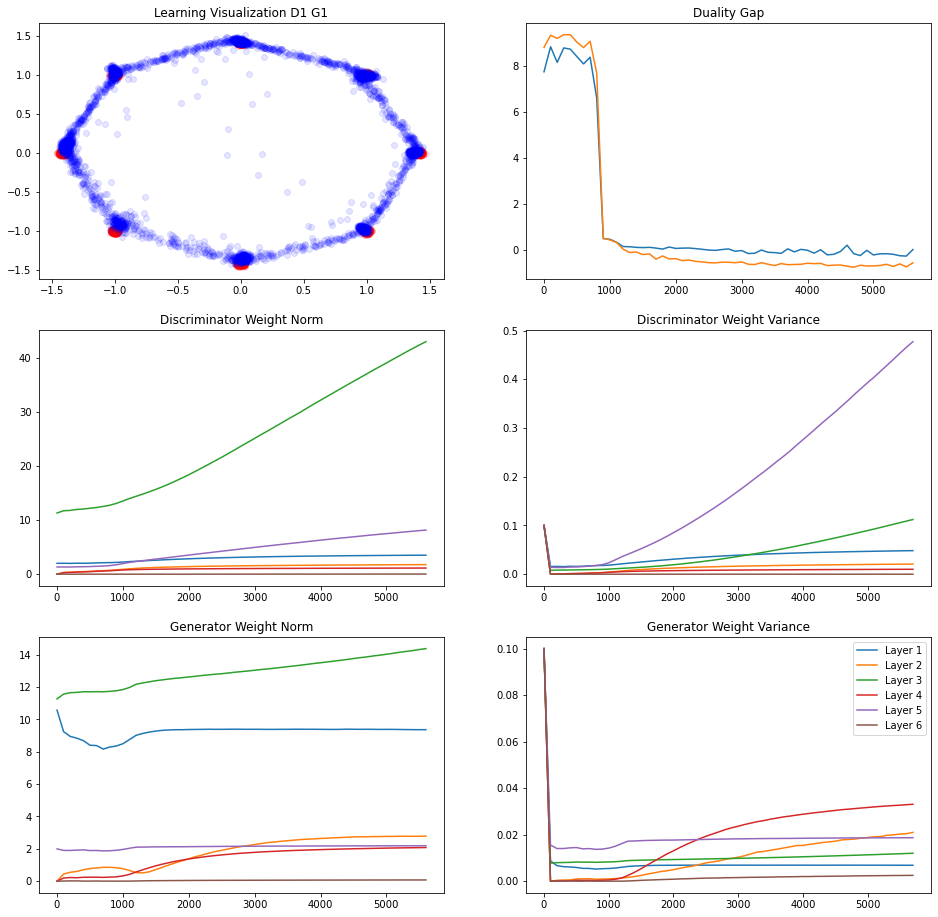

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.24066895
L Random  Duality Gap :  -0.7128444


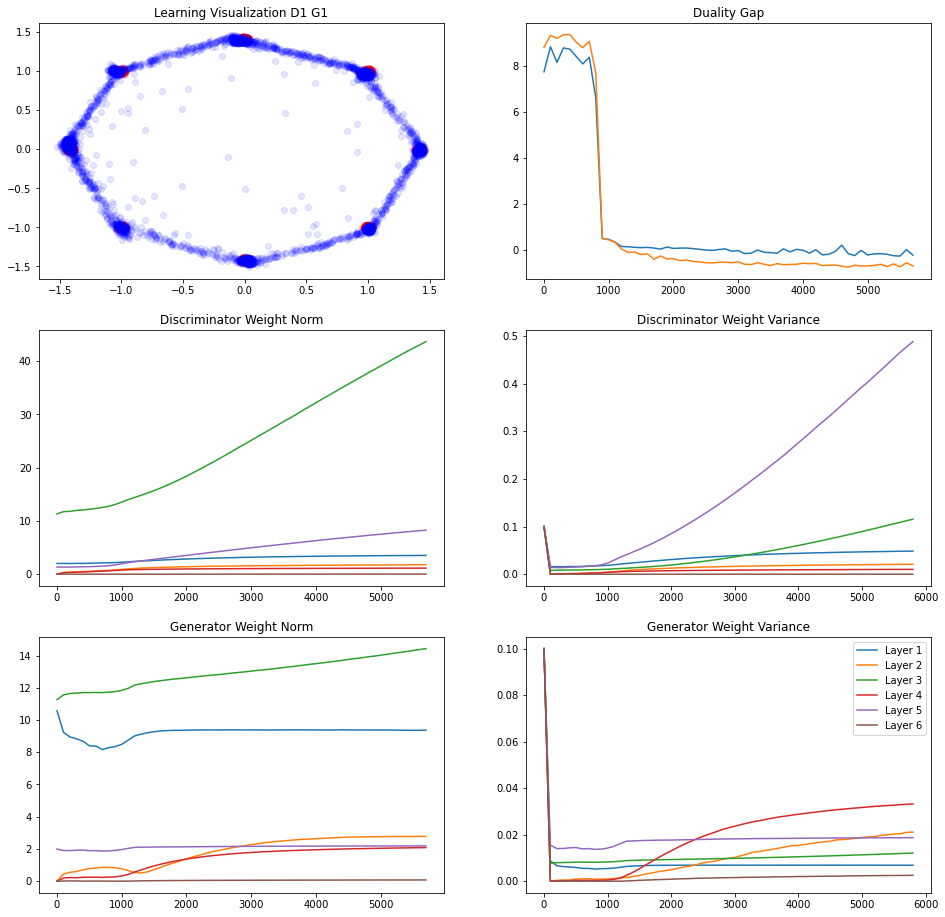

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.18449026
L Random  Duality Gap :  -0.7176716


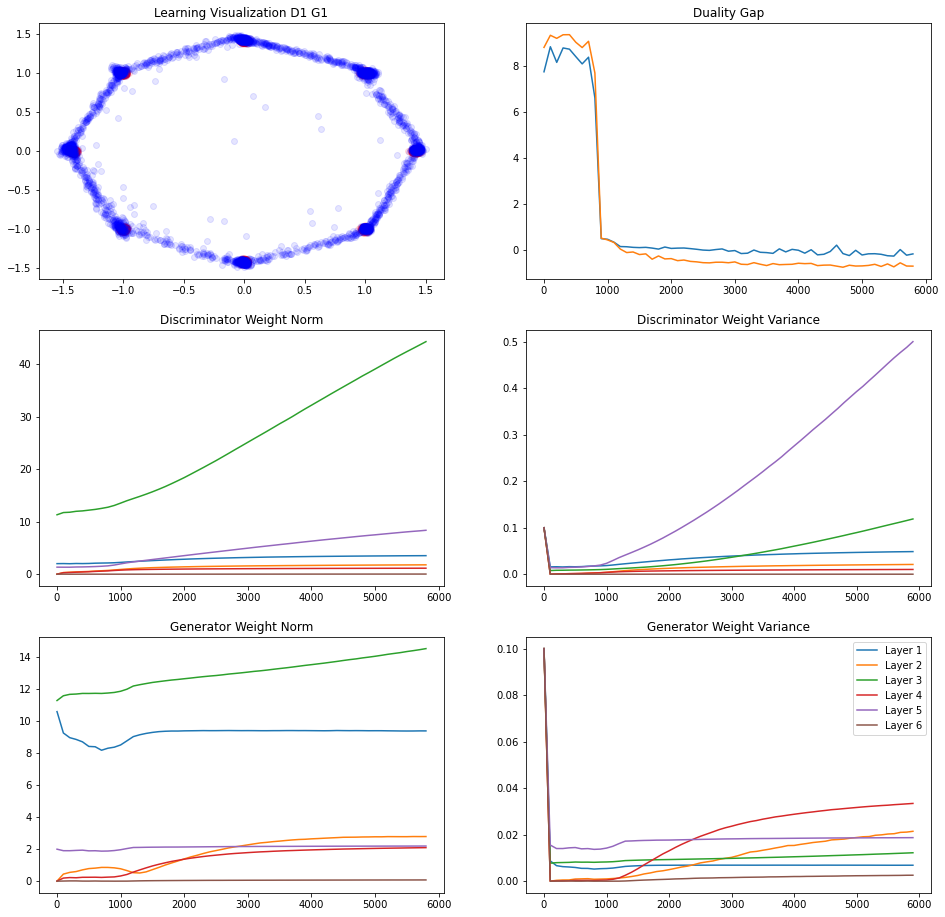

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.17397529
L Random  Duality Gap :  -0.68894386


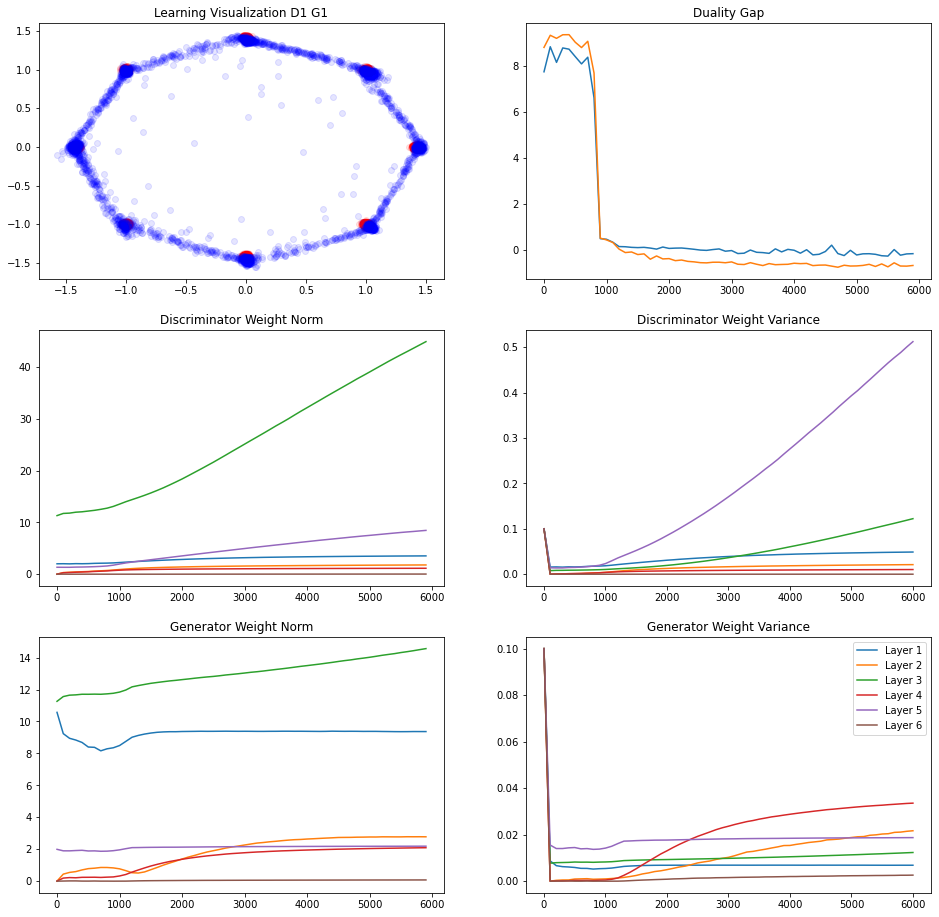

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.101622164
L Random  Duality Gap :  -0.66383123
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2910779
L Random  Duality Gap :  -0.6673239


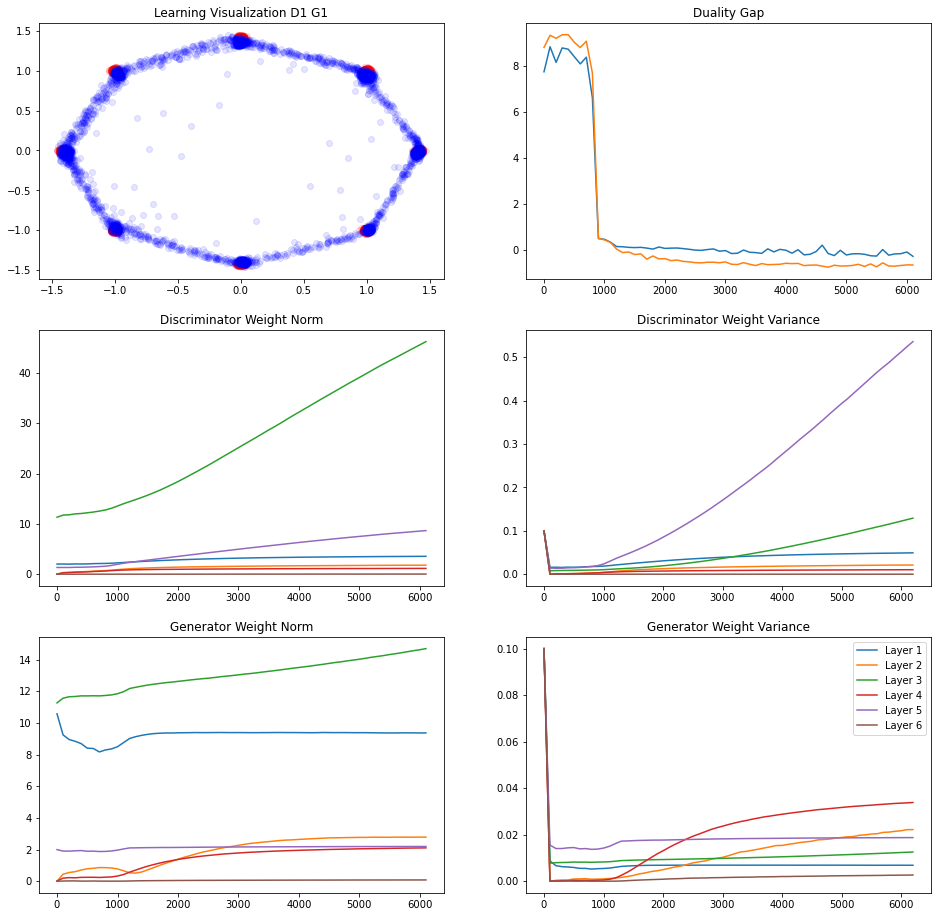

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.28252786
L Random  Duality Gap :  -0.6892529


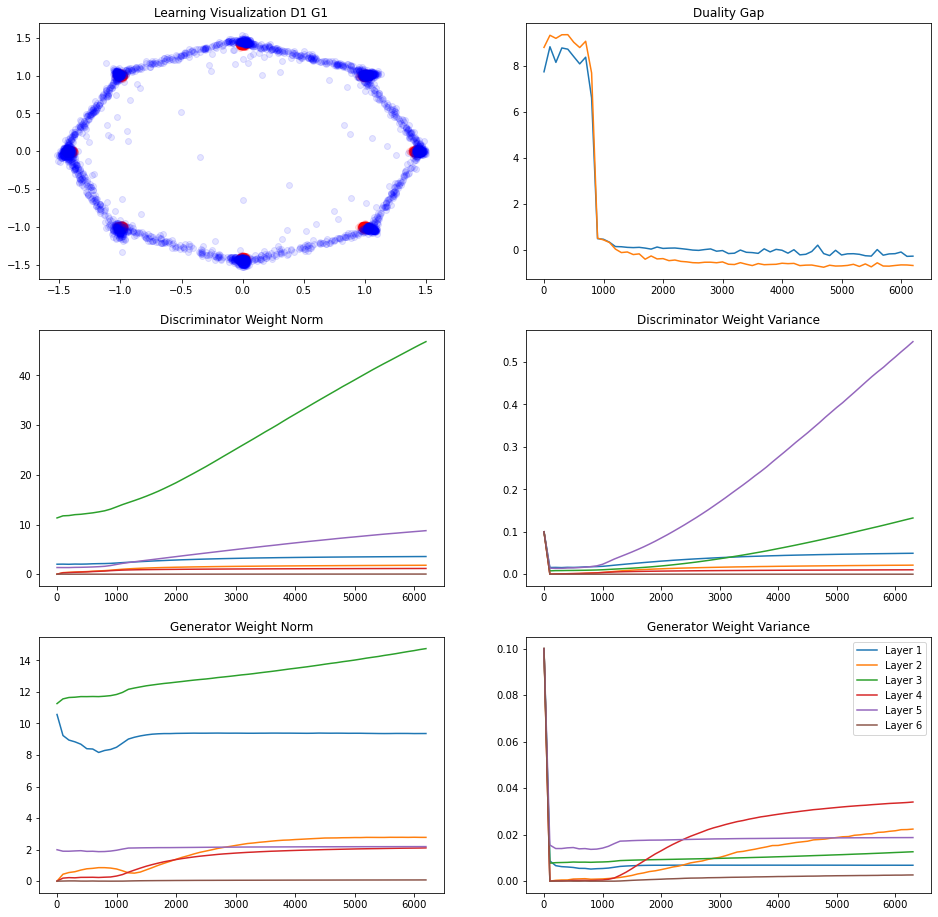

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.37897116
L Random  Duality Gap :  -0.7242033


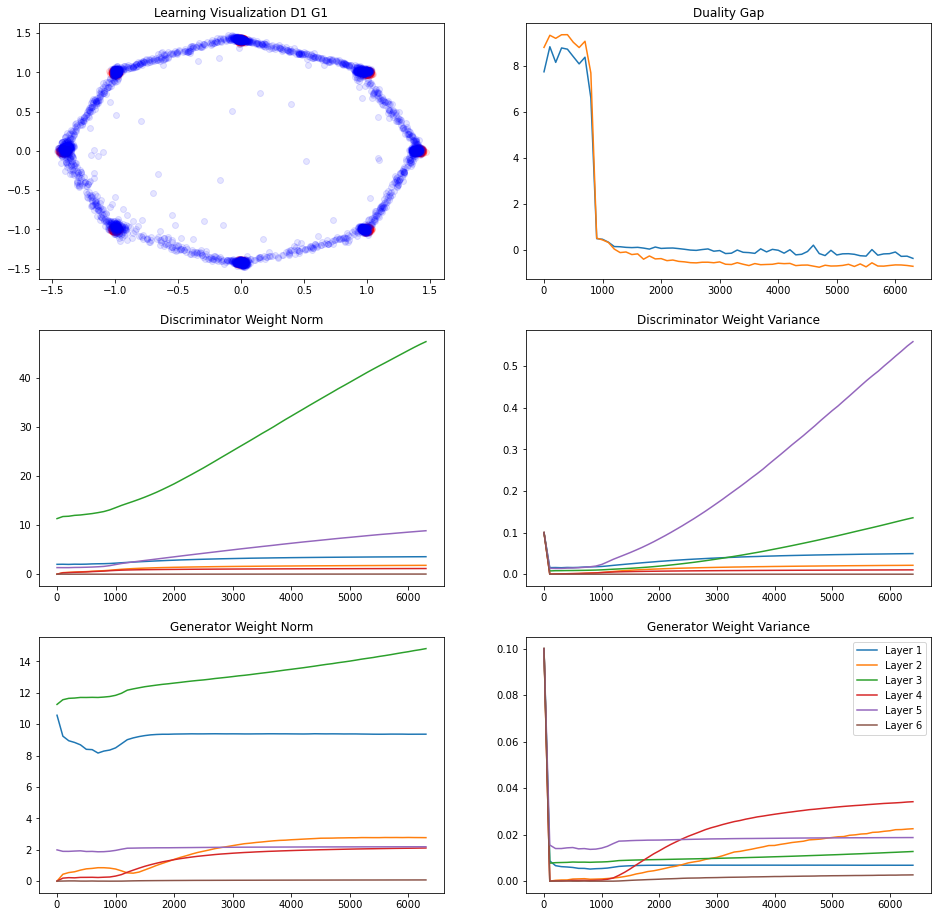

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.37736255
L Random  Duality Gap :  -0.76203716


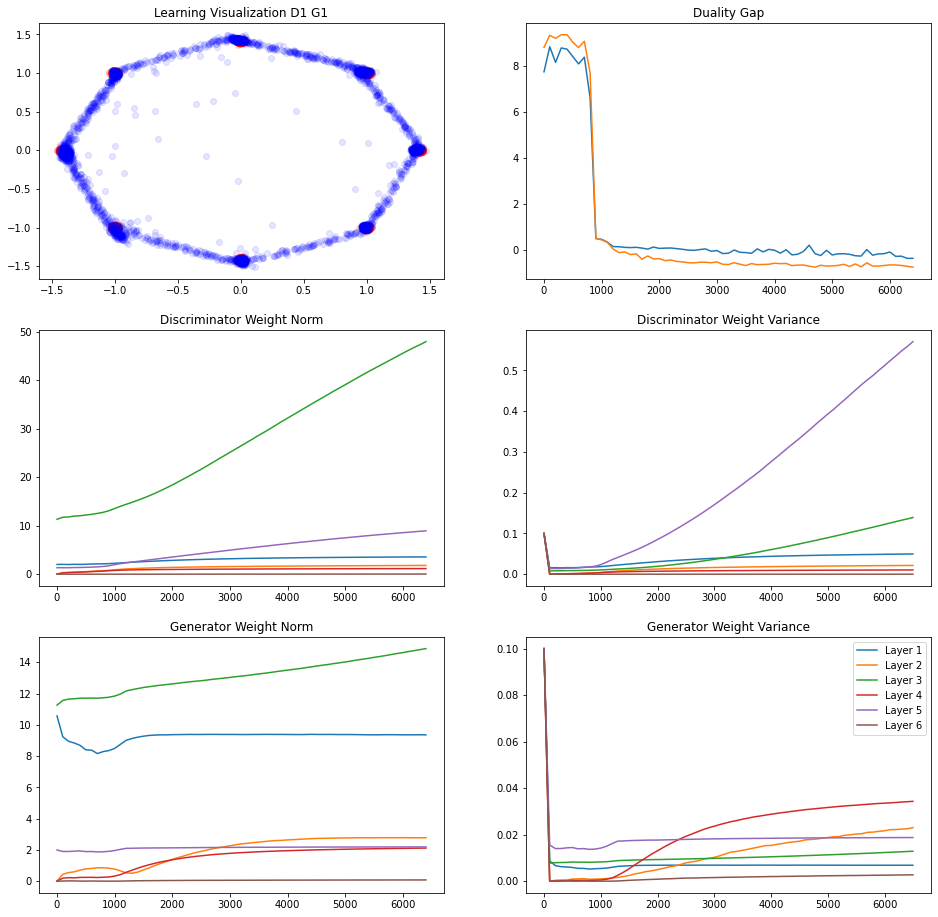

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.23870045
L Random  Duality Gap :  -0.76041317
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.1510852
L Random  Duality Gap :  -0.6915516


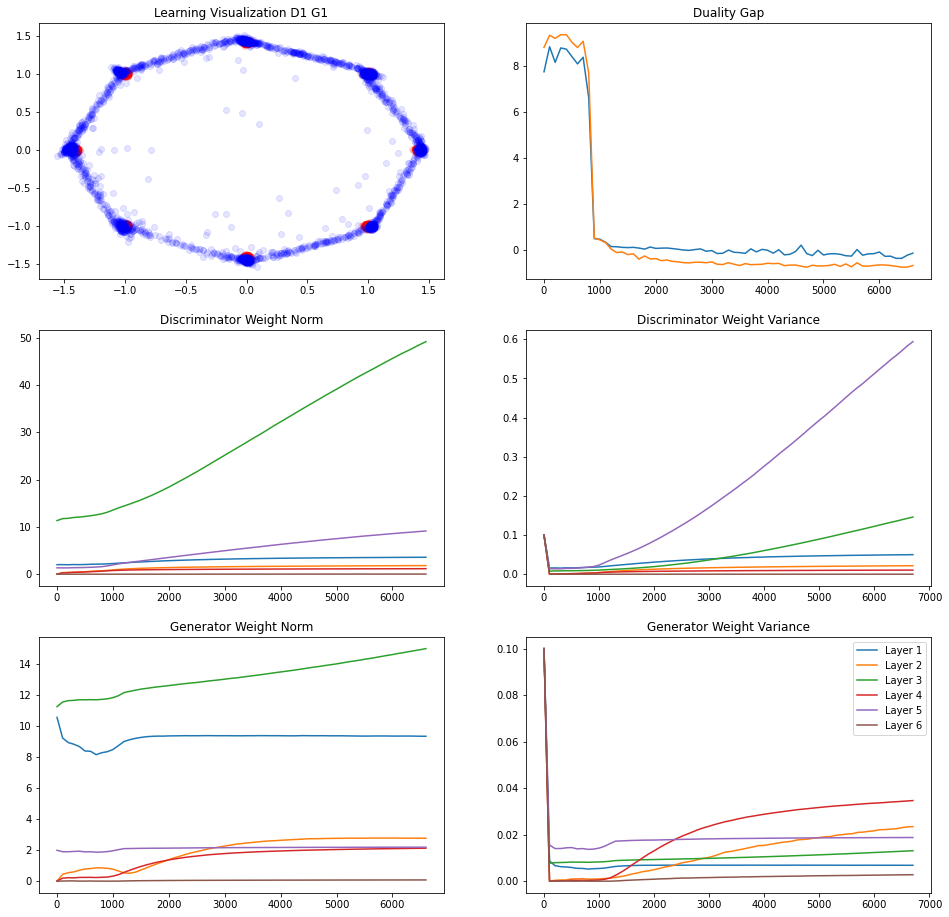

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.22803897
L Random  Duality Gap :  -0.79313505


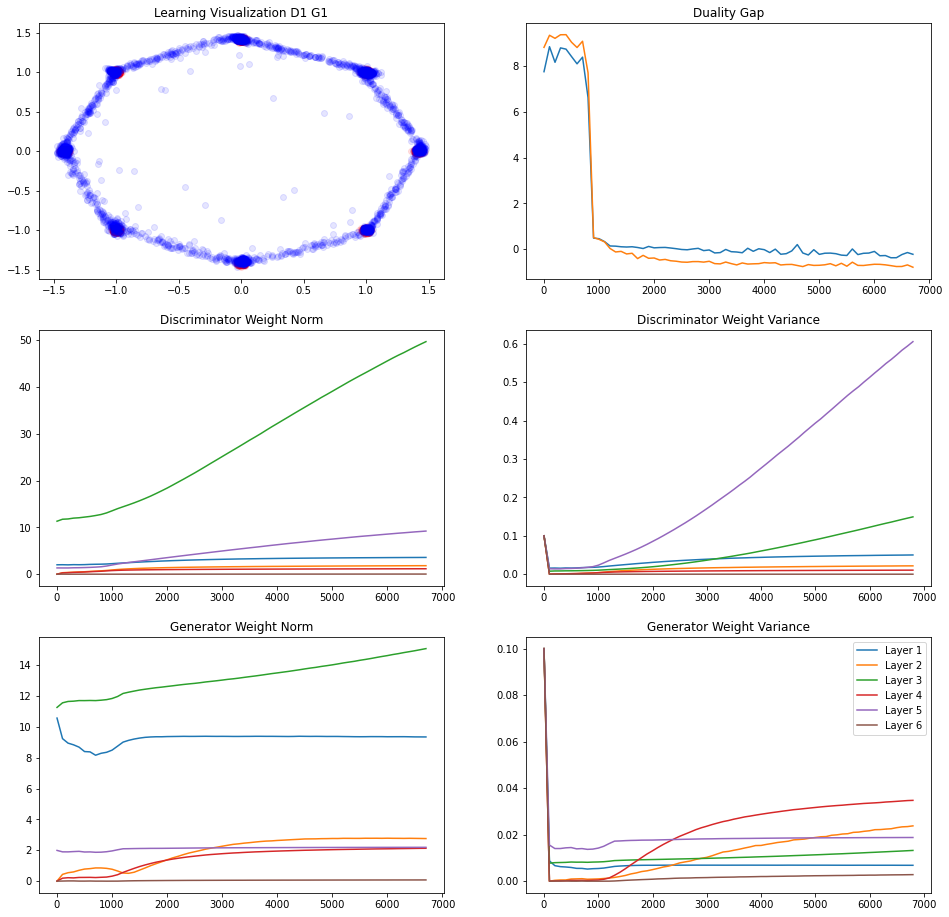

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.34595078
L Random  Duality Gap :  -0.6853738


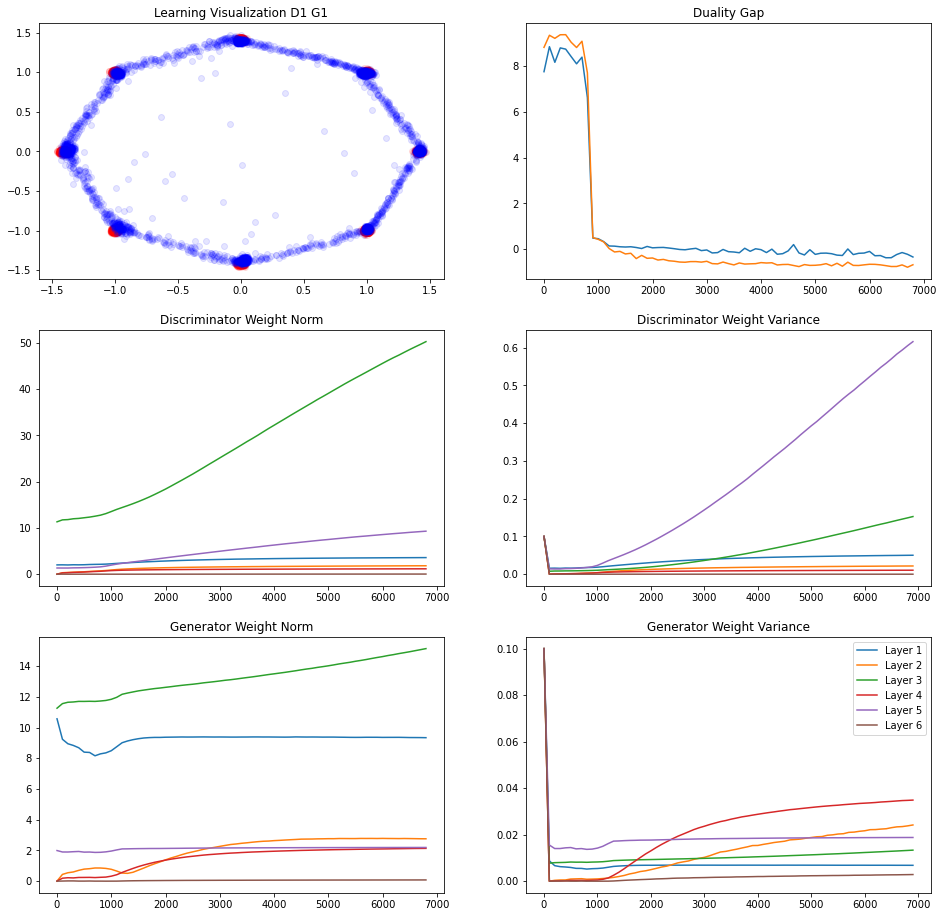

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.31760895
L Random  Duality Gap :  -0.7357964


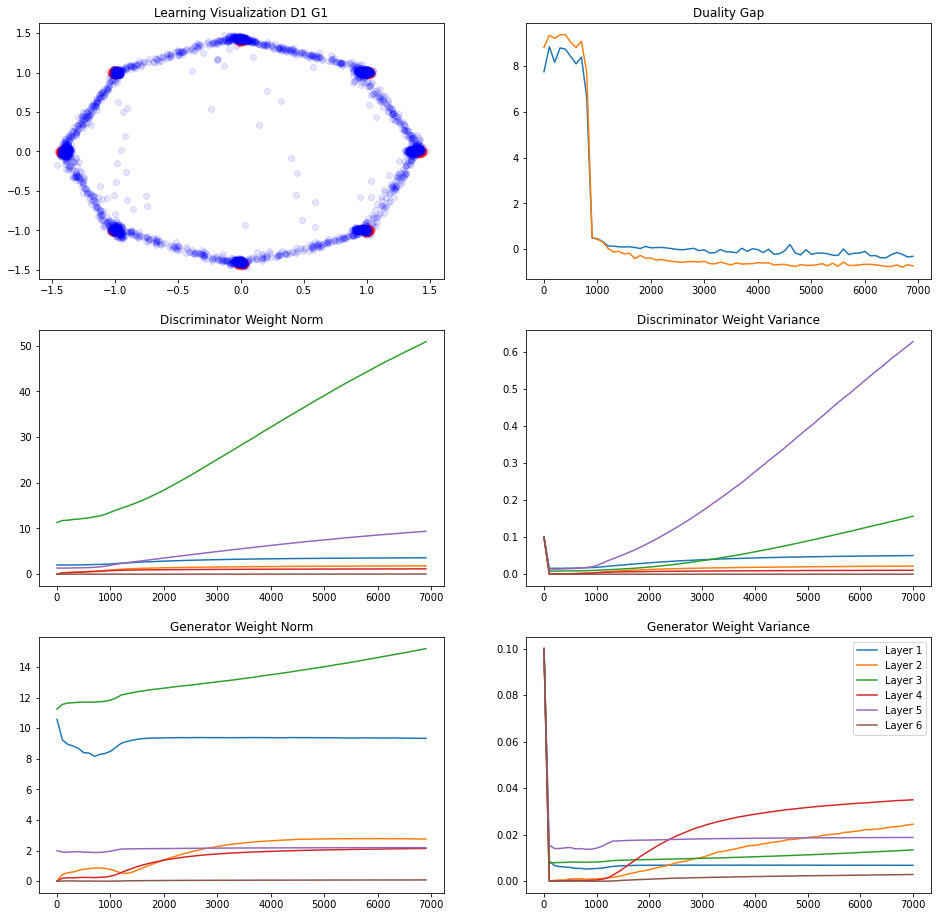

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.21597522
L Random  Duality Gap :  -0.68720436
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.24640512
L Random  Duality Gap :  -0.6907729


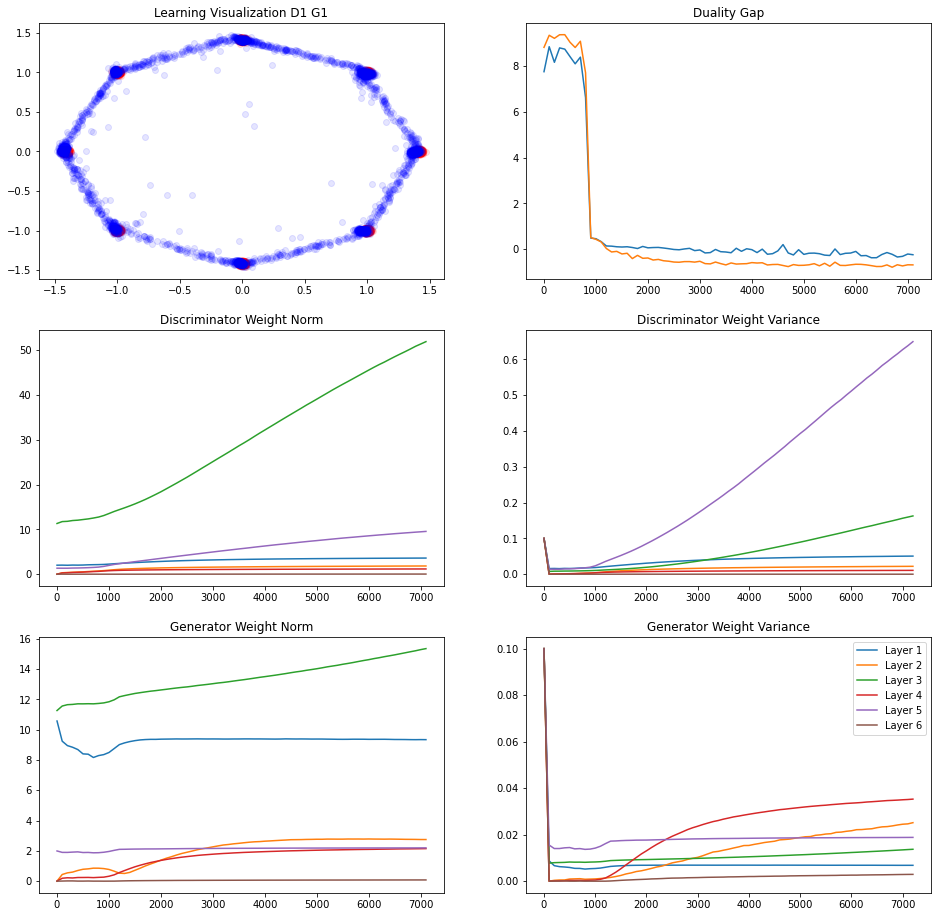

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.021353781
L Random  Duality Gap :  -0.69602543


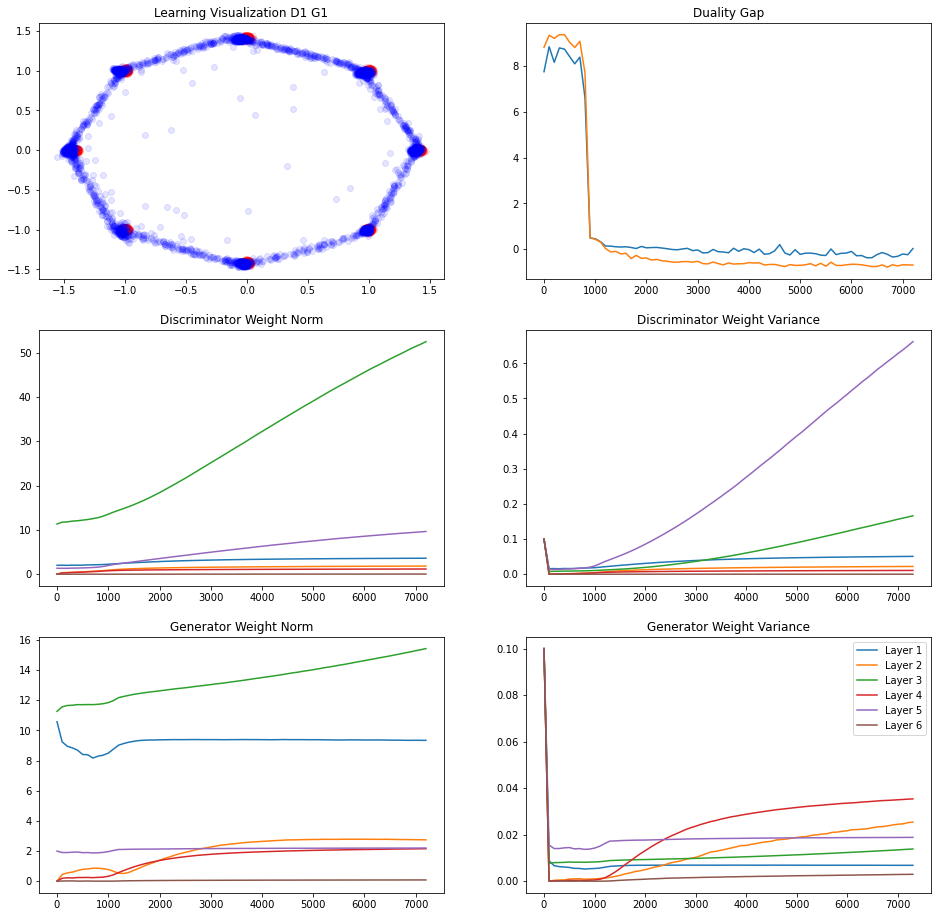

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.19148088
L Random  Duality Gap :  -0.70313454


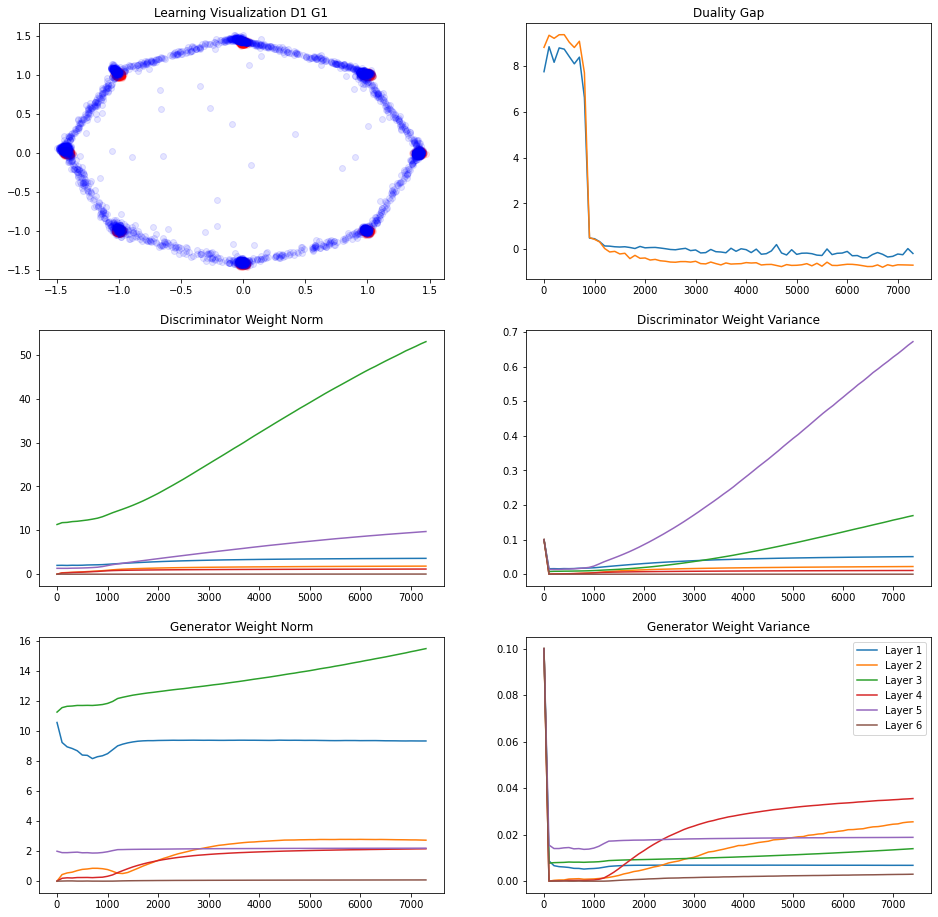

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.16634125
L Random  Duality Gap :  -0.7235096


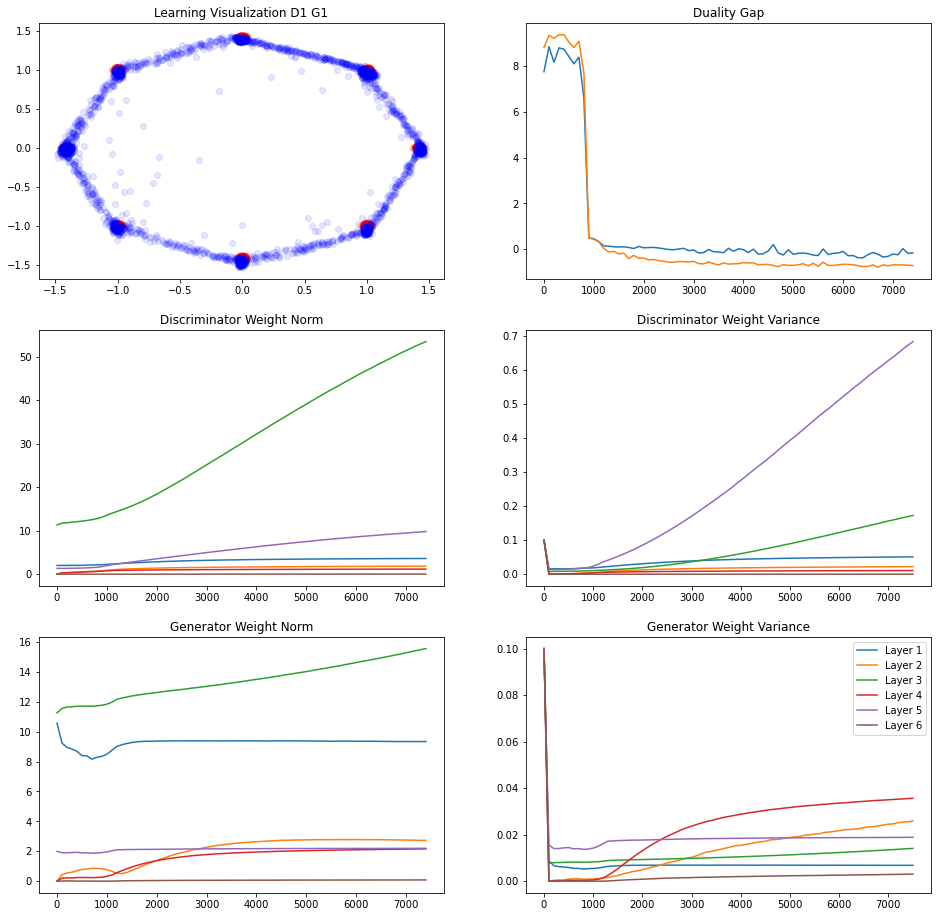

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.25670177
L Random  Duality Gap :  -0.6762317
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.15726244
L Random  Duality Gap :  -0.5672161


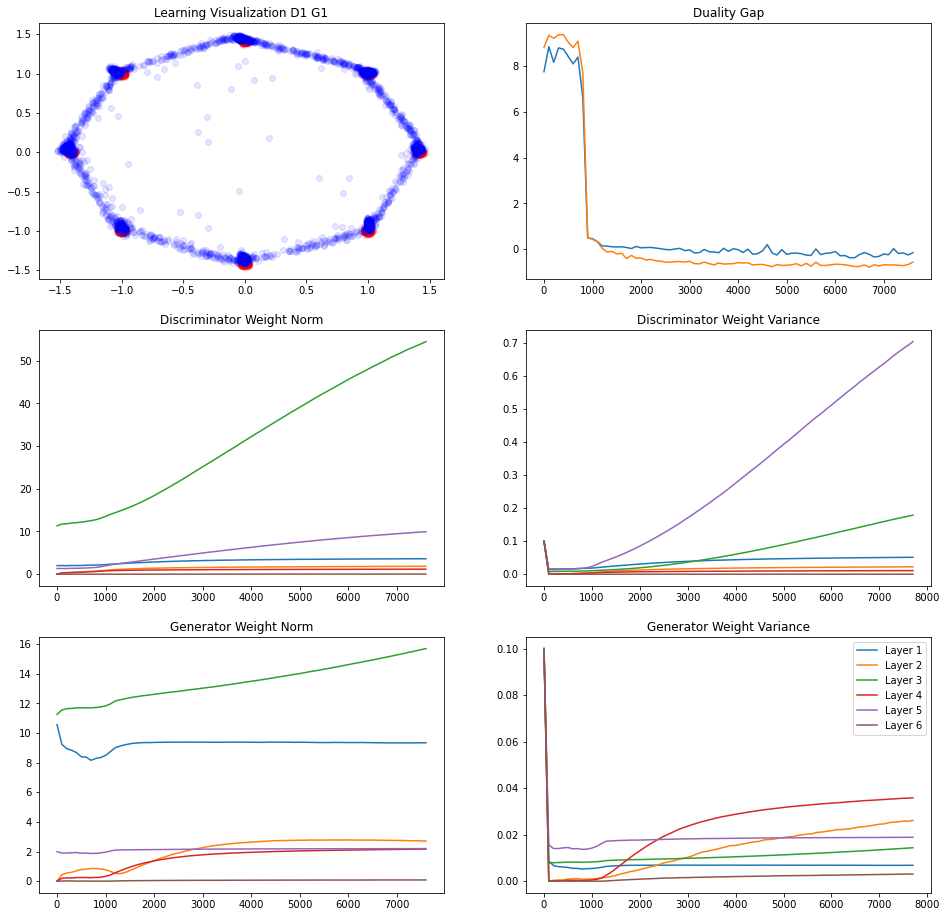

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.14258724
L Random  Duality Gap :  -0.70236665


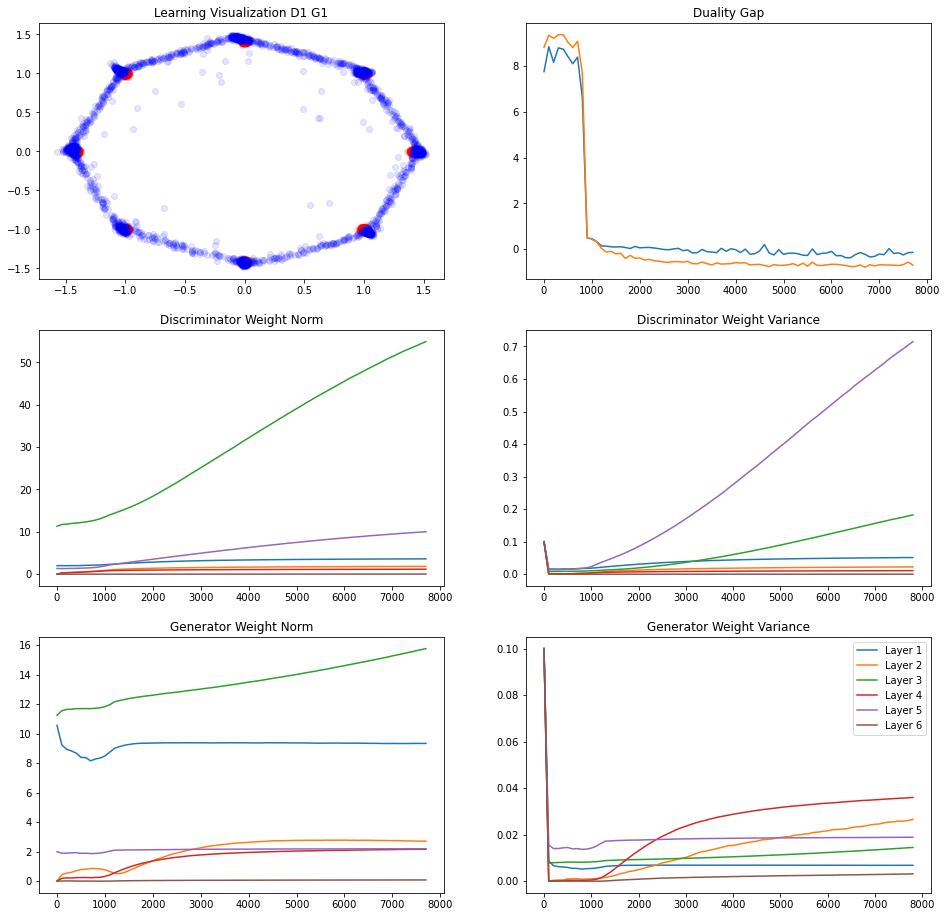

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.23225051
L Random  Duality Gap :  -0.71173894


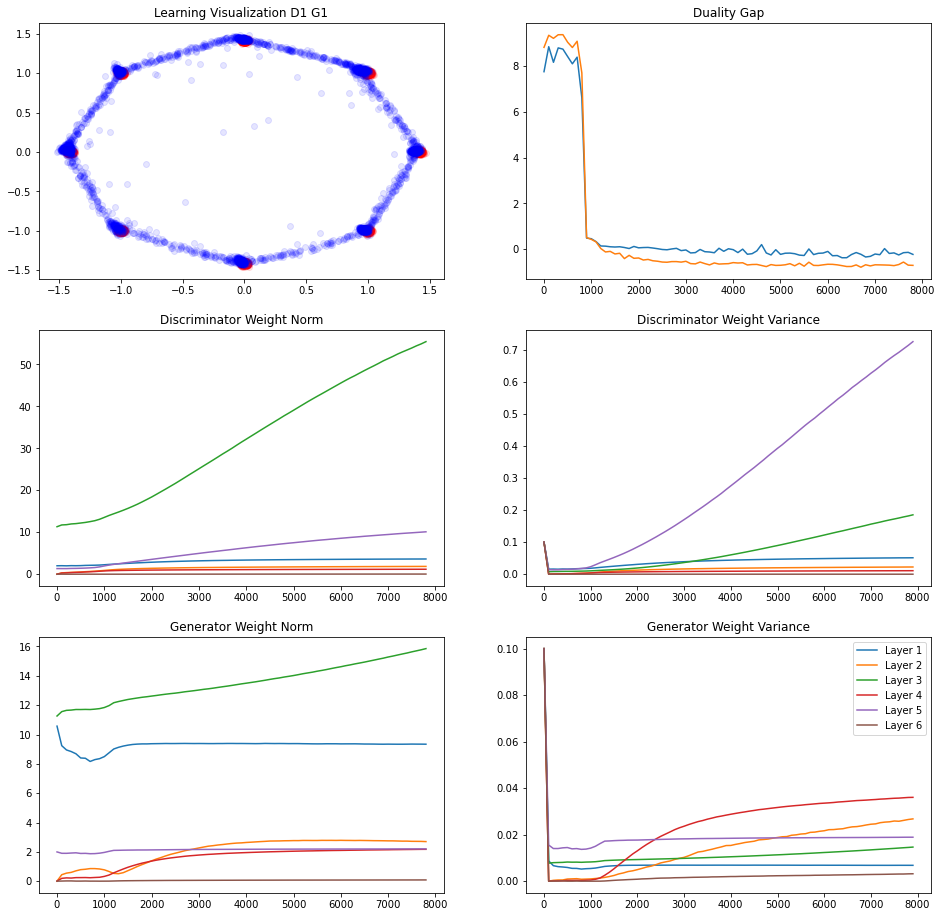

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.13734752
L Random  Duality Gap :  -0.6802002


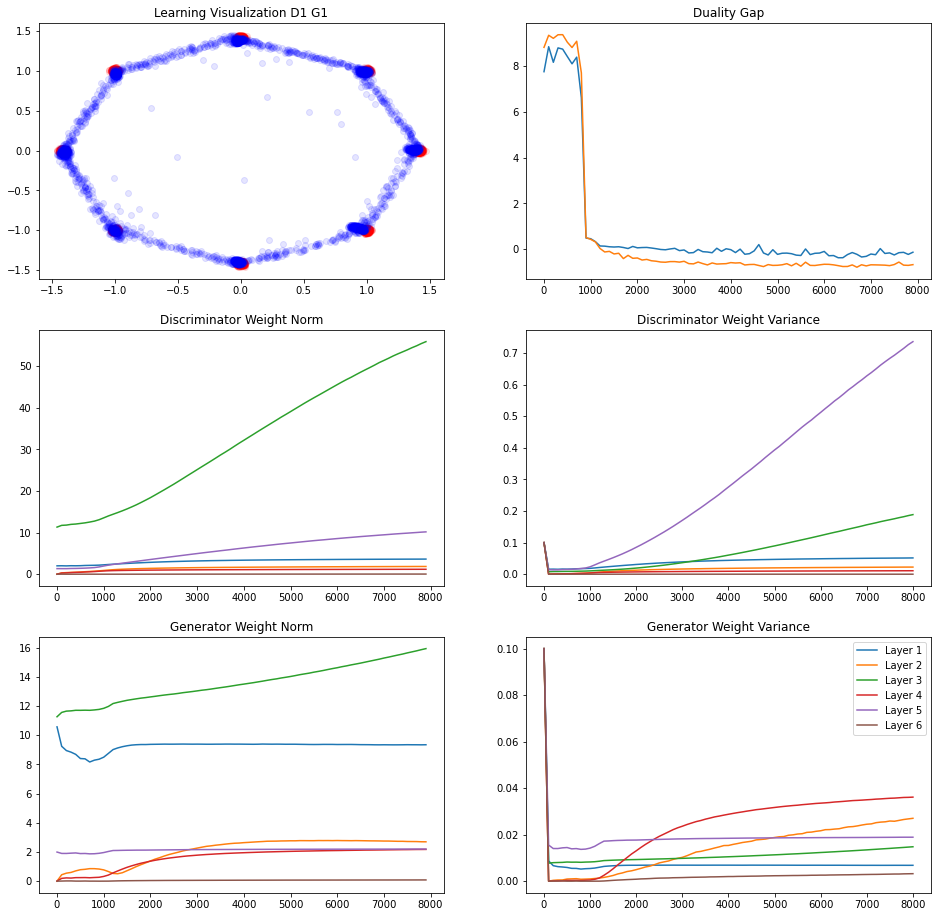

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.402336
L Random  Duality Gap :  -0.7661549
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.17860395
L Random  Duality Gap :  -0.70250094


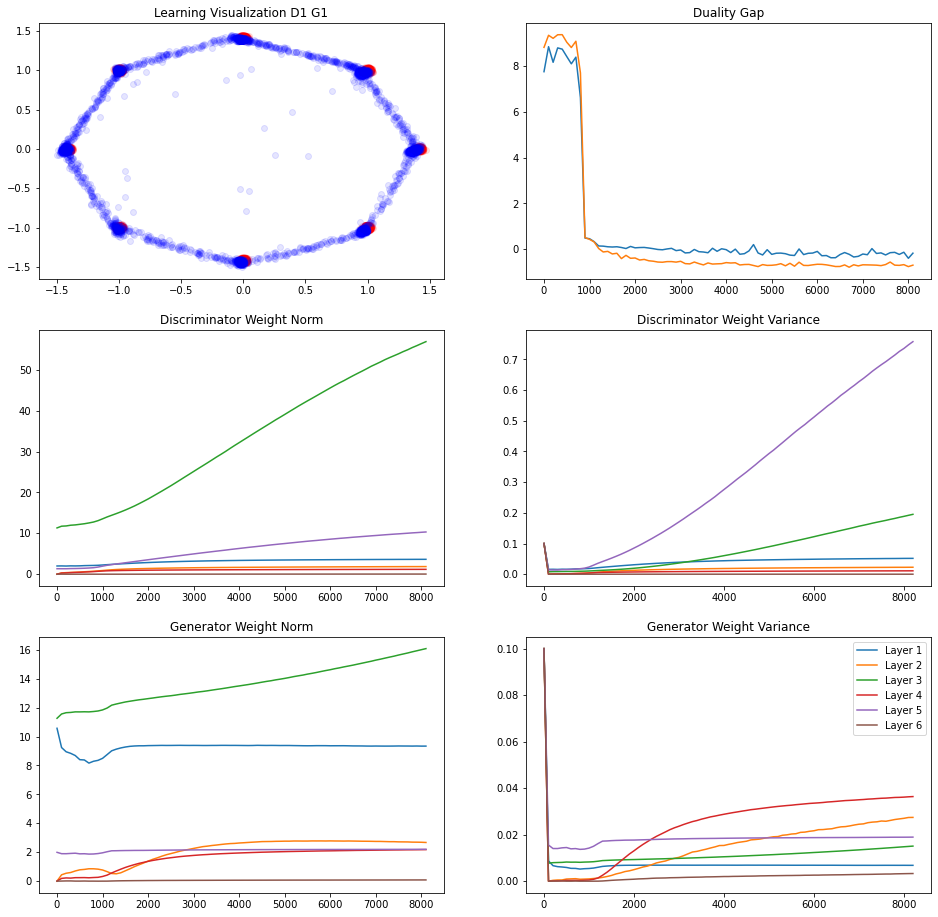

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.30415934
L Random  Duality Gap :  -0.743389


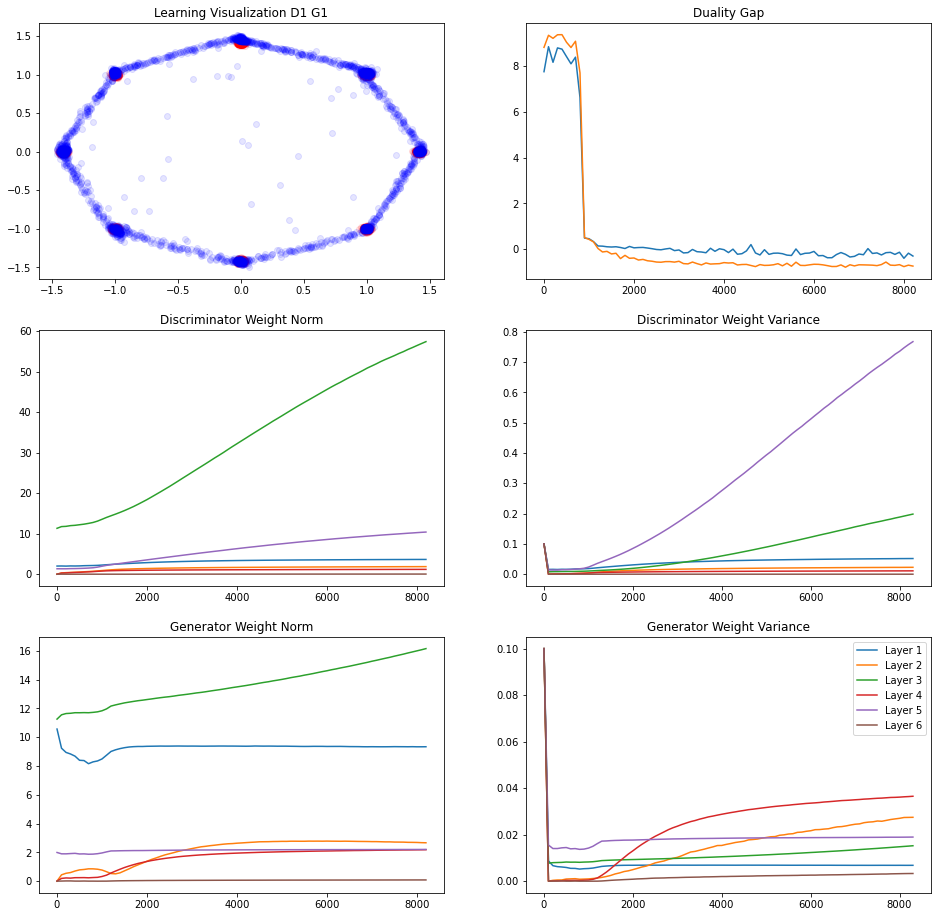

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.11284959
L Random  Duality Gap :  -0.7376444


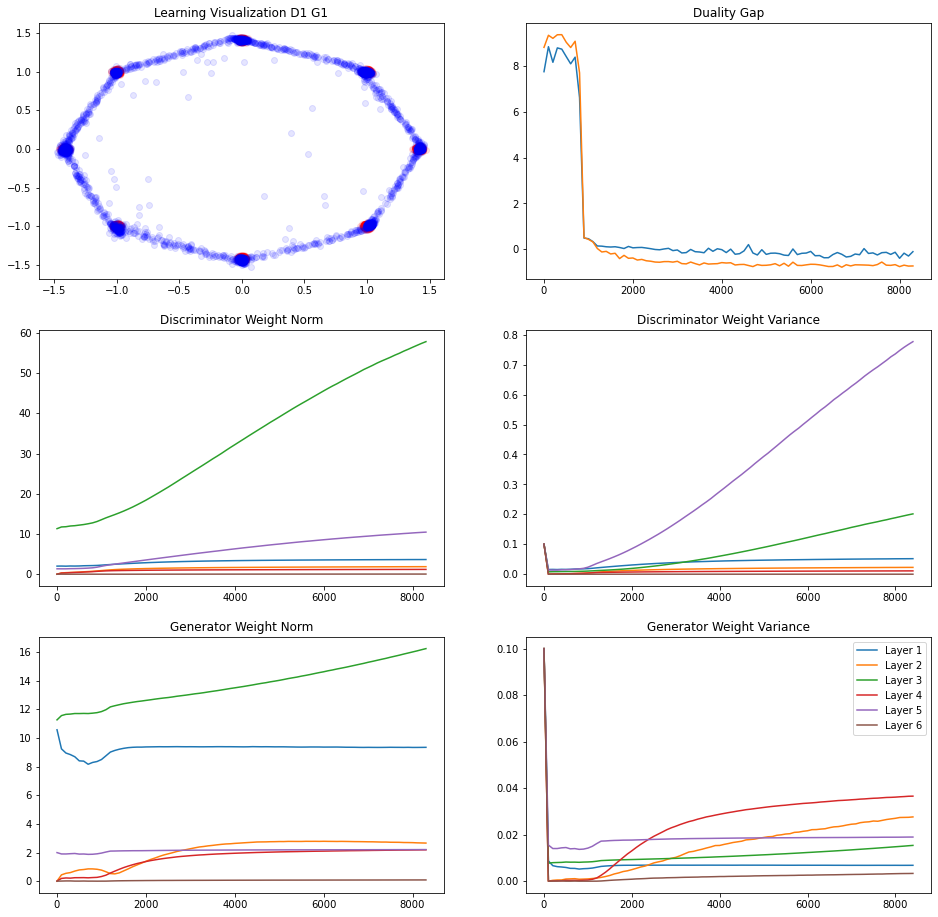

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.3399498
L Random  Duality Gap :  -0.6561775


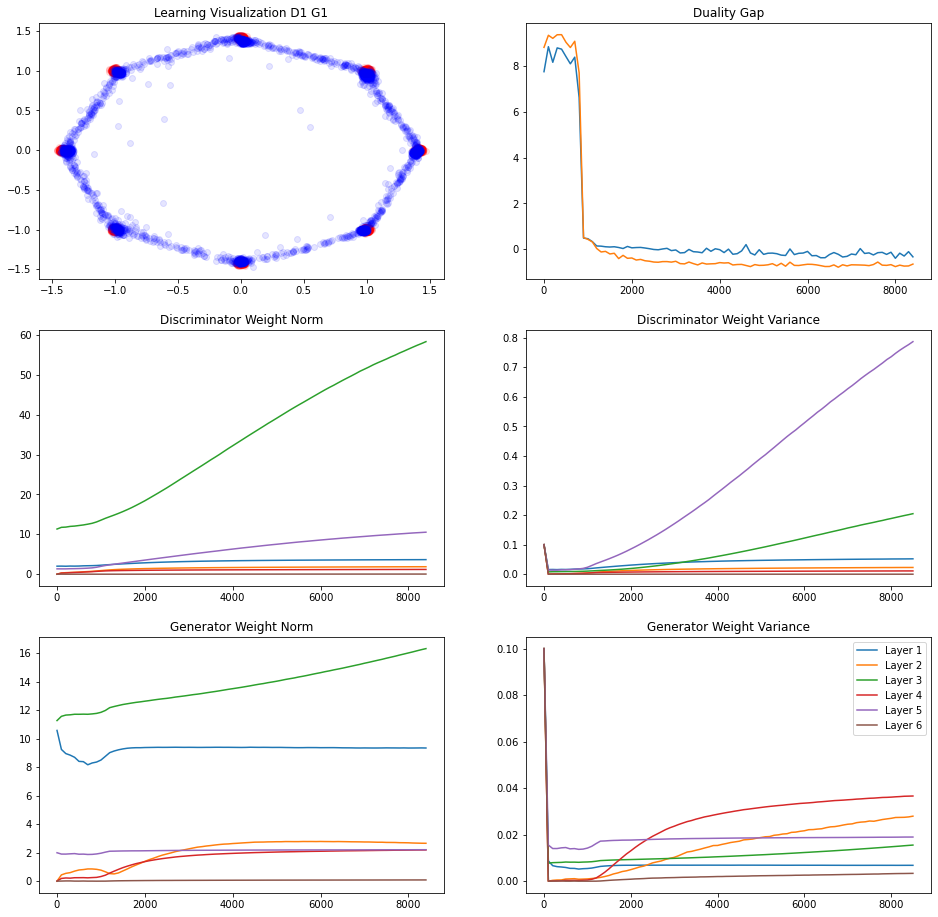

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2337532
L Random  Duality Gap :  -0.66046524
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.46383786
L Random  Duality Gap :  -0.7141837


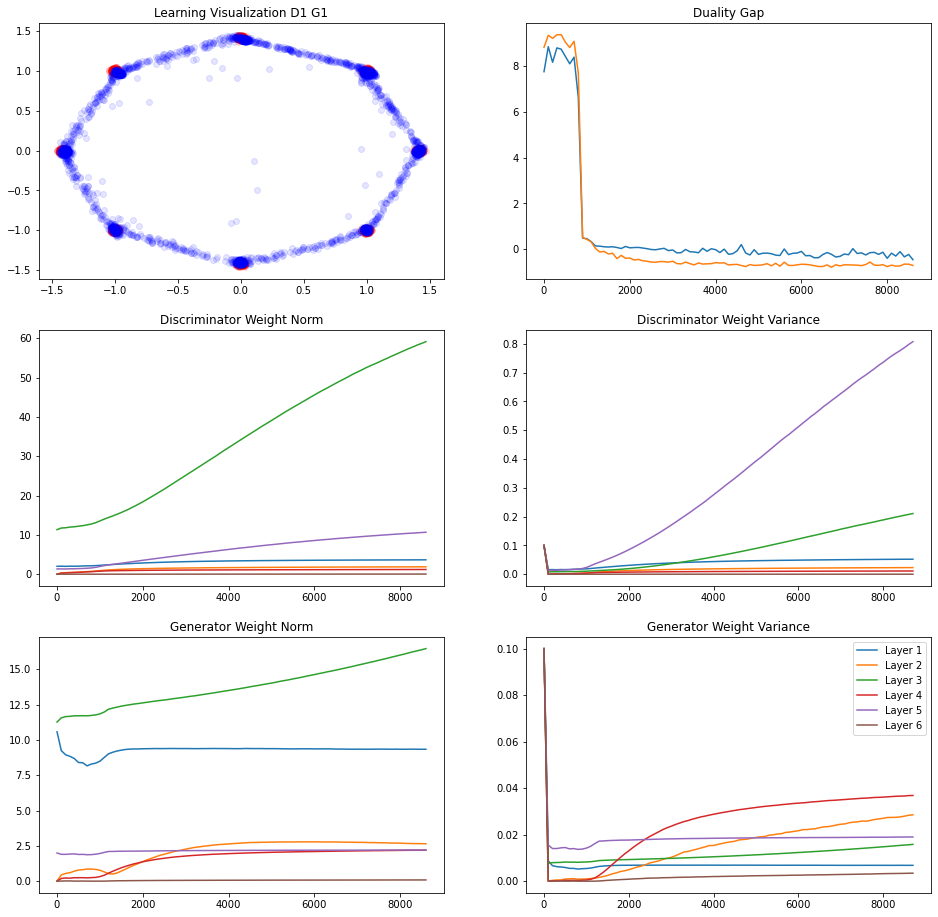

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2728591
L Random  Duality Gap :  -0.70854795


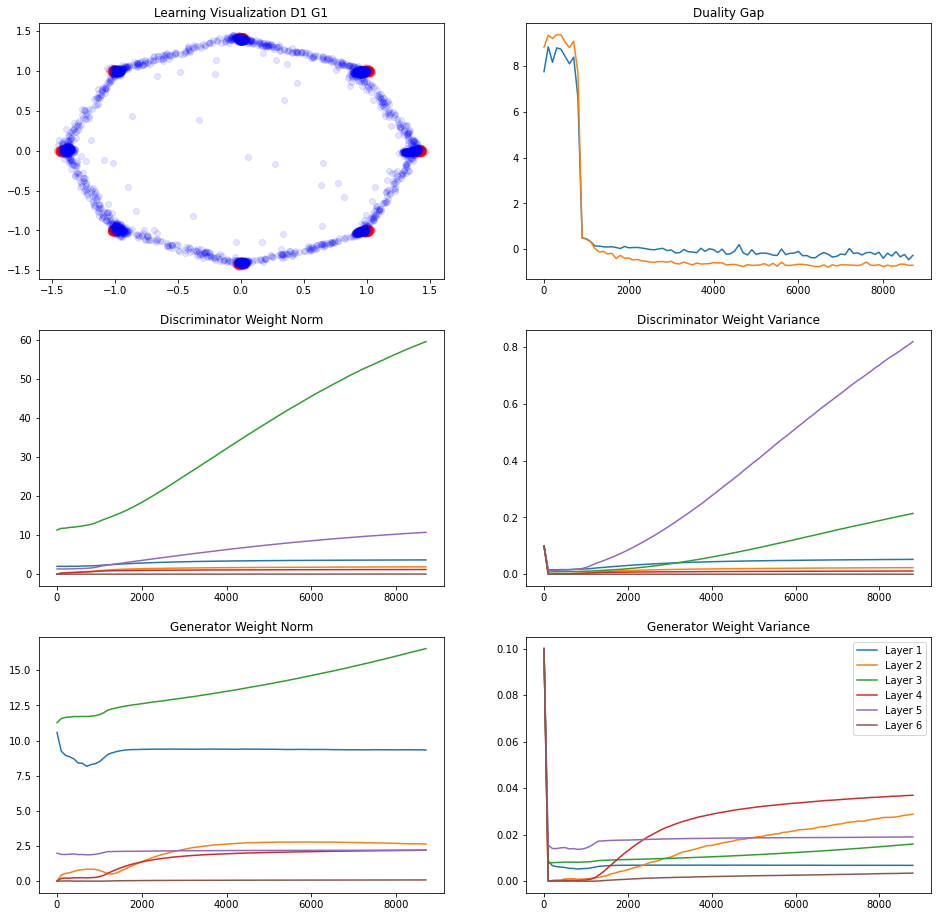

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.39363045
L Random  Duality Gap :  -0.71948576


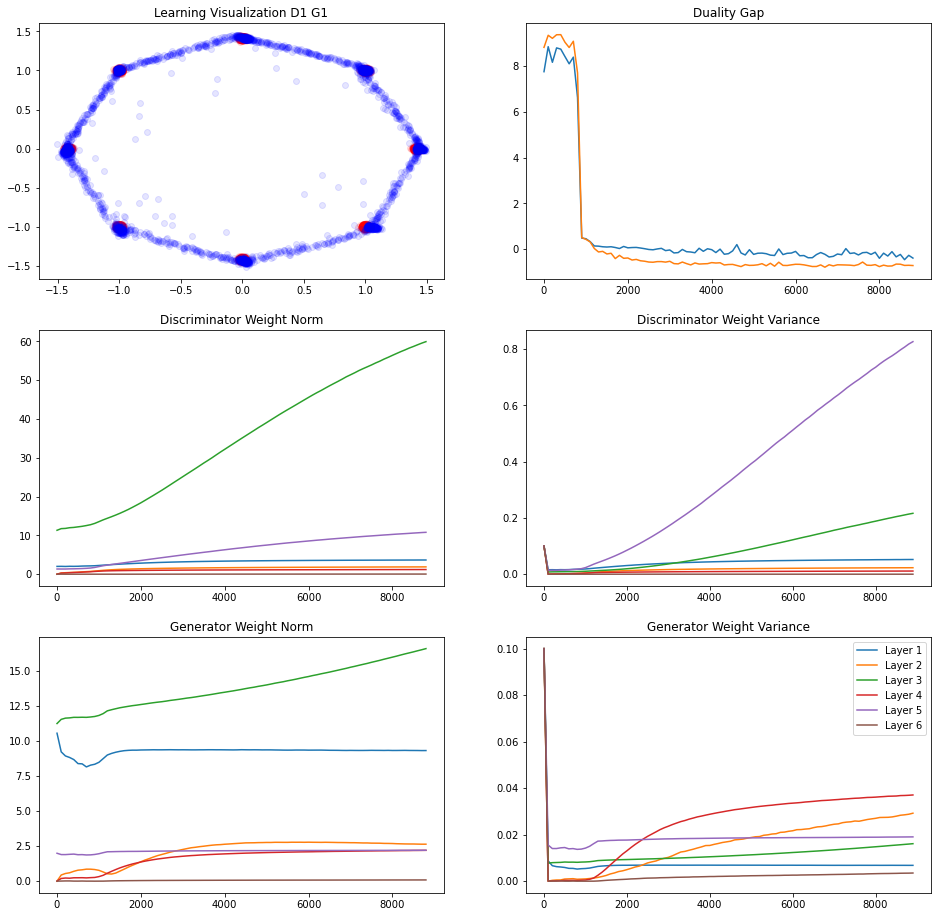

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.21958941
L Random  Duality Gap :  -0.7539809


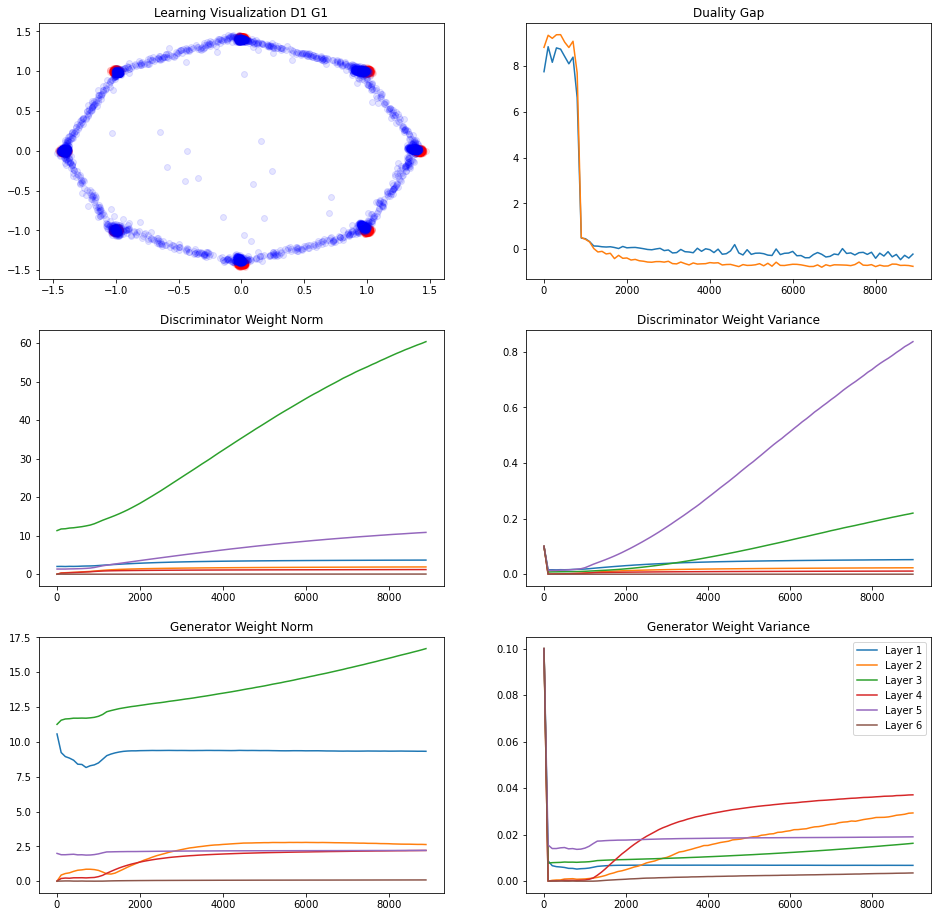

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.04289466
L Random  Duality Gap :  -0.65953654
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.19031781
L Random  Duality Gap :  -0.7244272


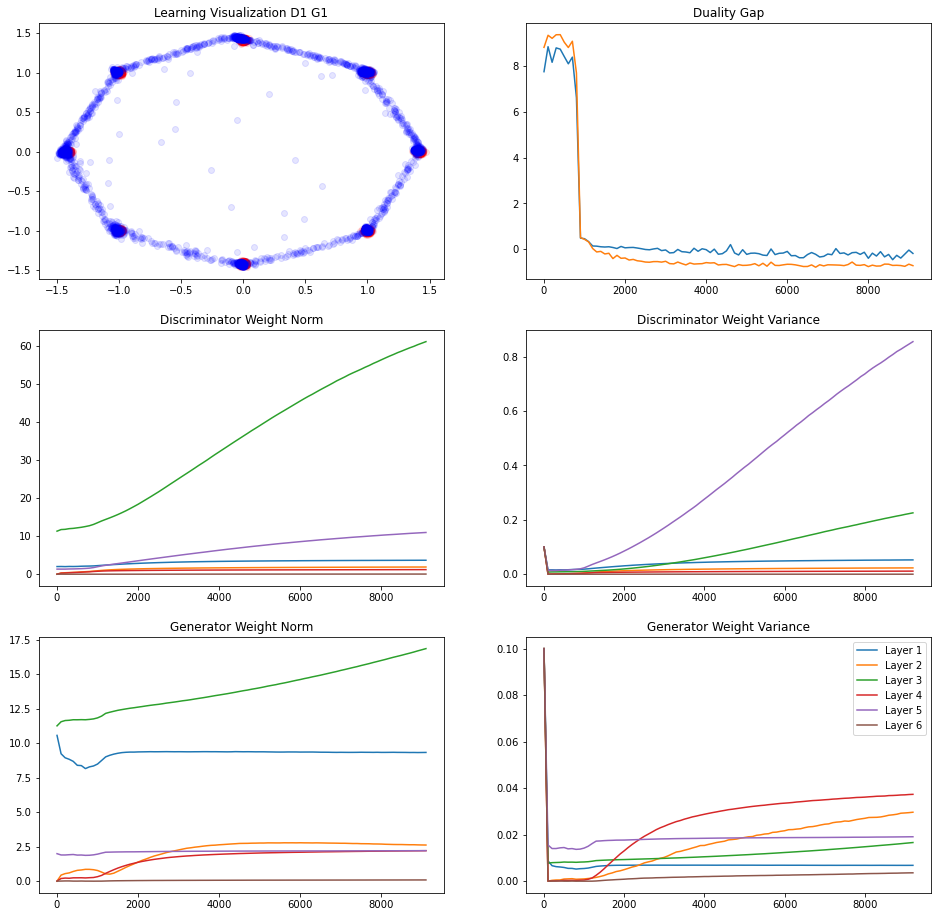

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.42529213
L Random  Duality Gap :  -0.7293719


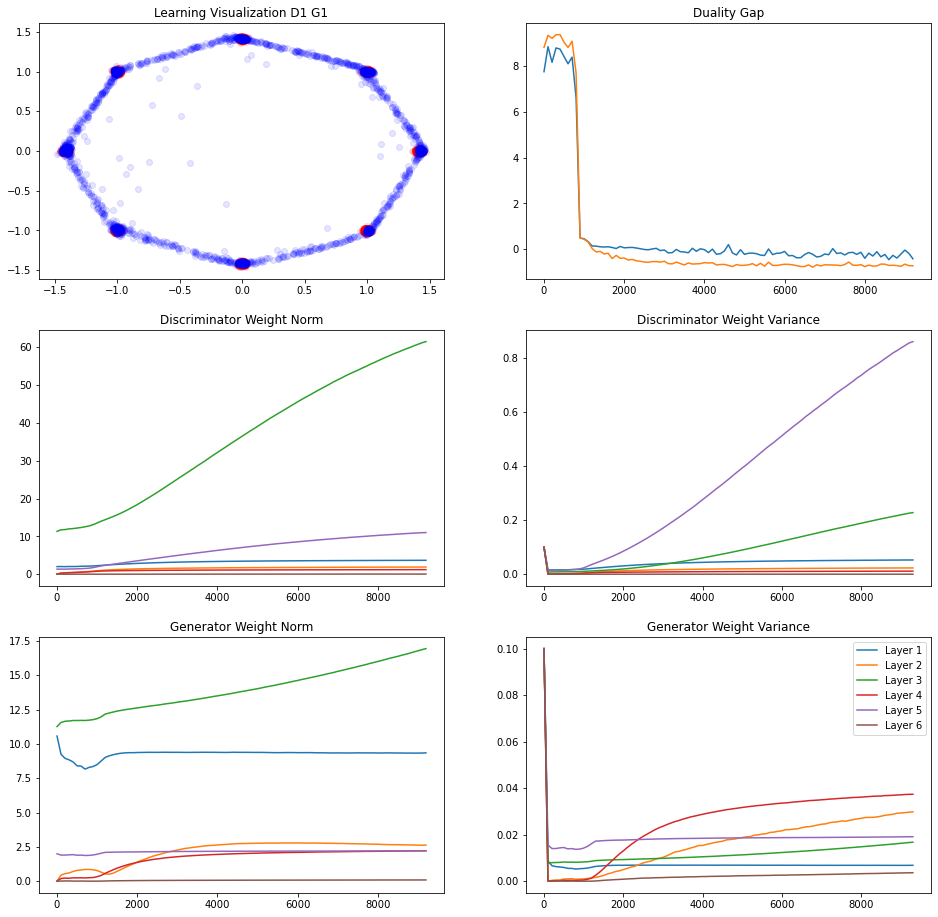

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.46997714
L Random  Duality Gap :  -0.7625397


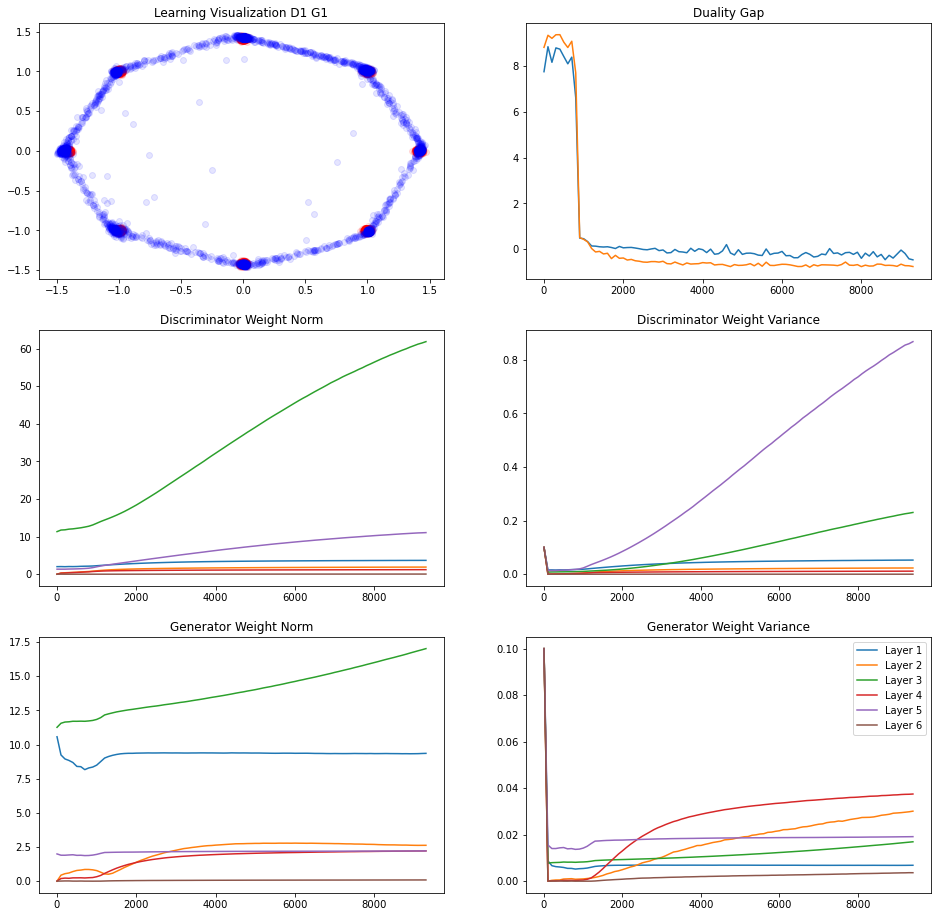

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.26503772
L Random  Duality Gap :  -0.70441324


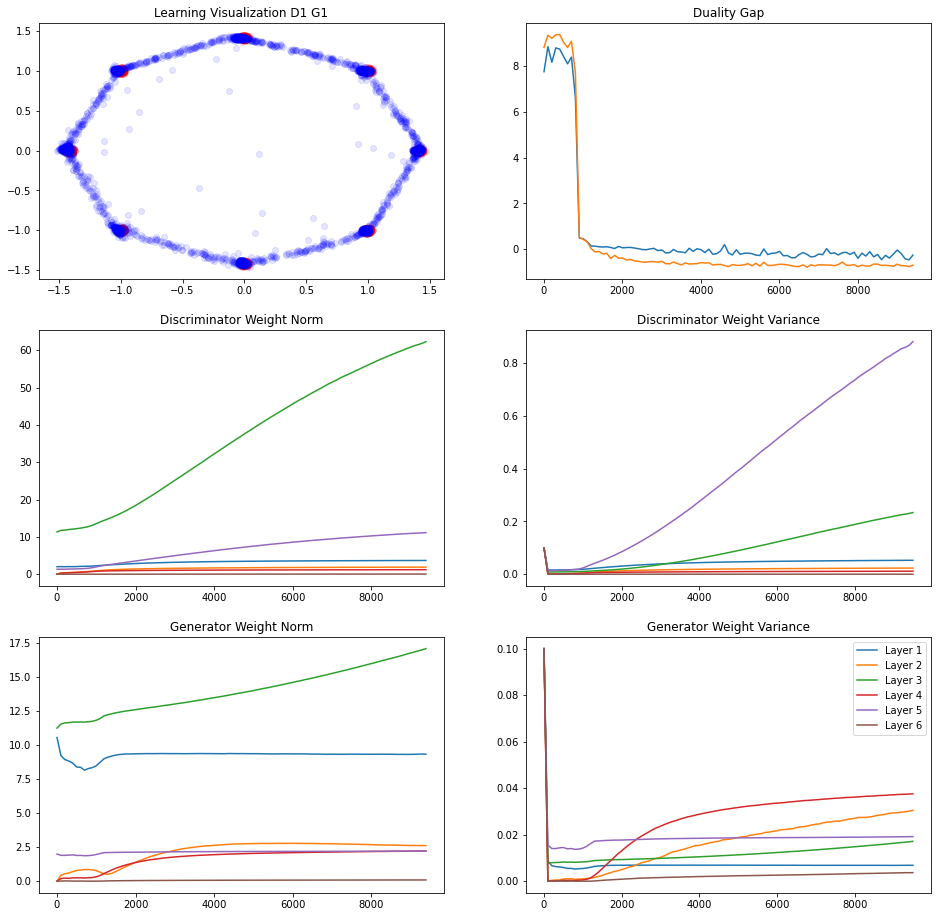

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.06997877
L Random  Duality Gap :  -0.58939964
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.51076007
L Random  Duality Gap :  -0.7562147


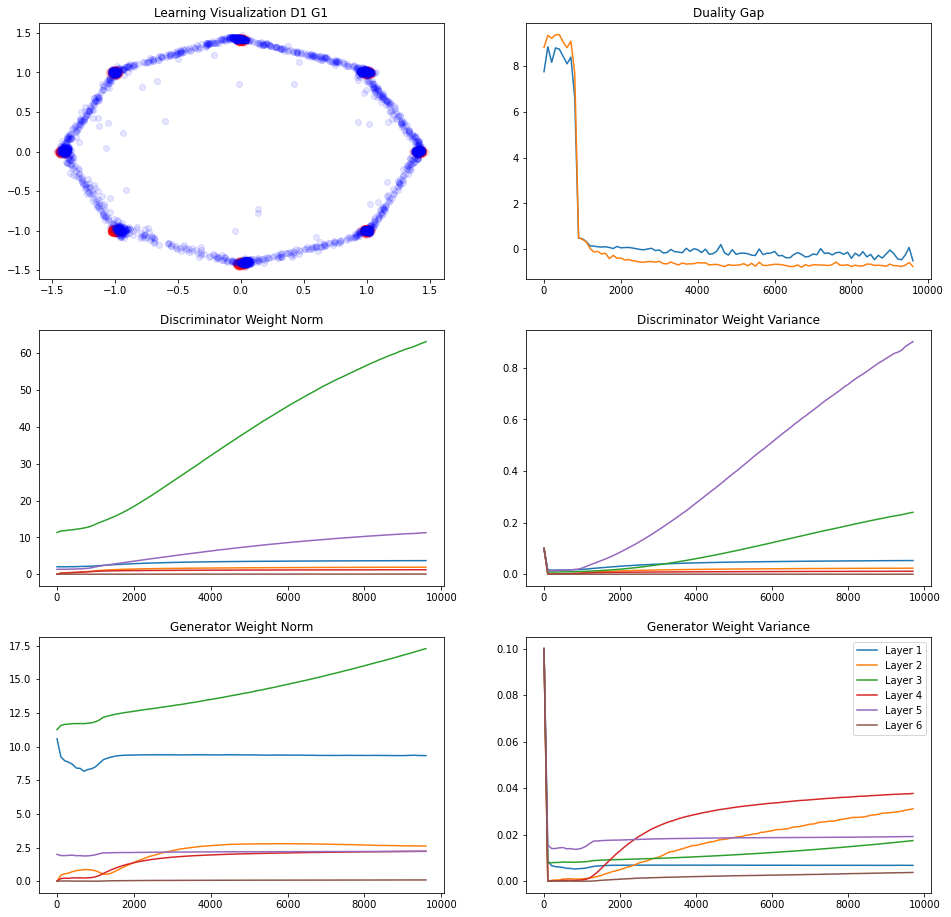

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2562889
L Random  Duality Gap :  -0.7443101


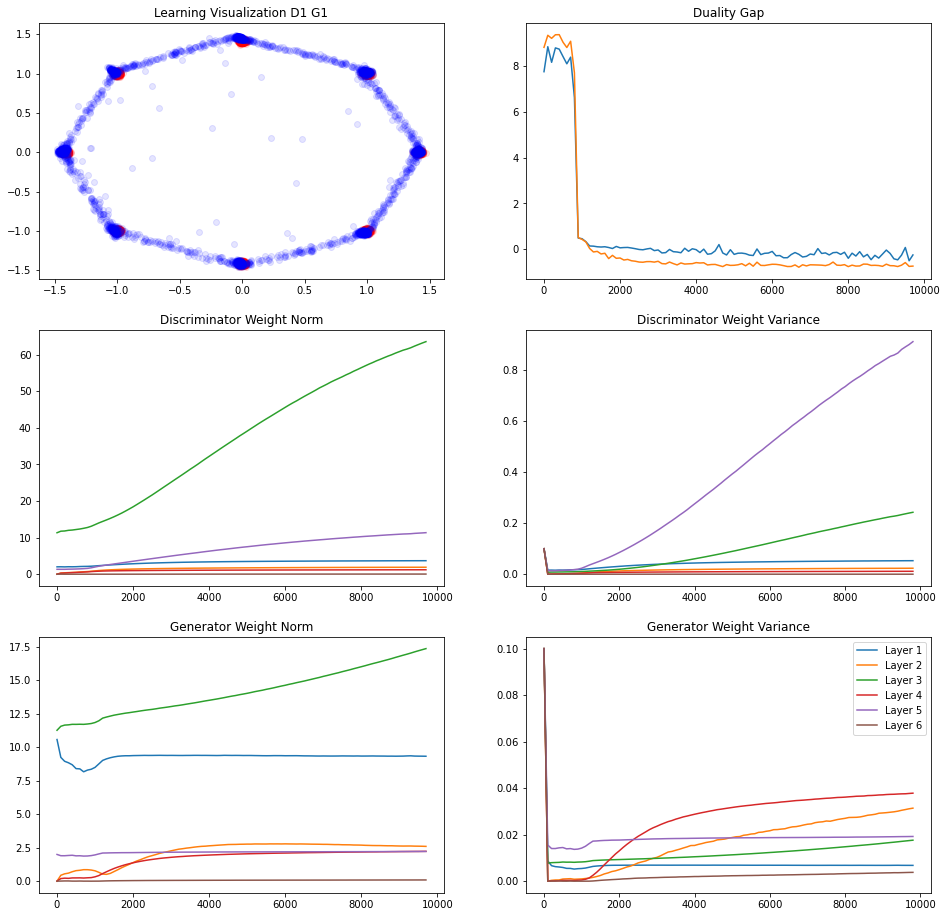

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.27659202
L Random  Duality Gap :  -0.67623967


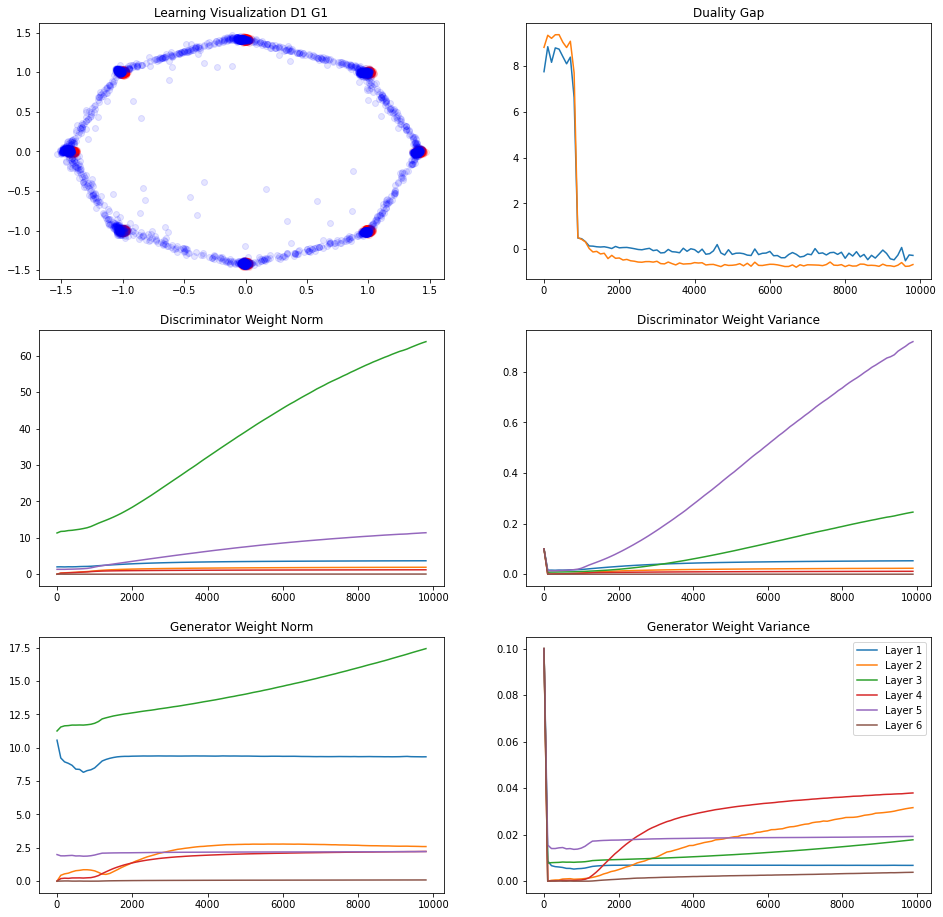

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.29744565
L Random  Duality Gap :  -0.6805644


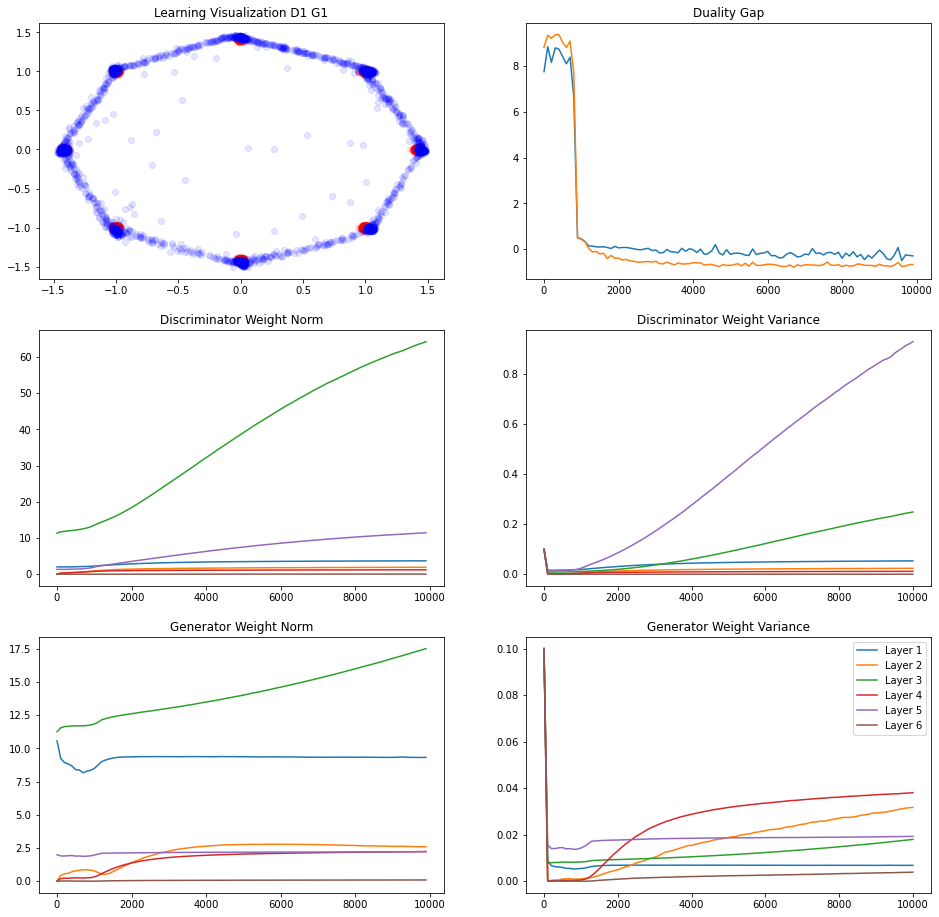

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.060277462
L Random  Duality Gap :  -0.5615466
10000/10001 [============================>.] - ETA: 0s ----------------------------------------------------------------------------------------------------
		8_modes DCGAN divergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/DCGAN/divergence
8_modes divergence
1 1
 M1 - Random : False
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.373296
L Random  Duality Gap :  9.894521
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3809452
L Random  Duality Gap :  9.418257


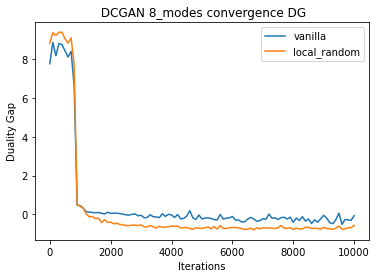

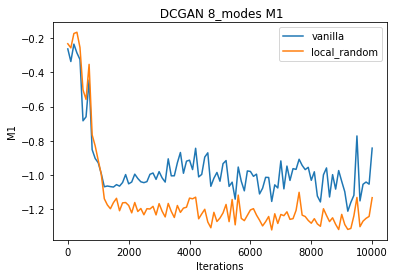

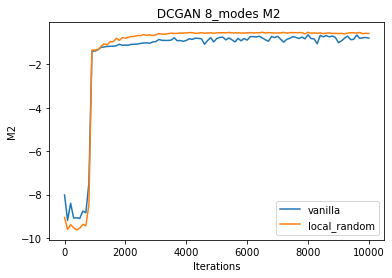

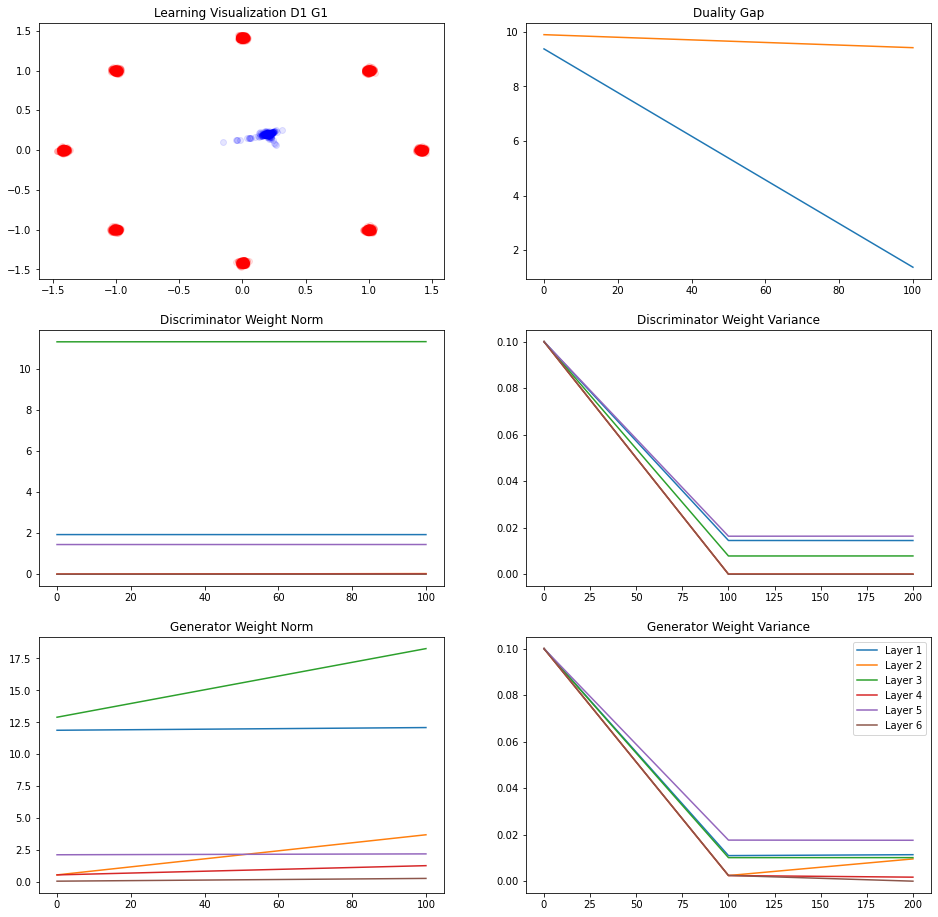

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3325409
L Random  Duality Gap :  0.78923965


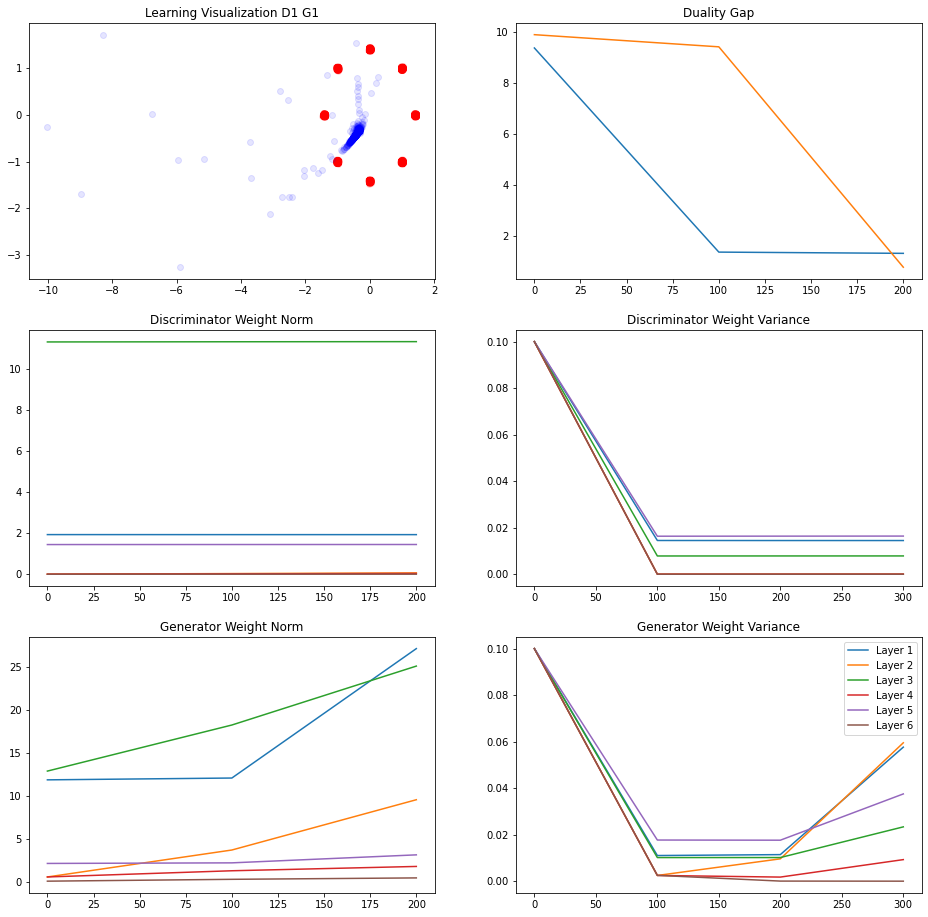

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.340979
L Random  Duality Gap :  1.1120695


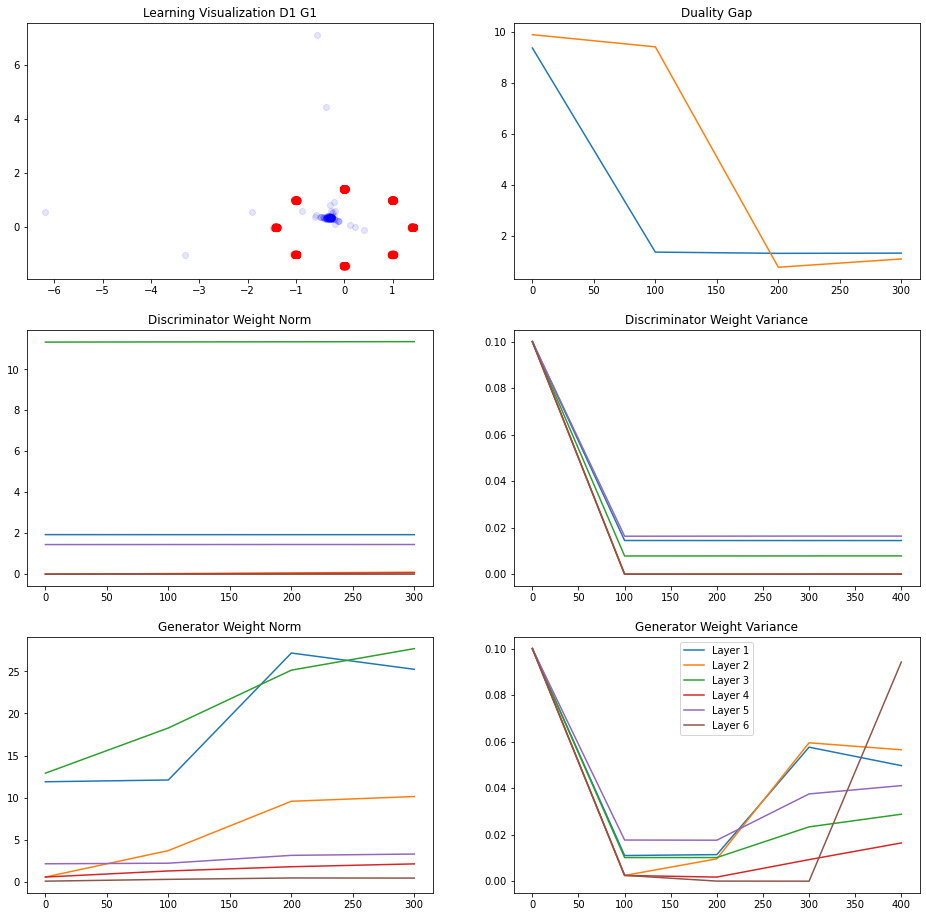

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1190456
L Random  Duality Gap :  0.89462453


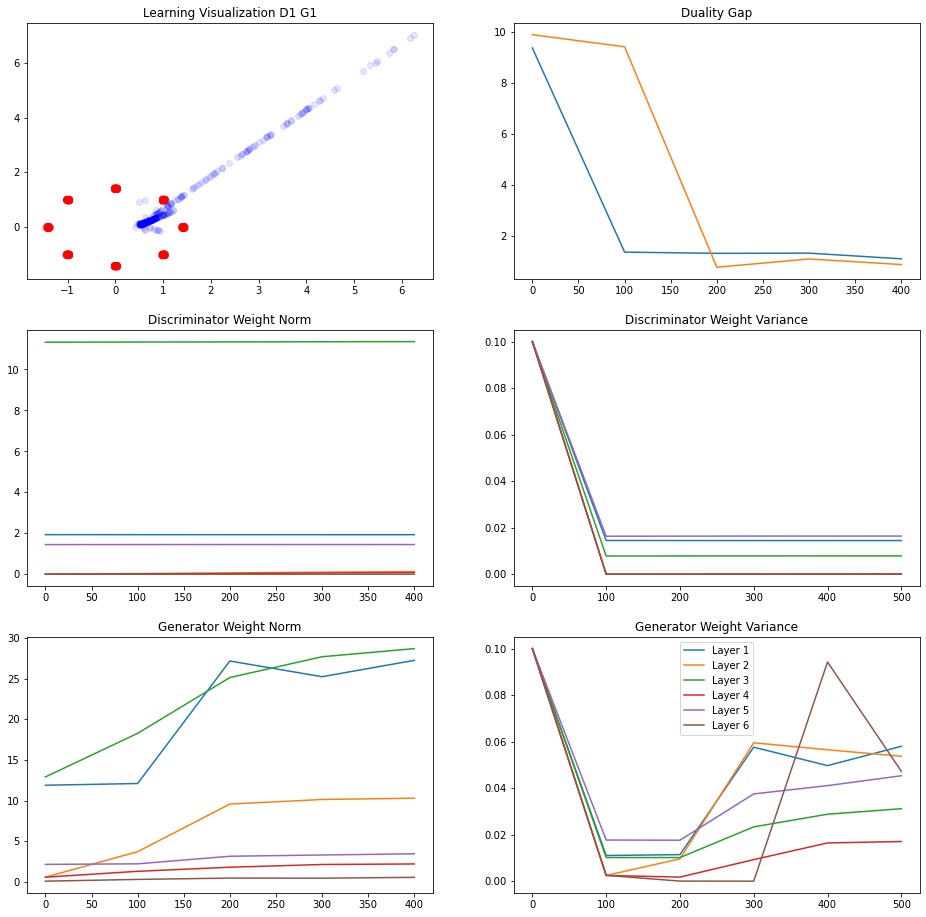

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8763989
L Random  Duality Gap :  0.9460654
242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9057262
L Random  Duality Gap :  0.8673664


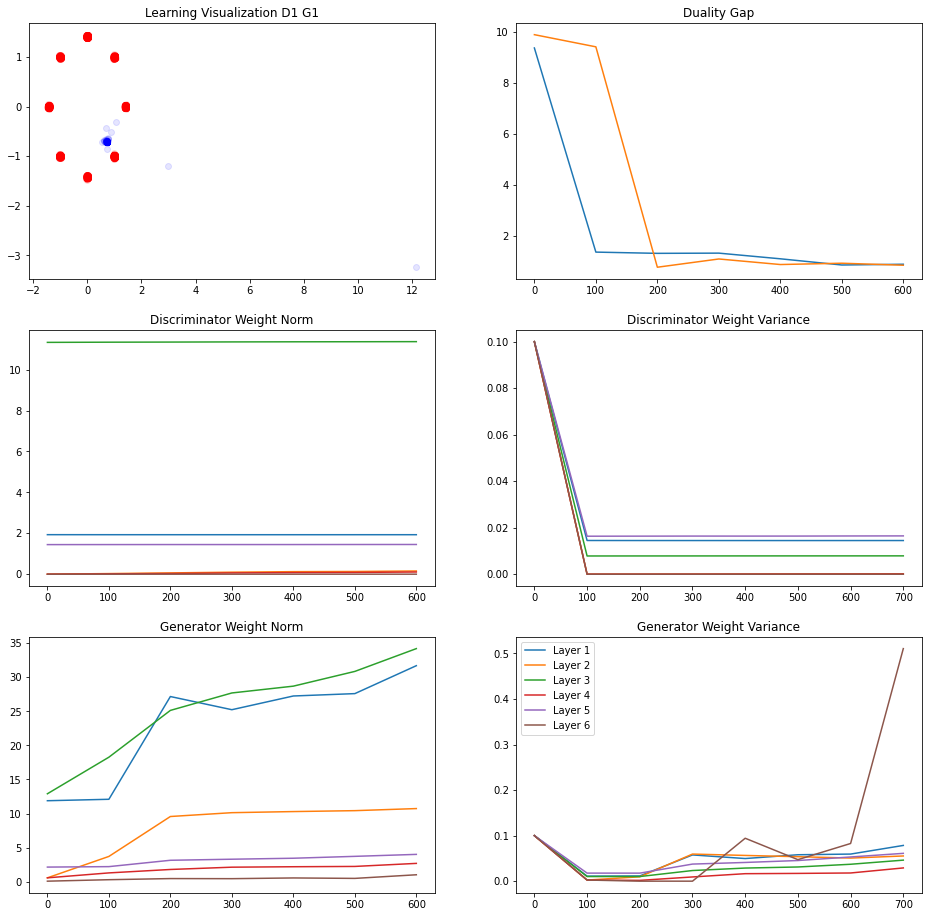

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.87004757
L Random  Duality Gap :  9.348971


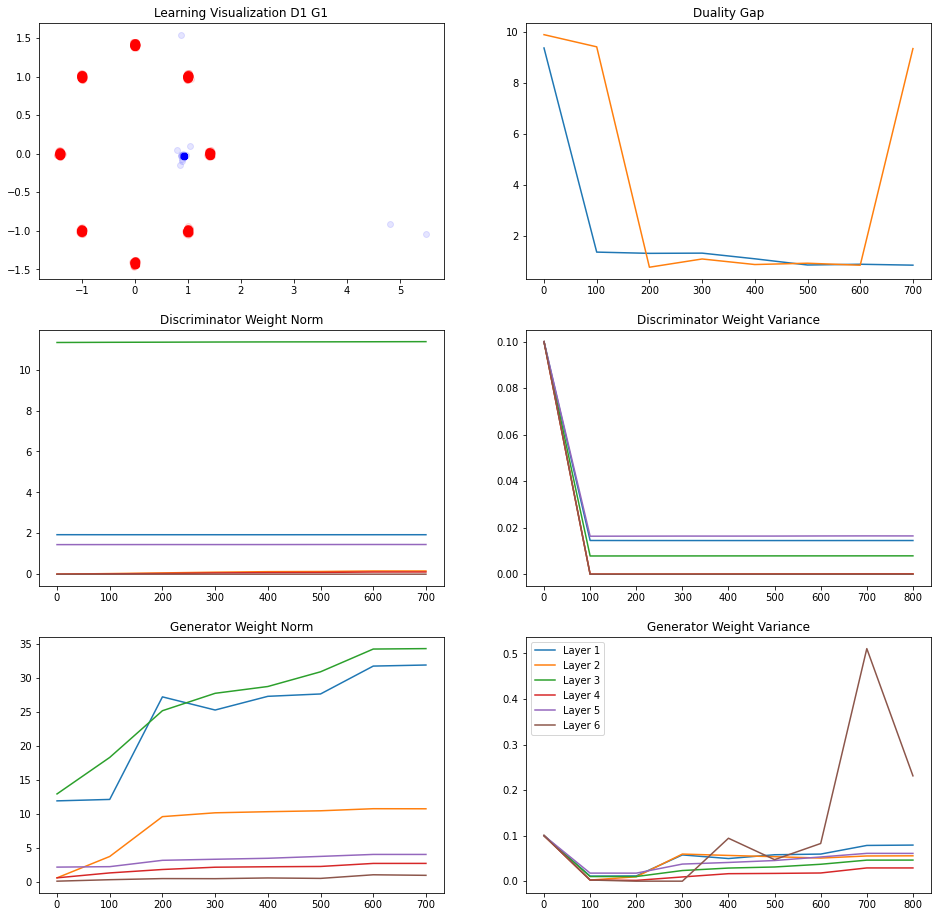

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9426767
L Random  Duality Gap :  0.7757336


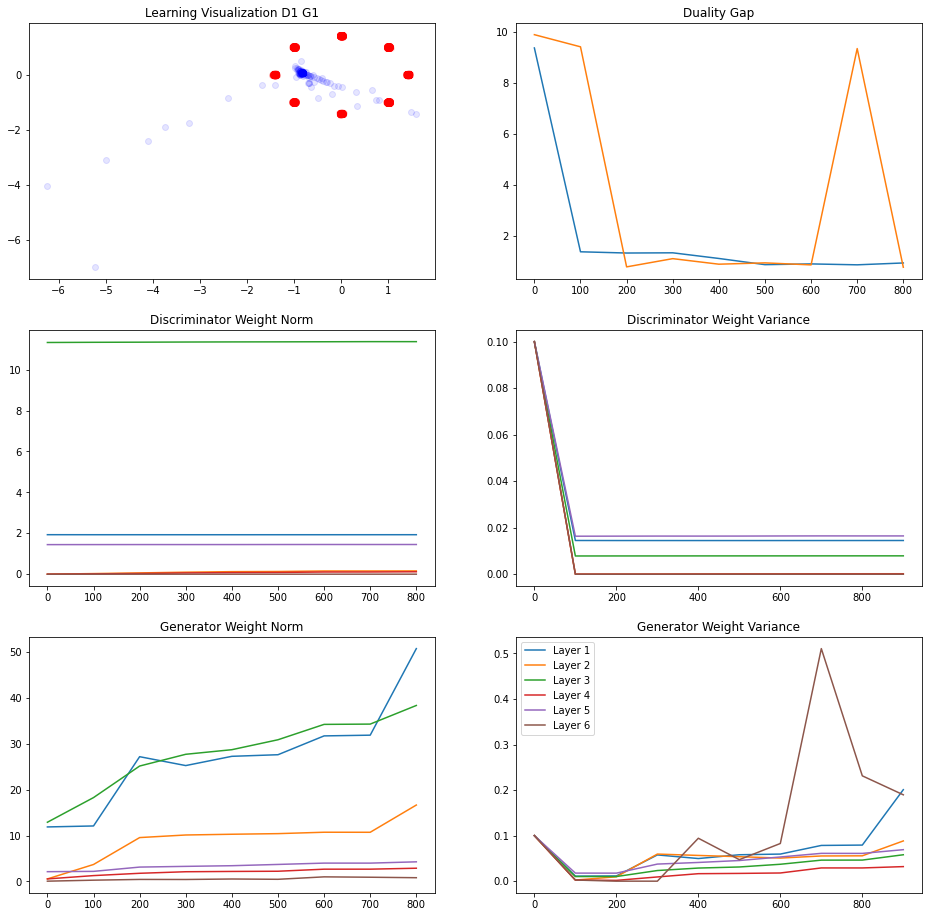

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1049886
L Random  Duality Gap :  9.808669


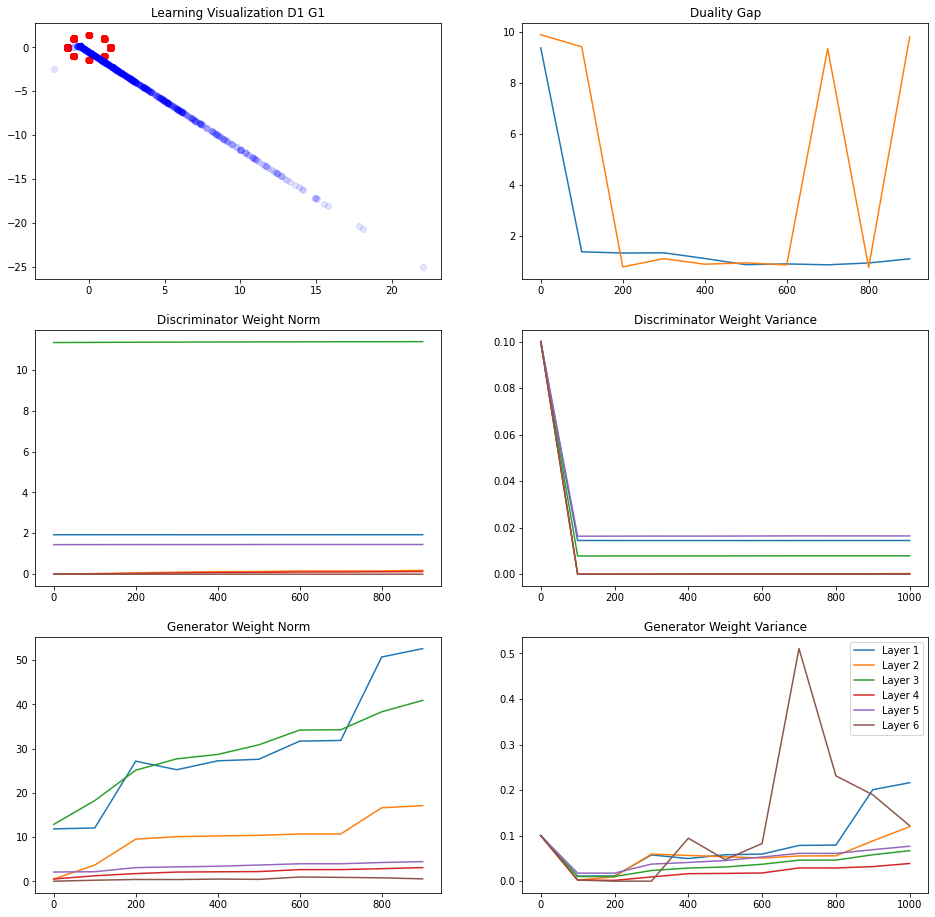

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9342257
L Random  Duality Gap :  0.8061834
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1374583
L Random  Duality Gap :  0.80447465


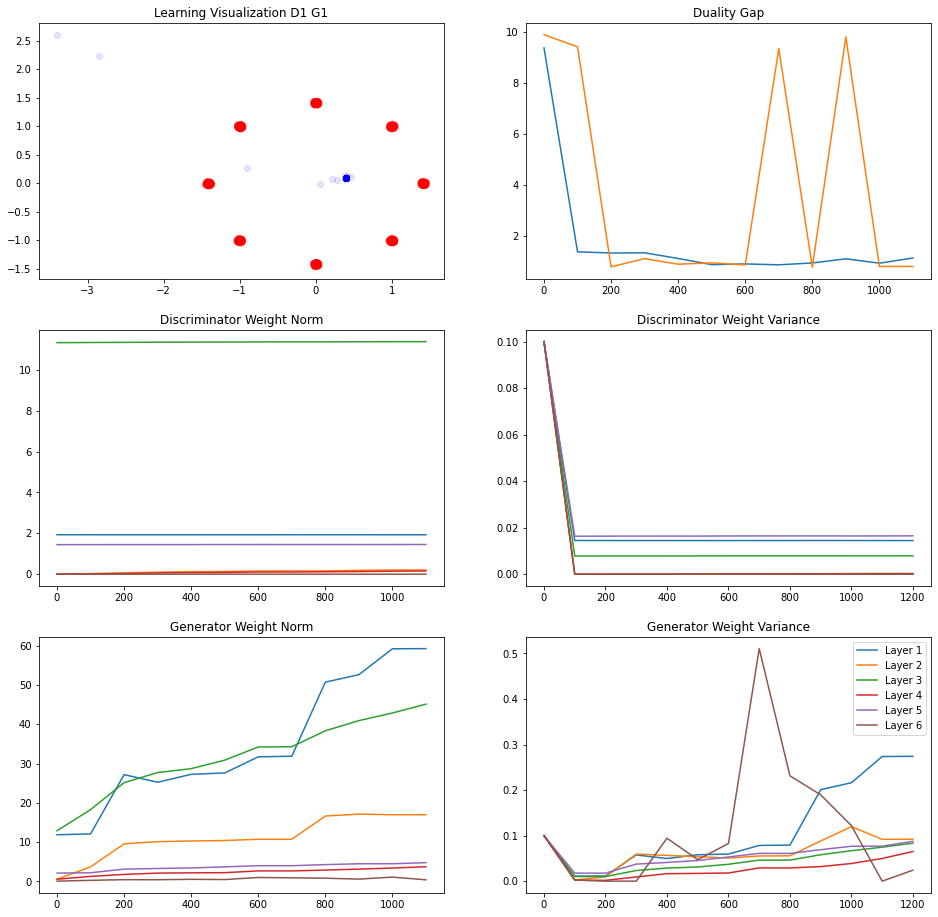

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9297154
L Random  Duality Gap :  0.9761075


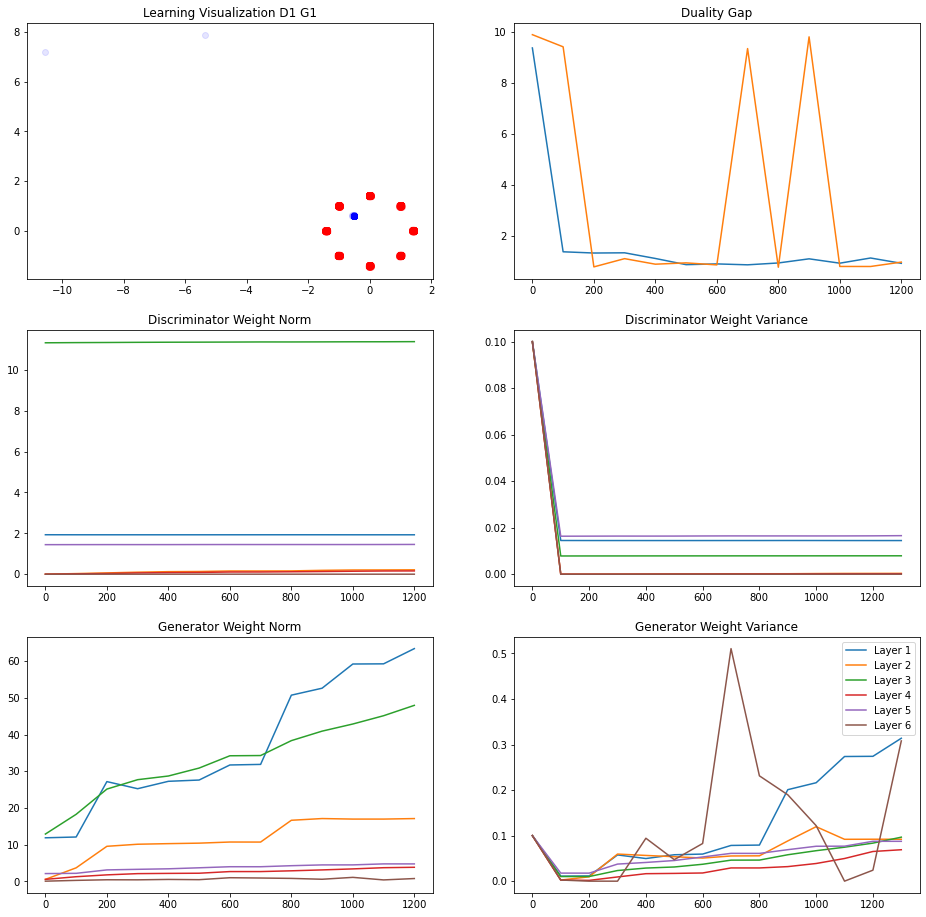

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2061912
L Random  Duality Gap :  0.7488948


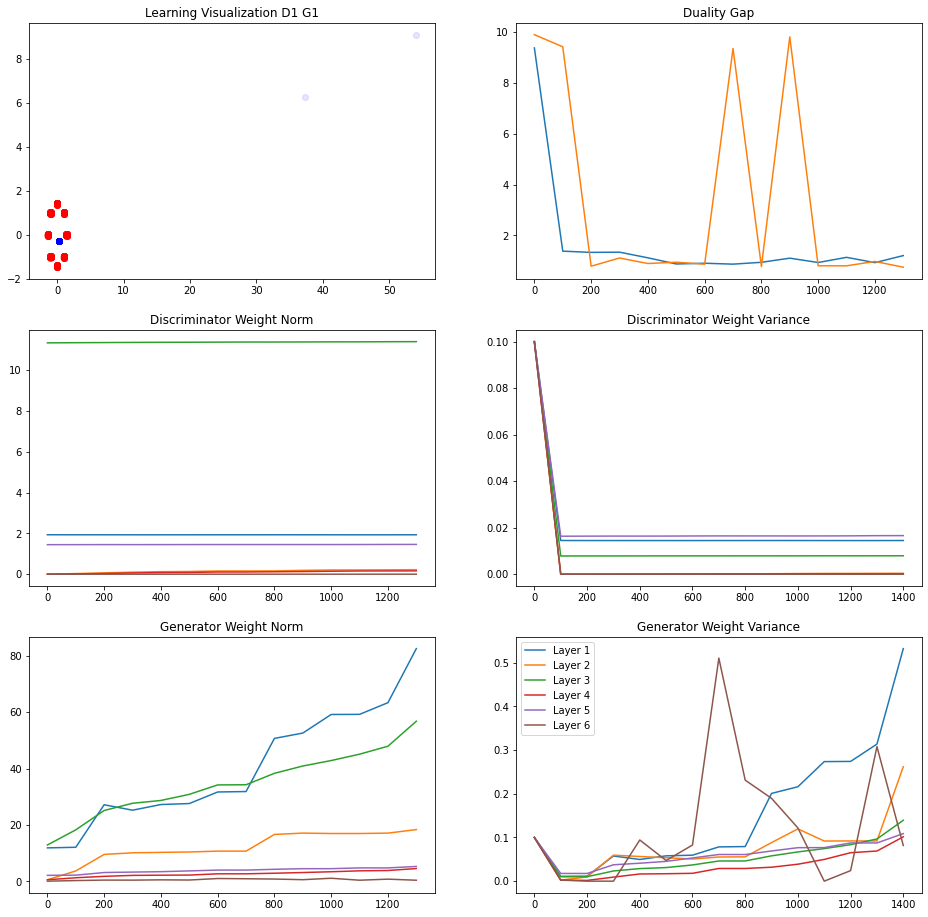

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8546032
L Random  Duality Gap :  9.825161


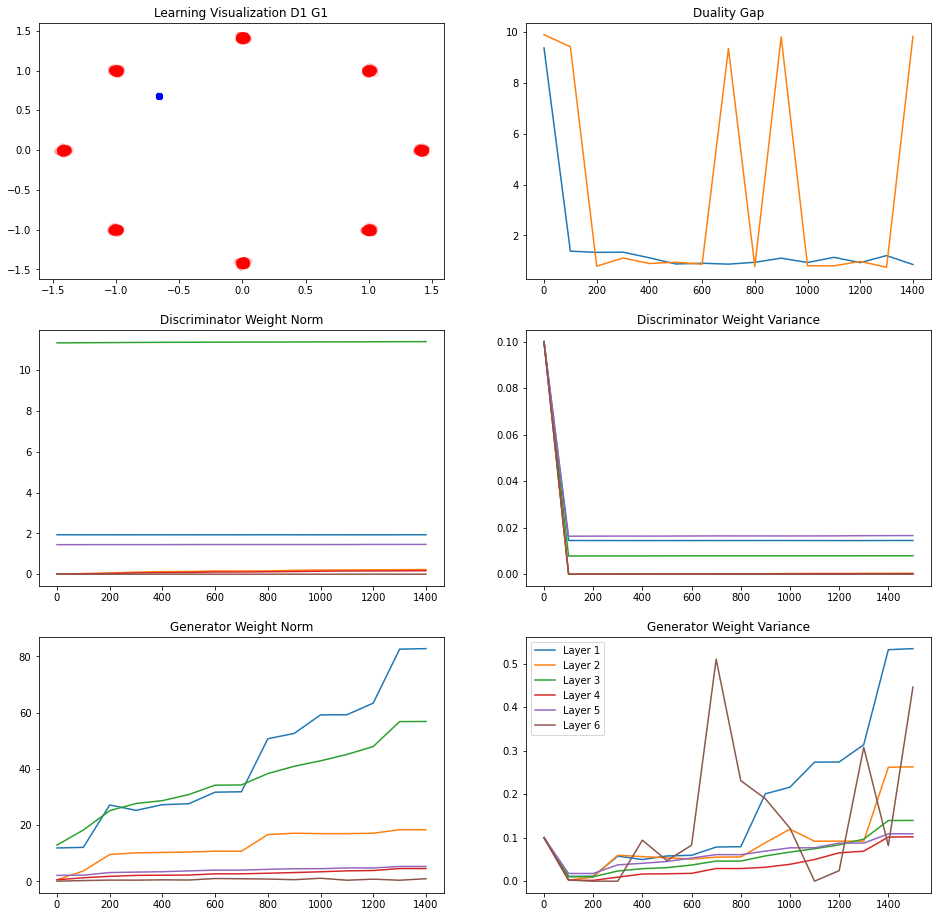

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2543657
L Random  Duality Gap :  0.9430911
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1964023
L Random  Duality Gap :  9.687088


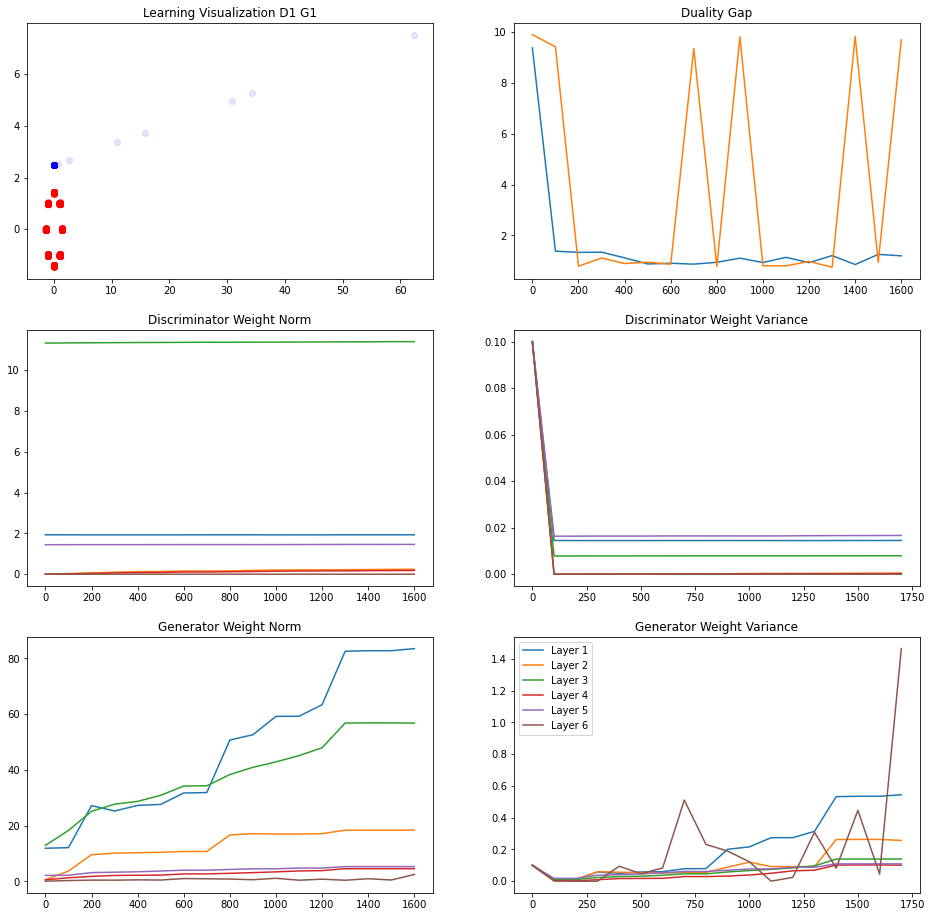

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.94824827
L Random  Duality Gap :  0.8557519


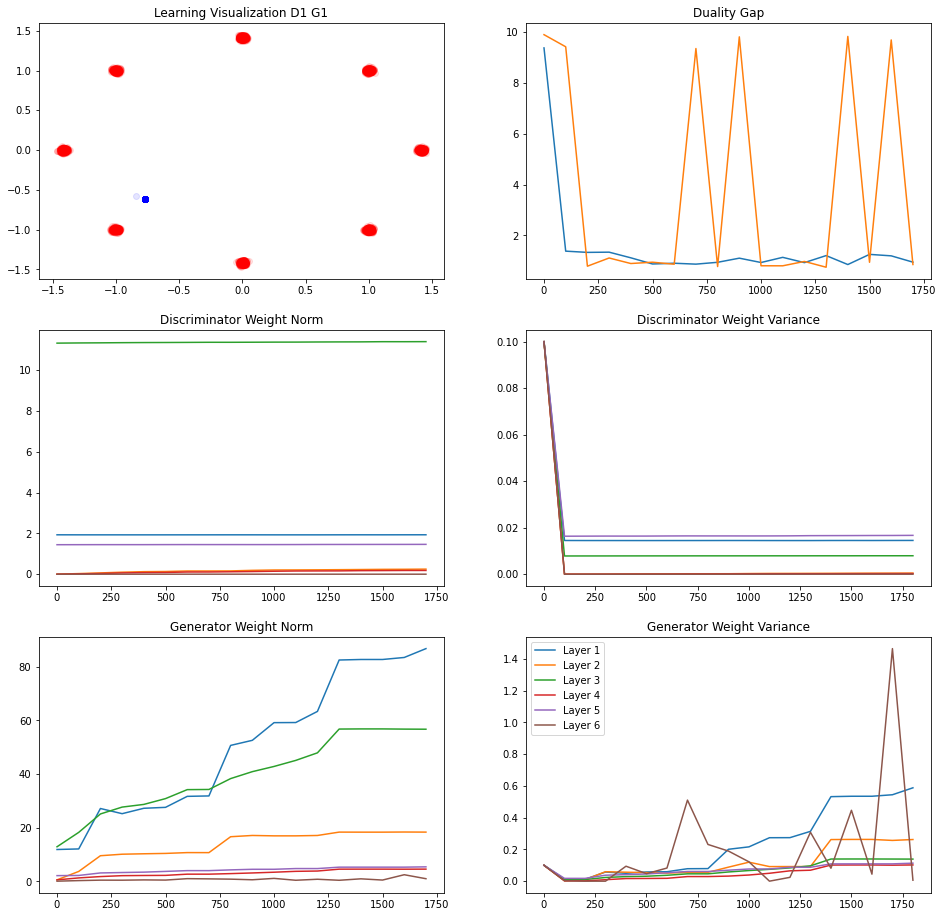

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.878087
L Random  Duality Gap :  9.857058


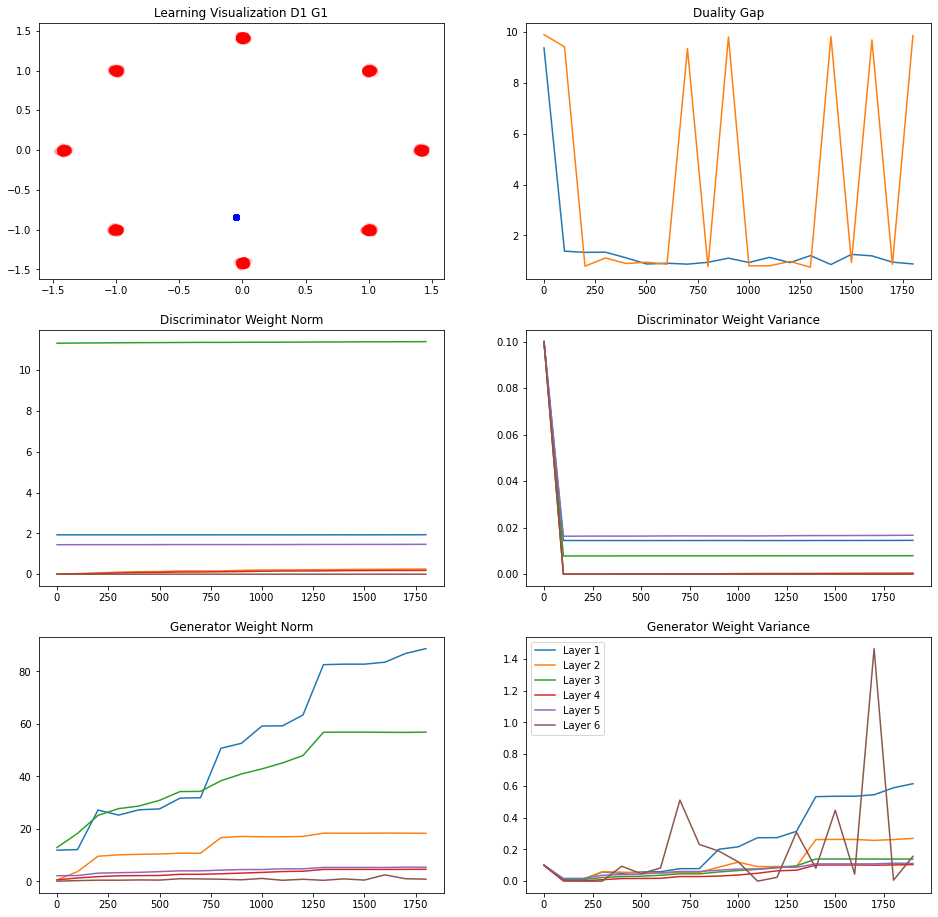

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0174712
L Random  Duality Gap :  9.778109


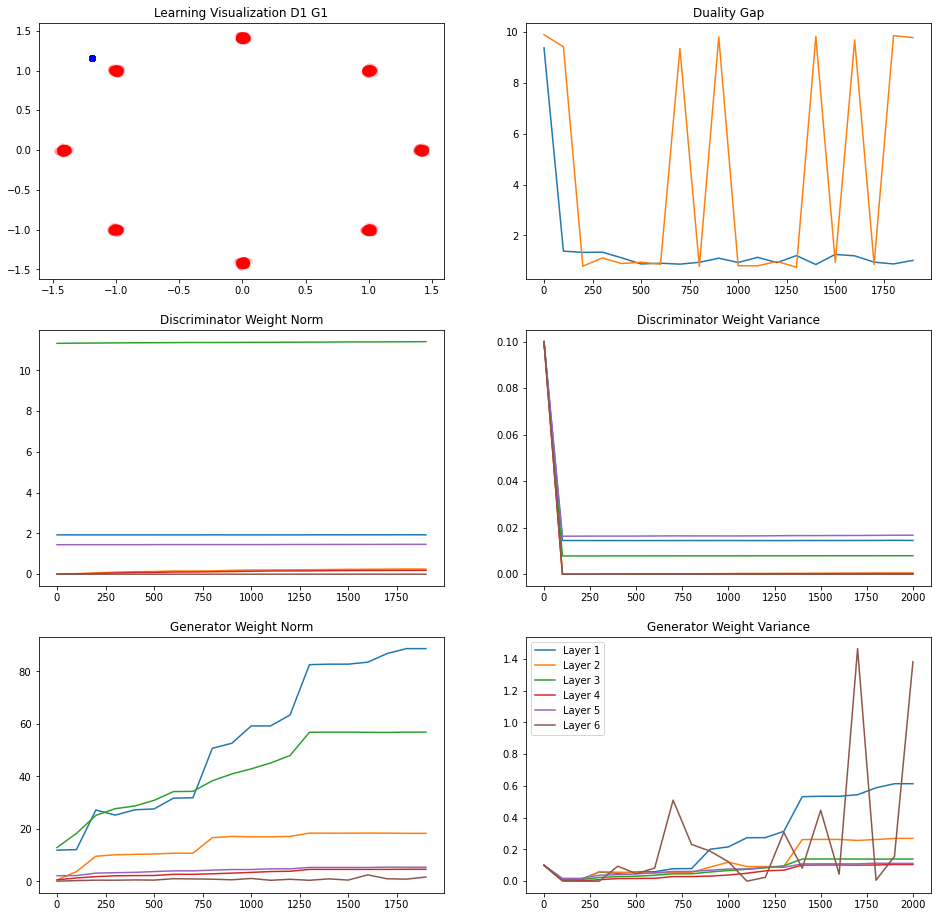

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1049756
L Random  Duality Gap :  9.284932
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1086576
L Random  Duality Gap :  0.7516344


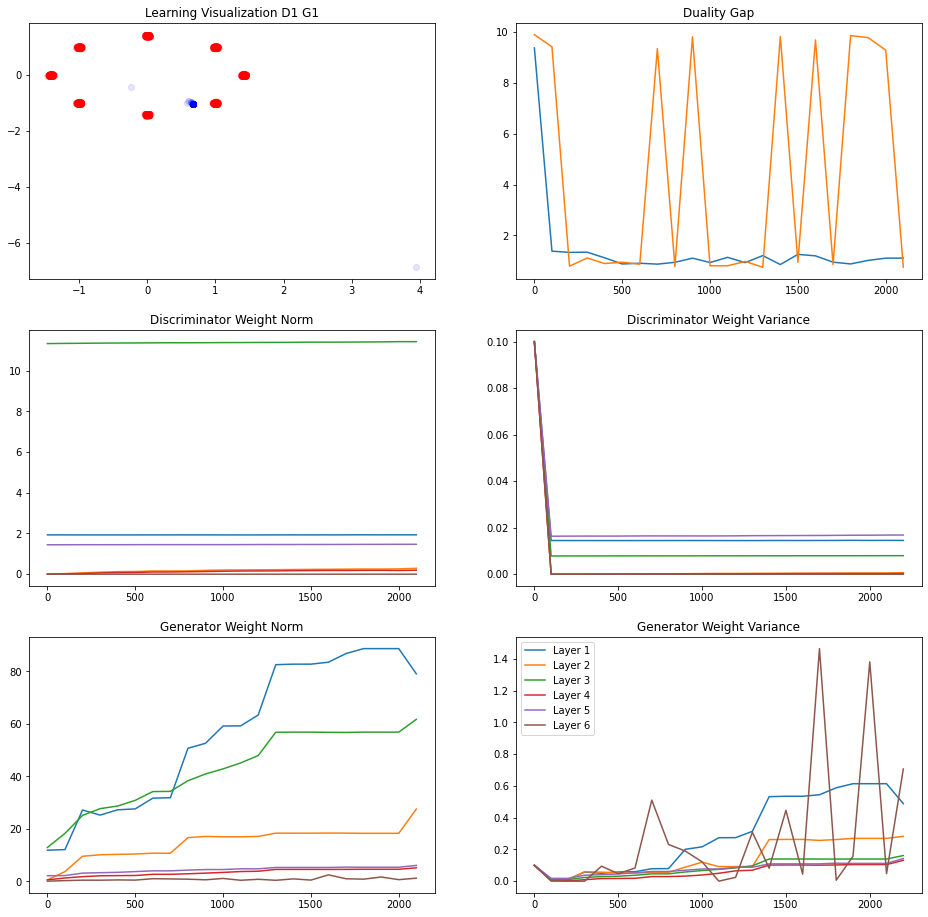

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9420823
L Random  Duality Gap :  0.7597252


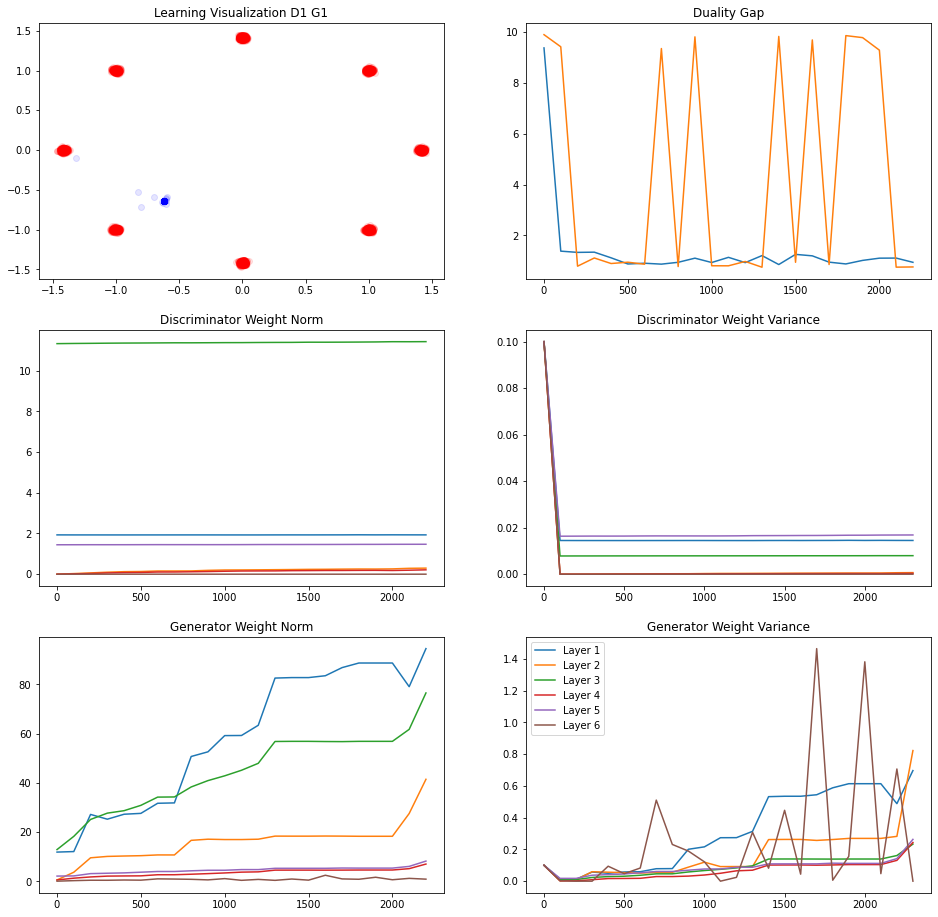

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9654796
L Random  Duality Gap :  0.7426228


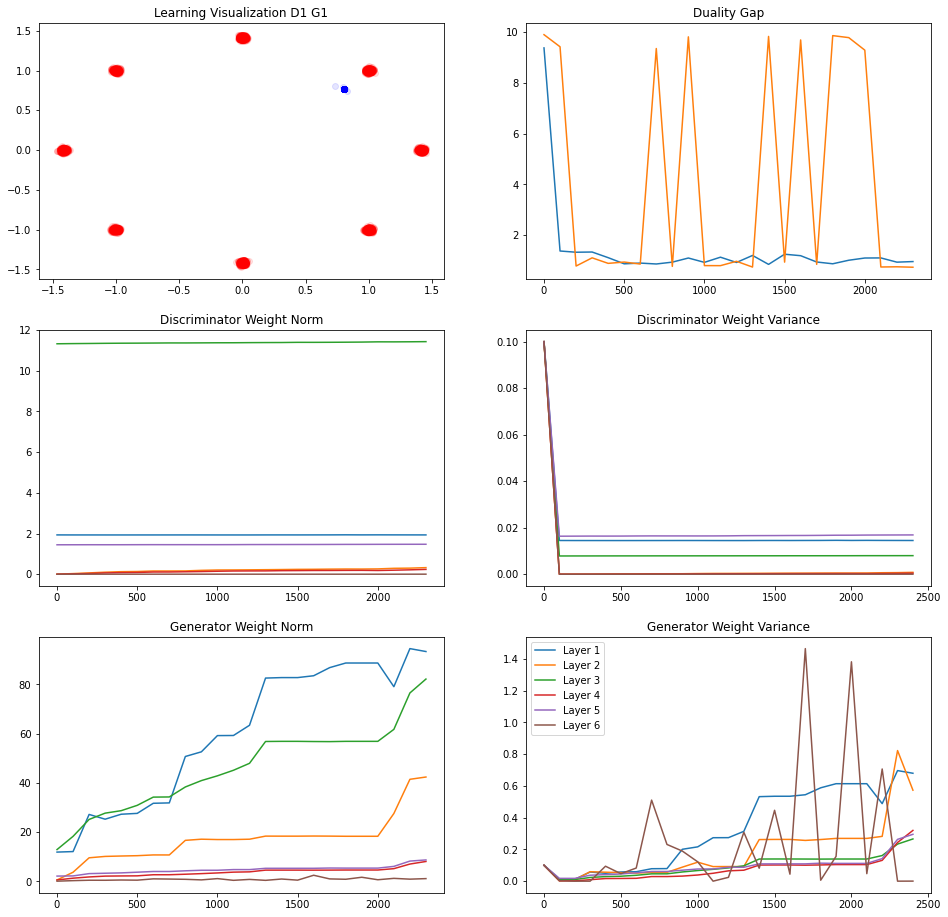

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.88620394
L Random  Duality Gap :  0.7298059


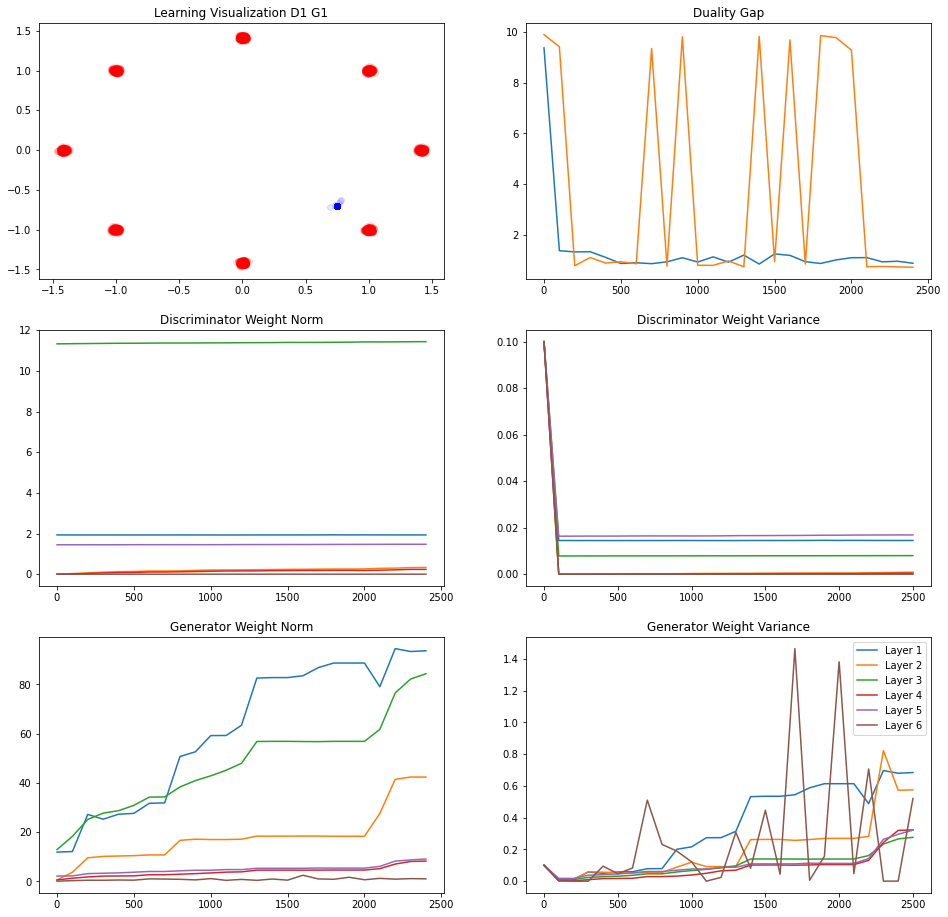

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.119344
L Random  Duality Gap :  9.744491
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0410702
L Random  Duality Gap :  9.667916


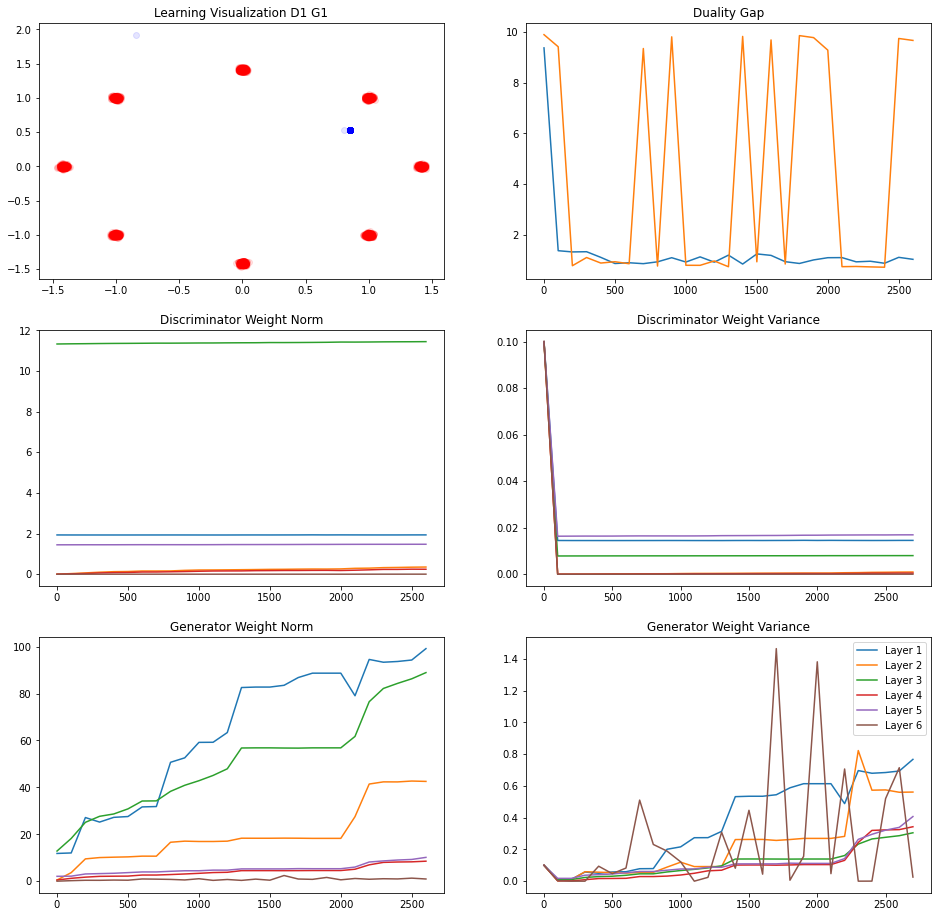

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.96141875
L Random  Duality Gap :  0.74501956


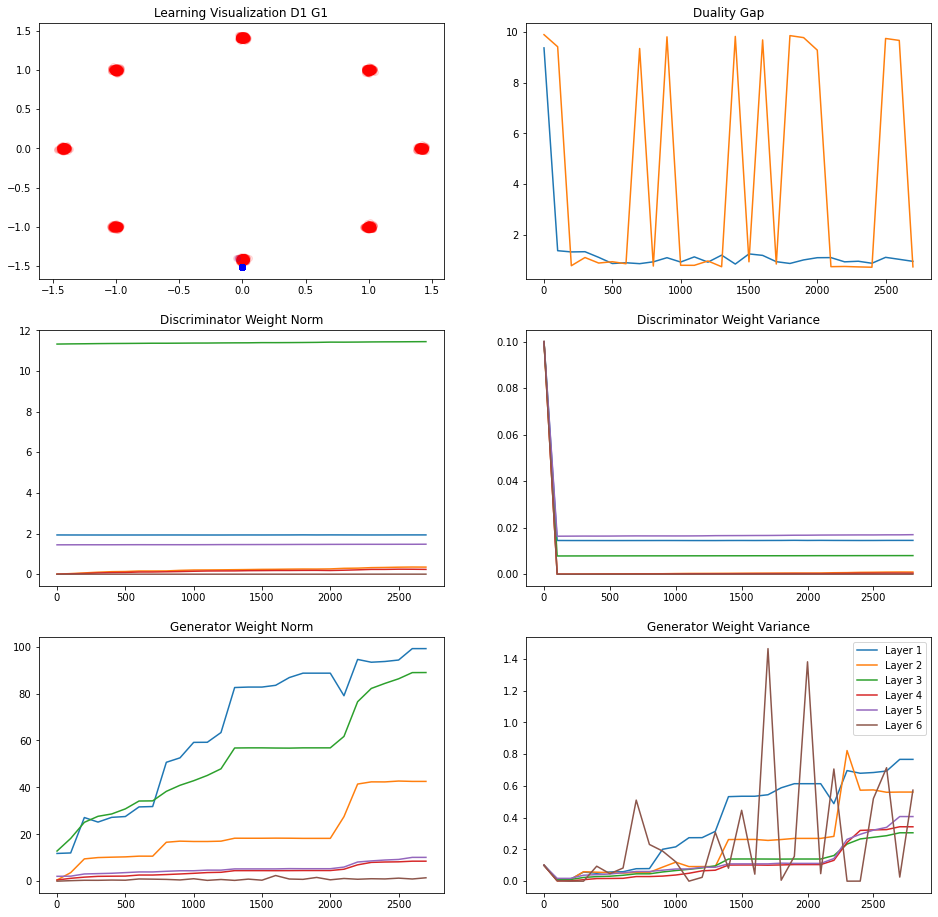

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.91166973
L Random  Duality Gap :  1.2566586


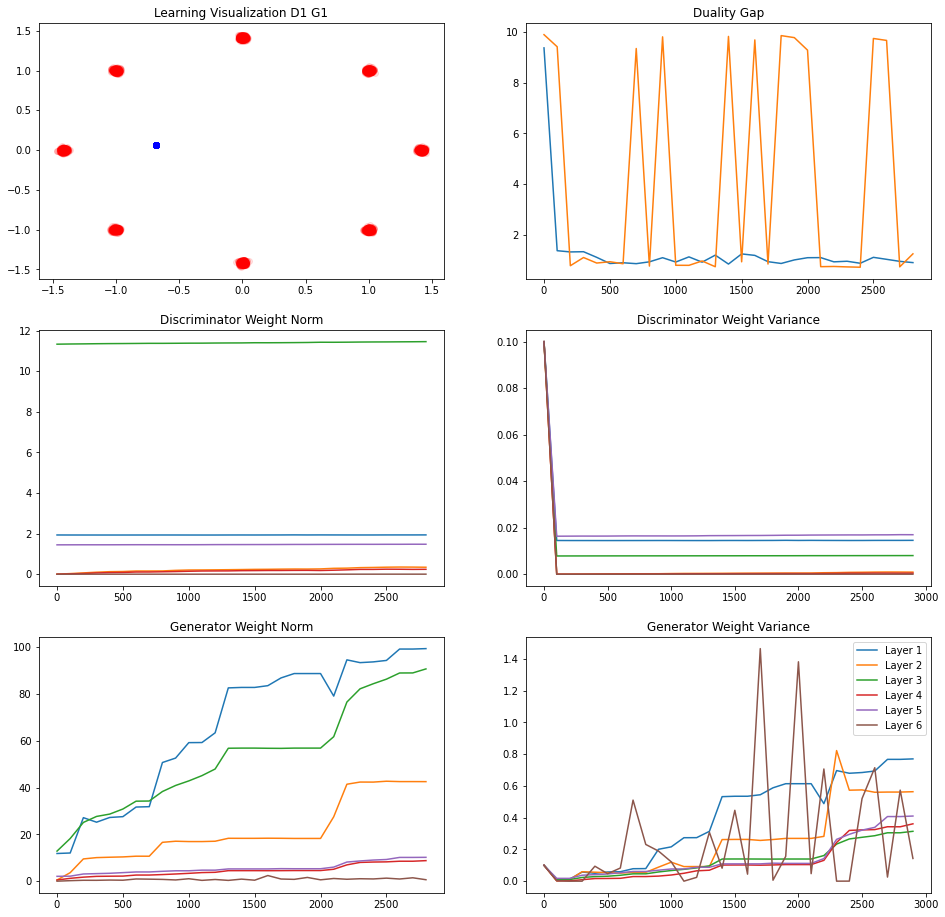

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.93230563
L Random  Duality Gap :  9.790822


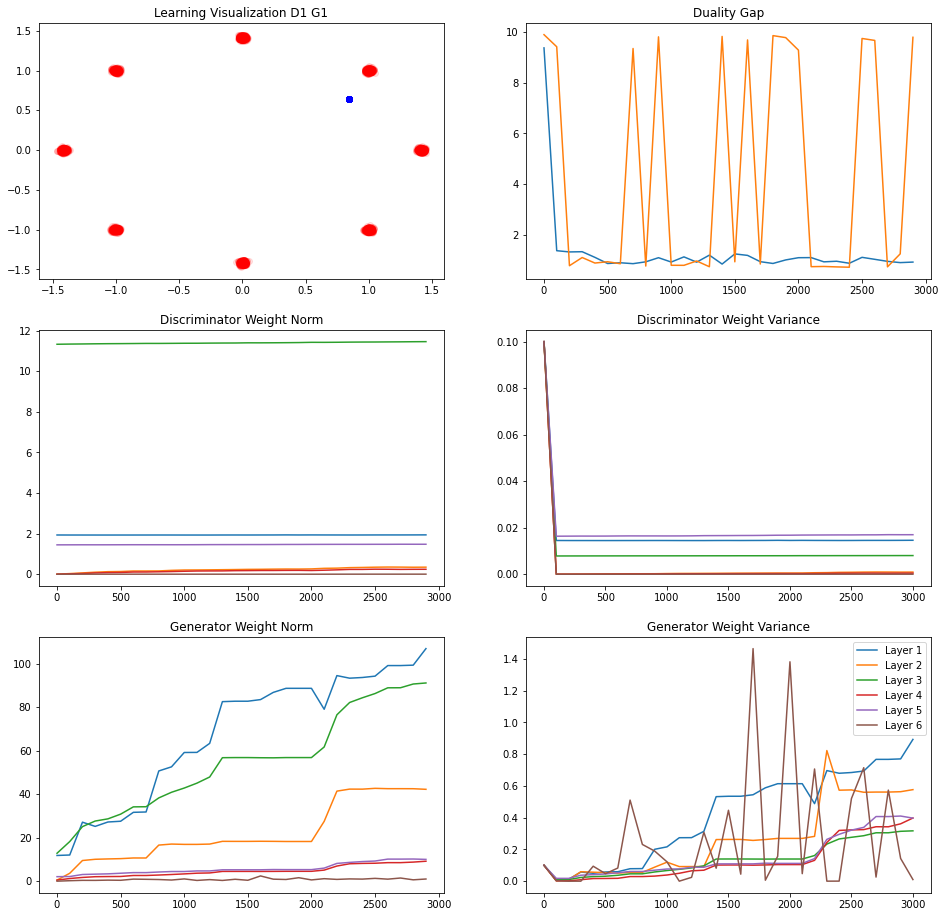

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8827466
L Random  Duality Gap :  9.577925
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.92724764
L Random  Duality Gap :  9.777985


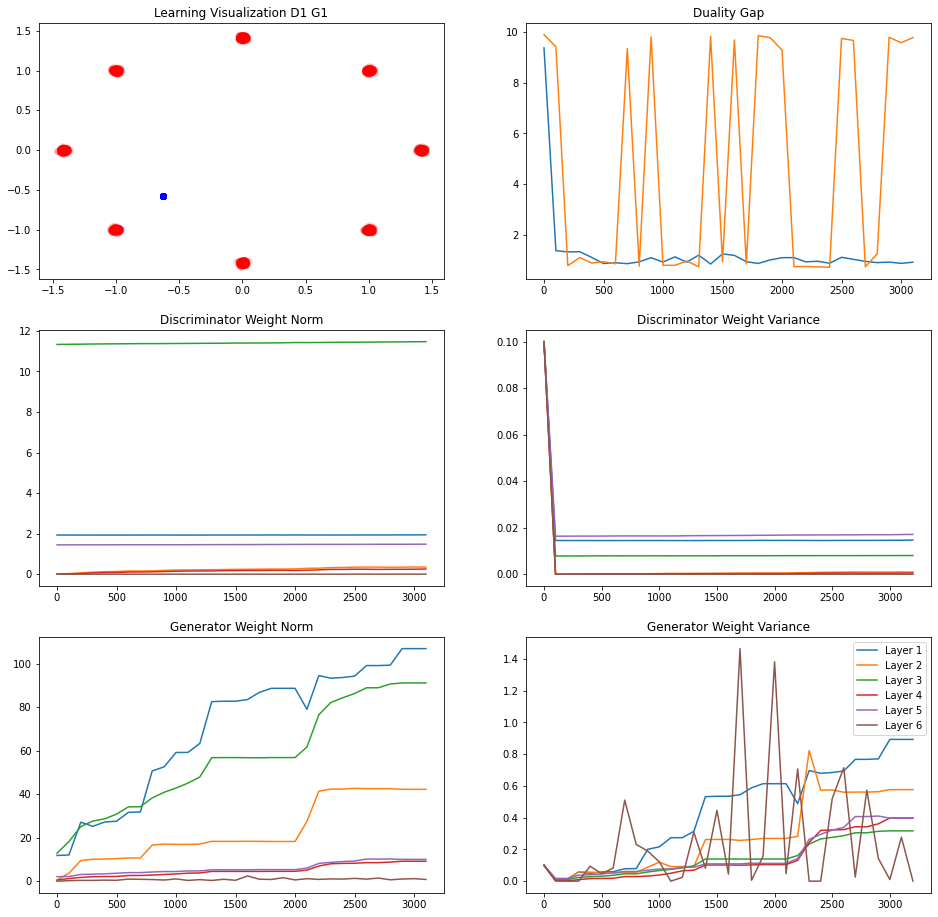

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.929229
L Random  Duality Gap :  9.211432


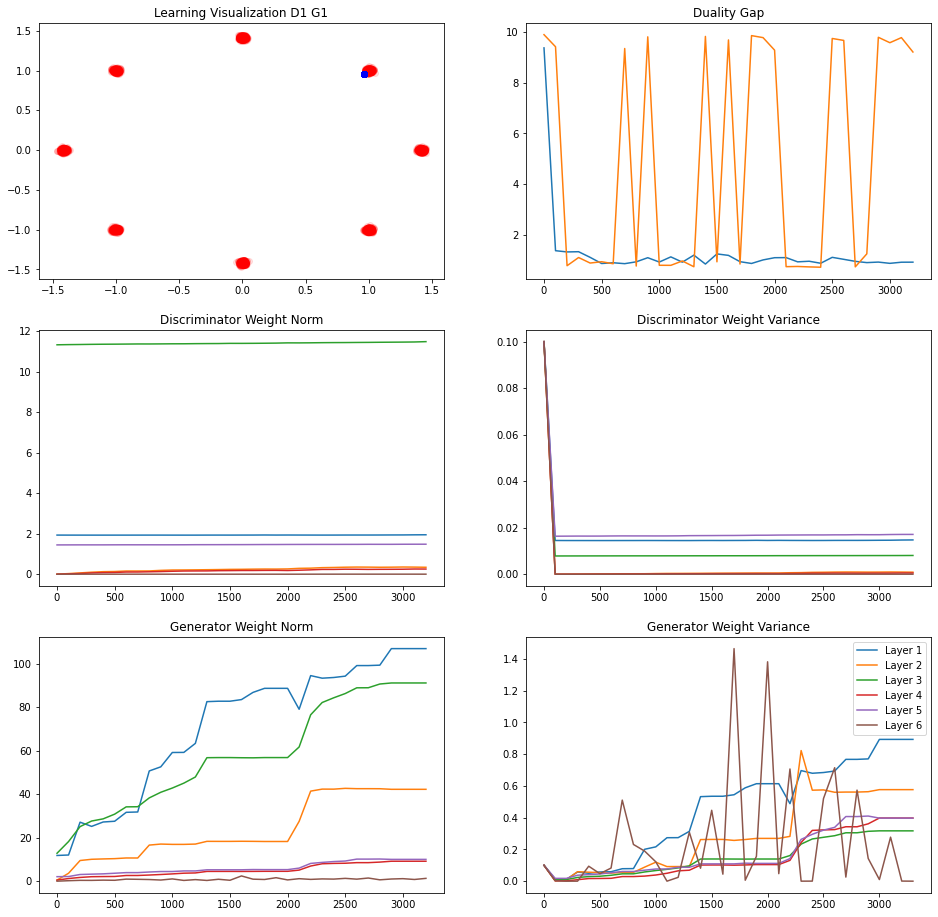

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0311427
L Random  Duality Gap :  9.785281


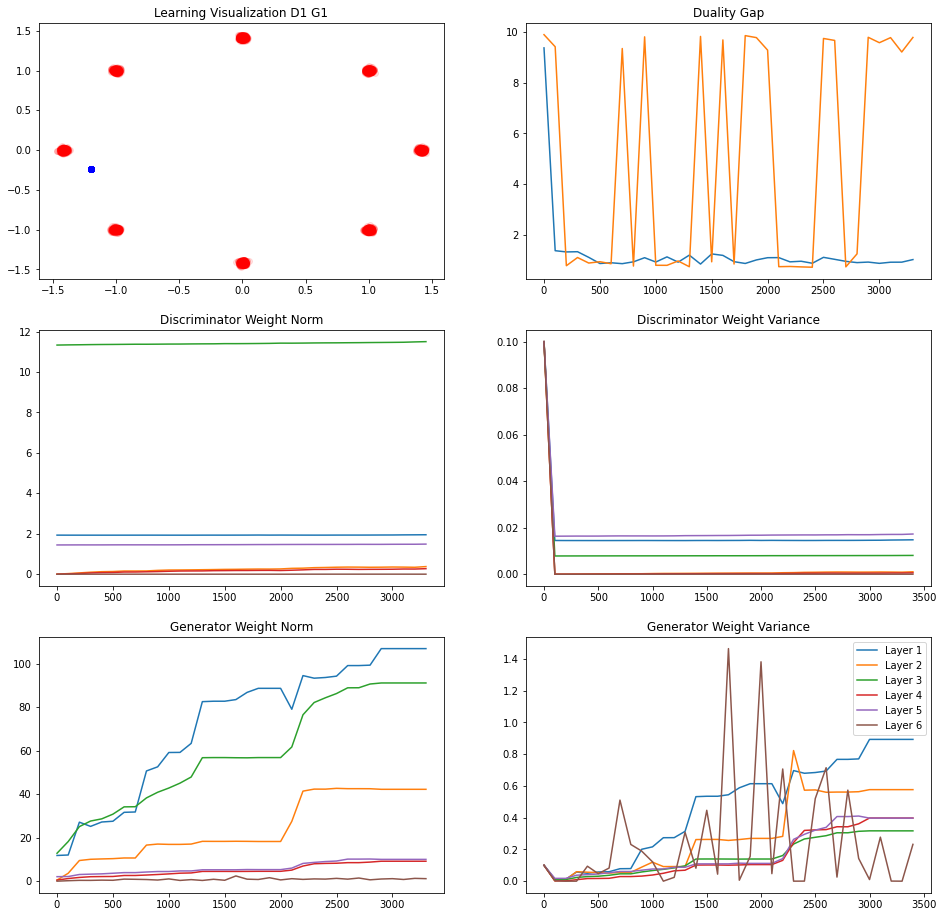

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.94492054
L Random  Duality Gap :  0.79453987


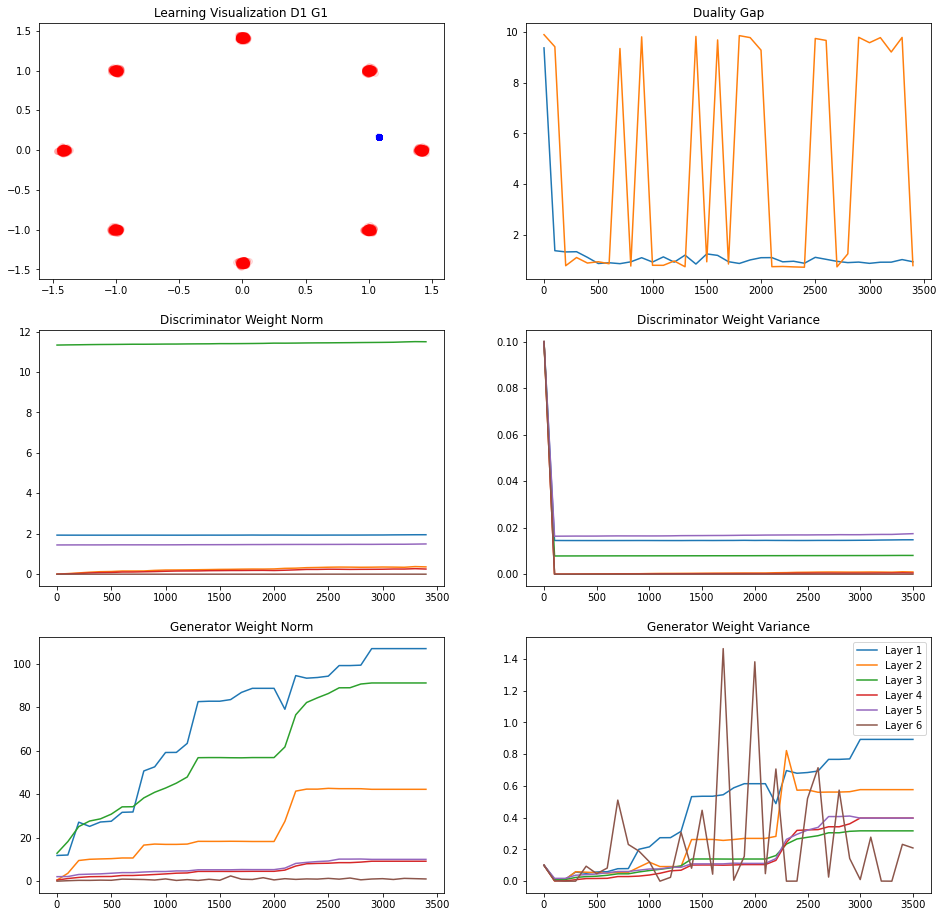

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0326996
L Random  Duality Gap :  9.699853
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1093653
L Random  Duality Gap :  9.758065


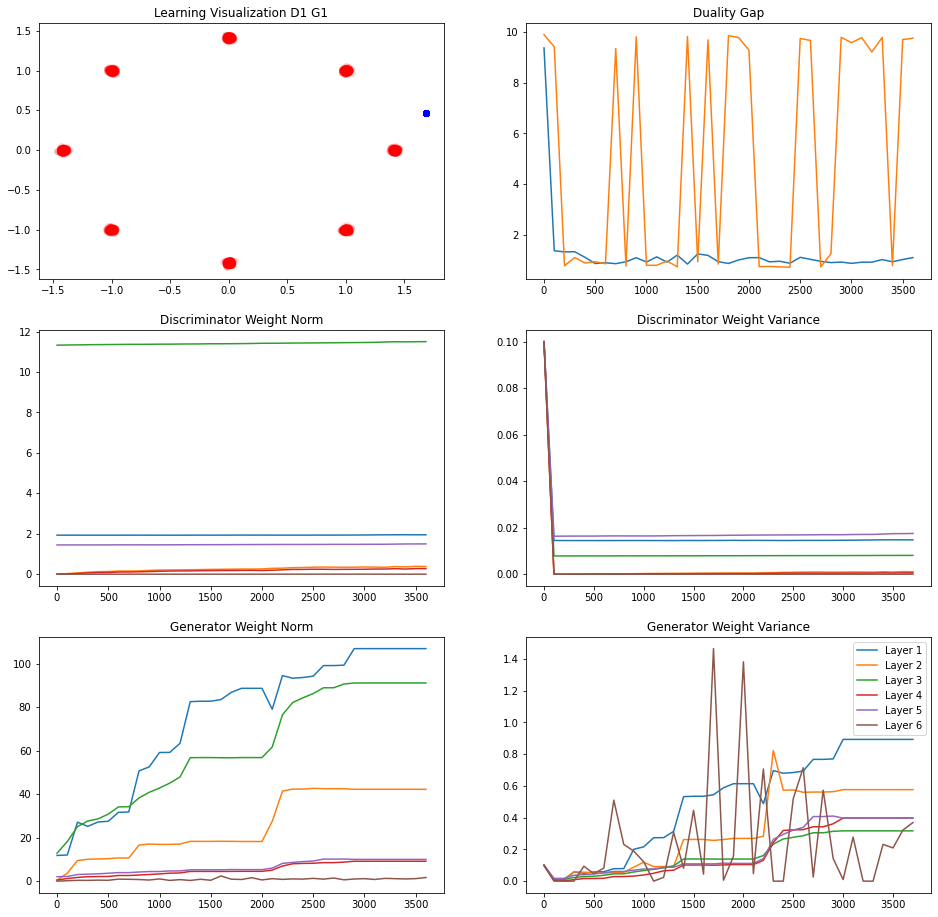

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.007432
L Random  Duality Gap :  9.805394


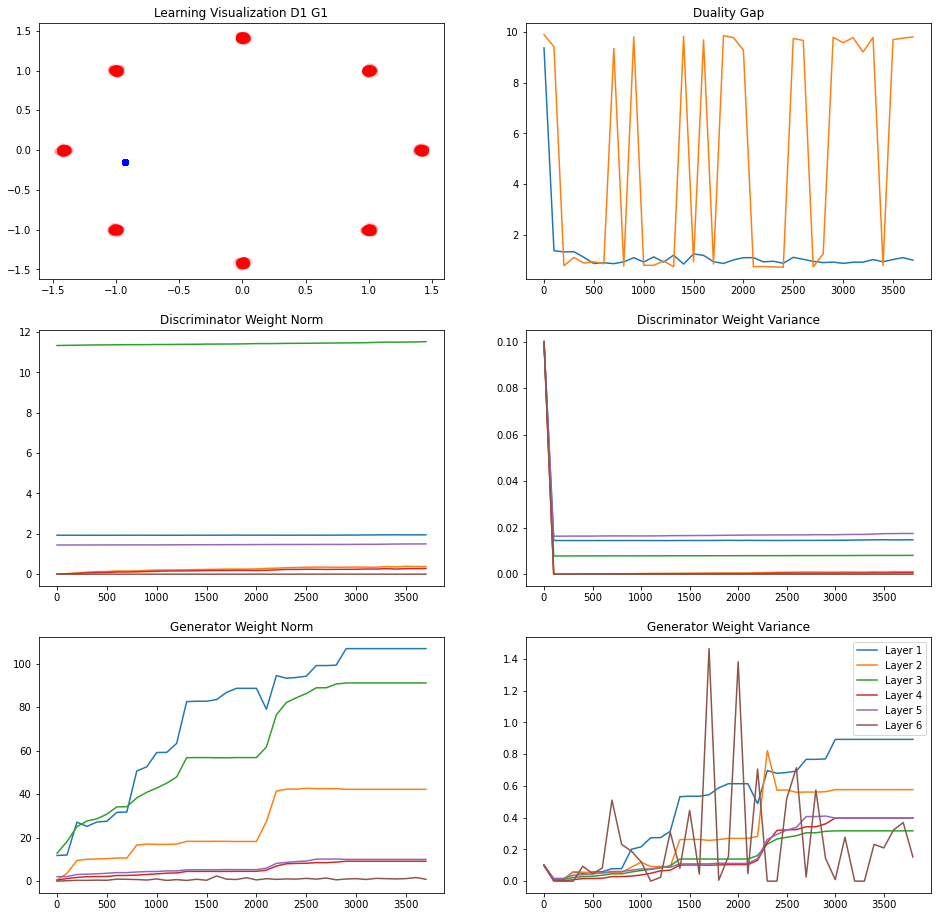

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.961378
L Random  Duality Gap :  9.851103


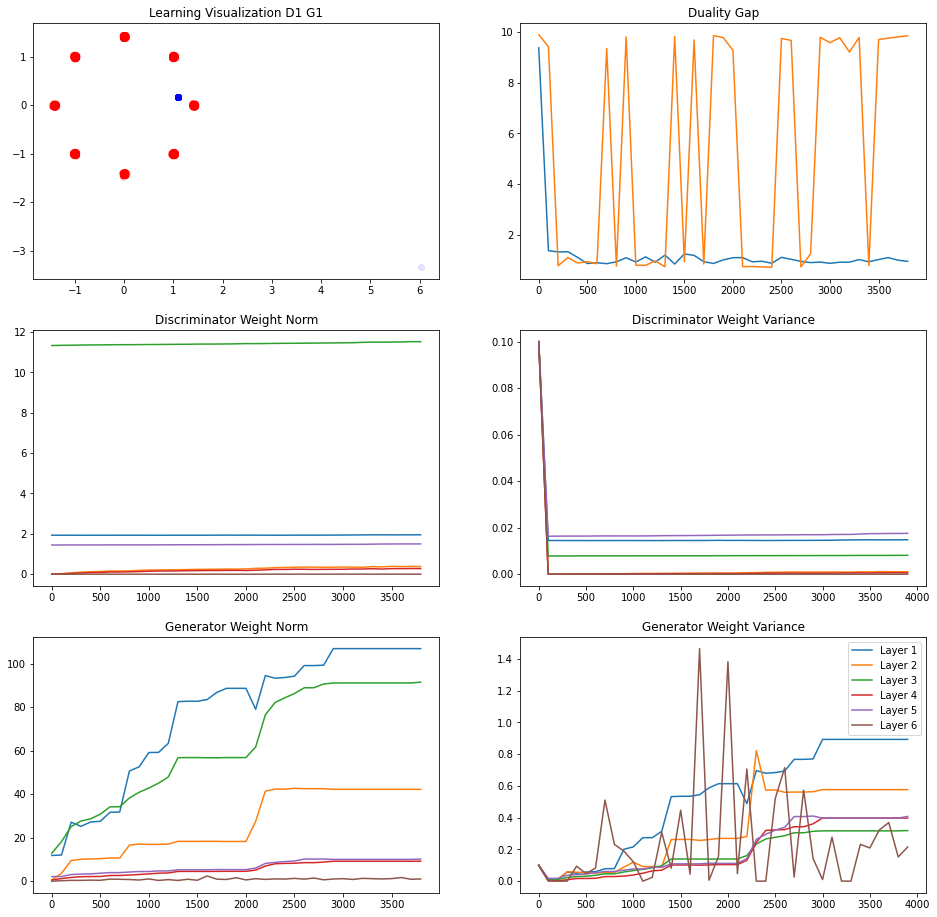

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.865238
L Random  Duality Gap :  0.819186


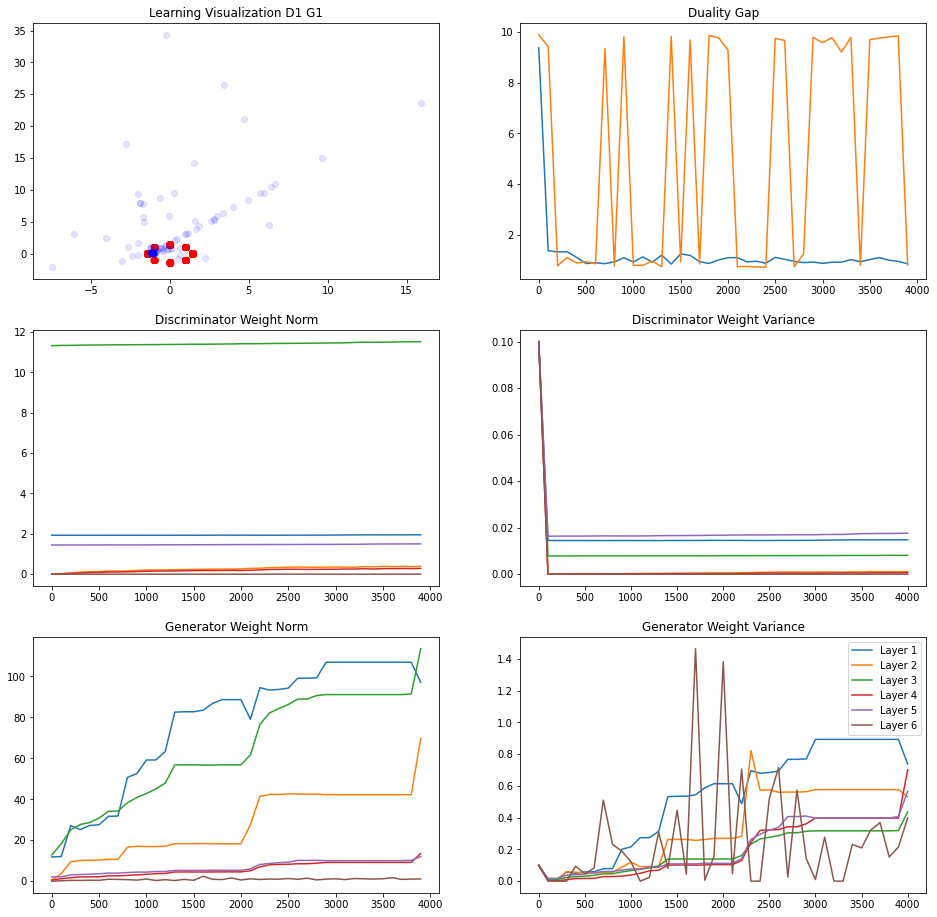

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.7843017
L Random  Duality Gap :  0.8554546
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9540973
L Random  Duality Gap :  0.8828928


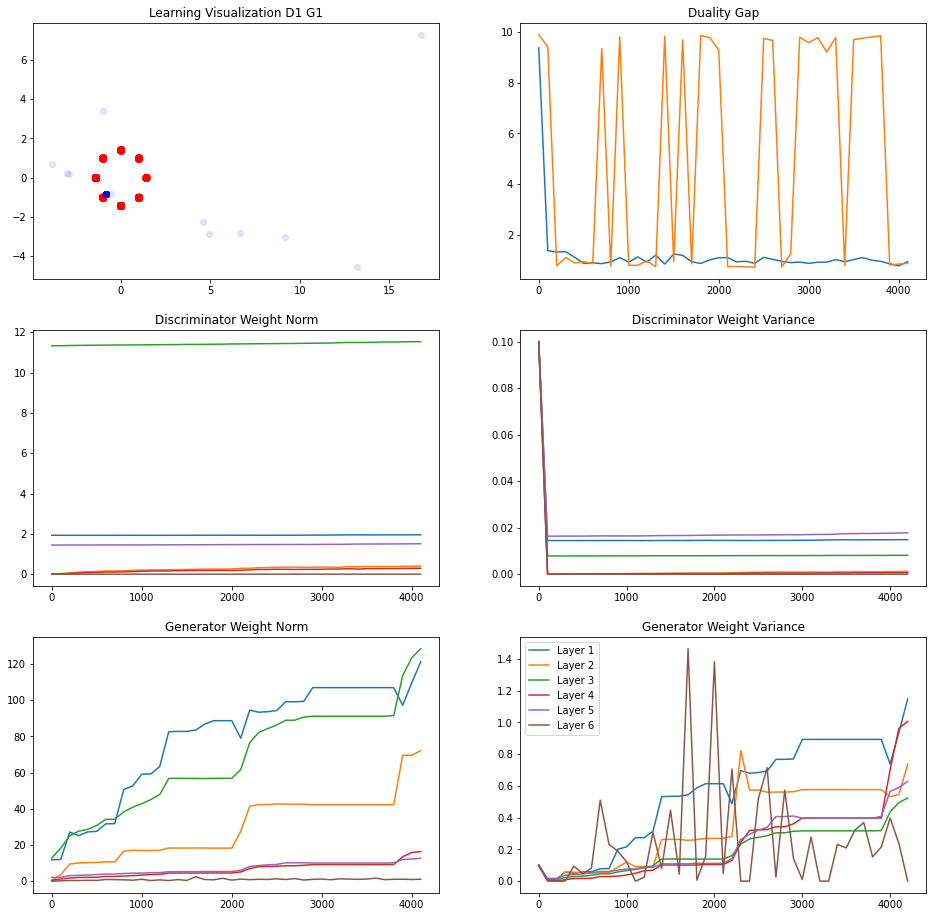

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.90025795
L Random  Duality Gap :  0.86264426


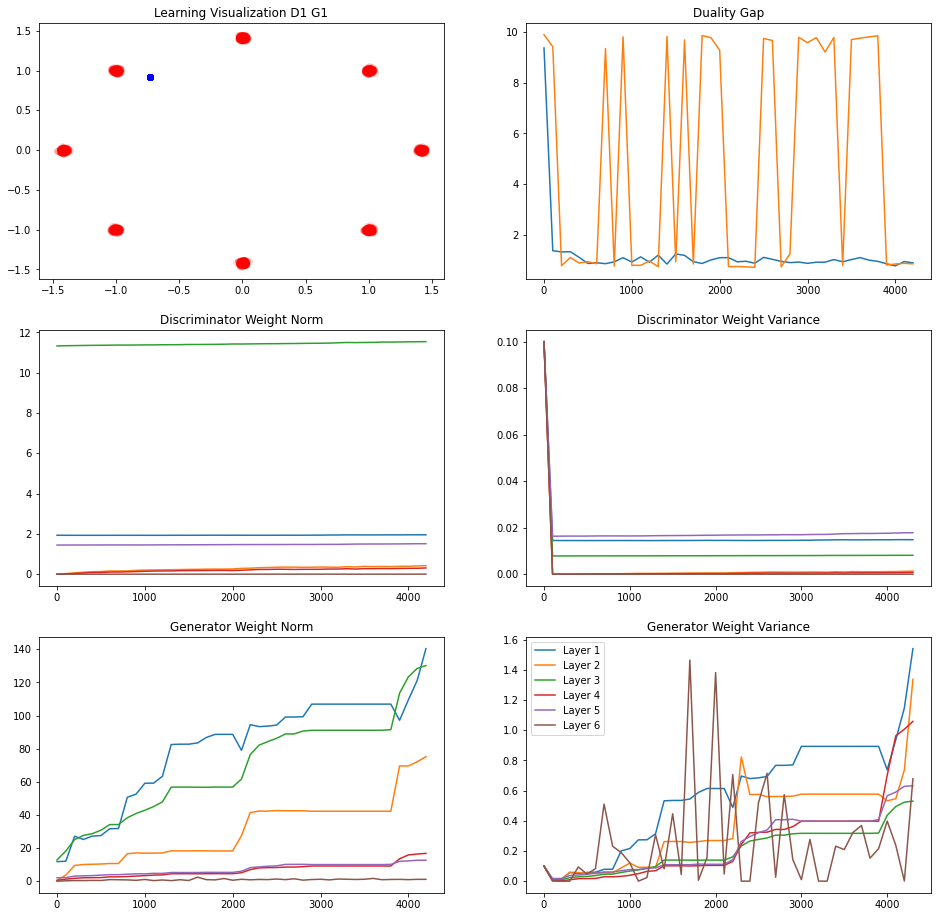

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.874614
L Random  Duality Gap :  0.7857189


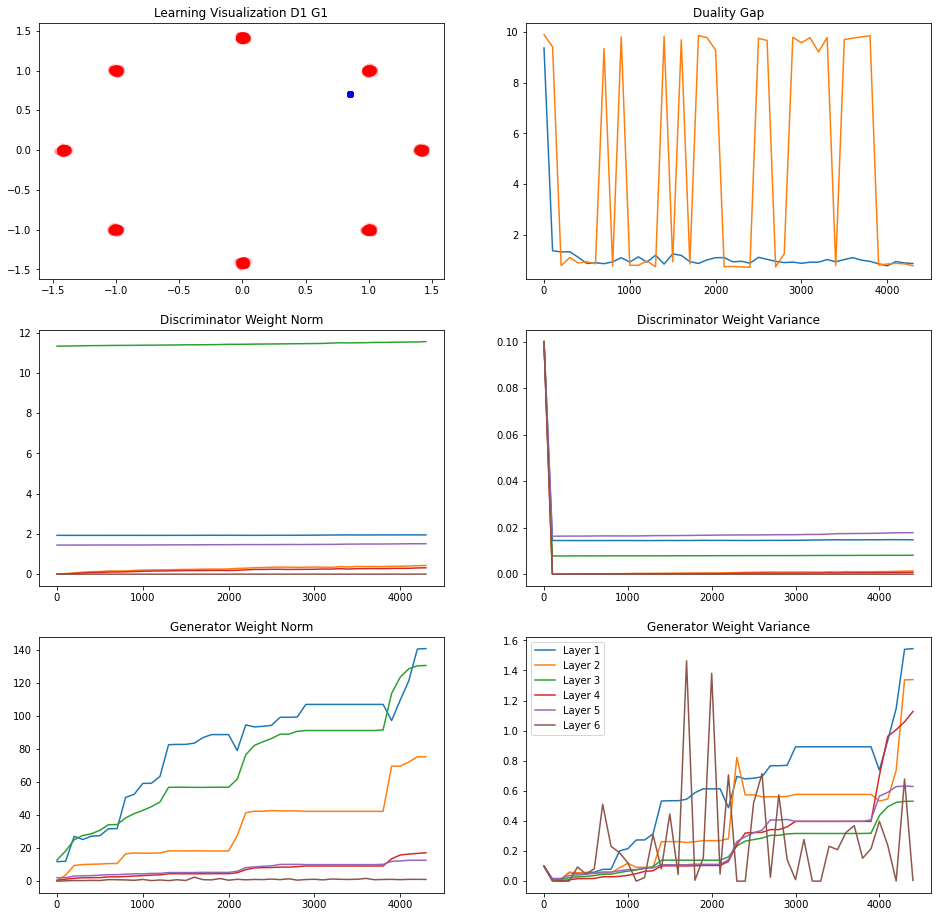

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8636888
L Random  Duality Gap :  5.2874136


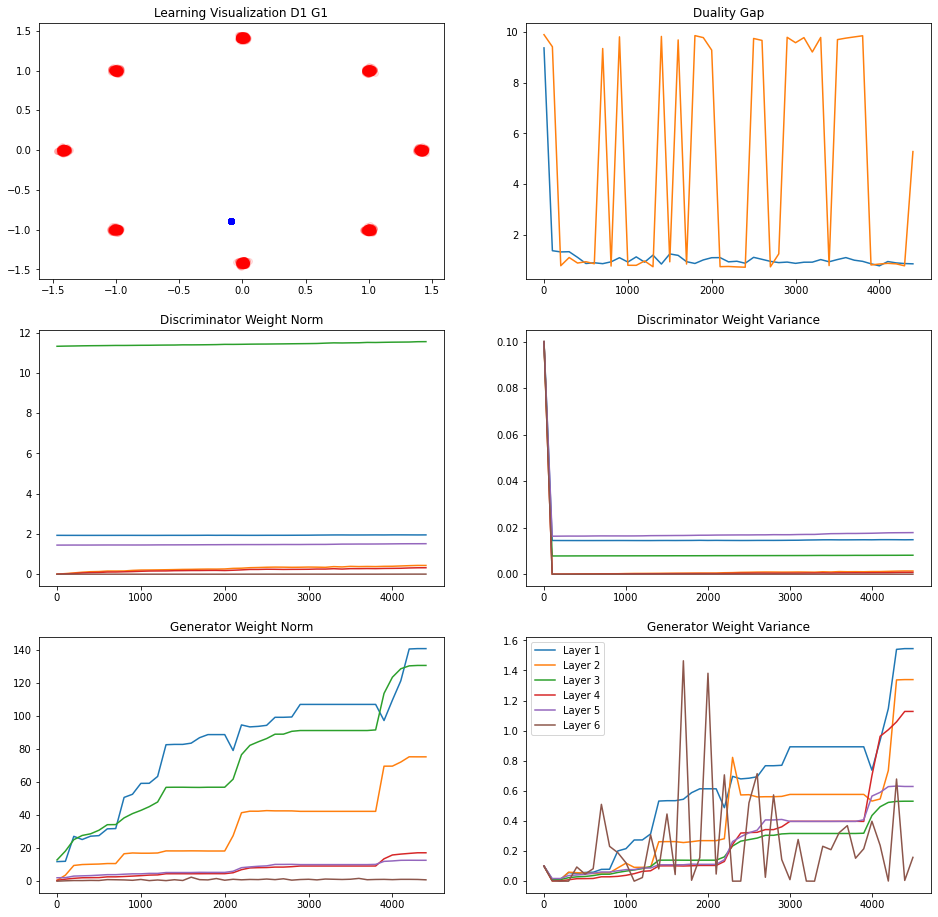

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8074063
L Random  Duality Gap :  0.78549594
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9146069
L Random  Duality Gap :  3.0803635


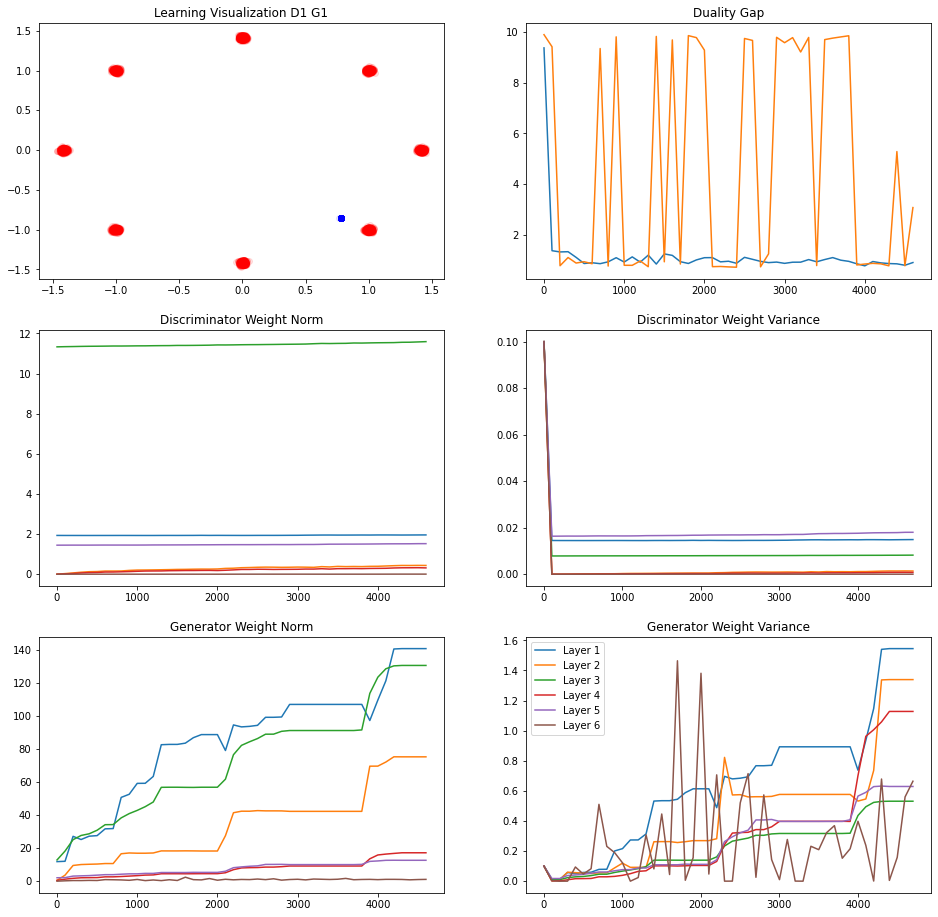

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8294518
L Random  Duality Gap :  7.8217363


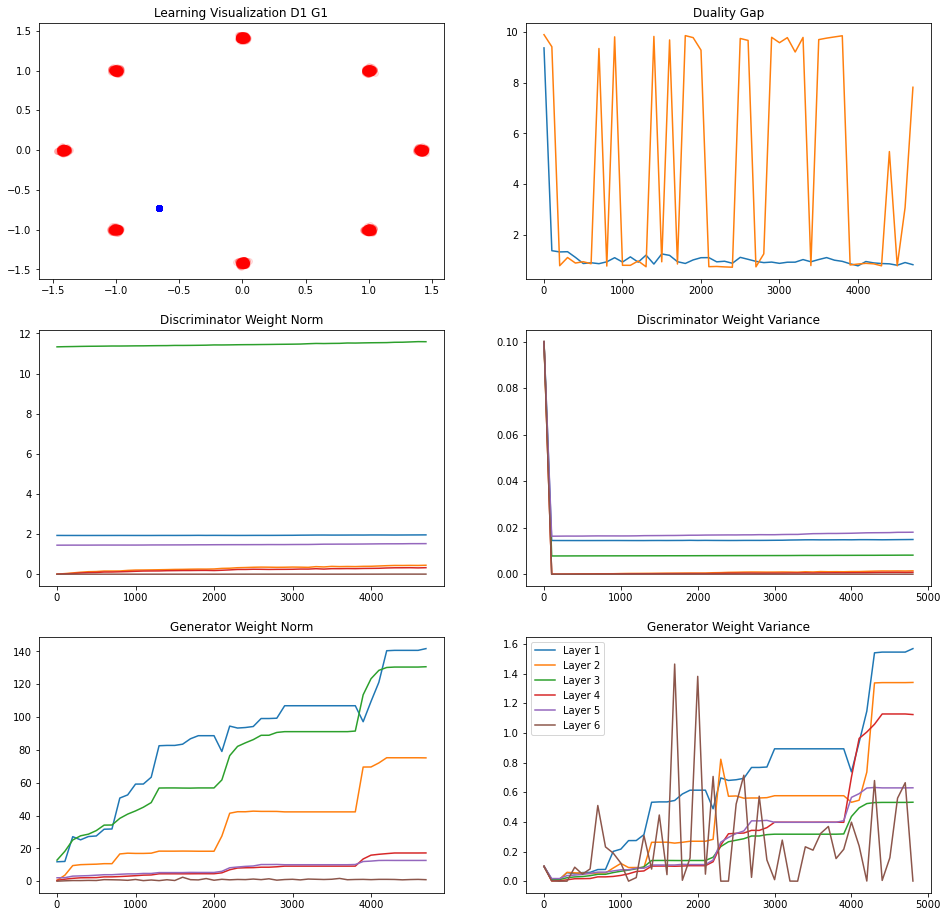

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.89187086
L Random  Duality Gap :  9.410196


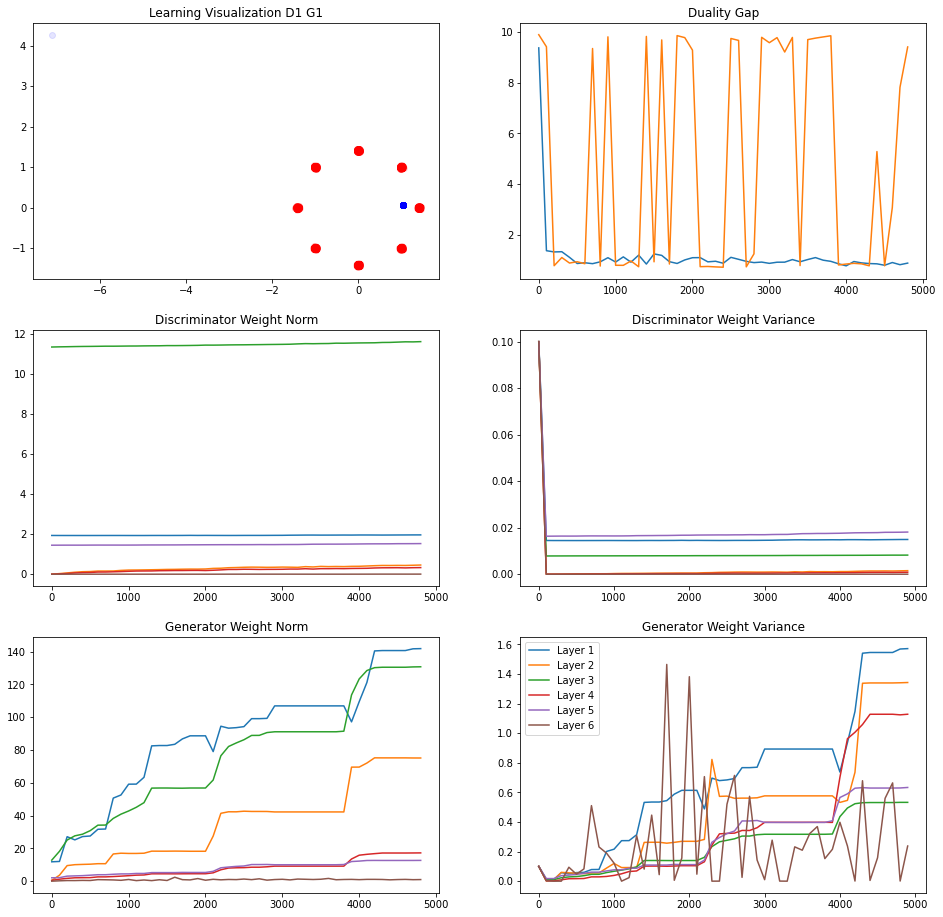

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2450492
L Random  Duality Gap :  9.654399


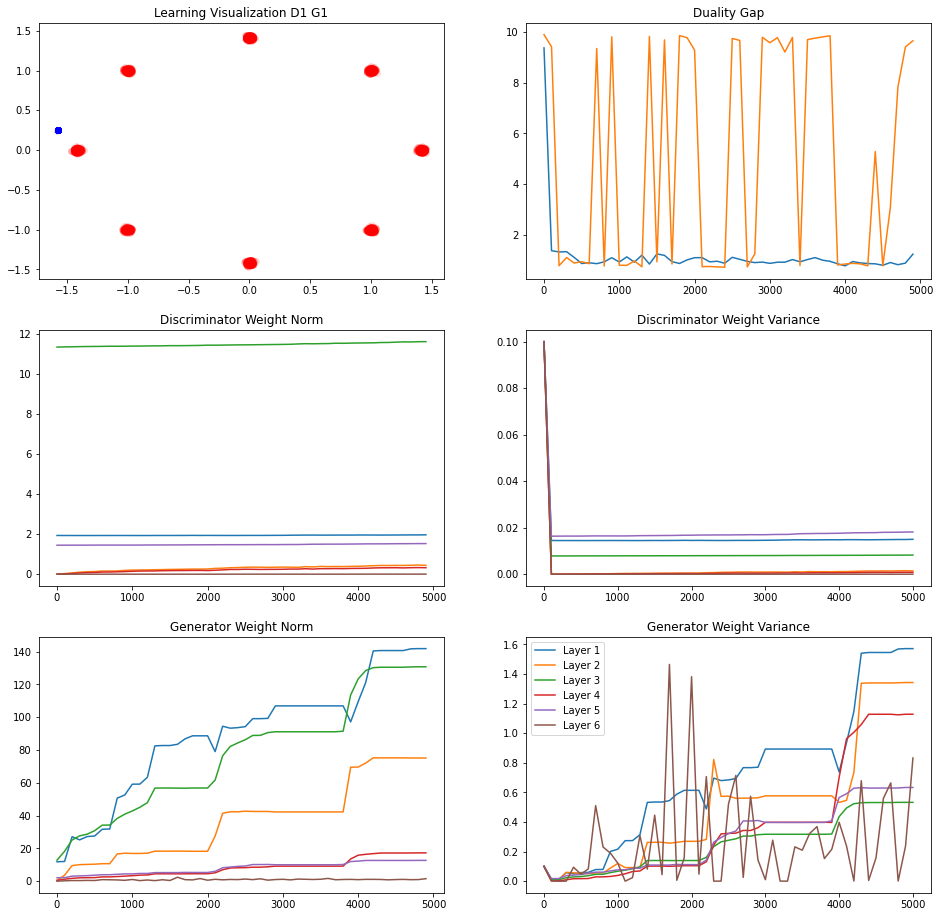

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.76762176
L Random  Duality Gap :  9.739939
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.99729776
L Random  Duality Gap :  0.8951579


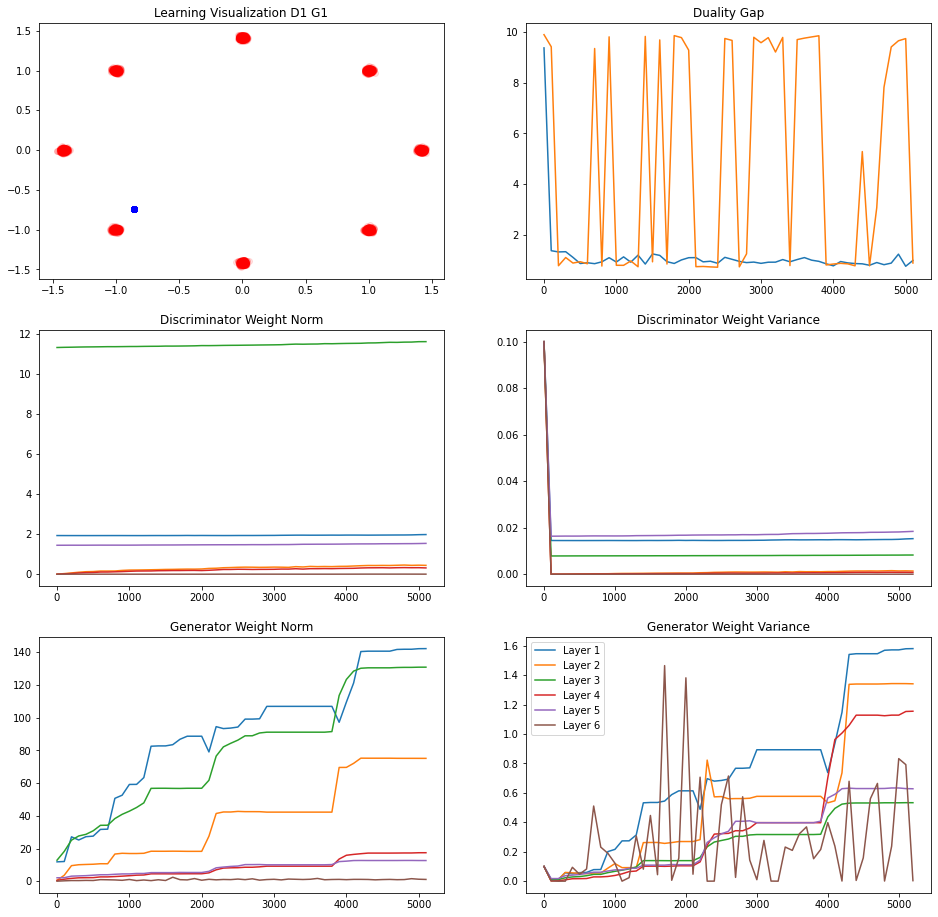

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0717583
L Random  Duality Gap :  8.924817


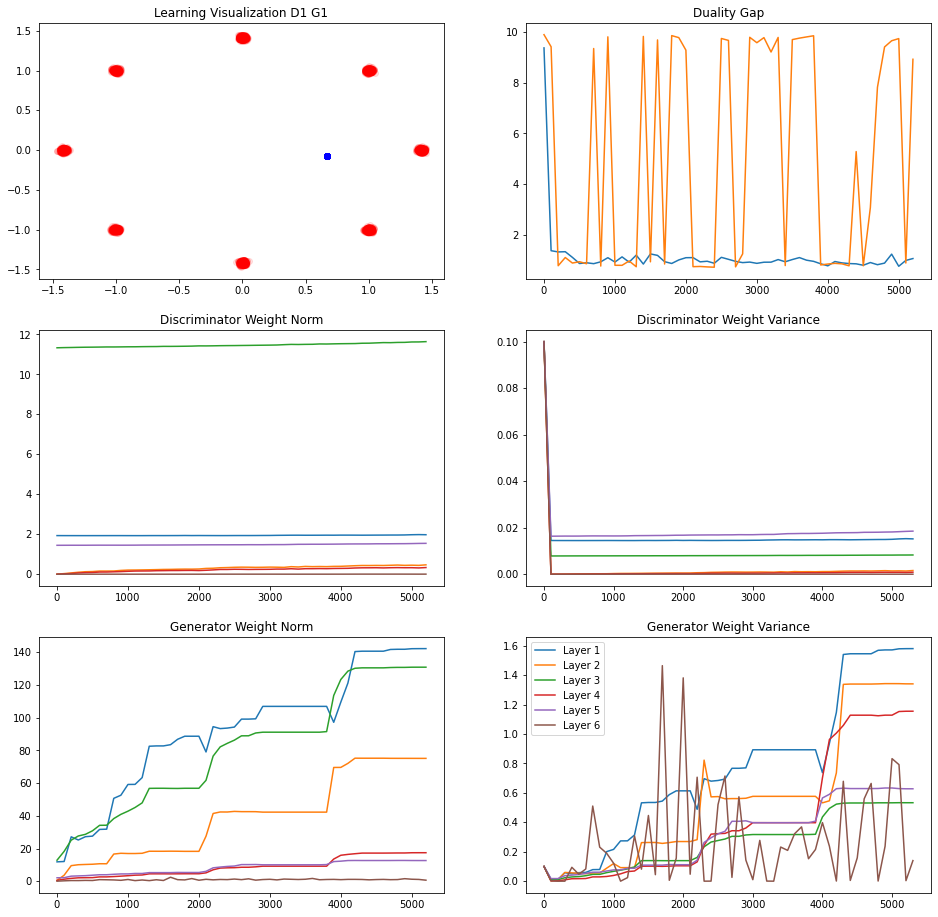

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.947062
L Random  Duality Gap :  -0.05428934


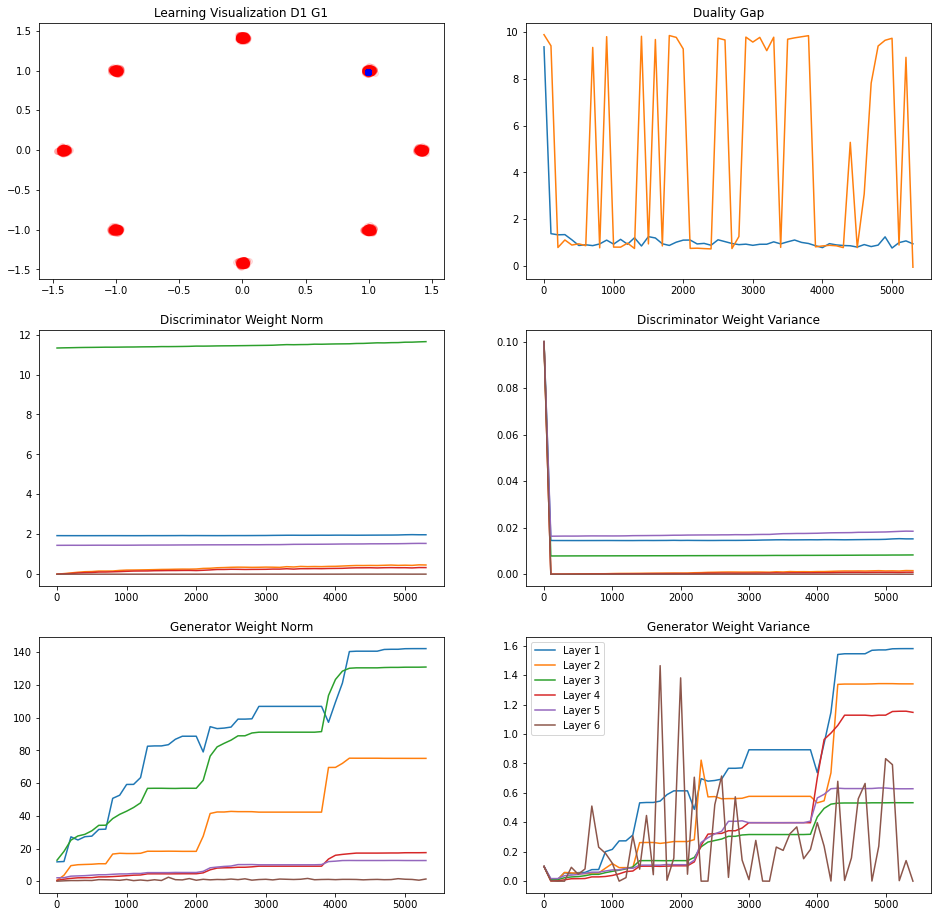

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1208259
L Random  Duality Gap :  9.538211


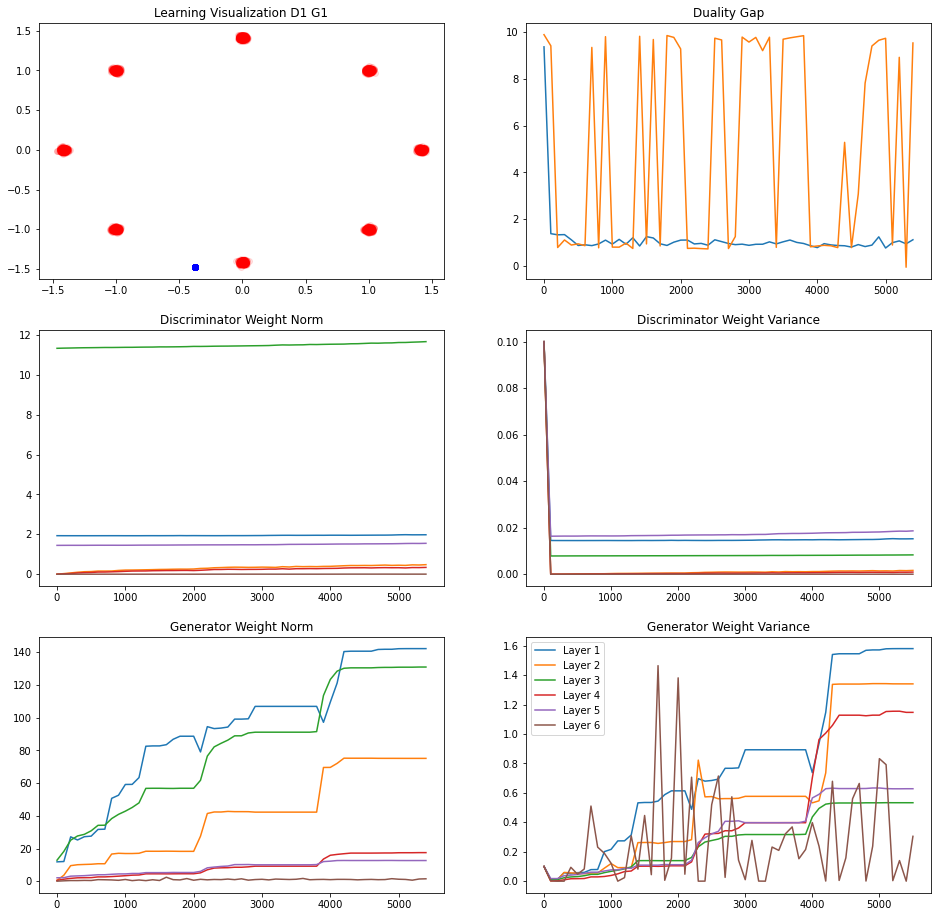

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.78618795
L Random  Duality Gap :  9.397135
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.82936007
L Random  Duality Gap :  0.89592826


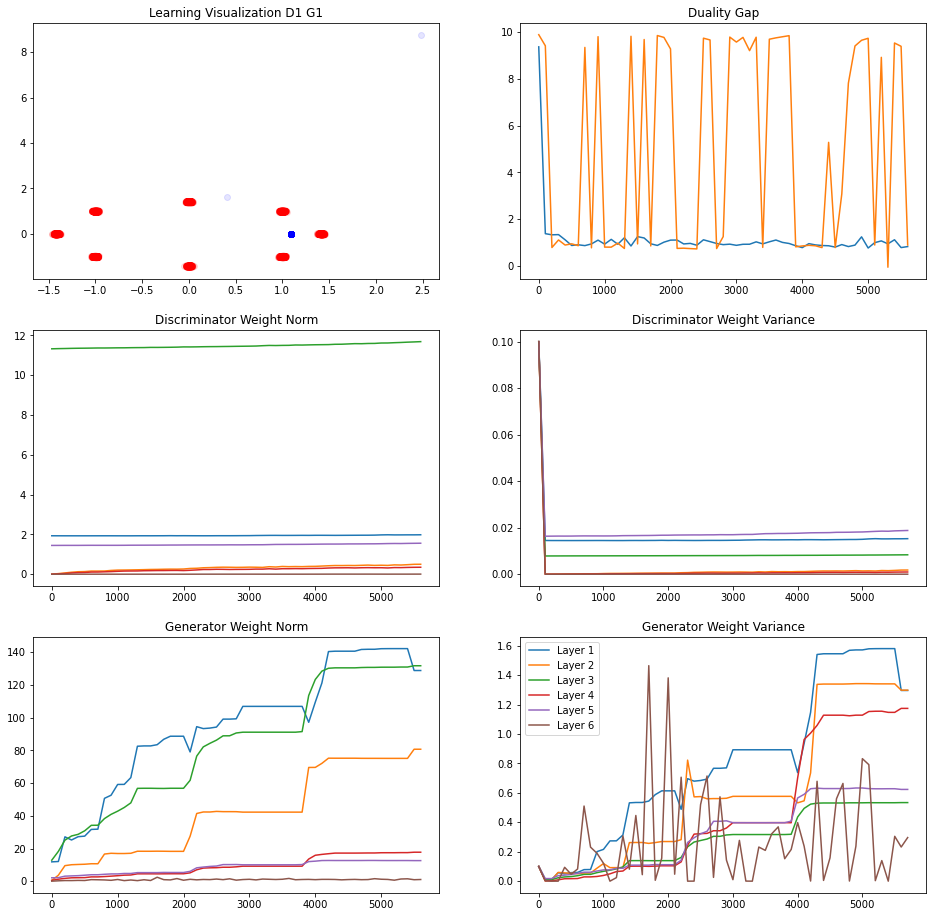

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8693818
L Random  Duality Gap :  7.9199305


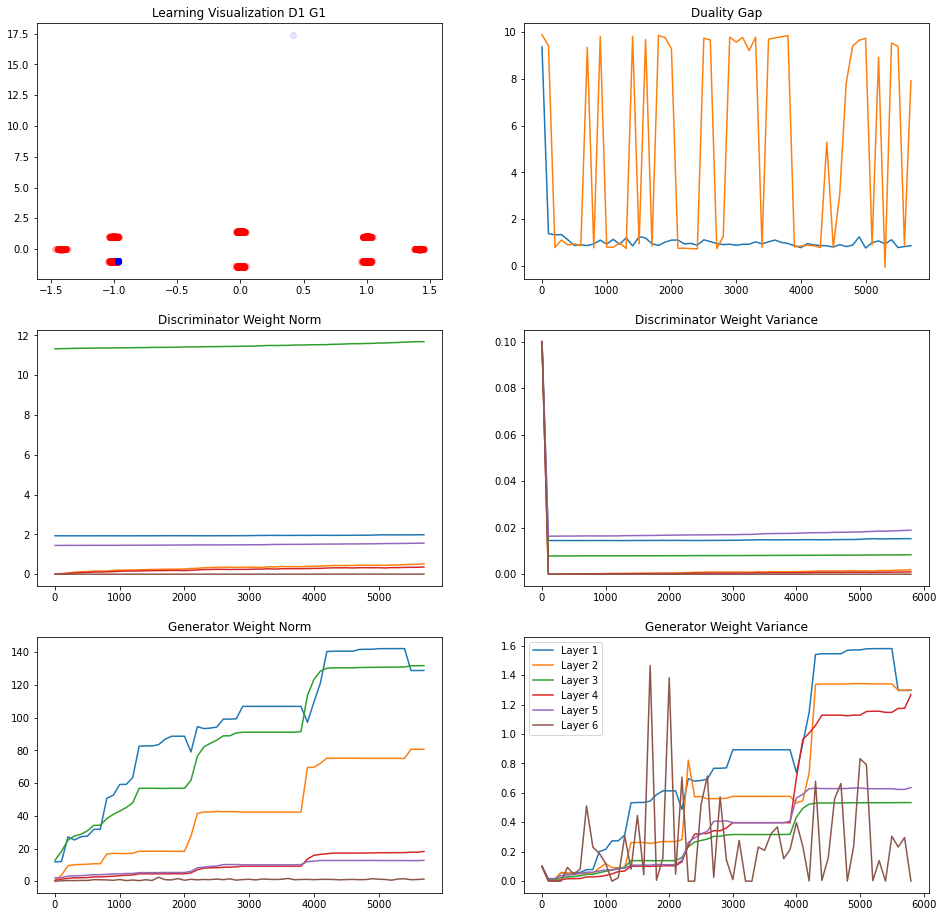

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1307898
L Random  Duality Gap :  0.865018


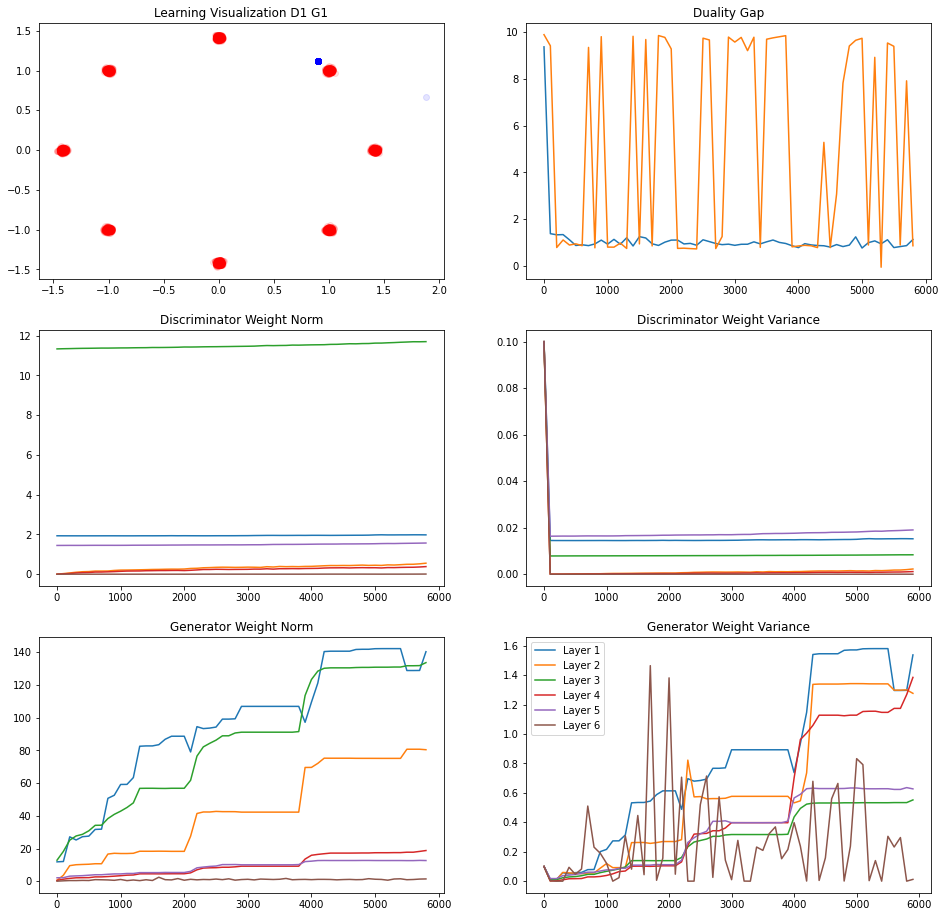

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.7869954
L Random  Duality Gap :  9.1229105


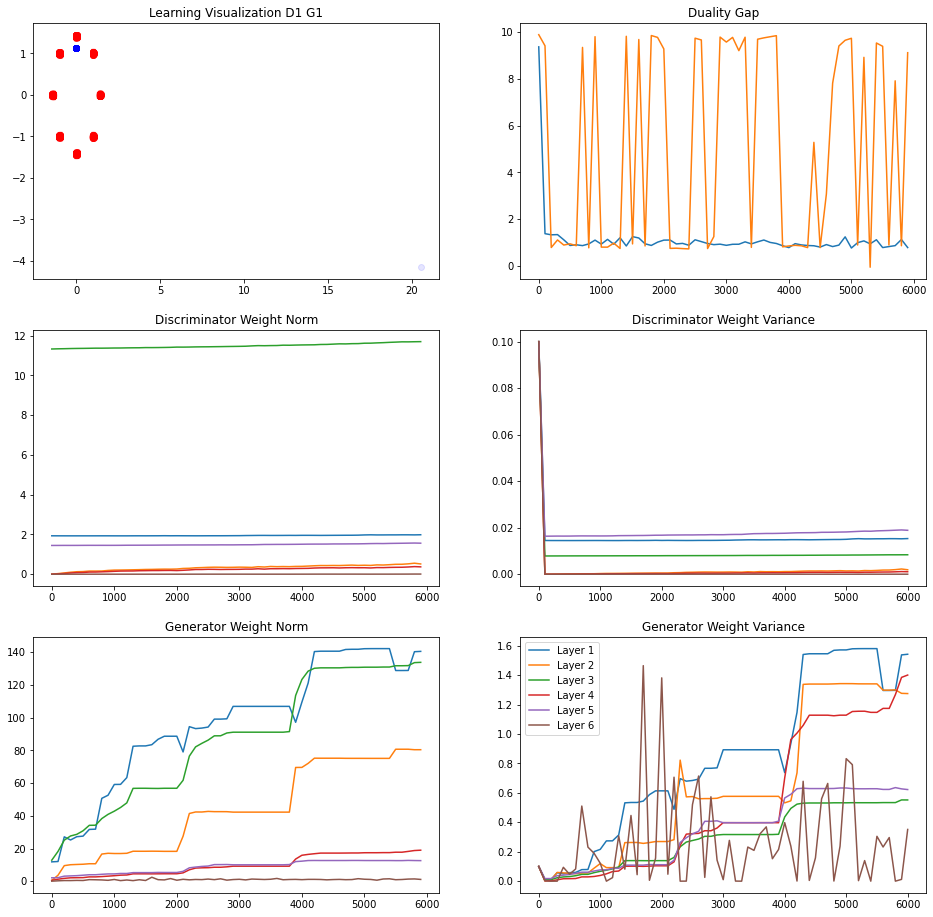

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.66752094
L Random  Duality Gap :  9.7112255
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.81910324
L Random  Duality Gap :  0.80611414


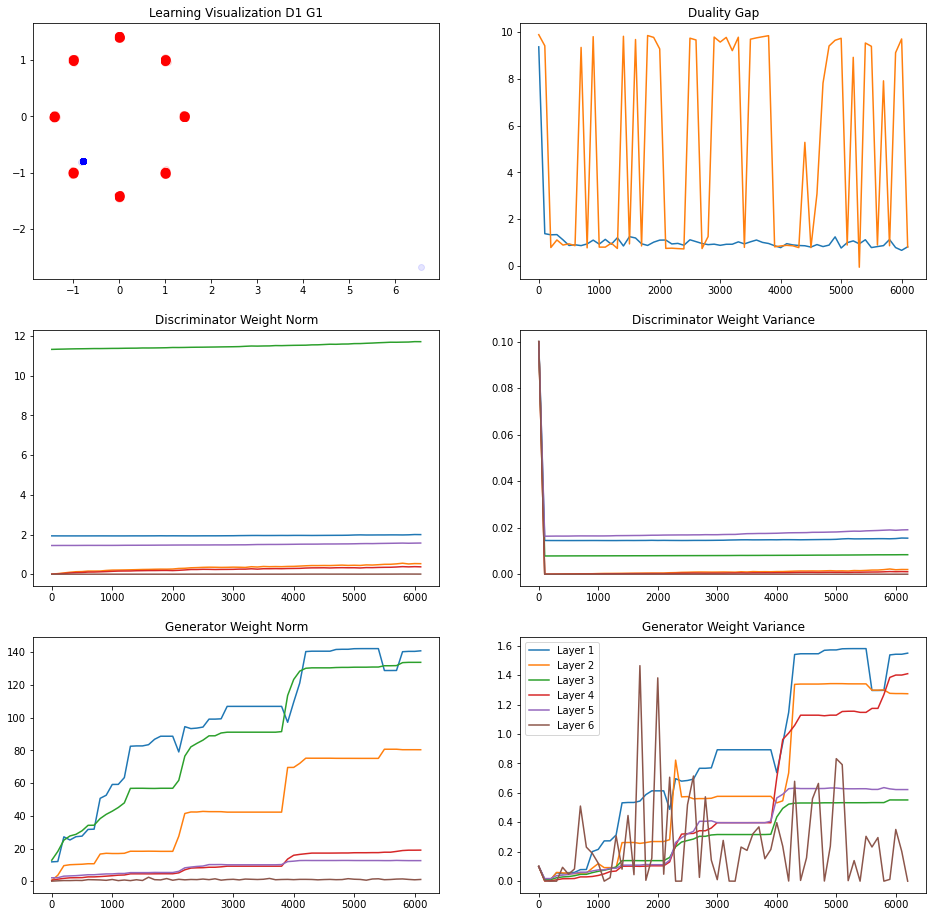

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.81382906
L Random  Duality Gap :  0.768805


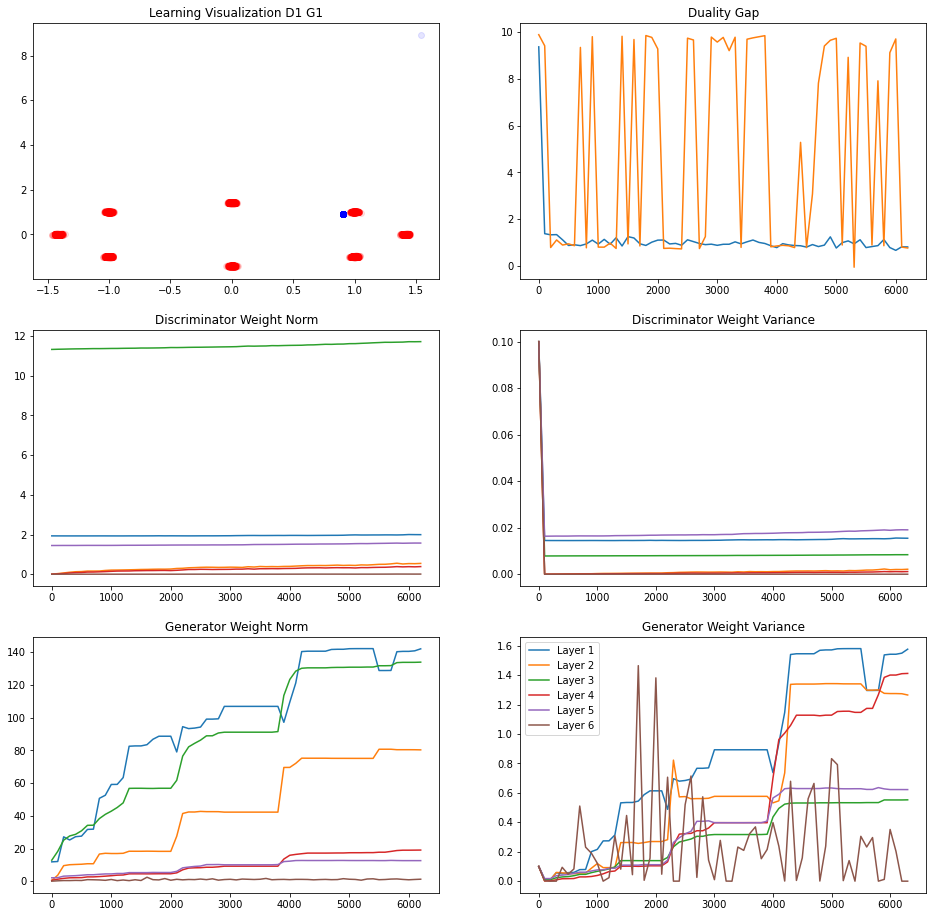

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.83312124
L Random  Duality Gap :  0.7770691


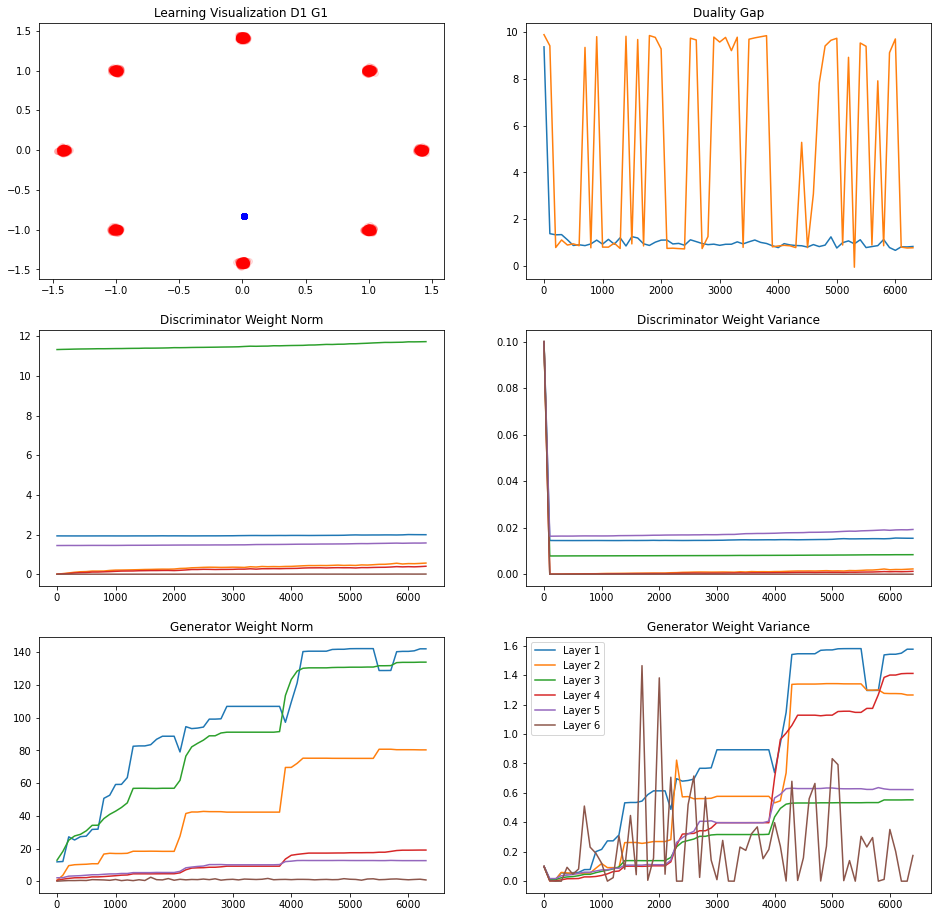

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8892088
L Random  Duality Gap :  9.595902


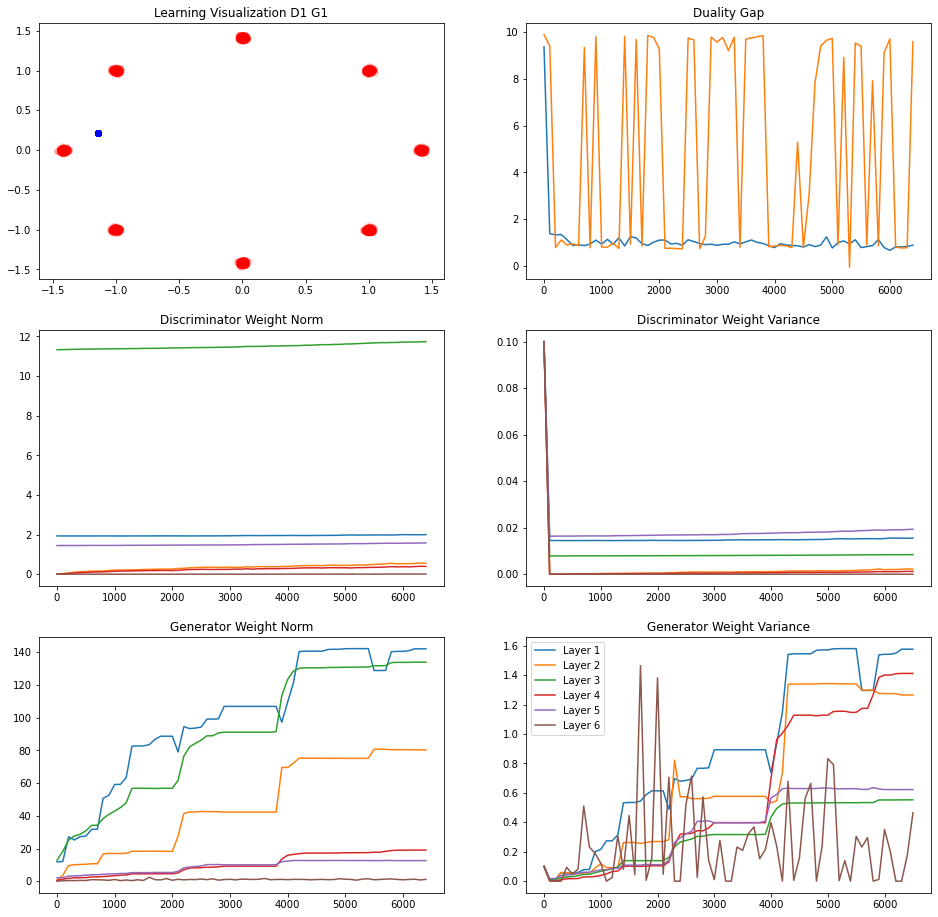

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.64753747
L Random  Duality Gap :  9.640924
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3489896
L Random  Duality Gap :  0.91528594


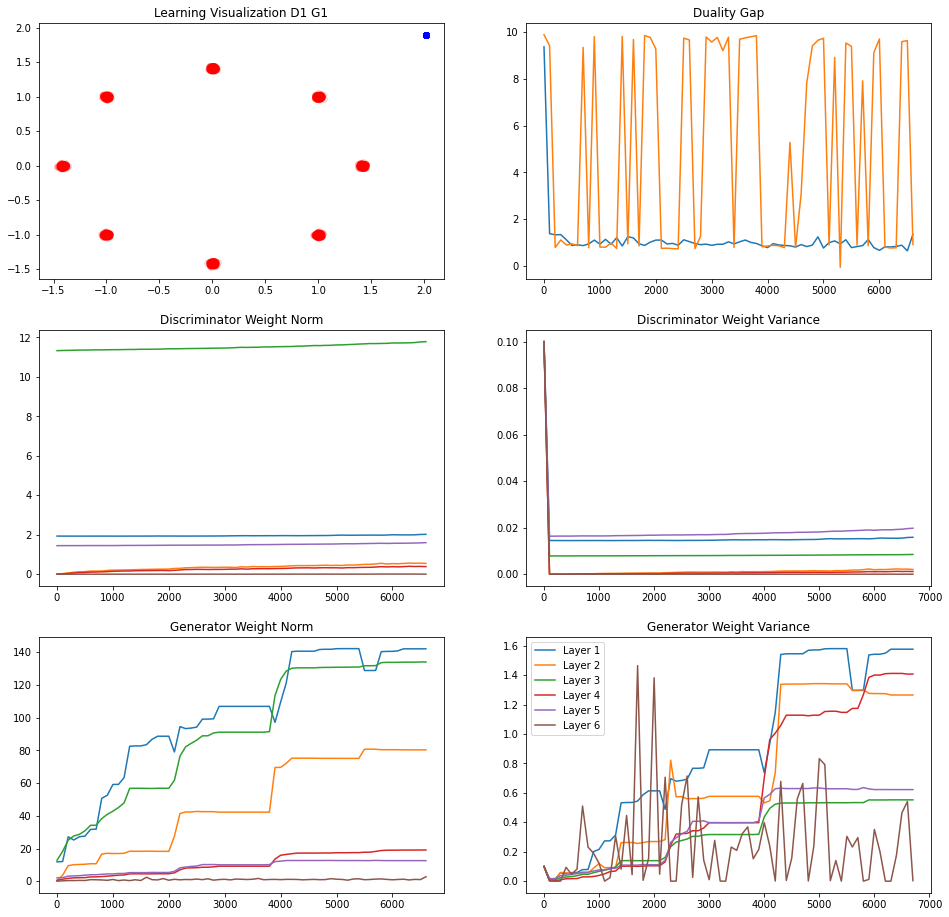

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1782141
L Random  Duality Gap :  0.911749


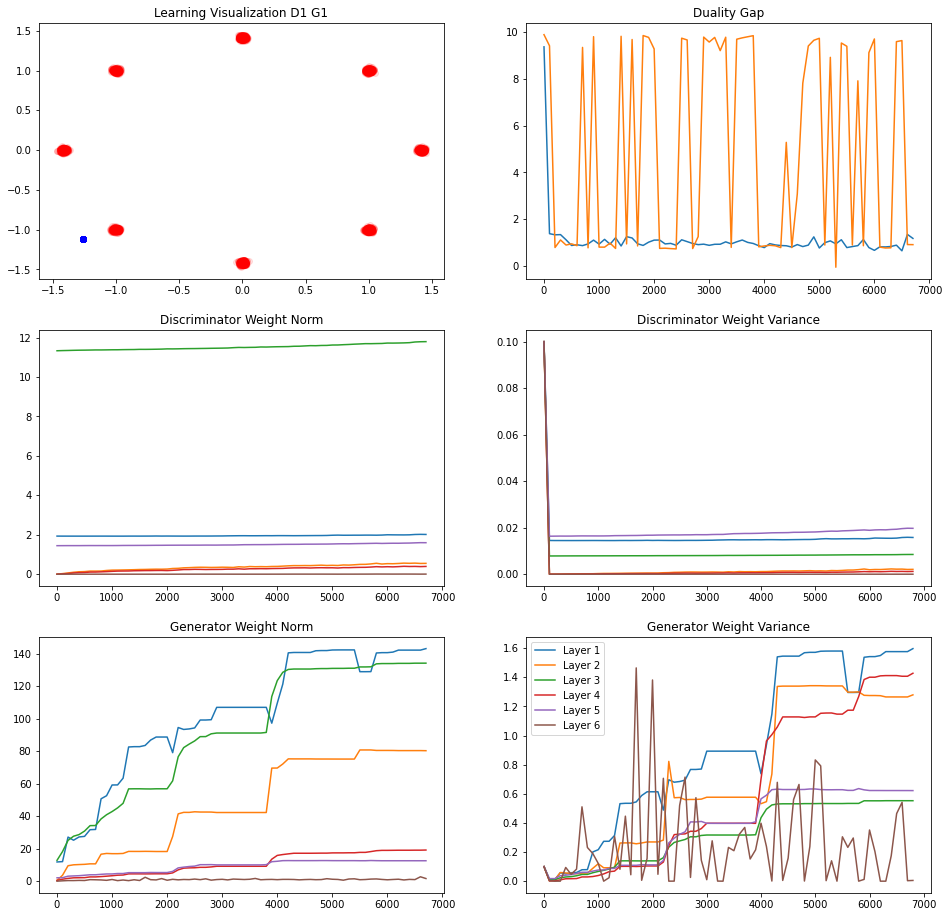

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9915459
L Random  Duality Gap :  0.8257897


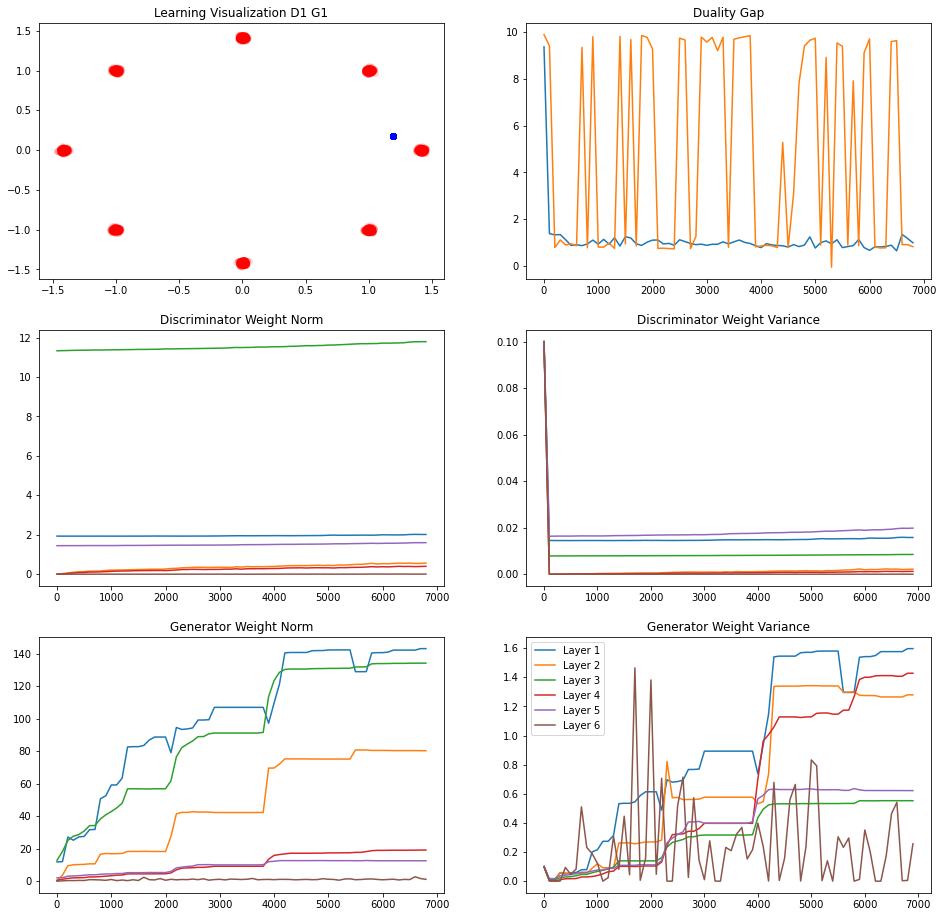

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9117675
L Random  Duality Gap :  6.499097


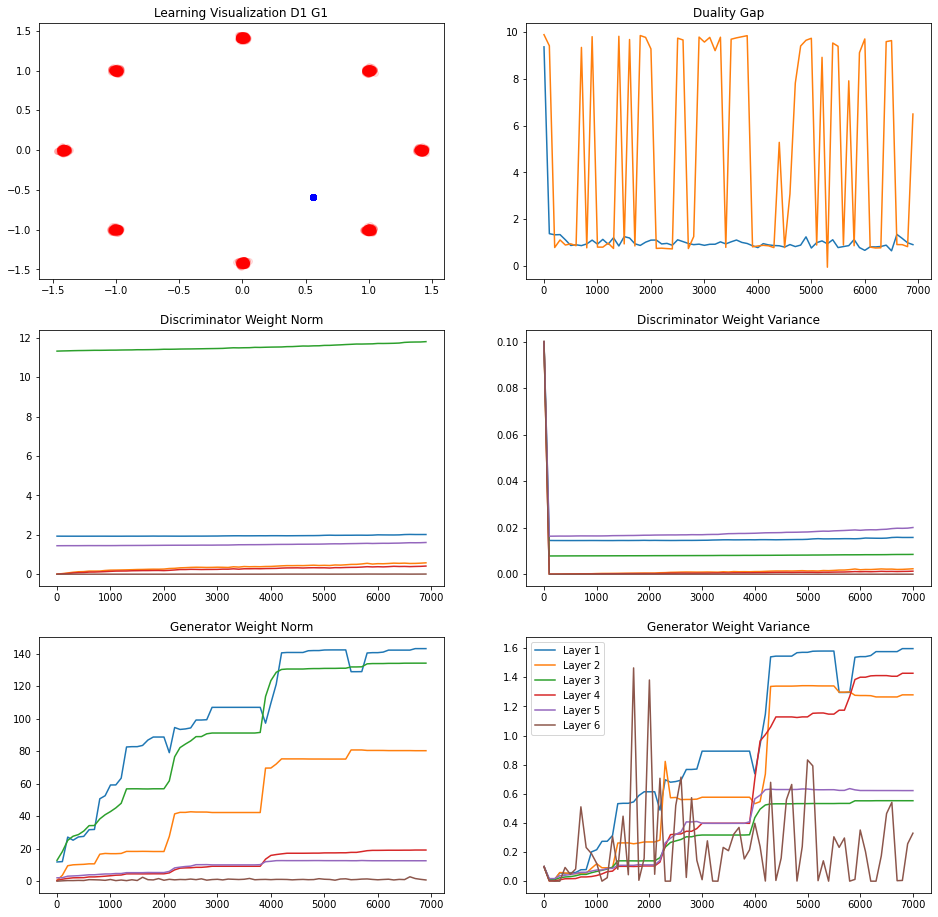

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8590767
L Random  Duality Gap :  9.616194
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.6226071
L Random  Duality Gap :  9.736795


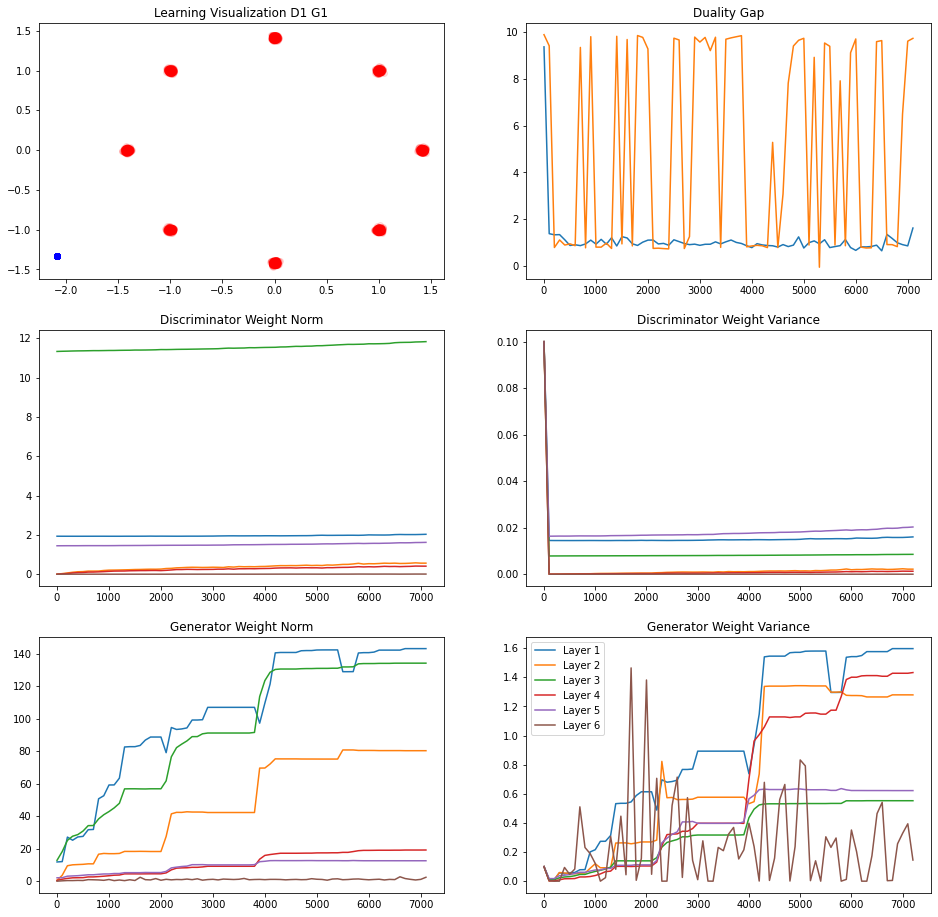

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.81654245
L Random  Duality Gap :  9.776705


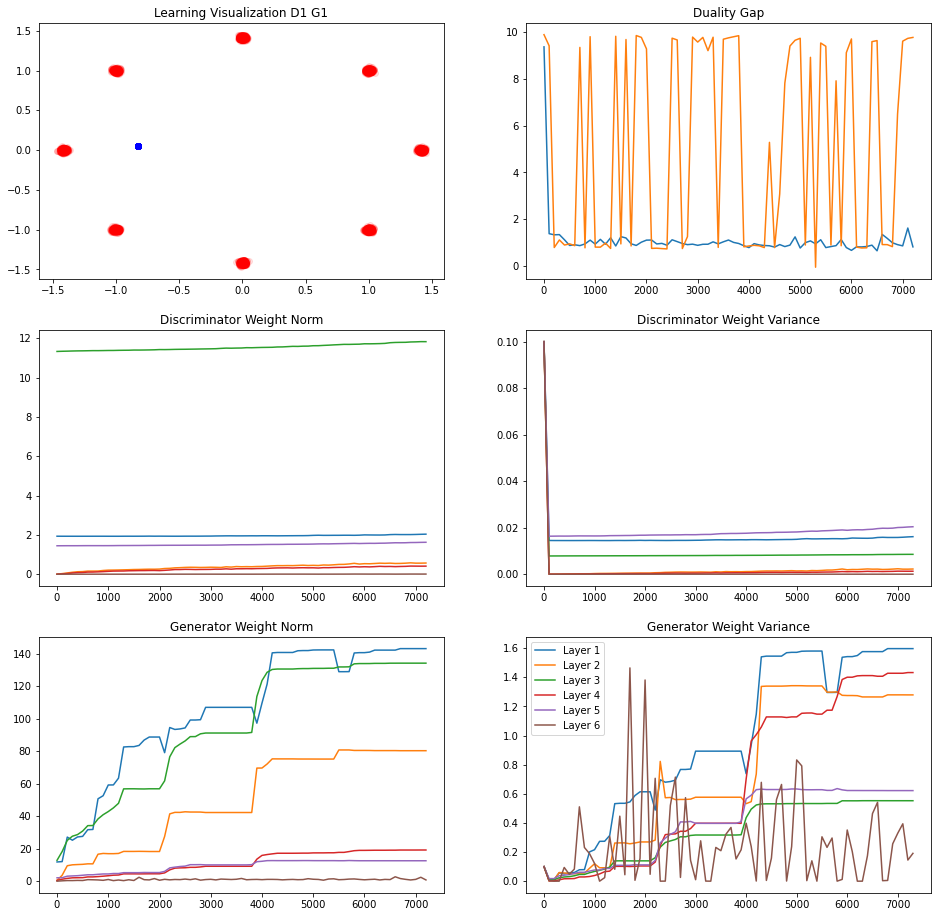

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.84353817
L Random  Duality Gap :  0.78210014


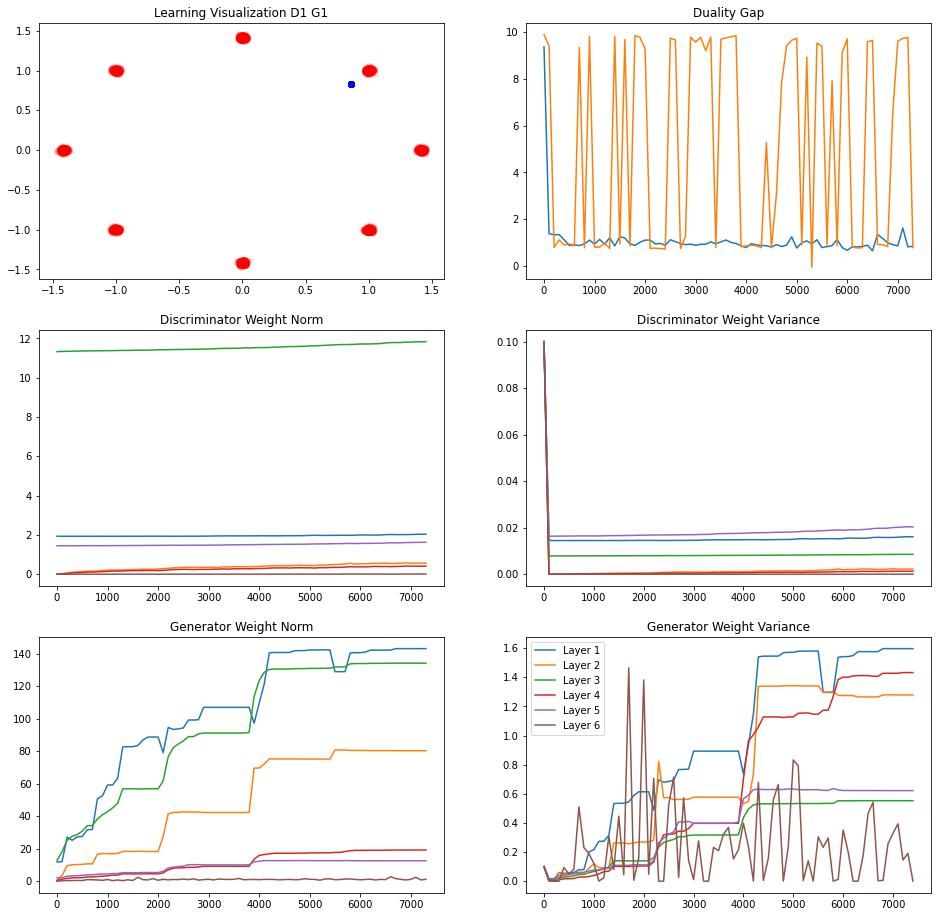

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.7527865
L Random  Duality Gap :  9.696382


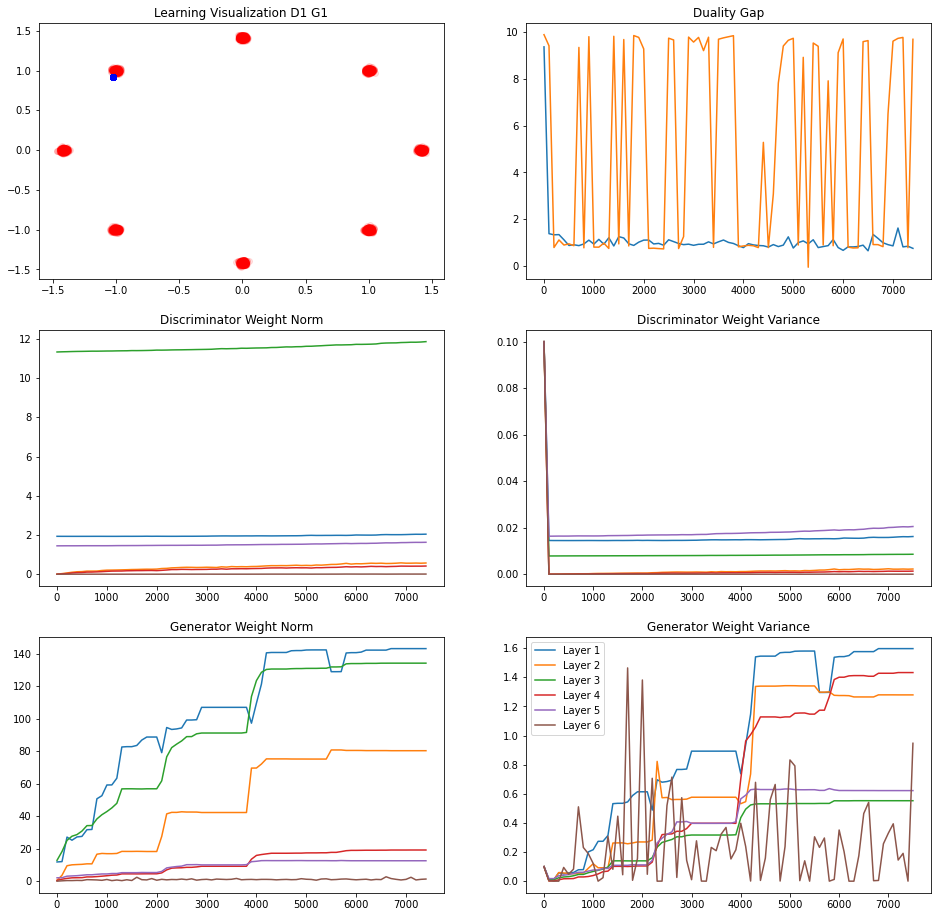

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.96272516
L Random  Duality Gap :  0.83549815
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1791081
L Random  Duality Gap :  9.5177765


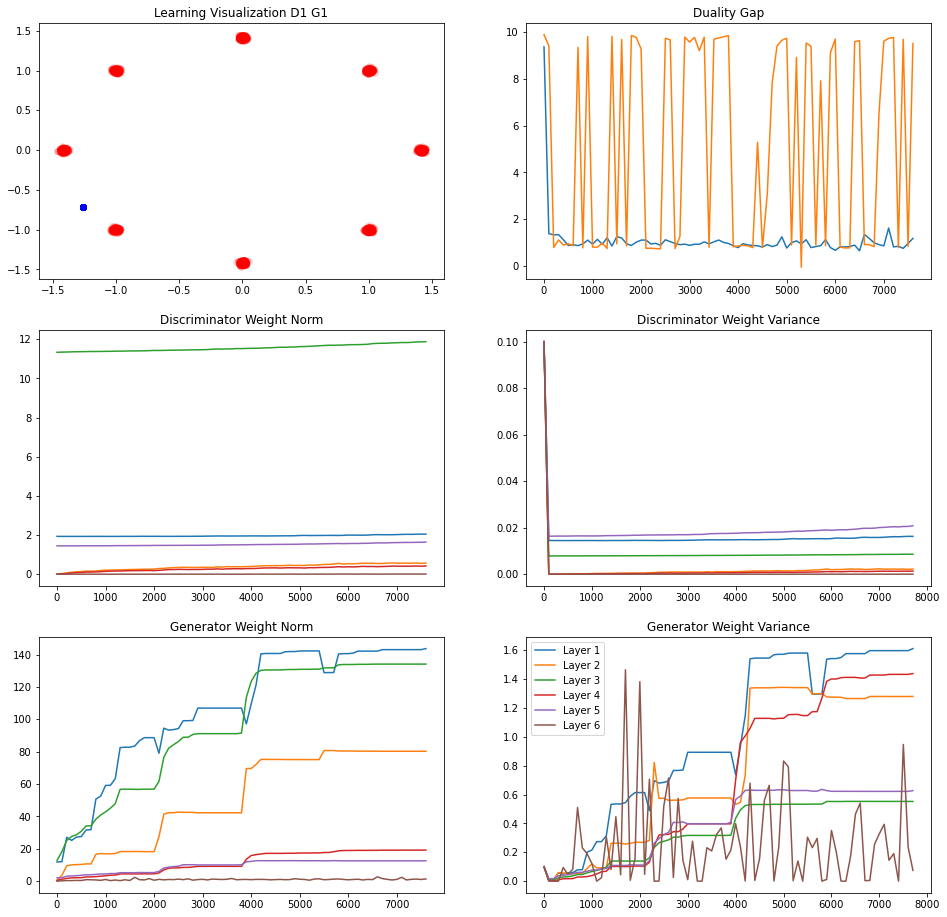

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.75135
L Random  Duality Gap :  9.489627


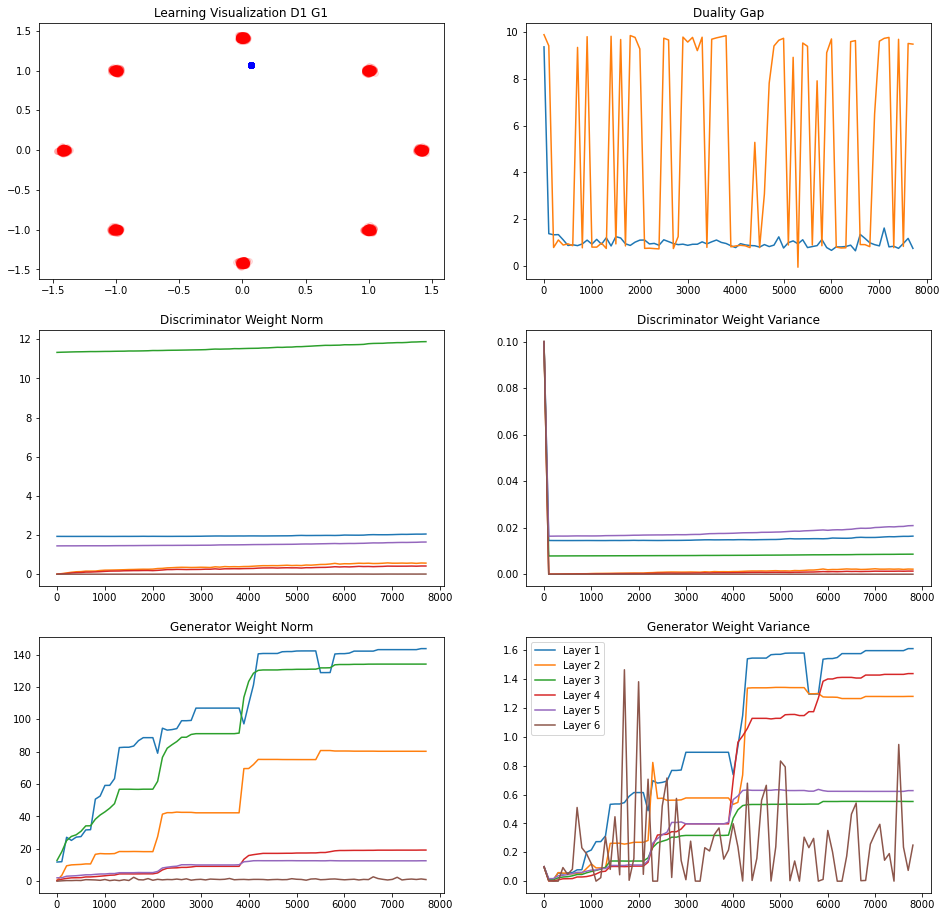

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0316436
L Random  Duality Gap :  0.8120203


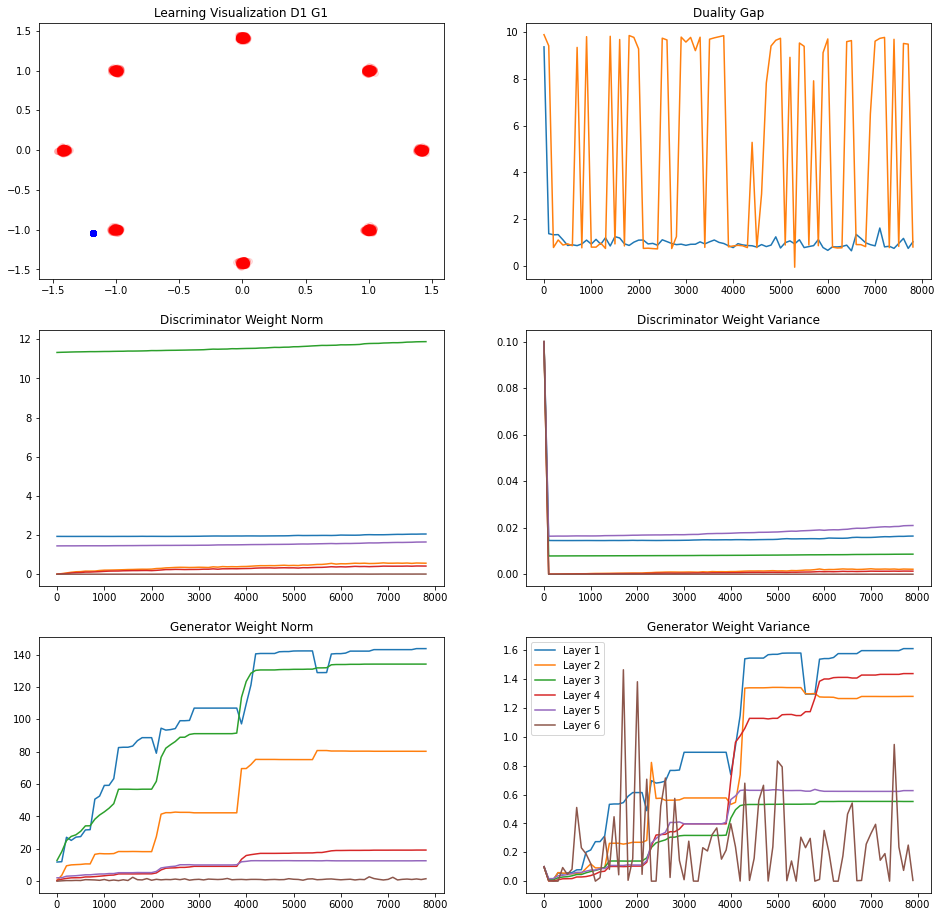

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8048196
L Random  Duality Gap :  9.691386


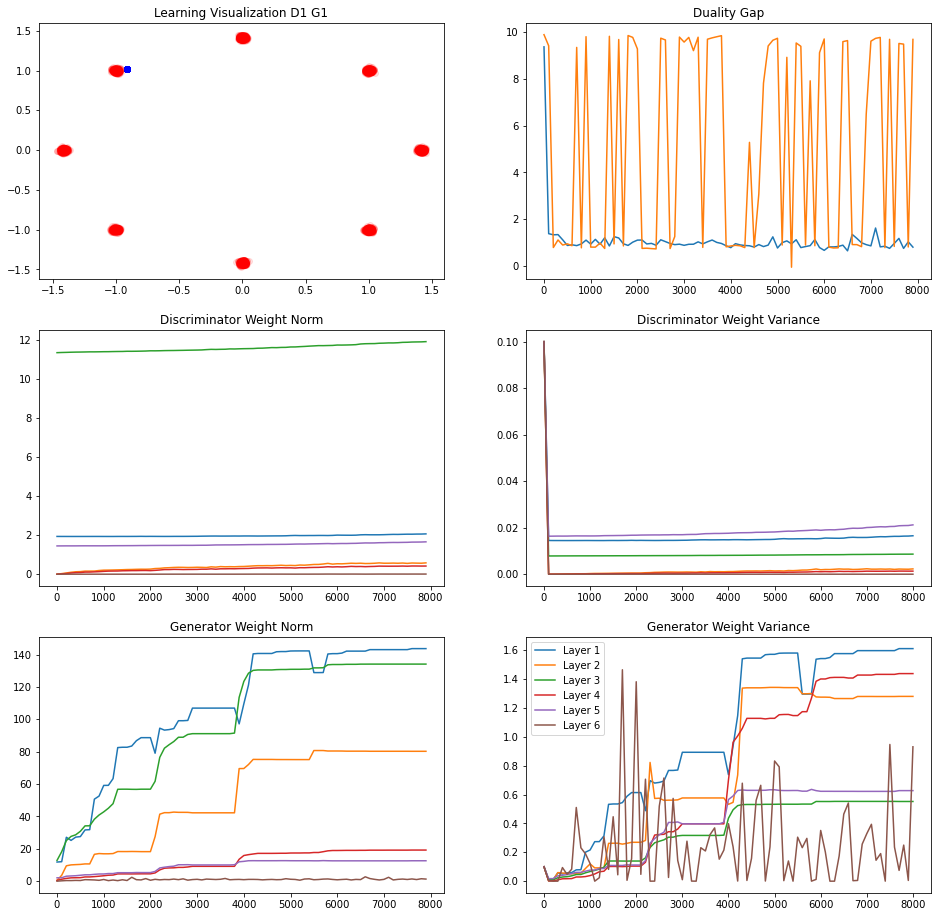

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.6462392
L Random  Duality Gap :  9.612706
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.93781745
L Random  Duality Gap :  9.791998


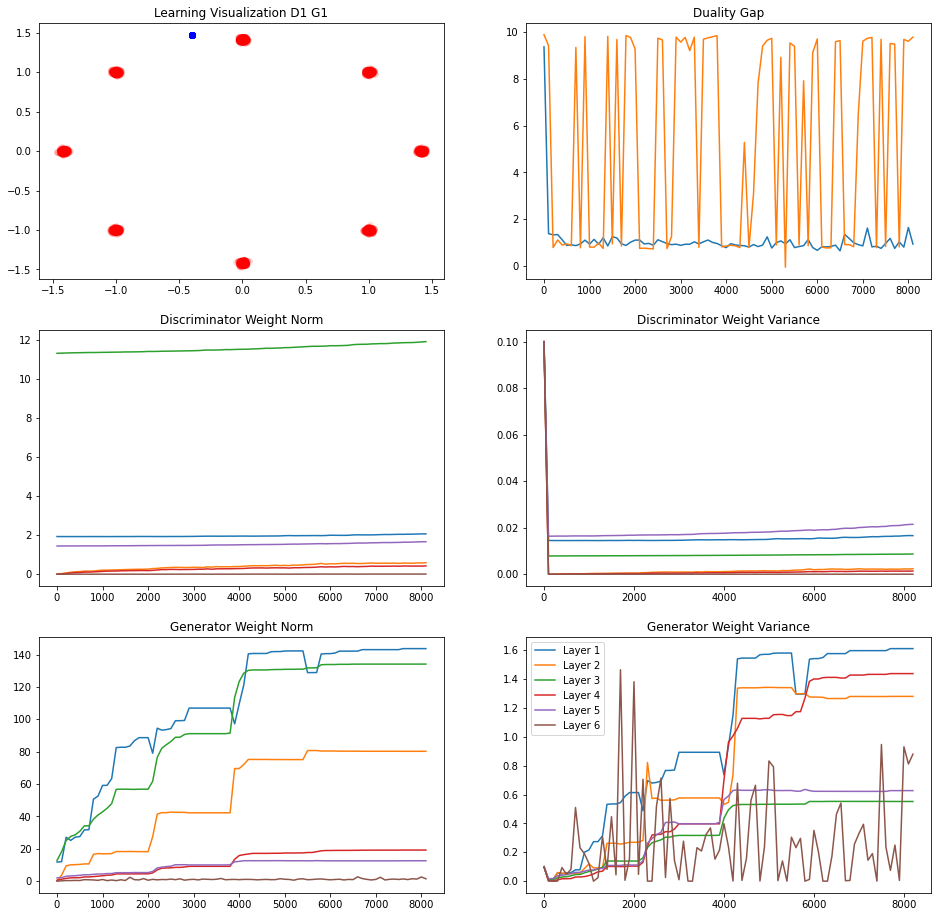

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4597387
L Random  Duality Gap :  9.733823


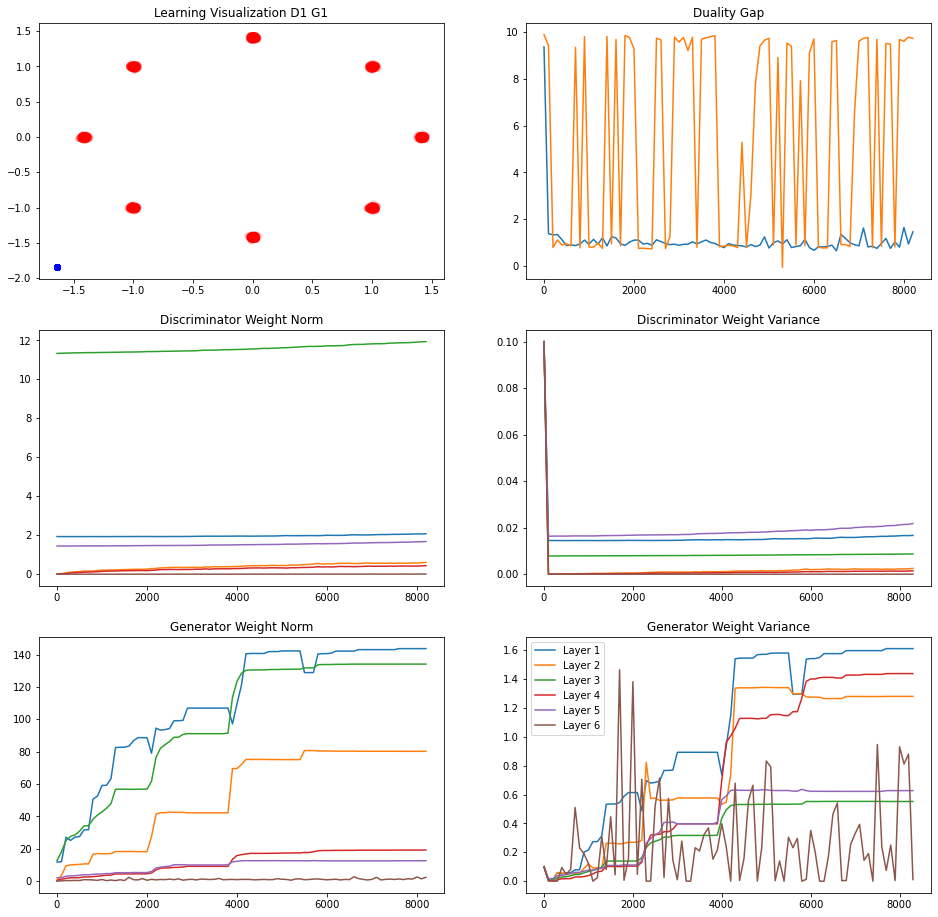

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.85476893
L Random  Duality Gap :  9.573793


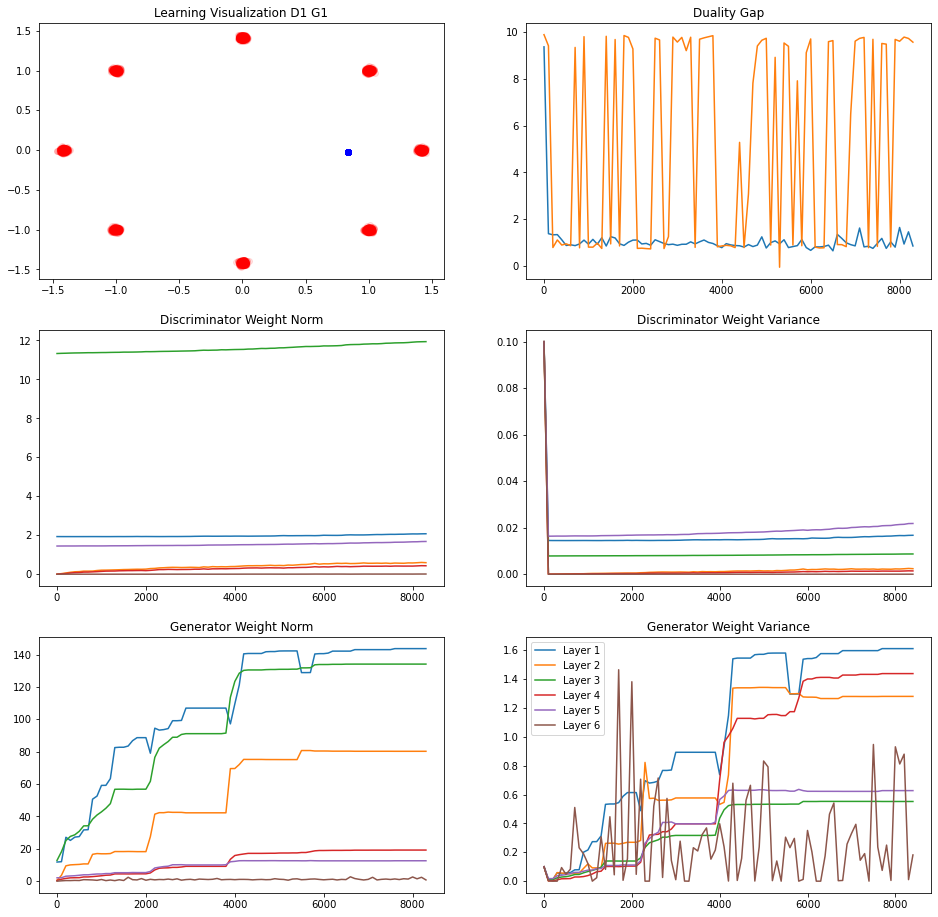

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.84176326
L Random  Duality Gap :  9.295469


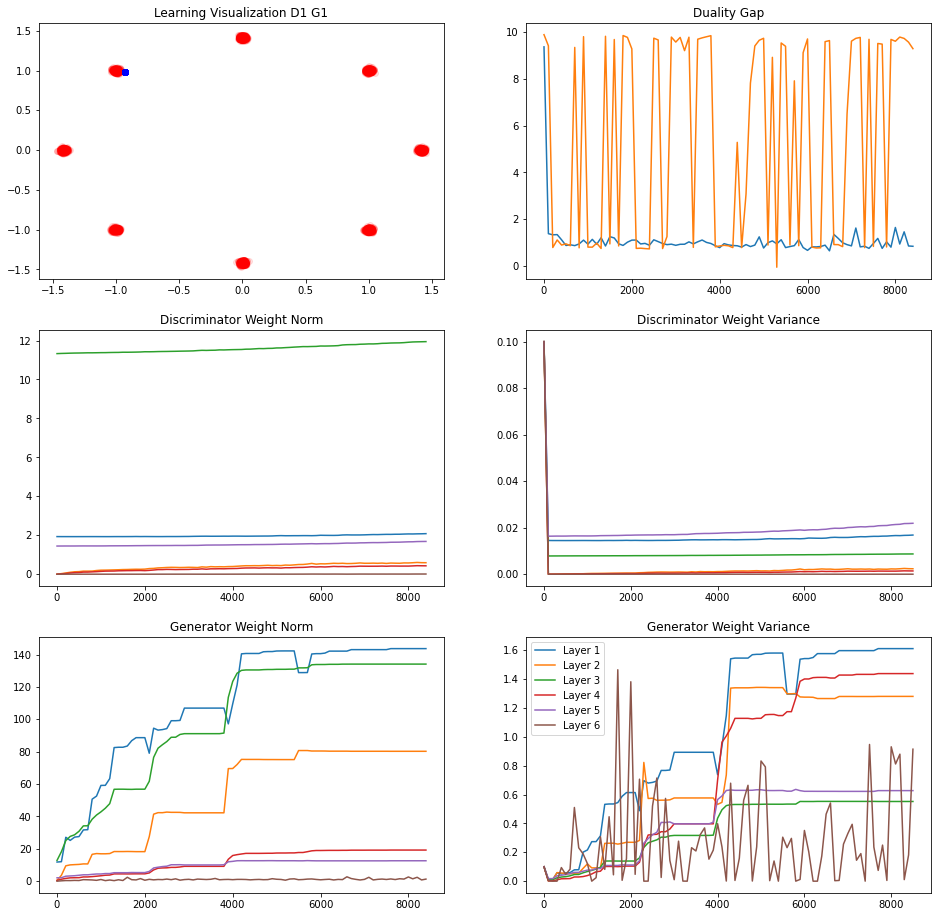

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0855548
L Random  Duality Gap :  9.7246275
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1028521
L Random  Duality Gap :  0.8232367


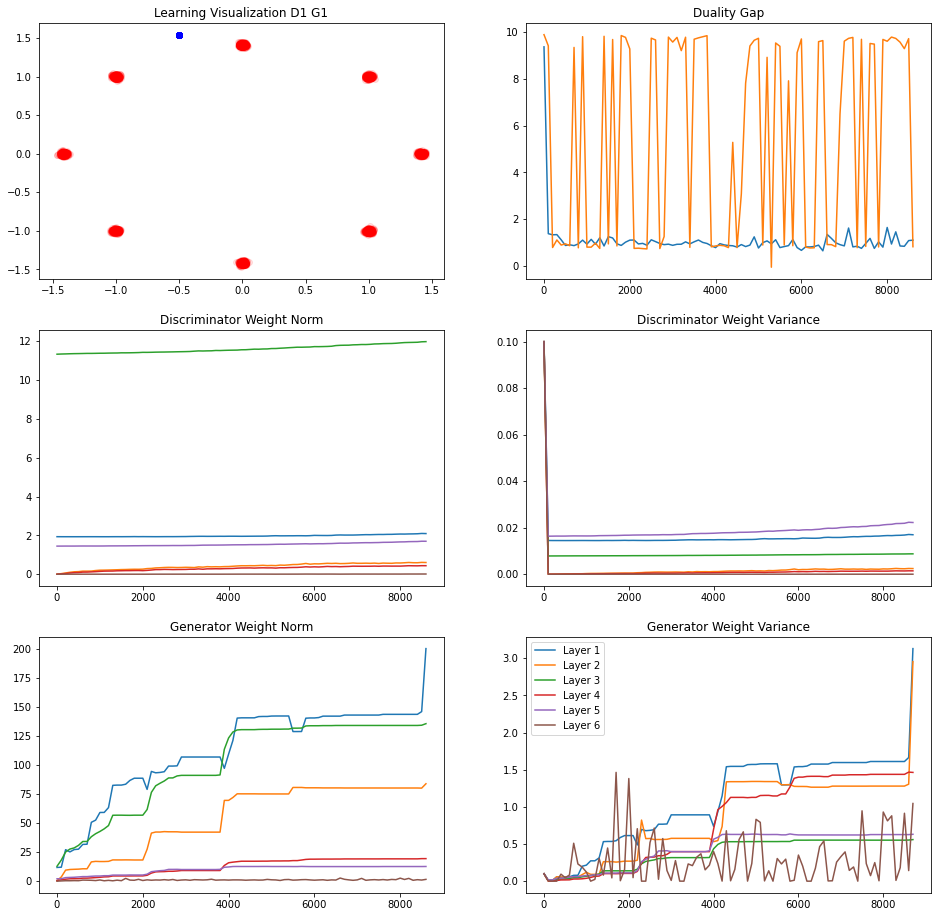

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.5397774
L Random  Duality Gap :  8.788269


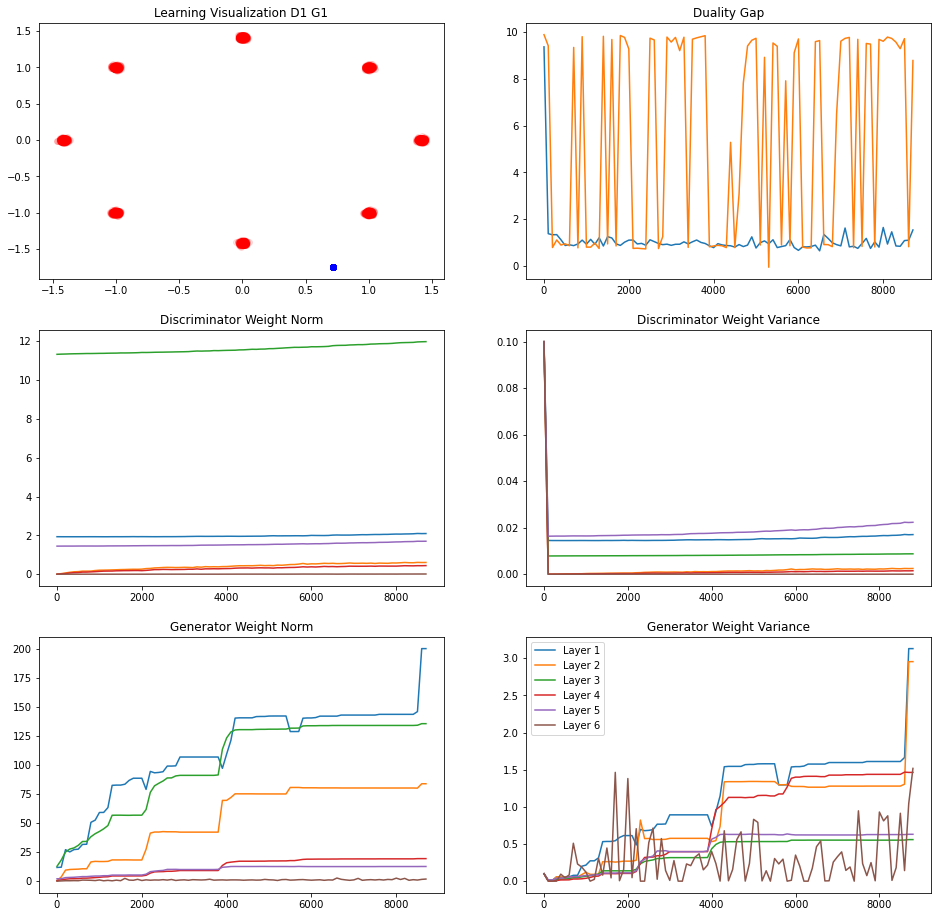

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9139577
L Random  Duality Gap :  0.7817722


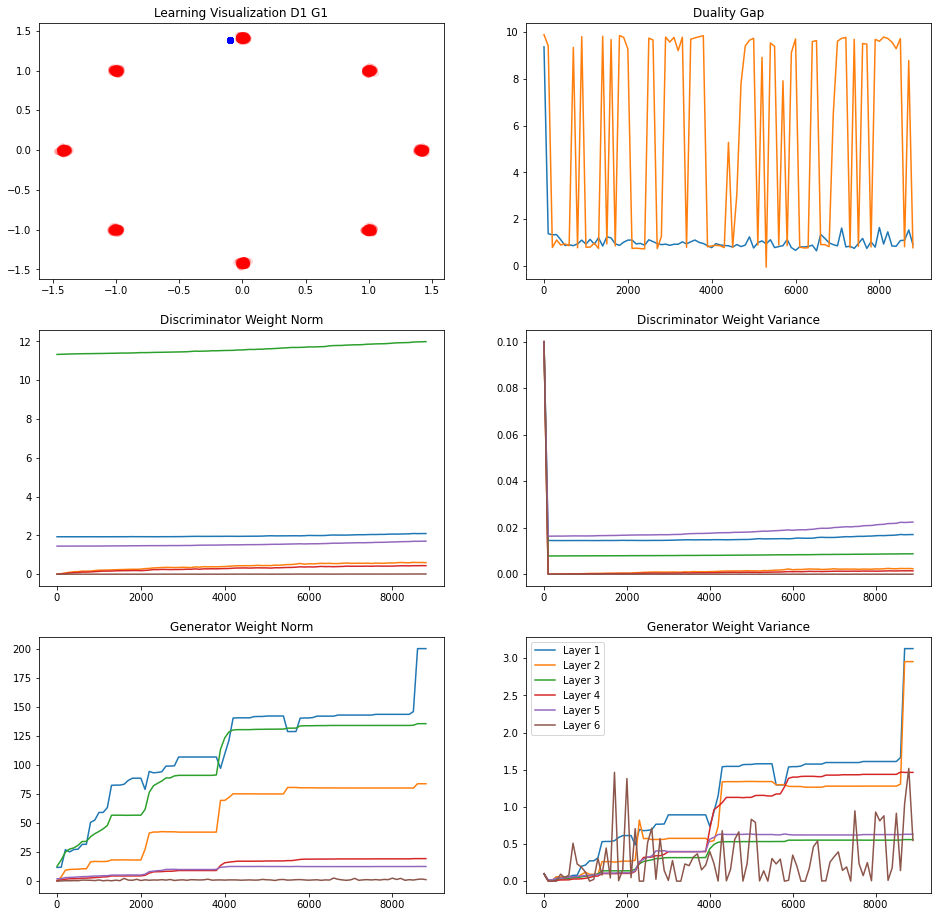

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4183975
L Random  Duality Gap :  9.773283


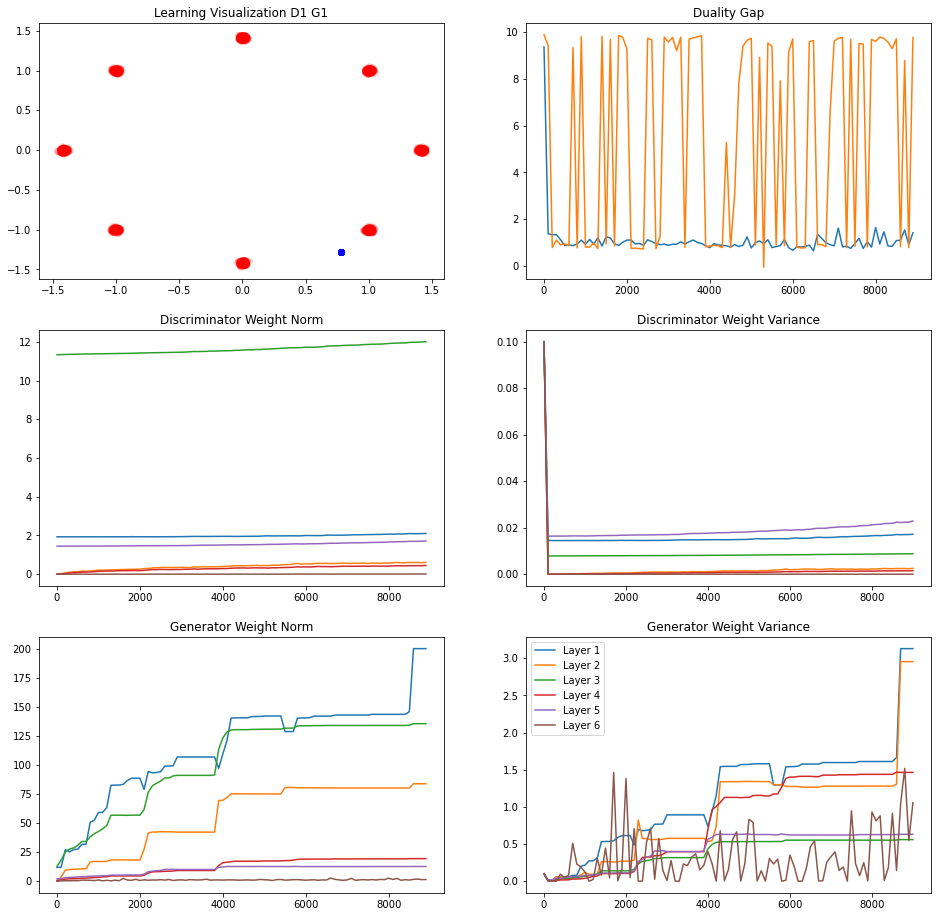

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1034775
L Random  Duality Gap :  9.572522
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0189486
L Random  Duality Gap :  9.537522


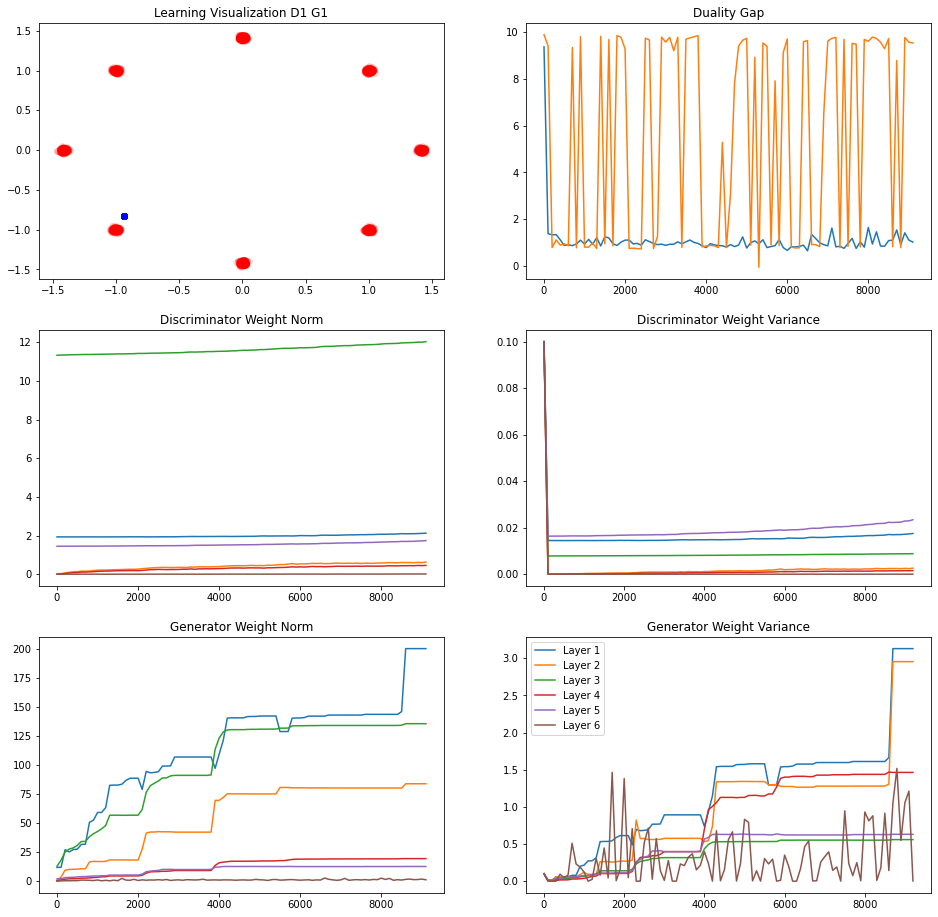

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2830871
L Random  Duality Gap :  0.8635086


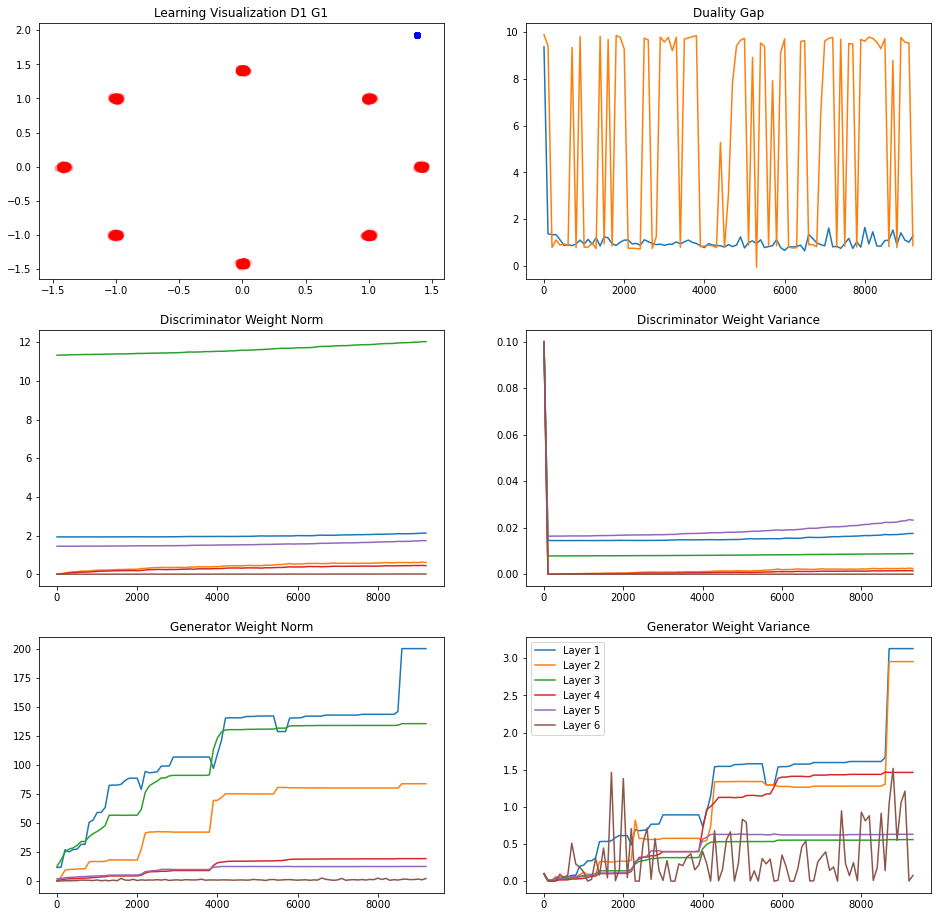

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0885905
L Random  Duality Gap :  8.419395


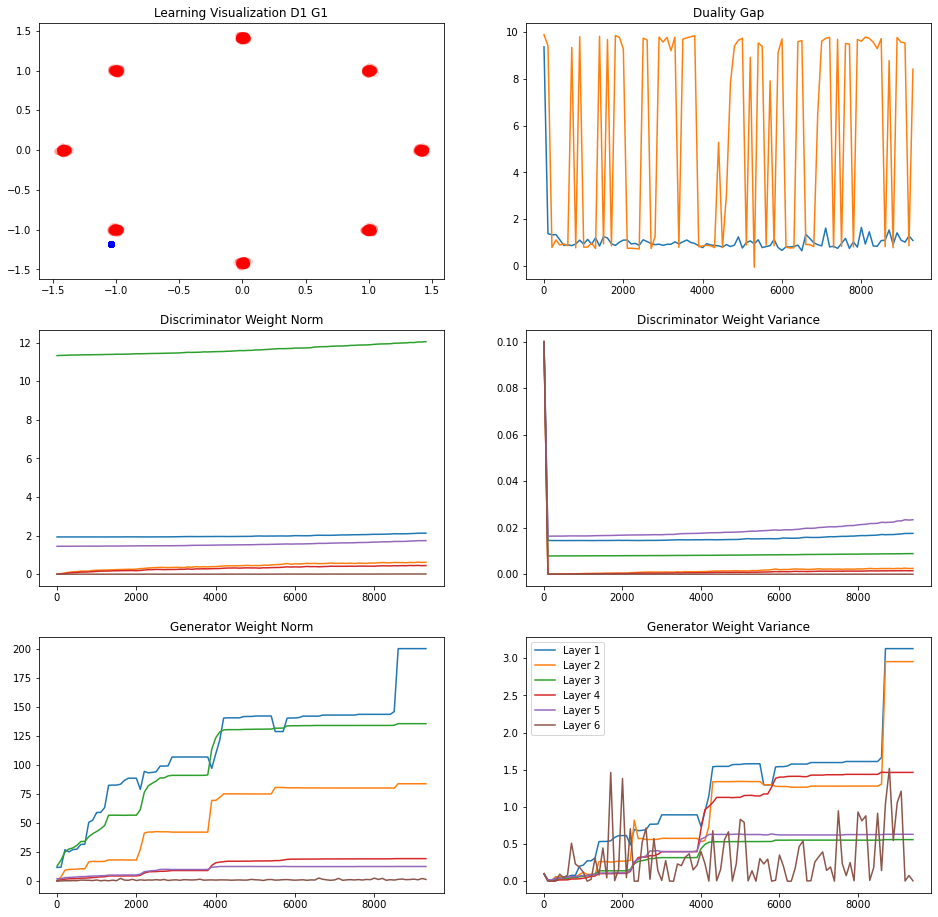

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2310313
L Random  Duality Gap :  9.788091


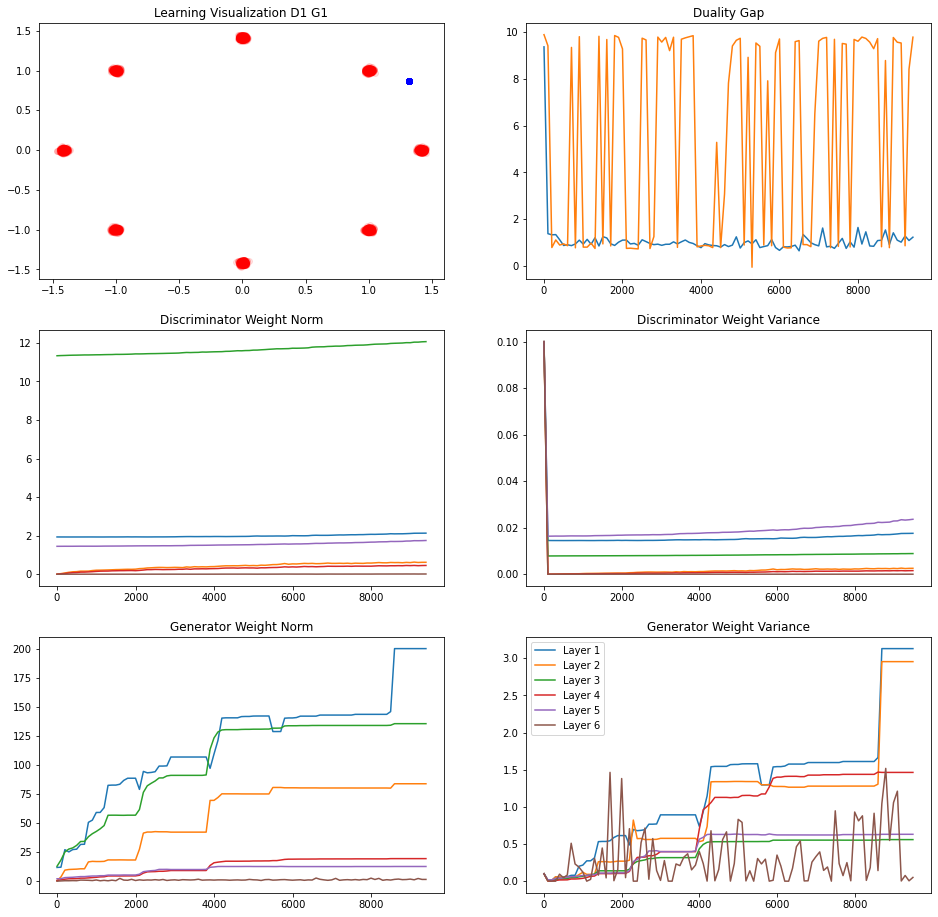

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.7779709
L Random  Duality Gap :  9.340755
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4377224
L Random  Duality Gap :  9.712825


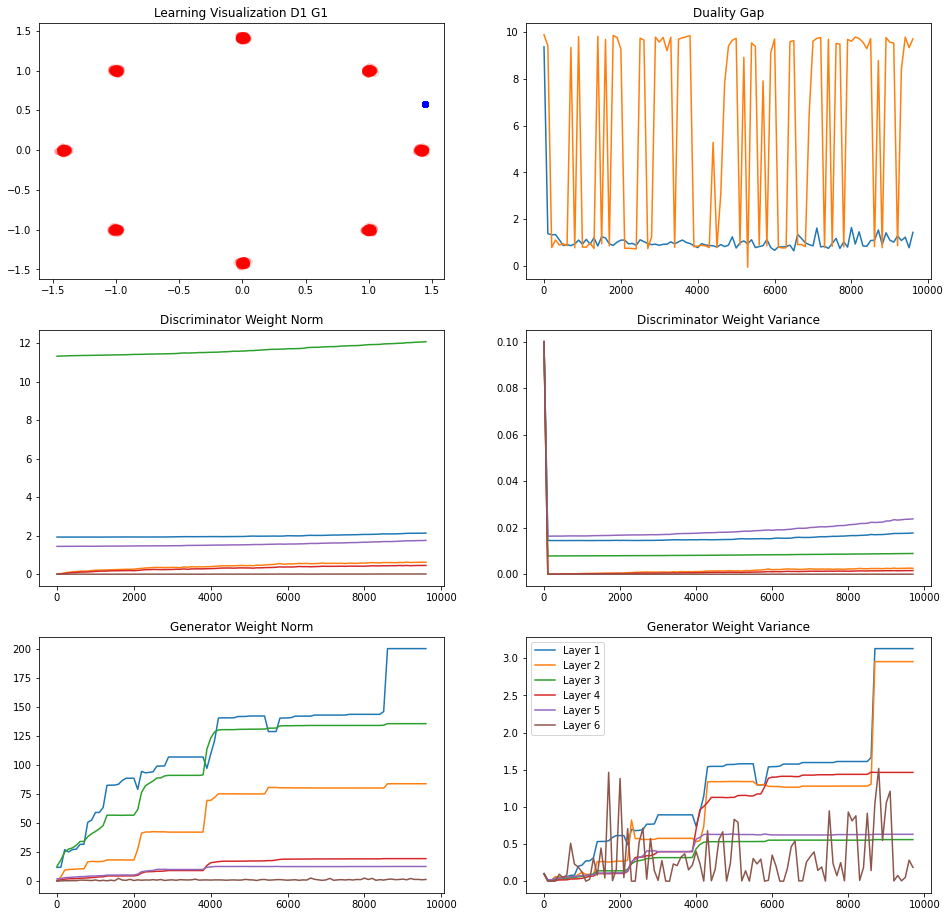

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2934089
L Random  Duality Gap :  9.2450075


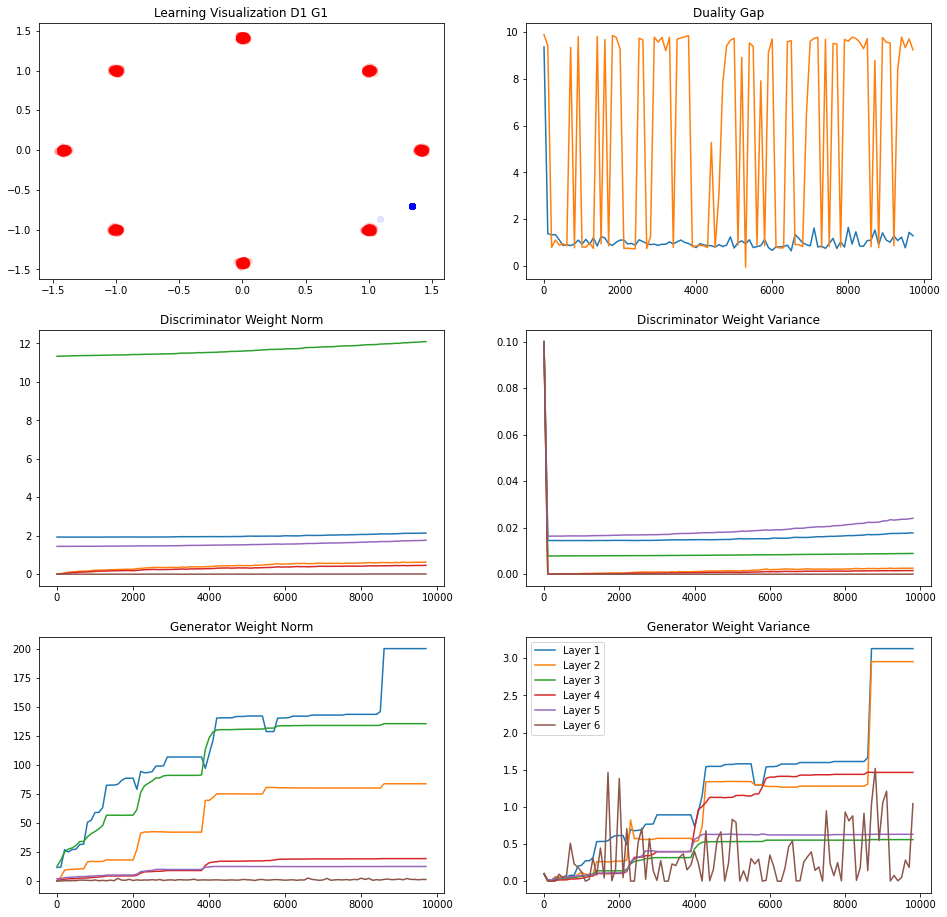

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.79175854
L Random  Duality Gap :  9.745493


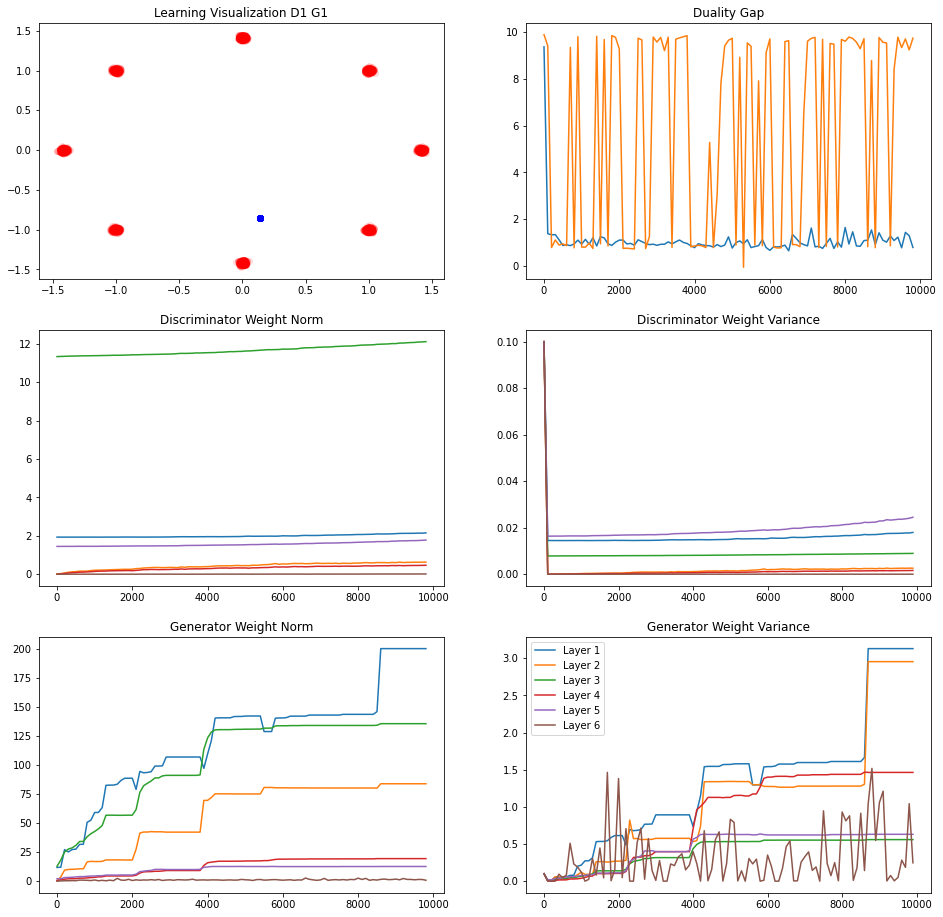

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0776888
L Random  Duality Gap :  0.7575524


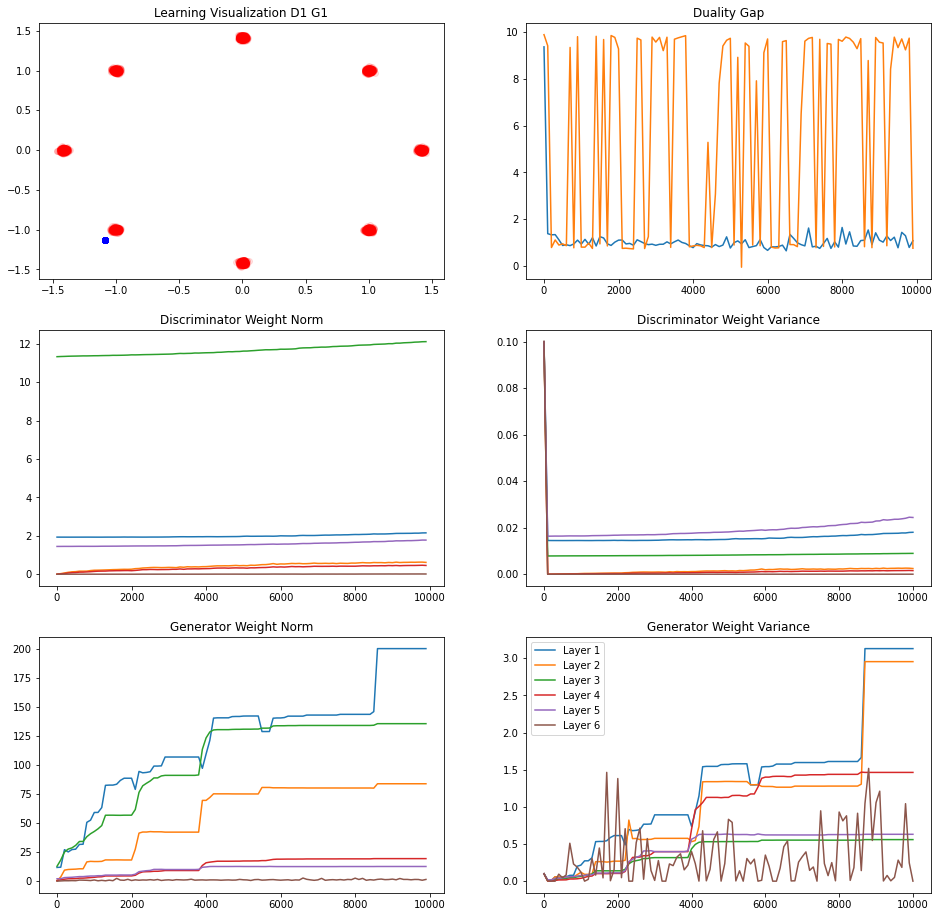

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0832732
L Random  Duality Gap :  9.72964
10000/10001 [============================>.] - ETA: 0s 

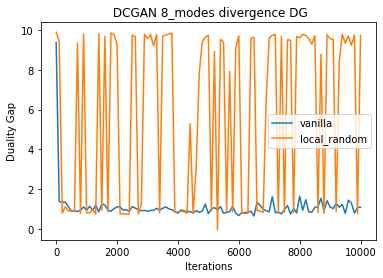

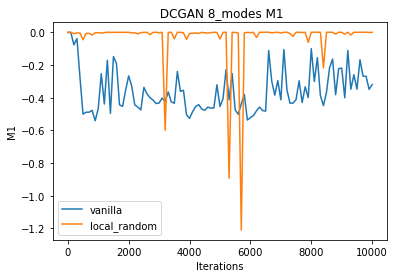

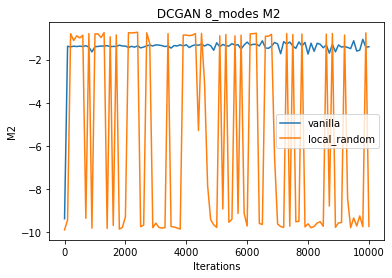

In [14]:

datasets      = ['8_modes']
# exp_types     = ['mode_collapse','convergence','divergence']
exp_types   = ['convergence','divergence']

total_data    = {}
epochs        = 10001
save_interval = 100
batch_size    = 128

model_data    = {}
for dataset in datasets:
    
    trials={}
    
    for setting in exp_types:
      
      models = {
      'DCGAN':DCGAN()
      } 

      for model in models.keys():
          print('--'*50+'\n\t\t{} {} {}\n'.format(dataset,model,setting)+'--'*50)
          save_path = './Experiments/{}/{}/{}'.format(dataset,model,setting)
          print(save_path)
          # save_path = './Experiments/{}/{}/{}'.format(dataset,model,setting)
          os.makedirs(save_path,exist_ok = True)               
          x_axis = [i for i in range(0,epochs,save_interval)]
          M1[model+'-vanilla-'+setting]=[]
          M2[model+'-vanilla-'+setting]=[]
          duality_gaps[model+'-vanilla-'+setting]=[]
          
          M1[model+'-local_random-'+setting]=[]
          M2[model+'-local_random-'+setting]=[]
          duality_gaps[model+'-local_random-'+setting]=[]
          
          models[model].configure_setting(setting)
          #train the model
          models[model].train(epochs=epochs, batch_size=batch_size, save_interval=save_interval,dataset=dataset,save_path=save_path)
          
          
          plt.figure()
          plt.title(' {} {} {} DG'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('Duality Gap')
          plt.plot(x_axis,duality_gaps[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,duality_gaps[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/DG.png',bbox_inches='tight')
          
          
          plt.figure()
          plt.title(' {} {} M1'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M1')
          plt.plot(x_axis,M1[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M1[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M1.png',bbox_inches='tight')
          
          plt.figure()
          plt.title(' {} {} M2'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M2')
          plt.plot(x_axis,M2[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M2[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M2.png',bbox_inches='tight')
          
          trials['{}'.format(model)]={
              'DG':duality_gaps,
              'M1' :M1,
              'M2' :M2
          } 
          
    model_data[dataset]=models    
    total_data[dataset]=trials